# Implementing a Neural Network
In this exercise we will develop a neural network with fully-connected layers to perform classification, and test it out on the CIFAR-10 dataset.

In [2]:
#setting for google colab
!apt-get install -y -qq software-properties-common python-software-properties module-init-tools
!add-apt-repository -y ppa:alessandro-strada/ppa 2>&1 > /dev/null
!apt-get update -qq 2>&1 > /dev/null
!apt-get -y install -qq google-drive-ocamlfuse fuse
from google.colab import auth
auth.authenticate_user()
from oauth2client.client import GoogleCredentials
creds = GoogleCredentials.get_application_default()
import getpass
!google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret} < /dev/null 2>&1 | grep URL
vcode = getpass.getpass()
!echo {vcode} | google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret}

Please, open the following URL in a web browser: https://accounts.google.com/o/oauth2/auth?client_id=32555940559.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive&response_type=code&access_type=offline&approval_prompt=force
··········
Please, open the following URL in a web browser: https://accounts.google.com/o/oauth2/auth?client_id=32555940559.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive&response_type=code&access_type=offline&approval_prompt=force
Please enter the verification code: Access token retrieved correctly.


In [0]:
!mkdir -p drive
!google-drive-ocamlfuse drive  -o nonempty

In [11]:
# A bit of setup

import numpy as np
import matplotlib.pyplot as plt

from drive.Stanford.CS231n_master.assignment1.cs231n.classifiers.neural_net import TwoLayerNet

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
  """ returns relative error """
  return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


We will use the class `TwoLayerNet` in the file `cs231n/classifiers/neural_net.py` to represent instances of our network. The network parameters are stored in the instance variable `self.params` where keys are string parameter names and values are numpy arrays. Below, we initialize toy data and a toy model that we will use to develop your implementation.

In [0]:
# Create a small net and some toy data to check your implementations.
# Note that we set the random seed for repeatable experiments.

input_size = 4
hidden_size = 10
num_classes = 3
num_inputs = 5

def init_toy_model():
  np.random.seed(0) 
  #                       4          10               3       
  return TwoLayerNet(input_size, hidden_size, num_classes, std=1e-1)

def init_toy_data():
  np.random.seed(1)
  # X.shape(5,4)                         
  X = 10 * np.random.randn(num_inputs, input_size)
  # y.shape(5)
  y = np.array([0, 1, 2, 2, 1])
  return X, y

net = init_toy_model()
X, y = init_toy_data()

# Forward pass: compute scores
Open the file `cs231n/classifiers/neural_net.py` and look at the method `TwoLayerNet.loss`. This function is very similar to the loss functions you have written for the SVM and Softmax exercises: It takes the data and weights and computes the class scores, the loss, and the gradients on the parameters. 

Implement the first part of the forward pass which uses the weights and biases to compute the scores for all inputs.

In [0]:
import numpy as np
import matplotlib.pyplot as plt


class TwoLayerNet(object):
  """
  A two-layer fully-connected neural network. The net has an input dimension of
  N, a hidden layer dimension of H, and performs classification over C classes.
  We train the network with a softmax loss function and L2 regularization on the
  weight matrices. The network uses a ReLU nonlinearity after the first fully
  connected layer.

  In other words, the network has the following architecture:

  input - fully connected layer - ReLU - fully connected layer - softmax

  The outputs of the second fully-connected layer are the scores for each class.
  """

  def __init__(self, input_size, hidden_size, output_size, std=1e-4):
    """
    Initialize the model. Weights are initialized to small random values and
    biases are initialized to zero. Weights and biases are stored in the
    variable self.params, which is a dictionary with the following keys:

    W1: First layer weights; has shape (D, H)
    b1: First layer biases; has shape (H,)
    W2: Second layer weights; has shape (H, C)
    b2: Second layer biases; has shape (C,)

    Inputs:
    - input_size: The dimension D of the input data.
    - hidden_size: The number of neurons H in the hidden layer.
    - output_size: The number of classes C.
    """
    self.params = {}
    # W1 ( 4,10)
    self.params['W1'] = std * np.random.randn(input_size, hidden_size)
    # b1 (10)
    self.params['b1'] = np.zeros(hidden_size)
    # W2 (10,3)
    self.params['W2'] = std * np.random.randn(hidden_size, output_size)
    # b2 (3)
    self.params['b2'] = np.zeros(output_size)

  def loss(self, X, y=None, reg=0.0):
    """
    Compute the loss and gradients for a two layer fully connected neural
    network.

    Inputs:
    - X: Input data of shape (N, D). Each X[i] is a training sample.
    - y: Vector of training labels. y[i] is the label for X[i], and each y[i] is
      an integer in the range 0 <= y[i] < C. This parameter is optional; if it
      is not passed then we only return scores, and if it is passed then we
      instead return the loss and gradients.
    - reg: Regularization strength.

    Returns:
    If y is None, return a matrix scores of shape (N, C) where scores[i, c] is
    the score for class c on input X[i].

    If y is not None, instead return a tuple of:
    - loss: Loss (data loss and regularization loss) for this batch of training
      samples.
    - grads: Dictionary mapping parameter names to gradients of those parameters
      with respect to the loss function; has the same keys as self.params.
    """
    # Unpack variables from the params dictionary
    W1, b1 = self.params['W1'], self.params['b1']
    print("W1 :",W1)
    print("b1 :",b1)
    W2, b2 = self.params['W2'], self.params['b2']
    print("W2 :",W2)
    print("b2 :",b2)
    N, D = X.shape

    # Compute the forward pass
    scores = None
    #############################################################################
    # TODO: Perform the forward pass, computing the class scores for the input. #
    # Store the result in the scores variable, which should be an array of      #
    # shape (N, C).                                                             #
    #############################################################################
    out1 = np.maximum(0, X.dot(W1) + b1) # ##全连接层1   (N, H)  relu, (N, H) # 因為relu 所以用 np.maximum
    scores = out1.dot(W2) + b2 # 全连接层2   (N, C) # 兩層的輸出結果
    #############################################################################
    #                              END OF YOUR CODE                             #
    #############################################################################
    
    # If the targets are not given then jump out, we're done
    if y is None:
      return scores

    # Compute the loss
    loss = None
    #############################################################################
    # TODO: Finish the forward pass, and compute the loss. This should include  #
    # both the data loss and L2 regularization for W1 and W2. Store the result  #
    # in the variable loss, which should be a scalar. Use the Softmax           #
    # classifier loss. So that your results match ours, multiply the            #
    # regularization loss by 0.5                                                #
    #############################################################################
    correct_class_score = scores[np.arange(N), y].reshape(N, 1) #將正確得分 取出  
    print("scores.shape :",scores.shape)  # (200 ,3)
    exp_sum = np.sum(np.exp(scores), axis=1).reshape(N, 1) # 對前一層的輸出h 的所有col 取指數 並相加 然後reshape 乘(20,1)  ....對每一個分數求指數 並加總
    # https://blog.csdn.net/u014380165/article/details/71181256   求softmax loss
    loss = np.sum(np.log(exp_sum) - correct_class_score) # 把每一個指數 row的值 取log - 正確得分    最後再做相加  .... 對指數總和 做log 在減掉 正確類別分數
    print("loss :",loss)    # number
    print("loss.shape :",loss.shape) # none
    loss /= N
    loss += 0.5 * reg * np.sum(W1 * W1)+  0.5 * reg * np.sum(W2 * W2)  #loss 正則化  需要每一層都要做?
    
    #############################################################################
    #                              END OF YOUR CODE                             #
    #############################################################################

    # Backward pass: compute gradients
    grads = {}
    #############################################################################
    # TODO: Compute the backward pass, computing the derivatives of the weights #
    # and biases. Store the results in the grads dictionary. For example,       #
    # grads['W1'] should store the gradient on W1, and be a matrix of same size #
    #############################################################################
    #首先来回顾一下我们的网络结结构：输入层（D），全连接层-ReLu(H)，softmax(C)
    print("scores :",scores)
    #這邊是求softmax 的機率
    margin = np.exp(scores) / exp_sum # 兩層的輸出結果 取指數 再取指數平均  這邊經過softmax 所以數值都在0~1之間
    print("before margin :",margin)
    #https://read01.com/EmdgO0.html#.WwfHJCP3VTZ
    margin[np.arange(N), y] += -1 # 在margin 上  把所有答案的 數值 - 1  為什麼?????   因為softmax 後  只要減一 
    print("減一之後的 margin :",margin)
    # 這邊可能是因為數值 除上 N  讓後續計算更快速
    margin /= N #(N, C) #算平均
    print("margin :",margin)
    dW2 = out1.T.dot(margin) #為什麼要做反矩陣 (H ,C)  dw 是用x1 , w1 經過relu後   在跟margin 做內積  可以得到w2 的梯度 (本地梯度.T   乘上 上游梯度margin ) 
    print("after_out1.T.dot(margin)_dW2.shape :",dW2.shape)
    dW2 += reg * W2  # 
    grads['W2'] = dW2
    print("margin :",margin)
    print("margin.shape :",margin.shape)
    grads['b2'] = np.sum(margin, axis = 0) # (200,3)  對所有 row 計算出每一類別總共的 整數 
    print("grads['b2'] :",grads['b2'])
    
    #print("margin1.shape :",margin1.shape)
    margin1 = margin.dot(W2.T) #(N, H) 
    print("margin1.shape :",margin1.shape)
    print("before margin1[out1 <= 0] = 0_margin1 ",margin1)
    margin1[out1 <= 0] = 0
    print("after_ margin1[out1 <= 0] = 0_margin1 ",margin1)
    dW1 = X.T.dot(margin1) #(D, H)
    print("dW1.shape :",dW1.shape)
    dW1 += reg * W1 
    grads['W1'] = dW1
    grads['b1'] = np.sum(margin1, axis = 0)
    print("grads['b1'] :",grads['b1'])
    #############################################################################
    #                              END OF YOUR CODE                             #
    #############################################################################

    return loss, grads

  def train(self, X, y, X_val, y_val,
            learning_rate=1e-3, learning_rate_decay=0.95,
            reg=1e-5, num_iters=100,
            batch_size=200, verbose=False):
    """
    Train this neural network using stochastic gradient descent.

    Inputs:
    - X: A numpy array of shape (N, D) giving training data.
    - y: A numpy array f shape (N,) giving training labels; y[i] = c means that
      X[i] has label c, where 0 <= c < C.
    - X_val: A numpy array of shape (N_val, D) giving validation data.
    - y_val: A numpy array of shape (N_val,) giving validation labels.
    - learning_rate: Scalar giving learning rate for optimization.
    - learning_rate_decay: Scalar giving factor used to decay the learning rate
      after each epoch.
    - reg: Scalar giving regularization strength.
    - num_iters: Number of steps to take when optimizing.
    - batch_size: Number of training examples to use per step.
    - verbose: boolean; if true print progress during optimization.
    """
    # num_train = 5
    num_train = X.shape[0]
    iterations_per_epoch = max(num_train / batch_size, 1)

    # Use SGD to optimize the parameters in self.model
    loss_history = []
    train_acc_history = []
    val_acc_history = []

    for it in range(num_iters):
      X_batch = None
      y_batch = None

      #########################################################################
      # TODO: Create a random minibatch of training data and labels, storing  #
      # them in X_batch and y_batch respectively.                             #
      #########################################################################
      mask = np.random.choice(num_train, batch_size, replace=True)
      X_batch = X[mask]
      y_batch = y[mask]
      #########################################################################
      #                             END OF YOUR CODE                          #
      #########################################################################

      # Compute loss and gradients using the current minibatch
      loss, grads = self.loss(X_batch, y=y_batch, reg=reg)
      loss_history.append(loss)

      #########################################################################
      # TODO: Use the gradients in the grads dictionary to update the         #
      # parameters of the network (stored in the dictionary self.params)      #
      # using stochastic gradient descent. You'll need to use the gradients   #
      # stored in the grads dictionary defined above.                         #
      #########################################################################
      self.params['W1'] -= learning_rate * grads['W1']
      self.params['W2'] -= learning_rate * grads['W2']
      self.params['b1'] -= learning_rate * grads['b1']
      self.params['b2'] -= learning_rate * grads['b2']

      #########################################################################
      #                             END OF YOUR CODE                          #
      #########################################################################

      if verbose and it % 100 == 0:
        print ('iteration %d / %d: loss %f' % (it, num_iters, loss))

      # Every epoch, check train and val accuracy and decay learning rate.
      if it % iterations_per_epoch == 0:
        # Check accuracy
        train_acc = (self.predict(X_batch) == y_batch).mean()
        val_acc = (self.predict(X_val) == y_val).mean()
        train_acc_history.append(train_acc)
        val_acc_history.append(val_acc)

        # Decay learning rate      learning_rate_decay = 0.95  learning_rate 越來越小
        learning_rate *= learning_rate_decay

    return {
      'loss_history': loss_history,
      'train_acc_history': train_acc_history,
      'val_acc_history': val_acc_history,
    }

  def predict(self, X):
    """
    Use the trained weights of this two-layer network to predict labels for
    data points. For each data point we predict scores for each of the C
    classes, and assign each data point to the class with the highest score.

    Inputs:
    - X: A numpy array of shape (N, D) giving N D-dimensional data points to
      classify.

    Returns:
    - y_pred: A numpy array of shape (N,) giving predicted labels for each of
      the elements of X. For all i, y_pred[i] = c means that X[i] is predicted
      to have class c, where 0 <= c < C.
    """
    y_pred = None

    ###########################################################################
    # TODO: Implement this function; it should be VERY simple!                #
    ###########################################################################
    out1 = np.maximum(0, X.dot(self.params['W1']) + self.params['b1']) # relu, (N, H)
    # 透過argmax 可以得知該二為矩陣  數值最大的 索引直 可以對應到 y_label 的one hot encoding
    y_pred =  np.argmax(out1.dot(self.params['W2']) + self.params['b2'],axis = 1) # (N, C)
    ###########################################################################
    #                              END OF YOUR CODE                           #
    ###########################################################################

    return y_pred



In [14]:
scores = net.loss(X)
print ('Your scores:')
print (scores)
print
print ('correct scores:')
#array和asarray都可以将结构数据转化为ndarray
##但是主要区别就是当数据源是ndarray时，array仍然会copy出一个副本，占用新的内存，但asarray不会。
correct_scores = np.asarray([
  [-0.81233741, -1.27654624, -0.70335995],
  [-0.17129677, -1.18803311, -0.47310444],
  [-0.51590475, -1.01354314, -0.8504215 ],
  [-0.15419291, -0.48629638, -0.52901952],
  [-0.00618733, -0.12435261, -0.15226949]])
print (correct_scores)
print

# The difference should be very small. We get < 1e-7
print ('Difference between your scores and correct scores:')
print (np.sum(np.abs(scores - correct_scores)))

Your scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]
correct scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]
Difference between your scores and correct scores:
3.6802720745909845e-08


# Forward pass: compute loss
In the same function, implement the second part that computes the data and regularizaion loss.

In [38]:
loss, _ = net.loss(X, y, reg=0.1)
correct_loss = 1.30378789133

# should be very small, we get < 1e-12
print ('Difference between your loss and correct loss:')
print (np.sum(np.abs(loss - correct_loss)))

W1 : [[        nan  0.04001493         nan         nan         nan -0.09772585
   0.09500695         nan         nan         nan]
 [        nan  0.14542446         nan         nan         nan  0.03336677
   0.14940494         nan         nan         nan]
 [        nan  0.06536056         nan         nan         nan -0.14543368
   0.00457576         nan         nan         nan]
 [        nan  0.0378155          nan         nan         nan  0.01563459
   0.12302662         nan         nan         nan]]
b1 : [nan  0. nan nan nan  0.  0. nan nan nan]
W2 : [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
b2 : [nan nan nan]
scores.shape : (5, 3)
loss : nan
loss.shape : ()
scores : [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
before margin : [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
減一之後的 margin : [[nan nan nan]
 [nan nan nan]
 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:147: RuntimeWarning: invalid value encountered in less_equal


# Backward pass
Implement the rest of the function. This will compute the gradient of the loss with respect to the variables `W1`, `b1`, `W2`, and `b2`. Now that you (hopefully!) have a correctly implemented forward pass, you can debug your backward pass using a numeric gradient check:

In [16]:
from drive.Stanford.CS231n_master.assignment1.cs231n.gradient_check import eval_numerical_gradient

# Use numeric gradient checking to check your implementation of the backward pass.
# If your implementation is correct, the difference between the numeric and
# analytic gradients should be less than 1e-8 for each of W1, W2, b1, and b2.

loss, grads = net.loss(X, y, reg=0.1)

# these should all be less than 1e-8 or so    0.00000001
for param_name in grads:
  f = lambda W: net.loss(X, y, reg=0.1)[0]
  param_grad_num = eval_numerical_gradient(f, net.params[param_name], verbose=False)
  print ('%s max relative error: %e' % (param_name, rel_error(param_grad_num, grads[param_name])))

W2 max relative error: 3.440708e-09
b2 max relative error: 4.447646e-11
W1 max relative error: 3.561318e-09
b1 max relative error: 2.738421e-09


# Train the network
To train the network we will use stochastic gradient descent (SGD), similar to the SVM and Softmax classifiers. Look at the function `TwoLayerNet.train` and fill in the missing sections to implement the training procedure. This should be very similar to the training procedure you used for the SVM and Softmax classifiers. You will also have to implement `TwoLayerNet.predict`, as the training process periodically performs prediction to keep track of accuracy over time while the network trains.

Once you have implemented the method, run the code below to train a two-layer network on toy data. You should achieve a training loss less than 0.2.

W1 : [[ 0.17640523  0.04001572  0.0978738   0.22408932  0.1867558  -0.09772779
   0.09500884 -0.01513572 -0.01032189  0.04105985]
 [ 0.01440436  0.14542735  0.07610377  0.0121675   0.04438632  0.03336743
   0.14940791 -0.02051583  0.03130677 -0.08540957]
 [-0.25529898  0.06536186  0.08644362 -0.0742165   0.22697546 -0.14543657
   0.00457585 -0.01871839  0.15327792  0.14693588]
 [ 0.01549474  0.03781625 -0.08877857 -0.19807965 -0.03479121  0.0156349
   0.12302907  0.12023798 -0.03873268 -0.03023028]]
b1 : [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
W2 : [[-0.1048553  -0.14200179 -0.17062702]
 [ 0.19507754 -0.05096522 -0.04380743]
 [-0.12527954  0.07774904 -0.16138978]
 [-0.02127403 -0.08954666  0.03869025]
 [-0.05108051 -0.11806322 -0.00281822]
 [ 0.04283319  0.00665172  0.03024719]
 [-0.06343221 -0.03627412 -0.06724604]
 [-0.03595532 -0.08131463 -0.17262826]
 [ 0.01774261 -0.04017809 -0.16301983]
 [ 0.04627823 -0.09072984  0.00519454]]
b2 : [0. 0. 0.]
scores.shape : (200, 3)
loss : 248.39800188152

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:106: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:147: RuntimeWarning: invalid value encountered in less_equal


[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

 [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

 [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

 nan
loss.shape : ()
scores : [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan  0. nan ... nan nan nan]
 [nan  0. nan ... nan nan nan]
 [nan  0. nan ... nan nan nan]
 ...
 [nan  0. nan ... nan nan nan]
 [nan  0. nan ... nan nan nan]
 [nan  0. nan ... nan nan nan]]
dW1.shape : (4, 10)
grads['b1'] : [nan  0. nan nan nan  0.  0. nan nan nan]
W1 : [[        nan  0.040015           nan         nan         nan -0.09772602
   0.09500712         nan         nan         nan]
 [        nan  0.14542472         nan         nan         nan  0.03336683
   0.1494052          nan         nan         nan]
 [        nan  0.06536068         nan         nan         nan -0.14543393
   0.00457577         nan         nan         nan]
 [        nan  0.03781557         nan         nan         nan  0.01563461
   0.12302684         nan         nan         nan]]
b1 : [nan  0. nan nan nan  0.  0. nan nan nan]
W2 : [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
b2 : [nan nan nan]
scor

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
b2 : [nan nan nan]
scores.shape : (200, 3)
loss : nan
loss.shape : ()
scores : [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 


after_out1.T.dot(margin)_dW2.shape : (10, 3)
margin : [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]


[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[nan  0. nan nan nan  0.  0. nan nan nan]
W2 : [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
b2 : [nan nan nan]
scores.shape : (200, 3)
loss : nan
loss.shape : ()
scores : [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [n

 [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

[[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan 

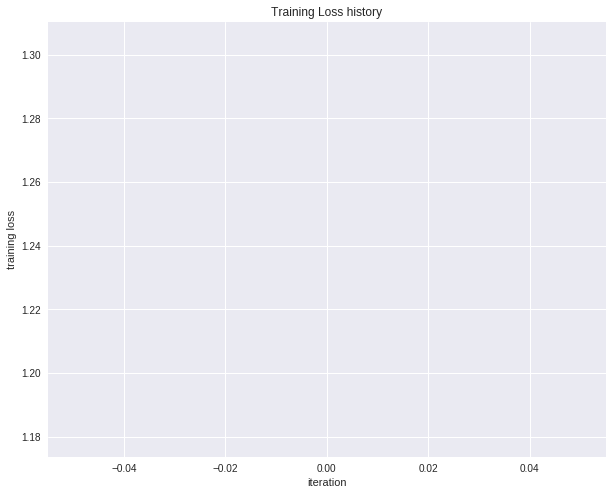

In [31]:
# 做初始化 兩層架構的X跟W
net = init_toy_model()
#X.shape(5,4)   y.shape(5)
#print("X.shape :" X.shape)
#print("y.shape :" y.shape)
stats = net.train(X, y, X, y,
            learning_rate=1e-1, reg=1e-5,
            num_iters=100, verbose=False)

print ('Final training loss: ', stats['loss_history'][-1])

# plot the loss history
plt.plot(stats['loss_history'])
plt.xlabel('iteration')
plt.ylabel('training loss')
plt.title('Training Loss history')
plt.show()

# Load the data
Now that you have implemented a two-layer network that passes gradient checks and works on toy data, it's time to load up our favorite CIFAR-10 data so we can use it to train a classifier on a real dataset.

In [0]:
# 這邊除了要下載DATA  還需要把下面用到的路徑改掉

In [0]:
!sh drive/Stanford/CS231n_master/assignment1/cs231n/datasets/get_datasets.sh

--2018-05-24 03:08:41--  http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz
Resolving www.cs.toronto.edu (www.cs.toronto.edu)... 128.100.3.30
Connecting to www.cs.toronto.edu (www.cs.toronto.edu)|128.100.3.30|:80... failed: Connection timed out.
Retrying.

--2018-05-24 03:10:49--  (try: 2)  http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz
Connecting to www.cs.toronto.edu (www.cs.toronto.edu)|128.100.3.30|:80... failed: Connection timed out.
Retrying.

--2018-05-24 03:12:58--  (try: 3)  http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz
Connecting to www.cs.toronto.edu (www.cs.toronto.edu)|128.100.3.30|:80... failed: Connection timed out.
Retrying.

--2018-05-24 03:15:09--  (try: 4)  http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz
Connecting to www.cs.toronto.edu (www.cs.toronto.edu)|128.100.3.30|:80... failed: Connection timed out.
Retrying.

--2018-05-24 03:17:20--  (try: 5)  http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz
Connecting to www.cs.toronto.edu (

In [17]:
from drive.Stanford.CS231n_master.assignment1.cs231n.data_utils import load_CIFAR10

def get_CIFAR10_data(num_training=49000, num_validation=1000, num_test=1000):
    """
    Load the CIFAR-10 dataset from disk and perform preprocessing to prepare
    it for the two-layer neural net classifier. These are the same steps as
    we used for the SVM, but condensed to a single function.  
    """
    # Load the raw CIFAR-10 data
    cifar10_dir = 'cifar-10-batches-py'
    X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)
        
    # Subsample the data
    mask = range(num_training, num_training + num_validation)
    X_val = X_train[mask]
    y_val = y_train[mask]
    mask = range(num_training)
    X_train = X_train[mask]
    y_train = y_train[mask]
    mask = range(num_test)
    X_test = X_test[mask]
    y_test = y_test[mask]

    # Normalize the data: subtract the mean image
    mean_image = np.mean(X_train, axis=0)
    X_train -= mean_image
    X_val -= mean_image
    X_test -= mean_image

    # Reshape data to rows
    X_train = X_train.reshape(num_training, -1)
    X_val = X_val.reshape(num_validation, -1)
    X_test = X_test.reshape(num_test, -1)

    return X_train, y_train, X_val, y_val, X_test, y_test


# Invoke the above function to get our data.
X_train, y_train, X_val, y_val, X_test, y_test = get_CIFAR10_data()
print ('Train data shape: ', X_train.shape)
print ('Train labels shape: ', y_train.shape)
print ('Validation data shape: ', X_val.shape)
print ('Validation labels shape: ', y_val.shape)
print ('Test data shape: ', X_test.shape)
print ('Test labels shape: ', y_test.shape)

Train data shape:  (49000, 3072)
Train labels shape:  (49000,)
Validation data shape:  (1000, 3072)
Validation labels shape:  (1000,)
Test data shape:  (1000, 3072)
Test labels shape:  (1000,)


# Train a network
To train our network we will use SGD with momentum. In addition, we will adjust the learning rate with an exponential learning rate schedule as optimization proceeds; after each epoch, we will reduce the learning rate by multiplying it by a decay rate.

In [18]:
input_size = 32 * 32 * 3
hidden_size = 50
num_classes = 10
net = TwoLayerNet(input_size, hidden_size, num_classes)

# Train the network
stats = net.train(X_train, y_train, X_val, y_val,
            num_iters=1000, batch_size=200,
            learning_rate=1e-3, learning_rate_decay=0.95,
            reg=0.5, verbose=True)

# Predict on the validation set
val_acc = (net.predict(X_val) == y_val).mean()
print ('Validation accuracy: ', val_acc)

W1 : [[-7.36290454e-05  5.54886163e-05  1.65877915e-04 ...  7.24185305e-05
   1.17469537e-04  1.07997532e-05]
 [-9.71664426e-05  6.83021995e-05 -4.46814450e-05 ... -4.25418215e-06
   4.69049639e-05  4.39592238e-05]
 [ 4.78321520e-06  2.12051486e-04 -2.06418194e-05 ... -5.85615527e-05
  -5.00818696e-05 -1.18112187e-04]
 ...
 [-6.16249940e-05  2.43111174e-05  6.16085538e-05 ... -1.59859058e-04
  -3.31933764e-05 -7.70390210e-05]
 [-7.70597427e-06 -9.36457880e-05 -8.01609239e-05 ... -8.45476338e-06
  -1.61321578e-04  1.77614470e-04]
 [-1.01648406e-04  6.17531877e-05 -1.21008698e-04 ...  8.35755165e-06
  -8.43096611e-05  2.06853657e-04]]
b1 : [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
W2 : [[ 7.49159908e-05 -9.43302034e-06  1.22568445e-05 -8.52665774e-05
   8.27628953e-05 -1.86967110e-05  1.57292331e-05  2.78439857e-05
   6.64152159e-05 -9.86638377e-05]
 [ 9.63661512e-06  7.2436610

W1 : [[-7.44367890e-05  5.44303317e-05  1.68268470e-04 ...  6.89948855e-05
   1.18943259e-04  5.42408843e-06]
 [-9.68919101e-05  6.66416851e-05 -3.94945543e-05 ... -8.87383051e-06
   4.83991743e-05  3.73770670e-05]
 [ 5.14434534e-06  2.10316383e-04 -1.36294102e-05 ... -6.53424960e-05
  -4.63208801e-05 -1.25012310e-04]
 ...
 [-6.23574213e-05  2.37050786e-05  6.27659226e-05 ... -1.58587746e-04
  -3.31025450e-05 -8.14666773e-05]
 [-8.07132221e-06 -9.45390615e-05 -7.76737992e-05 ... -8.90955171e-06
  -1.61155606e-04  1.72159890e-04]
 [-1.02416610e-04  6.10733136e-05 -1.17472579e-04 ...  6.52336098e-06
  -8.11609289e-05  2.02259914e-04]]
b1 : [ 1.60862423e-08 -2.31321376e-09  4.80981803e-10  4.72423105e-08
  3.10548907e-08  1.99795825e-08  8.73402878e-08  3.95284086e-08
  1.27818447e-07  2.93892402e-08  5.35410753e-08  1.93209170e-08
  6.76474494e-08  5.97776145e-08  1.92129119e-08  4.30932032e-08
  5.98085399e-08  9.02606016e-08  1.71693353e-08  1.12523803e-08
  6.81580285e-08  7.39247615e

scores.shape : (200, 10)
loss : 460.09424462950096
loss.shape : ()
W1 : [[-7.19710069e-05  5.51046866e-05  1.75910884e-04 ...  6.53849236e-05
   1.20740255e-04 -6.80945448e-06]
 [-9.27808788e-05  6.77759438e-05 -2.84511135e-05 ... -1.39367393e-05
   5.22062274e-05  2.17732537e-05]
 [ 1.04481533e-05  2.12762490e-04  2.79580797e-06 ... -7.42636229e-05
  -3.75052616e-05 -1.45352705e-04]
 ...
 [-6.18425115e-05  2.36845929e-05  6.42551023e-05 ... -1.57924337e-04
  -3.29257416e-05 -8.69497566e-05]
 [-6.87885231e-06 -9.38316978e-05 -7.38134455e-05 ... -1.01840507e-05
  -1.58547303e-04  1.64962893e-04]
 [-1.00717063e-04  6.37156650e-05 -1.10475450e-04 ...  3.50651781e-06
  -7.33584181e-05  1.92977900e-04]]
b1 : [5.12104830e-08 4.98488377e-08 1.61993215e-07 4.11846826e-07
 2.13876034e-07 4.99380687e-08 3.06131570e-07 2.08598342e-07
 4.64712100e-07 1.16838518e-07 1.89188175e-07 4.67292815e-08
 3.00081263e-07 3.42746441e-07 8.94932094e-08 1.93694908e-07
 3.61000850e-07 4.53409545e-07 3.08213713e-

[[ 2.56109379e-04  2.45709403e-05  4.52636687e-05 -1.19647726e-04
   1.01619974e-05 -8.15797750e-05 -9.77955337e-05  6.05375132e-05
   4.88781721e-05 -7.94057330e-05]
 [ 1.84128235e-04 -8.96059327e-06 -1.45184172e-04 -6.87818464e-05
  -2.48329983e-04  1.75132691e-04 -2.00044454e-04 -1.38532966e-04
   7.40408504e-05  6.01573416e-05]
 [ 3.90867876e-04 -3.74915127e-05 -2.63230707e-04 -3.15117202e-04
  -2.98376749e-04  6.47871086e-06 -4.71030691e-04 -5.20874116e-05
   4.11431285e-04  2.16791528e-04]
 [ 1.37493685e-03 -1.49920688e-06 -2.20452360e-04 -1.84453557e-04
  -3.70481462e-04 -4.07625916e-04 -6.42535286e-04 -2.58266038e-04
   1.04467751e-03  1.48908911e-04]
 [-3.93980824e-04  2.72242664e-05  7.20396203e-05  2.81030001e-04
   2.14118149e-04  3.11259107e-04  2.26269305e-04  1.85287630e-04
  -3.24819553e-04 -3.15280023e-04]
 [ 5.69711401e-06 -8.02808340e-05  5.78187541e-06 -9.25063139e-05
   1.45968033e-04  5.57684671e-05  2.83892688e-05  1.61211739e-04
  -2.49707862e-04 -7.32823417e-05


b1 : [2.45579955e-07 3.69113625e-07 1.11890184e-06 2.36182515e-06
 1.08748390e-06 2.86789695e-07 1.75575354e-06 1.15885986e-06
 1.95791428e-06 5.45653307e-07 9.50736936e-07 2.36372875e-07
 1.58052552e-06 1.72128491e-06 5.75610359e-07 1.01959347e-06
 2.01053327e-06 2.47091450e-06 1.84259591e-06 7.34857665e-07
 2.78523096e-06 2.41642272e-06 5.55673617e-07 7.08592578e-07
 9.18192503e-07 1.85162072e-07 2.03524303e-06 1.09946865e-07
 2.30400692e-06 9.09064475e-08 2.09753053e-06 5.78997406e-07
 4.37887734e-07 5.78412072e-08 1.24444538e-06 1.48963078e-06
 1.88640454e-06 4.36216192e-07 1.07337474e-06 7.73227121e-07
 9.02041152e-07 1.02277181e-06 7.00509152e-07 1.28631343e-06
 1.90314314e-06 2.67378327e-07 1.19863001e-06 5.80852204e-07
 4.62454983e-07 1.27206082e-06]
W2 : [[ 6.48258200e-04 -3.52307462e-05  7.93564425e-05 -1.59108863e-04
  -1.16954147e-04 -1.94014230e-04 -2.66743924e-04 -2.22886870e-05
   2.75375981e-04 -1.41875135e-04]
 [ 5.02117169e-04 -6.00223765e-05 -1.71053435e-04 -1.33308

loss : 438.1219723540272
loss.shape : ()
W1 : [[-7.15168327e-05  5.15223235e-05  1.89548232e-04 ...  8.37425824e-06
   1.19550243e-04 -1.26506592e-04]
 [-7.73863370e-05  7.94113248e-05  4.01262079e-05 ... -8.92270872e-05
   8.24020897e-05 -1.42062500e-04]
 [ 4.75822116e-05  2.49168523e-04  1.52176895e-04 ... -1.93932593e-04
   4.23556293e-05 -3.99595797e-04]
 ...
 [-7.66887714e-05 -3.67891896e-06 -2.75103462e-05 ... -1.63507068e-04
  -7.27020998e-05 -1.06606844e-04]
 [-9.47770642e-06 -1.03664568e-04 -1.14182101e-04 ... -2.90895976e-05
  -1.67915592e-04  1.17806389e-04]
 [-8.95200272e-05  7.34680612e-05 -9.12743418e-05 ... -4.73701446e-05
  -4.38102463e-05  8.40205109e-05]]
b1 : [4.20453250e-07 5.90854530e-07 1.96798594e-06 3.88106173e-06
 2.56400896e-06 6.67720359e-07 3.20627599e-06 2.14994171e-06
 4.35950943e-06 8.61520163e-07 2.16108772e-06 5.49974854e-07
 3.67773656e-06 2.75523523e-06 1.39837194e-06 2.34372083e-06
 3.46053309e-06 4.22276180e-06 3.01269082e-06 1.76101273e-06
 4.80360


W2 : [[ 1.61392717e-03 -2.27679312e-04  3.34935388e-04 -2.77991282e-04
  -3.17598109e-04 -2.73315026e-04 -5.77881377e-04 -8.75435751e-05
   2.31238961e-04 -3.51918021e-04]
 [ 1.16668861e-03 -9.12791916e-05 -9.91340416e-05 -3.30490890e-04
  -6.83568488e-04 -4.77972971e-05 -8.30644654e-04 -4.74536818e-04
   1.02246291e-03  5.62541736e-05]
 [ 2.68722040e-03  1.17062126e-04 -3.48428949e-04 -1.52366489e-03
  -1.66356334e-03 -1.31406804e-03 -2.40257365e-03 -8.29104146e-04
   3.23686598e-03  1.63412414e-03]
 [ 8.55673251e-03 -5.74900248e-04  2.96487102e-04 -2.43892440e-03
  -3.27168799e-03 -2.98365554e-03 -4.81212738e-03 -2.17877307e-03
   6.65721867e-03  1.22622765e-03]
 [-2.82310745e-03 -6.01621037e-04  7.65908069e-04  1.48681775e-03
   2.47121056e-03  2.15718318e-03  1.84292578e-03  5.48866392e-04
  -2.83142663e-03 -2.73748346e-03]
 [-6.61727890e-04 -2.46545684e-04  2.08551304e-04  9.25477589e-05
   9.64011752e-04  3.50411441e-04  2.77086226e-04  5.56034382e-04
  -9.79636776e-04 -6.524213

scores.shape : (200, 10)
loss : 422.4318052222751
loss.shape : ()
W1 : [[-1.02594832e-04  1.93717288e-05  1.26303430e-04 ... -7.24320333e-06
   5.04552417e-05 -1.65845875e-04]
 [-9.13686462e-05  6.05452158e-05  2.37367051e-05 ... -1.12961380e-04
   4.79135495e-05 -2.04528804e-04]
 [ 6.04882953e-05  2.57527030e-04  2.08970112e-04 ... -2.69416273e-04
   6.46444248e-05 -5.70437893e-04]
 ...
 [-9.59284293e-05 -4.46812164e-05 -1.05794138e-04 ... -1.54415021e-04
  -1.28218634e-04 -1.02615042e-04]
 [-2.21006167e-05 -1.33960382e-04 -1.69038546e-04 ... -2.12768298e-05
  -2.04121503e-04  1.21932547e-04]
 [-8.99379246e-05  6.17018662e-05 -1.00638893e-04 ... -8.44374965e-05
  -4.99188939e-05 -1.06733308e-06]]
b1 : [5.14907308e-07 8.78373057e-07 2.78241599e-06 5.13637172e-06
 4.67302156e-06 1.34357612e-06 7.05273118e-06 5.02789752e-06
 7.41953451e-06 1.07846628e-06 3.74270291e-06 1.11330279e-06
 6.26292702e-06 3.64655809e-06 2.45100672e-06 4.05548442e-06
 6.18388630e-06 6.16438397e-06 3.93734614e-0

[[-1.10517340e-04  5.93863856e-06  1.04293267e-04 ...  4.24760372e-06
   3.26708594e-05 -1.50304381e-04]
 [-9.24440043e-05  5.24406184e-05  2.34643656e-05 ... -1.10792747e-04
   4.06766089e-05 -2.15726584e-04]
 [ 7.14070125e-05  2.61042561e-04  2.39483264e-04 ... -3.00833995e-04
   8.27433462e-05 -6.47876248e-04]
 ...
 [-1.05803730e-04 -7.63718947e-05 -1.41402392e-04 ... -1.31503907e-04
  -1.63439248e-04 -6.27570111e-05]
 [-3.34295203e-05 -1.57520360e-04 -1.89689294e-04 ... -4.71320039e-06
  -2.34651817e-04  1.45824170e-04]
 [-9.60727790e-05  5.53075063e-05 -7.90952484e-05 ... -9.77186513e-05
  -6.02522393e-05 -3.00732827e-05]]
b1 : [5.46759594e-07 1.14922510e-06 3.12126233e-06 5.46040306e-06
 6.70873365e-06 1.97103060e-06 8.92232312e-06 6.10742243e-06
 1.02852269e-05 1.10961726e-06 5.09020151e-06 1.65967169e-06
 8.37480019e-06 3.95044446e-06 3.45617585e-06 5.58890999e-06
 7.24176585e-06 6.73291271e-06 4.14182103e-06 4.32454260e-06
 7.04637243e-06 5.69383551e-06 3.15636051e-06 3.836371

 (200, 10)
loss : 417.28544461796366
loss.shape : ()
W1 : [[-1.22024926e-04 -1.34456276e-05  7.25297521e-05 ...  1.67537040e-05
   1.03918199e-05 -1.39059559e-04]
 [-9.32078195e-05  3.02233428e-05 -1.93006509e-05 ... -1.04042443e-04
   2.57248438e-05 -2.25224242e-04]
 [ 8.96049456e-05  2.47160868e-04  2.16132112e-04 ... -3.22149581e-04
   9.69640474e-05 -7.08020165e-04]
 ...
 [-1.11878778e-04 -1.13938048e-04 -1.84826446e-04 ... -1.38596571e-04
  -1.95244696e-04 -9.28215544e-05]
 [-3.85044464e-05 -1.91210902e-04 -2.29521499e-04 ... -1.29865112e-05
  -2.59659296e-04  1.10049198e-04]
 [-9.31923445e-05  4.21912913e-05 -6.95614467e-05 ... -1.29707452e-04
  -5.55946637e-05 -9.71082832e-05]]
b1 : [8.51755501e-07 1.43070625e-06 3.39283545e-06 6.12490323e-06
 8.80698965e-06 2.87273120e-06 1.13169498e-05 7.76564247e-06
 1.29009578e-05 1.53755091e-06 6.38140778e-06 2.43997616e-06
 1.02976267e-05 5.75800896e-06 4.56083448e-06 7.12581658e-06
 8.08376575e-06 7.29907202e-06 5.10881973e-06 5.48941891e

W1 : [[-1.00149146e-04 -1.31268307e-05  9.78189405e-05 ...  2.04269499e-05
   4.35806351e-05 -1.52655972e-04]
 [-7.39007314e-05  2.56900270e-05  1.77248926e-06 ... -1.01916775e-04
   5.49099938e-05 -2.47029598e-04]
 [ 1.14038490e-04  2.44851372e-04  2.47114522e-04 ... -3.47234686e-04
   1.36096248e-04 -7.70441593e-04]
 ...
 [-1.11962553e-04 -1.47689351e-04 -2.29253021e-04 ... -1.46831901e-04
  -2.18015645e-04 -1.43649676e-04]
 [-4.22581122e-05 -2.18731390e-04 -2.62315467e-04 ... -1.46281659e-05
  -2.77820452e-04  7.09196299e-05]
 [-9.84880848e-05  2.95506592e-05 -7.86612127e-05 ... -1.53013493e-04
  -6.42370375e-05 -1.53043961e-04]]
b1 : [9.04864859e-07 1.81404321e-06 3.80022012e-06 6.30601350e-06
 1.14823565e-05 3.85406105e-06 1.44064459e-05 9.30266126e-06
 1.67487616e-05 1.51770820e-06 7.58614261e-06 3.14989649e-06
 1.22173543e-05 6.20357842e-06 6.00392358e-06 8.54489275e-06
 9.32925429e-06 8.33078235e-06 5.16860843e-06 6.62230936e-06
 8.67210836e-06 7.56106140e-06 4.54962092e-06 4.9

W1 : [[-1.00924181e-04 -2.63033440e-05  1.05221778e-04 ...  4.48008740e-05
   5.02660460e-05 -1.25922065e-04]
 [-7.67772982e-05  5.53474534e-06  5.15588240e-06 ... -7.69486355e-05
   5.52413607e-05 -2.30359780e-04]
 [ 1.16333027e-04  2.25902730e-04  2.55983565e-04 ... -3.52313909e-04
   1.44625945e-04 -8.04818204e-04]
 ...
 [-9.62338076e-05 -1.86528730e-04 -2.82359245e-04 ... -1.38619006e-04
  -2.24434796e-04 -1.67526018e-04]
 [-2.88034677e-05 -2.46518747e-04 -2.95494565e-04 ... -3.15883428e-06
  -2.76740817e-04  4.27282714e-05]
 [-8.30867065e-05  1.87086995e-05 -8.97943136e-05 ... -1.73776217e-04
  -5.46286075e-05 -2.14558641e-04]]
b1 : [9.47189672e-07 2.27758239e-06 4.16740415e-06 7.13601429e-06
 1.30505955e-05 5.12386546e-06 1.67089726e-05 9.66561903e-06
 1.98296950e-05 1.59070793e-06 9.41768079e-06 3.76320175e-06
 1.46271865e-05 7.05876467e-06 7.56567472e-06 1.06939531e-05
 9.63399521e-06 8.61481355e-06 6.09519540e-06 8.09525273e-06
 9.46854098e-06 8.86256469e-06 5.51103948e-06 5.8


W2 : [[ 3.10241965e-03 -6.11840106e-04  1.33015573e-03 -4.88747284e-05
  -1.89704986e-04 -4.74336158e-04 -6.18279969e-04 -1.97537206e-04
  -8.18703179e-04 -1.40870843e-03]
 [ 8.08945037e-04 -2.07814326e-04 -2.21453682e-04  1.70008743e-04
  -1.62005098e-03  2.04700251e-03 -1.69485025e-03 -1.11761225e-03
   2.62742563e-03 -1.09617588e-03]
 [ 2.28275037e-03  1.35386566e-03 -1.89245893e-04 -1.97220816e-03
  -2.63650862e-03 -6.18979130e-05 -3.85950736e-03 -1.87803952e-03
   6.56038395e-03  3.99969604e-06]
 [ 1.14388404e-02 -2.36144979e-03  2.40685523e-03 -3.34694188e-03
  -2.79815558e-03 -1.07862719e-04 -7.95101803e-03 -5.40670992e-03
   1.29772752e-02 -4.38564509e-03]
 [-5.80058922e-03 -3.75173259e-03  2.50252467e-04  4.77809780e-03
   4.43452202e-03  6.49491021e-03  7.05222546e-04  4.41315778e-03
  -5.62985755e-03 -5.62139597e-03]
 [-1.39059084e-03 -1.24020527e-03  8.13799586e-04  6.41241554e-05
   2.88953097e-03 -7.40856325e-04  4.95463540e-05  3.73797991e-03
  -2.73758976e-03 -1.535232

W1 : [[-1.09064316e-04 -2.74520073e-05  1.34405121e-04 ...  7.20983711e-05
   3.50258840e-05 -9.28028823e-05]
 [-8.94440364e-05 -1.00832814e-05  2.27626045e-05 ... -4.15230063e-05
   3.38964437e-05 -1.87096092e-04]
 [ 1.04667101e-04  2.07053550e-04  2.74018793e-04 ... -3.57725370e-04
   1.29116798e-04 -8.25582377e-04]
 ...
 [-7.89706054e-05 -2.11153492e-04 -2.80977428e-04 ... -1.31579186e-04
  -2.37738807e-04 -1.71210111e-04]
 [-2.24243148e-05 -2.62849373e-04 -2.68853506e-04 ...  1.18617934e-05
  -2.89396768e-04  4.49134448e-05]
 [-8.80799246e-05  2.10670737e-05 -4.43120999e-05 ... -1.97655625e-04
  -7.86080410e-05 -2.48311701e-04]]
b1 : [7.54159602e-07 2.49525473e-06 4.20465538e-06 6.87137557e-06
 1.45289041e-05 6.15624131e-06 2.05378341e-05 1.19446373e-05
 2.25011963e-05 1.17502504e-06 1.06997278e-05 4.48443704e-06
 1.65133502e-05 6.41812265e-06 9.47630858e-06 1.23861228e-05
 1.05372216e-05 9.03327030e-06 5.34929572e-06 9.37352552e-06
 9.62067117e-06 7.77011676e-06 6.30303738e-06 6.7

W1 : [[-9.43295132e-05 -1.71568128e-05  1.42447495e-04 ...  9.02852246e-05
   5.65704967e-05 -4.70356001e-05]
 [-7.50614609e-05 -7.07828176e-06  2.74691714e-05 ... -2.35068057e-05
   5.11012210e-05 -1.49900415e-04]
 [ 1.24338588e-04  2.01355125e-04  2.64427517e-04 ... -3.54754740e-04
   1.46153278e-04 -8.11389954e-04]
 ...
 [-6.47001969e-05 -2.51338276e-04 -3.49822031e-04 ... -1.35400856e-04
  -2.39327038e-04 -1.80532428e-04]
 [-1.57482259e-05 -2.92130616e-04 -3.00845757e-04 ...  8.19570777e-06
  -2.91384991e-04  2.31058440e-05]
 [-8.73040750e-05  5.11315475e-06 -4.87808386e-05 ... -2.22628597e-04
  -7.63088741e-05 -2.80265340e-04]]
b1 : [8.97668707e-07 2.83990910e-06 4.70209261e-06 7.38479540e-06
 1.50637401e-05 6.92727115e-06 2.20898626e-05 1.22606632e-05
 2.38543041e-05 1.29060735e-06 1.17047190e-05 5.06807876e-06
 1.77107263e-05 7.01632567e-06 1.10505387e-05 1.37374108e-05
 1.06522486e-05 9.39014484e-06 5.68016702e-06 1.00127282e-05
 9.64799208e-06 8.54601839e-06 6.78120734e-06 6.9

[[ 3.28584430e-03 -4.53335841e-04  1.89669576e-03 -2.70021714e-05
  -2.85493302e-04 -1.03146854e-03 -3.90172810e-04  1.13735218e-05
  -1.11509001e-03 -1.82737113e-03]
 [ 2.47276068e-04 -1.65529584e-04 -7.97127544e-04  7.61203442e-04
  -2.57684762e-03  3.17197080e-03 -1.75063526e-03 -1.22061099e-03
   3.38435807e-03 -1.35575239e-03]
 [ 1.85519425e-03  1.77742086e-03 -6.23224229e-04 -1.67485569e-03
  -3.29505784e-03  2.81384546e-04 -4.03790711e-03 -1.73443556e-03
   7.40820781e-03 -3.49385906e-04]
 [ 1.10154474e-02 -3.46392479e-03  3.45259794e-03 -3.52251200e-03
  -2.48321300e-03 -2.18317441e-04 -8.58615307e-03 -5.17228492e-03
   1.40869625e-02 -4.64781422e-03]
 [-5.39326537e-03 -4.62682566e-03  1.27867727e-04  5.14631067e-03
   3.95782261e-03  7.53106726e-03 -4.69230093e-05  5.03020257e-03
  -5.28968892e-03 -6.16655834e-03]
 [-1.23103530e-03 -1.85454906e-03  1.02903830e-03 -8.33402163e-05
   3.63971416e-03 -1.29574399e-03 -4.64714387e-04  5.65432104e-03
  -3.18455639e-03 -2.29778160e-03

[[ 3.48632525e-03 -5.60428310e-04  1.86566702e-03  1.42873589e-04
  -9.27697909e-07 -1.09185104e-03 -3.89723037e-04 -1.23952000e-04
  -1.28247153e-03 -1.98177519e-03]
 [ 4.45919273e-04 -2.38139477e-04 -1.13245030e-03  1.50503766e-03
  -2.81794607e-03  3.34120608e-03 -1.98527431e-03 -1.44802875e-03
   3.44544797e-03 -1.41632255e-03]
 [ 2.36026119e-03  1.79347841e-03 -7.35022440e-04 -1.46773135e-03
  -3.38093502e-03  2.48330779e-04 -4.40836374e-03 -1.68738763e-03
   7.25754974e-03 -3.71349179e-04]
 [ 1.21197199e-02 -4.15619893e-03  3.04351719e-03 -3.02863120e-03
  -1.90755485e-03 -5.78913188e-05 -8.85479665e-03 -5.60728907e-03
   1.34085418e-02 -4.50037659e-03]
 [-5.31880885e-03 -5.02861820e-03 -2.30469409e-04  6.20075541e-03
   4.35204762e-03  7.43737477e-03 -2.94083658e-04  4.27027976e-03
  -4.85920345e-03 -6.26028879e-03]
 [-1.36056485e-03 -2.30319070e-03  1.05486164e-03 -4.49538644e-04
   4.30923991e-03 -1.04510999e-03 -1.01457664e-03  6.49743158e-03
  -3.37523970e-03 -2.40162377e-03

W1 : [[-1.32548448e-04  2.20583069e-05  1.90637230e-04 ...  1.20331686e-04
   3.87324614e-05  1.64861658e-05]
 [-1.03791285e-04 -1.33981846e-05  3.39945413e-05 ...  5.51487491e-05
   4.23734264e-05 -6.74707960e-05]
 [ 9.67391172e-05  1.91456950e-04  2.70178616e-04 ... -3.55959033e-04
   1.57937298e-04 -8.65814524e-04]
 ...
 [-8.76897219e-05 -3.19009663e-04 -4.24479232e-04 ... -1.11828873e-04
  -2.86455308e-04 -1.71834131e-04]
 [-4.50759141e-05 -3.61600451e-04 -3.48170179e-04 ...  7.44801165e-05
  -3.27895950e-04  6.85428279e-05]
 [-1.33769626e-04 -1.60745548e-05 -4.76406398e-05 ... -2.33497418e-04
  -1.12606696e-04 -2.65446020e-04]]
b1 : [3.79701016e-07 3.13962351e-06 4.55270995e-06 8.26505240e-06
 1.78729961e-05 9.95653346e-06 2.70834747e-05 1.51386981e-05
 3.05359637e-05 6.63173972e-07 1.56686241e-05 7.15570983e-06
 2.22906430e-05 6.69737300e-06 1.52693943e-05 1.85092820e-05
 1.14633632e-05 1.07928092e-05 5.17507791e-06 1.31905934e-05
 9.97638394e-06 8.97236121e-06 8.52306922e-06 7.6


b1 : [3.05349584e-07 2.96146226e-06 4.49414652e-06 9.07859447e-06
 1.78597567e-05 1.09415555e-05 2.77193118e-05 1.50392049e-05
 3.16126010e-05 5.72005529e-07 1.69558212e-05 7.76384450e-06
 2.30685539e-05 6.91233764e-06 1.63280983e-05 1.99854145e-05
 1.08478017e-05 1.08158558e-05 5.56464548e-06 1.39872755e-05
 9.87663339e-06 9.48051032e-06 9.04903812e-06 7.90308350e-06
 1.22096401e-05 2.61994738e-06 3.17115252e-05 3.18124764e-06
 9.85301743e-06 9.35489182e-06 2.94724088e-05 7.74732648e-06
 3.95772086e-06 1.46426584e-06 1.32561357e-05 1.02715402e-05
 7.47196117e-06 1.60276047e-05 5.92234081e-06 9.12527557e-06
 1.18995911e-05 1.57358758e-05 9.71059478e-06 2.94759896e-06
 1.30973763e-05 8.13340283e-06 1.31777027e-05 1.18799399e-05
 7.49330107e-07 1.75875829e-05]
W2 : [[ 3.35359418e-03 -5.08004079e-04  2.20189413e-03  1.94022204e-04
  -4.38929983e-08 -1.26077365e-03 -2.44685023e-04 -2.74063766e-04
  -1.42140700e-03 -1.97718851e-03]
 [-2.48495294e-05 -1.89526827e-04 -1.40886161e-03  2.30392

 [3.29142863e-07 2.39778940e-06 3.87591741e-06 9.58306349e-06
 1.78558355e-05 1.25944635e-05 2.71096380e-05 1.48095724e-05
 3.50121307e-05 6.31997828e-07 1.92232327e-05 9.01864073e-06
 2.58764724e-05 6.92365006e-06 1.88881687e-05 2.30200416e-05
 1.06146326e-05 1.14279579e-05 6.03554805e-06 1.56570228e-05
 1.08136058e-05 9.98419976e-06 1.04381045e-05 7.92190082e-06
 1.25258014e-05 1.89441349e-06 3.25775001e-05 3.47701344e-06
 9.98238217e-06 1.03581954e-05 3.32800683e-05 7.75006700e-06
 4.40853481e-06 1.65477489e-06 1.35774727e-05 9.81309755e-06
 7.46584401e-06 1.78441079e-05 6.02495631e-06 9.24090939e-06
 1.00960472e-05 1.60026195e-05 9.12173882e-06 3.39277254e-06
 1.24195392e-05 8.99914275e-06 1.36929398e-05 1.36039784e-05
 7.28481014e-07 1.89138477e-05]
W2 : [[ 3.49604095e-03 -5.35993126e-04  2.43380475e-03 -1.19240871e-04
   3.00220604e-04 -1.43804015e-03 -4.10989100e-04 -2.85520905e-04
  -1.50004855e-03 -1.87712932e-03]
 [-1.15948206e-04 -2.72447705e-04 -1.31301237e-03  2.41651026e-

W1 : [[-1.47830073e-04  1.16299395e-04  2.87936987e-04 ...  1.07338265e-04
   3.03071307e-06  3.18169055e-06]
 [-1.20924306e-04  5.24310349e-05  8.94835108e-05 ...  6.26345975e-05
  -4.04929013e-06 -1.10772977e-04]
 [ 7.45317833e-05  2.23643042e-04  2.81537921e-04 ... -3.91685641e-04
   1.15445029e-04 -9.71446510e-04]
 ...
 [-6.55140308e-05 -3.79546082e-04 -4.93476639e-04 ... -1.45034541e-04
  -2.94220404e-04 -1.86090645e-04]
 [-3.96820017e-05 -4.07643045e-04 -3.80037765e-04 ...  8.32096741e-05
  -3.37710373e-04  5.13499666e-05]
 [-1.41218877e-04 -2.30798143e-05 -4.61457590e-05 ... -2.92837585e-04
  -1.18829883e-04 -3.05434254e-04]]
b1 : [5.66275794e-08 2.64905825e-06 3.98274665e-06 9.59225194e-06
 1.83883693e-05 1.35086901e-05 3.09197931e-05 1.59937386e-05
 3.64364140e-05 2.41693844e-07 1.96462189e-05 9.98973326e-06
 2.63455952e-05 5.74103055e-06 1.97771562e-05 2.32349013e-05
 1.12757406e-05 1.24672879e-05 5.61298329e-06 1.60759944e-05
 1.18050558e-05 9.82009670e-06 1.05682880e-05 8.3

[[ 3.91200373e-03 -4.08847539e-04  2.71376235e-03 -4.25874326e-04
   5.14101078e-04 -1.30044958e-03 -4.12195315e-04 -6.10372193e-04
  -1.86036971e-03 -2.05913210e-03]
 [-3.81069292e-04 -4.58413595e-04 -1.62287759e-03  2.60377824e-03
  -3.64139850e-03  4.00387034e-03 -1.67221180e-03 -2.13382970e-03
   4.48997891e-03 -1.48314024e-03]
 [ 1.84860770e-03  2.82924247e-03 -1.06649110e-03 -1.26798167e-03
  -3.54656564e-03 -1.11095706e-04 -4.98202729e-03 -1.64230638e-03
   8.07501135e-03 -5.20746613e-04]
 [ 1.21699212e-02 -4.44756451e-03  4.19098616e-03 -4.37563667e-03
  -4.54226232e-04 -1.13974829e-03 -9.94853976e-03 -5.50571588e-03
   1.43790869e-02 -4.41752166e-03]
 [-5.36722977e-03 -4.95656988e-03 -2.07199906e-03  6.37448595e-03
   6.06228631e-03  6.87906236e-03 -8.14812969e-04  5.52382564e-03
  -4.56308047e-03 -6.80167013e-03]
 [-1.76271573e-03 -2.76973997e-03  9.99560944e-04 -1.59770477e-03
   6.74890008e-03 -1.26393926e-03 -3.69638442e-03  1.04934945e-02
  -3.83109571e-03 -3.40714798e-03

[[ 3.54591745e-03 -3.52652390e-04  2.60437899e-03 -1.99836141e-04
   6.93596105e-04 -1.53044469e-03 -5.45260532e-04 -4.72590165e-04
  -1.63401594e-03 -2.04670387e-03]
 [-7.85856319e-04 -4.19294132e-04 -1.56605143e-03  2.55854155e-03
  -3.84557019e-03  3.93051881e-03 -1.71564451e-03 -2.24210008e-03
   5.22748098e-03 -1.43621756e-03]
 [ 1.42757857e-03  3.09610317e-03 -1.13015358e-03 -1.48973463e-03
  -3.70691606e-03 -6.84059285e-04 -4.94027052e-03 -1.87180536e-03
   9.19425524e-03 -2.77892327e-04]
 [ 1.05538969e-02 -4.66622324e-03  3.74014237e-03 -3.95497216e-03
  -9.97454488e-05 -1.90203752e-03 -1.01597020e-02 -5.13231583e-03
   1.68211895e-02 -4.75090243e-03]
 [-5.85152101e-03 -5.09620599e-03 -2.33854058e-03  6.43646022e-03
   6.98256712e-03  7.09566290e-03 -1.90963955e-03  5.65403959e-03
  -3.98525491e-03 -6.72427245e-03]
 [-2.11968157e-03 -2.57077542e-03  9.95209990e-04 -2.09627072e-03
   7.83953431e-03 -1.20922115e-03 -4.62185553e-03  1.10025542e-02
  -3.82420076e-03 -3.48173649e-03

[[ 3.74453888e-03 -2.30200167e-04  2.86624498e-03 -2.04473597e-04
   5.39952235e-04 -1.58037735e-03 -6.91062681e-04 -3.75539216e-04
  -1.94991280e-03 -2.05701816e-03]
 [-7.11343967e-04 -7.90123731e-04 -1.63348910e-03  2.86793086e-03
  -4.20387130e-03  4.17125185e-03 -1.67247835e-03 -2.41427469e-03
   5.62964375e-03 -1.53632213e-03]
 [ 1.64024653e-03  3.03921772e-03 -1.33837784e-03 -1.35476722e-03
  -4.03849101e-03 -7.13853698e-04 -4.95371497e-03 -2.03550029e-03
   9.66204895e-03 -2.88250372e-04]
 [ 1.01477315e-02 -4.94150071e-03  4.95565781e-03 -3.70385882e-03
  -9.84577846e-04 -2.53043346e-03 -1.04151467e-02 -4.98935108e-03
   1.78022427e-02 -4.89313783e-03]
 [-5.96007848e-03 -5.36026585e-03 -2.59615022e-03  7.57941377e-03
   6.69466764e-03  7.00246928e-03 -2.28937744e-03  5.94541384e-03
  -3.92379225e-03 -6.83000381e-03]
 [-2.41035910e-03 -2.80083255e-03  9.19269597e-04 -1.80060584e-03
   7.78702398e-03 -9.99007785e-04 -4.83143366e-03  1.16053483e-02
  -3.98497320e-03 -3.57054493e-03

W1 : [[-1.83245179e-04  1.99190600e-04  3.58185500e-04 ...  1.23760696e-04
  -1.56419552e-05  9.64636633e-05]
 [-1.35705281e-04  1.01951059e-04  1.47490763e-04 ...  1.41823079e-04
  -1.86018851e-05 -2.72912596e-05]
 [ 7.57324729e-05  2.59724683e-04  3.10798419e-04 ... -3.68856393e-04
   1.36072601e-04 -1.00678346e-03]
 ...
 [-6.18831285e-05 -4.44506521e-04 -5.91169084e-04 ... -1.63681629e-04
  -3.35900969e-04 -2.29476771e-04]
 [-6.08963683e-05 -4.54837609e-04 -3.98014151e-04 ...  1.13996681e-04
  -3.91141702e-04  3.44848703e-05]
 [-1.91835454e-04  7.80102588e-06  9.49938629e-06 ... -3.69081180e-04
  -1.78519060e-04 -3.45809736e-04]]
b1 : [1.25309289e-07 2.35385067e-06 3.33229448e-06 1.00170060e-05
 2.19813286e-05 1.89897433e-05 3.83695977e-05 1.80658266e-05
 4.48624610e-05 4.76156501e-07 2.50689686e-05 1.46610503e-05
 3.31167955e-05 5.73190629e-06 2.55091260e-05 2.94890154e-05
 1.10126286e-05 1.37531895e-05 5.40920059e-06 2.02259040e-05
 1.29154424e-05 1.21203100e-05 1.34734012e-05 1.0

[[ 4.23019129e-03 -1.79953806e-05  2.99346117e-03 -6.80320996e-04
   3.92090898e-04 -1.36047552e-03 -7.14145434e-04 -3.57769864e-04
  -2.45370086e-03 -1.96965385e-03]
 [-6.79539304e-04 -8.86840733e-04 -1.85396131e-03  3.41271772e-03
  -4.61413062e-03  4.59862491e-03 -1.59075271e-03 -2.75367278e-03
   6.09420650e-03 -2.01750902e-03]
 [ 1.52338467e-03  3.50350635e-03 -1.10792759e-03 -9.77793137e-04
  -4.23596741e-03 -5.41470815e-04 -5.16448430e-03 -2.27673599e-03
   9.98548079e-03 -1.08654612e-03]
 [ 1.10760492e-02 -4.93810807e-03  4.88395161e-03 -4.93903631e-03
  -3.25522619e-04 -2.55298413e-03 -1.07065753e-02 -4.94777551e-03
   1.79913582e-02 -5.09712140e-03]
 [-6.66725972e-03 -5.30065293e-03 -3.32559411e-03  7.14881875e-03
   6.10260248e-03  6.82079029e-03 -2.31912478e-03  7.73947390e-03
  -3.35079311e-03 -6.58795068e-03]
 [-2.92748729e-03 -2.67169269e-03  1.47296484e-03 -2.99755177e-03
   8.05494535e-03 -6.74492268e-04 -6.16789784e-03  1.32595312e-02
  -3.93765904e-03 -3.49612350e-03

b1 : [5.71556407e-09 1.77401002e-06 1.53477381e-06 9.92486180e-06
 2.30555154e-05 2.25705894e-05 3.94044326e-05 1.93235341e-05
 4.88365736e-05 6.79213312e-07 2.76302479e-05 1.73676816e-05
 3.64047804e-05 5.52553863e-06 2.90725177e-05 3.28865860e-05
 9.86720792e-06 1.34658965e-05 6.03739010e-06 2.25946951e-05
 1.32324129e-05 1.32163975e-05 1.49470130e-05 1.17315387e-05
 1.67709143e-05 1.19210020e-06 4.24787119e-05 5.88516301e-06
 1.05766626e-05 1.55007133e-05 4.65014840e-05 9.16651540e-06
 8.12798029e-06 2.29865870e-06 1.76758074e-05 1.07866296e-05
 7.38034462e-06 2.82276184e-05 5.07268752e-06 1.16632361e-05
 8.84883808e-06 2.00648340e-05 1.04823860e-05 3.15019927e-06
 9.50206515e-06 1.25426820e-05 1.70476546e-05 2.15783029e-05
 7.51040988e-07 2.36177074e-05]
W2 : [[ 3.97257940e-03 -5.13014174e-05  2.96366204e-03 -5.10428768e-04
   7.21995904e-04 -1.47798640e-03 -5.93226796e-04 -3.05950597e-04
  -2.42615944e-03 -2.23173647e-03]
 [-8.54563298e-04 -6.41962001e-04 -1.94059850e-03  3.635484

[[ 3.88888135e-03 -2.36216216e-04  3.18944259e-03 -5.42380872e-04
   8.73585799e-04 -1.37652070e-03 -8.39074601e-04 -5.33644164e-04
  -2.54446679e-03 -1.81836297e-03]
 [-8.27473667e-04 -6.43589624e-04 -1.78925398e-03  4.36981089e-03
  -4.78510153e-03  4.14091717e-03 -1.85241393e-03 -3.56539458e-03
   6.53102154e-03 -1.86731416e-03]
 [ 1.94714810e-03  3.91302906e-03 -1.67542514e-03 -2.59103915e-04
  -4.02539843e-03 -1.05531804e-03 -5.46163385e-03 -3.30866764e-03
   1.02330908e-02 -6.83586268e-04]
 [ 9.19186422e-03 -5.51705055e-03  4.73579969e-03 -4.77318285e-03
   9.73615769e-04 -3.45965327e-03 -1.11740950e-02 -5.09753532e-03
   1.91824069e-02 -3.62108859e-03]
 [-7.29055371e-03 -5.24347523e-03 -4.30068211e-03  7.89983604e-03
   7.98530363e-03  4.65139472e-03 -3.27505929e-03  9.37940408e-03
  -3.17497076e-03 -6.37273583e-03]
 [-2.71167983e-03 -2.67543499e-03  6.22393403e-04 -4.14668184e-03
   9.21228742e-03 -1.41333891e-03 -7.33350210e-03  1.58440095e-02
  -4.24702314e-03 -3.23588559e-03

W1 : [[-1.79663452e-04  3.39780232e-04  5.23435140e-04 ...  1.79967618e-04
  -4.61199272e-05  1.67603540e-04]
 [-1.29561998e-04  2.06212035e-04  2.99220826e-04 ...  1.84746196e-04
  -4.53277573e-05 -4.92392739e-05]
 [ 8.55281377e-05  3.53984513e-04  3.85727661e-04 ... -3.77162341e-04
   1.07196959e-04 -1.13326071e-03]
 ...
 [ 2.62204589e-05 -6.29568890e-04 -6.61601511e-04 ... -1.35373725e-04
  -3.09637673e-04 -2.10190012e-04]
 [-1.77209609e-05 -6.11002823e-04 -4.08269005e-04 ...  1.40529568e-04
  -3.80908434e-04 -2.93419707e-06]
 [-1.93270224e-04 -4.66193319e-05  5.39167021e-05 ... -4.00074747e-04
  -1.95190041e-04 -3.44245517e-04]]
b1 : [-2.20972905e-07  1.89098182e-06  1.19393948e-06  8.76427373e-06
  2.45858080e-05  2.56015103e-05  4.21001755e-05  2.22636708e-05
  5.16266290e-05  5.81457038e-07  2.94698506e-05  1.87764557e-05
  3.92264862e-05  5.43477031e-06  3.12906723e-05  3.60207304e-05
  9.75701864e-06  1.29562318e-05  5.57668980e-06  2.40148153e-05
  1.43783653e-05  1.44387264e

 [[-1.94867277e-04  3.59785219e-04  5.33070600e-04 ...  1.74185952e-04
  -4.17565937e-05  1.85063387e-04]
 [-1.34793609e-04  2.15745792e-04  3.02324846e-04 ...  1.92910699e-04
  -3.31878701e-05 -1.53266883e-05]
 [ 9.54460942e-05  3.67069720e-04  3.85868055e-04 ... -3.96823043e-04
   1.36245818e-04 -1.13464389e-03]
 ...
 [ 1.55157069e-05 -6.25779627e-04 -6.66421983e-04 ... -1.53136094e-04
  -3.01607968e-04 -2.38940213e-04]
 [-3.38905325e-05 -6.05762234e-04 -4.07063295e-04 ...  1.34404013e-04
  -3.76602382e-04 -2.23220674e-05]
 [-2.15079552e-04 -2.33934215e-05  6.46528320e-05 ... -4.17525733e-04
  -1.90101988e-04 -3.63958911e-04]]
b1 : [-1.13588773e-07  1.40159518e-06  4.63386017e-07  8.70572084e-06
  2.47671063e-05  2.69134373e-05  4.37652599e-05  2.23028682e-05
  5.35467185e-05  8.10140355e-07  3.07007675e-05  1.99987871e-05
  4.10990014e-05  5.80094360e-06  3.31507942e-05  3.75226074e-05
  8.68405365e-06  1.27712022e-05  5.69007780e-06  2.51813688e-05
  1.42909706e-05  1.50330562e-05 


W2 : [[ 4.27760596e-03 -1.89418971e-04  3.22381399e-03 -4.29951118e-04
   7.34450366e-04 -1.41440043e-03 -1.02371492e-03 -6.71003626e-04
  -2.97435325e-03 -1.47236376e-03]
 [-1.02898081e-03 -8.41913637e-04 -1.95471155e-03  5.37375780e-03
  -5.07081491e-03  3.56555626e-03 -1.83532476e-03 -4.31263173e-03
   7.97529662e-03 -2.15629395e-03]
 [ 2.42290016e-03  3.88713248e-03 -2.20828624e-03  2.79988207e-04
  -4.38642703e-03 -1.60475479e-03 -5.60446236e-03 -3.74291751e-03
   1.20797428e-02 -1.49522638e-03]
 [ 8.32437051e-03 -4.88739758e-03  3.75195418e-03 -3.99762328e-03
   3.86598639e-04 -4.05012298e-03 -1.05046517e-02 -5.44940867e-03
   2.18156672e-02 -4.95247675e-03]
 [-7.64690879e-03 -3.75230233e-03 -5.98313979e-03  8.05398249e-03
   8.40919603e-03  4.27864711e-03 -3.58560878e-03  9.18769135e-03
  -2.30859827e-03 -6.39694181e-03]
 [-3.29873158e-03 -1.52812359e-03  6.21808796e-04 -5.52601474e-03
   9.85679770e-03 -2.02809747e-03 -9.11862056e-03  1.82808645e-02
  -4.62923771e-03 -2.714698

W1 : [[-2.14404913e-04  3.31447128e-04  5.90640048e-04 ...  1.35863441e-04
  -3.12197412e-05  1.53343008e-04]
 [-1.62572059e-04  1.84925868e-04  3.35598430e-04 ...  1.65467980e-04
  -4.05510449e-05 -8.26101614e-05]
 [ 6.87014409e-05  3.44312948e-04  4.05625246e-04 ... -4.47709602e-04
   1.22806734e-04 -1.23502850e-03]
 ...
 [ 3.27754453e-05 -7.14542097e-04 -7.34026605e-04 ... -1.66126691e-04
  -2.63903427e-04 -2.78667099e-04]
 [-3.95898959e-05 -6.47657739e-04 -4.46579740e-04 ...  1.18309500e-04
  -3.58945096e-04 -8.67865106e-05]
 [-2.39439718e-04 -1.22958442e-05  5.79233475e-05 ... -4.43242497e-04
  -1.88495295e-04 -3.72071308e-04]]
b1 : [ 2.48824982e-07  1.26319197e-06  1.45594769e-07  8.78313114e-06
  2.39569484e-05  2.87497425e-05  4.58151323e-05  2.35773416e-05
  5.64900918e-05  1.12597016e-06  3.26883012e-05  2.22812515e-05
  4.36492504e-05  5.31276202e-06  3.54861761e-05  3.88362820e-05
  8.17741230e-06  1.36160592e-05  5.30805623e-06  2.69401229e-05
  1.35954607e-05  1.57597411e

[[ 4.63274057e-03 -9.51100873e-05  3.04814874e-03 -1.58472371e-04
   8.56627885e-04 -1.29573680e-03 -1.40053687e-03 -5.91706535e-04
  -3.47479838e-03 -1.46091556e-03]
 [-1.41980977e-03 -1.04422846e-03 -2.13240424e-03  5.13606172e-03
  -4.91339549e-03  3.99745761e-03 -1.52975674e-03 -4.55348317e-03
   9.00354035e-03 -2.82804483e-03]
 [ 2.38286859e-03  4.11279821e-03 -2.49666223e-03 -6.84139236e-04
  -3.99842118e-03 -1.58255288e-03 -5.48562049e-03 -3.80585647e-03
   1.34769518e-02 -2.28907672e-03]
 [ 8.01717611e-03 -3.96992172e-03  3.52286383e-03 -4.47795279e-03
   1.01099852e-03 -3.15978847e-03 -1.05128456e-02 -5.03771745e-03
   2.12040416e-02 -6.16299554e-03]
 [-8.16052615e-03 -4.16012065e-03 -7.19117259e-03  7.45871056e-03
   8.39961435e-03  4.16830182e-03 -3.54608549e-03  1.13350230e-02
  -1.61077442e-03 -6.43874111e-03]
 [-2.15014080e-03 -1.66539603e-03 -6.21006729e-04 -6.00148062e-03
   1.00260569e-02 -1.94193857e-03 -1.00644074e-02  2.01036606e-02
  -5.29236304e-03 -2.47645094e-03

[[ 4.88054747e-03 -1.70034534e-04  2.98083295e-03 -1.79843891e-04
   8.59507616e-04 -1.20502023e-03 -1.57220837e-03 -7.13986810e-04
  -3.66555693e-03 -1.15421380e-03]
 [-1.75205960e-03 -9.56019988e-04 -2.15729588e-03  5.78930228e-03
  -5.18767244e-03  4.13746971e-03 -1.34045444e-03 -4.87821604e-03
   9.02919533e-03 -2.96728808e-03]
 [ 2.23067652e-03  4.61947487e-03 -2.61668090e-03 -2.68746958e-04
  -4.15102056e-03 -1.77011352e-03 -5.26394433e-03 -4.00391851e-03
   1.34528979e-02 -2.59700264e-03]
 [ 7.23351228e-03 -4.40917973e-03  3.56586637e-03 -4.26648562e-03
   1.18745525e-03 -3.13410063e-03 -1.05484911e-02 -5.59352464e-03
   2.20633181e-02 -5.66607555e-03]
 [-7.96564803e-03 -4.17539713e-03 -8.07565744e-03  8.37785245e-03
   7.86201549e-03  4.38945364e-03 -3.44721976e-03  1.15352639e-02
  -1.48948869e-03 -6.75786138e-03]
 [-1.57485749e-03 -1.61197464e-03 -1.44082959e-03 -6.22384029e-03
   9.49822056e-03 -2.07008822e-03 -9.97493365e-03  2.08395081e-02
  -5.48375389e-03 -2.04061666e-03

[[ 4.93951273e-03 -2.34443840e-04  2.99872811e-03 -5.56629117e-05
   8.71594926e-04 -1.42508968e-03 -1.62860565e-03 -5.54979623e-04
  -3.75687114e-03 -1.09432179e-03]
 [-1.90286788e-03 -7.75789296e-04 -1.96582501e-03  5.92784083e-03
  -5.05141526e-03  3.51487045e-03 -1.31474281e-03 -4.91387132e-03
   9.43184118e-03 -3.23231457e-03]
 [ 2.32321042e-03  5.04490842e-03 -2.98552726e-03  1.39027725e-04
  -3.91317741e-03 -2.45154068e-03 -5.36614911e-03 -4.14786817e-03
   1.41604193e-02 -3.17068503e-03]
 [ 7.87313110e-03 -4.83029519e-03  4.46670170e-03 -4.09103409e-03
   8.03205522e-04 -3.43150755e-03 -1.06893512e-02 -5.89426140e-03
   2.24456289e-02 -6.22109216e-03]
 [-8.27517816e-03 -3.45023472e-03 -7.98054373e-03  8.77170406e-03
   8.16187427e-03  2.52104185e-03 -3.77187086e-03  1.27000375e-02
  -1.13250657e-03 -7.29169569e-03]
 [-1.91327636e-03 -1.56201683e-03 -1.60855366e-03 -6.48261873e-03
   9.76906803e-03 -2.64480617e-03 -1.02051007e-02  2.20649710e-02
  -5.49309595e-03 -2.00751144e-03

[[ 5.24527609e-03 -2.67769994e-04  3.01936116e-03 -8.56024849e-05
   7.73555834e-04 -1.41763424e-03 -1.76576843e-03 -6.06289004e-04
  -3.60829932e-03 -1.22710340e-03]
 [-2.04812860e-03 -8.33744818e-04 -2.23391447e-03  6.35509645e-03
  -5.14269217e-03  3.31117480e-03 -1.54730273e-03 -5.08194487e-03
   1.02397187e-02 -3.29989964e-03]
 [ 2.29894024e-03  4.96607179e-03 -3.28949935e-03  3.15558913e-04
  -3.65973254e-03 -2.69475003e-03 -5.79597976e-03 -4.54806380e-03
   1.51505426e-02 -3.10964174e-03]
 [ 7.82631097e-03 -4.75874773e-03  3.84910057e-03 -3.74443508e-03
   6.26000379e-04 -3.45728282e-03 -1.01004803e-02 -6.14292988e-03
   2.28788849e-02 -6.54626724e-03]
 [-7.91233563e-03 -4.17934757e-03 -8.50890236e-03  1.01026704e-02
   7.82625275e-03  2.42763390e-03 -4.38671262e-03  1.23958640e-02
  -2.23878765e-05 -7.49067645e-03]
 [-1.17335748e-03 -1.78296008e-03 -1.98094219e-03 -6.41877416e-03
   9.50883140e-03 -2.42026509e-03 -1.06410144e-02  2.21425027e-02
  -5.02861366e-03 -2.28816094e-03

scores.shape : (200, 10)
loss : 339.94101199475426
loss.shape : ()
W1 : [[-2.05156925e-04  3.74997308e-04  7.38806906e-04 ...  1.60612691e-04
   2.62712334e-06  8.65045581e-05]
 [-1.71542493e-04  2.54360922e-04  4.84403603e-04 ...  1.81787379e-04
  -2.29474691e-05 -1.86447247e-04]
 [ 9.50399320e-05  4.13837165e-04  5.23563315e-04 ... -5.25395141e-04
   1.74896516e-04 -1.40197858e-03]
 ...
 [ 1.17632437e-04 -9.29618905e-04 -8.11258224e-04 ... -1.62275297e-04
  -1.64143397e-04 -4.26707349e-04]
 [-3.78934688e-05 -7.75714171e-04 -4.50826466e-04 ...  1.11143676e-04
  -3.23442137e-04 -2.72506725e-04]
 [-2.82661466e-04 -3.35587567e-05  1.11177702e-04 ... -4.87034385e-04
  -2.12408402e-04 -4.70459261e-04]]
b1 : [-2.23756256e-07  4.53772493e-07 -9.76433062e-07  8.74889397e-06
  2.44440397e-05  3.33793719e-05  4.47997446e-05  2.48669842e-05
  6.30701560e-05  1.44008555e-06  3.69489751e-05  2.70762796e-05
  5.21697730e-05  5.38204338e-06  4.13399740e-05  4.41593959e-05
  6.15427920e-06  1.2661404

 (200, 10)
loss : 358.52651938207293
loss.shape : ()
W1 : [[-2.18663922e-04  4.74404674e-04  8.22985139e-04 ...  1.33017231e-04
   1.47956723e-05  1.37286945e-04]
 [-1.88441056e-04  3.46418921e-04  5.61124921e-04 ...  1.53044194e-04
  -1.60229591e-05 -1.52575867e-04]
 [ 7.68759616e-05  4.71280186e-04  5.83870109e-04 ... -5.70176993e-04
   1.70006733e-04 -1.40464763e-03]
 ...
 [ 1.32221378e-04 -9.55351364e-04 -7.70484588e-04 ... -1.91186057e-04
  -1.29215399e-04 -4.27463922e-04]
 [-3.91647330e-05 -7.86074478e-04 -3.94418301e-04 ...  8.92551664e-05
  -2.95580514e-04 -2.78391089e-04]
 [-2.95451665e-04 -3.97516372e-05  1.59379029e-04 ... -4.98570300e-04
  -2.06104470e-04 -4.69815357e-04]]
b1 : [-3.86111197e-07  1.88216476e-07 -1.40396024e-06  8.82750515e-06
  2.33164366e-05  3.28891691e-05  4.92831033e-05  2.49882432e-05
  6.37285075e-05  1.38572194e-06  3.77716849e-05  2.71604006e-05
  5.37271788e-05  5.16121082e-06  4.14054789e-05  4.52464239e-05
  6.72847369e-06  1.36614520e-05  5.67072

scores.shape : (200, 10)
loss : 336.91238076149784
loss.shape : ()
W1 : [[-2.19998286e-04  4.94325140e-04  8.16475944e-04 ...  1.88520471e-04
  -1.48530376e-06  1.48147093e-04]
 [-1.87390657e-04  3.58846678e-04  5.49228172e-04 ...  1.91022542e-04
  -3.68550093e-05 -1.50380694e-04]
 [ 9.44409993e-05  4.85230939e-04  5.77772034e-04 ... -5.58071509e-04
   1.73200892e-04 -1.43344071e-03]
 ...
 [ 1.60996447e-04 -9.31964411e-04 -7.64482591e-04 ... -1.97005160e-04
  -1.10329392e-04 -5.01825305e-04]
 [-3.49425992e-05 -7.62671981e-04 -3.83536897e-04 ...  5.63853382e-05
  -3.01662250e-04 -3.53052188e-04]
 [-2.85896680e-04 -1.76013276e-05  1.44407955e-04 ... -5.34403585e-04
  -2.04175765e-04 -5.24278433e-04]]
b1 : [-4.74316543e-08 -5.63770134e-07 -1.75538682e-06  8.18587077e-06
  2.28046995e-05  3.46751259e-05  4.99540757e-05  2.59953329e-05
  6.57408615e-05  1.65996462e-06  3.89665354e-05  2.82752130e-05
  5.62416460e-05  5.50923302e-06  4.27184443e-05  4.69290665e-05
  6.55044542e-06  1.3402149


b2 : [-0.00165996 -0.00121838  0.0016665   0.00057047  0.00161631  0.00055409
  0.00020257  0.00109798 -0.00213291 -0.00069668]
scores.shape : (200, 10)
loss : 358.78581388017795
loss.shape : ()
W1 : [[-2.31619189e-04  5.06704081e-04  8.37530679e-04 ...  1.82449647e-04
  -1.27485866e-05  1.10129736e-04]
 [-2.07469554e-04  3.90223041e-04  5.84950170e-04 ...  1.72908775e-04
  -5.65593678e-05 -2.10839231e-04]
 [ 6.07827976e-05  5.24821909e-04  6.29034731e-04 ... -5.97666478e-04
   1.39467321e-04 -1.50138377e-03]
 ...
 [ 1.72582972e-04 -9.11677250e-04 -7.87389870e-04 ... -1.89224098e-04
  -1.00320992e-04 -4.92420050e-04]
 [-4.19578392e-05 -7.56123484e-04 -3.89059110e-04 ...  5.61277249e-05
  -3.06803776e-04 -3.63913782e-04]
 [-2.95624038e-04 -1.81698992e-05  1.40216810e-04 ... -5.20945306e-04
  -2.07007450e-04 -5.09470169e-04]]
b1 : [ 9.33399631e-08 -1.52888869e-06 -2.34190513e-06  8.92655797e-06
  2.27792916e-05  3.65444770e-05  4.78460977e-05  2.68589738e-05
  6.75140885e-05  1.86951890

[[ 5.85399203e-03 -1.19010058e-05  3.25545224e-03 -6.74553066e-04
   5.96400312e-04 -1.67686550e-03 -1.92783728e-03 -3.23376741e-04
  -4.07097965e-03 -9.61594289e-04]
 [-2.59399600e-03 -1.00805529e-03 -2.68392318e-03  6.49039754e-03
  -4.27305080e-03  3.86582270e-03 -9.12525892e-04 -6.91906693e-03
   1.14439745e-02 -3.68654971e-03]
 [ 2.60094297e-03  4.85668592e-03 -5.31541158e-03 -8.40441543e-04
  -1.94298396e-03 -2.20711258e-03 -5.30862787e-03 -6.36781359e-03
   1.76902862e-02 -3.52600709e-03]
 [ 4.29062472e-03 -4.38834801e-03  4.05234096e-03 -3.14036315e-03
   1.44205323e-03 -6.14102513e-03 -9.06605311e-03 -5.36791596e-03
   2.66081292e-02 -7.86641292e-03]
 [-8.45843605e-03 -3.52620498e-03 -8.30300137e-03  7.25132485e-03
   7.95422583e-03  2.26352412e-03 -3.87244727e-03  1.40656450e-02
   4.63260583e-04 -7.59000665e-03]
 [-4.70550862e-04 -6.95709876e-04 -1.51397369e-03 -9.00488361e-03
   8.12620406e-03 -3.06180572e-03 -1.16897280e-02  2.52876240e-02
  -5.65775527e-03 -1.40080444e-03

W1 : [[-2.25463185e-04  5.10183898e-04  7.67435011e-04 ...  2.57353518e-04
   1.04593961e-05  2.31931418e-04]
 [-2.11960198e-04  4.17467864e-04  5.40100161e-04 ...  2.66516130e-04
  -4.26212068e-05 -1.42225875e-04]
 [ 7.02045867e-05  5.69652757e-04  6.17866938e-04 ... -5.50824389e-04
   1.69597054e-04 -1.45891691e-03]
 ...
 [ 2.39456428e-04 -9.81581803e-04 -7.76634296e-04 ... -2.69589935e-04
  -3.70209550e-05 -5.11933308e-04]
 [-2.66225800e-05 -7.72032365e-04 -3.33391772e-04 ... -3.87140614e-05
  -2.99105753e-04 -4.15299007e-04]
 [-2.93331319e-04  1.28553903e-05  2.20464468e-04 ... -6.34665861e-04
  -2.15398091e-04 -5.58886698e-04]]
b1 : [ 8.70179012e-08 -1.63379175e-06 -2.57978861e-06  8.82592197e-06
  2.25909812e-05  3.80926037e-05  4.75943792e-05  2.59293771e-05
  7.00308184e-05  1.85462538e-06  4.09181836e-05  3.10939688e-05
  6.03449998e-05  5.15748582e-06  4.49906248e-05  5.01573704e-05
  5.91721788e-06  1.40474878e-05  7.25997082e-06  3.19917009e-05
  1.72214544e-05  1.44967482e

[[ 6.26067283e-03  6.11746344e-05  2.96763670e-03 -6.89481936e-04
   8.55847215e-04 -1.97550260e-03 -2.07142089e-03 -2.72728360e-04
  -4.51069124e-03 -5.67165620e-04]
 [-2.72132920e-03 -2.82391342e-04 -3.65086299e-03  7.85069777e-03
  -4.10371575e-03  3.31381284e-03 -8.32705799e-04 -7.43198443e-03
   1.15908260e-02 -4.00745139e-03]
 [ 2.65279574e-03  5.76165579e-03 -6.17460851e-03  7.57889031e-04
  -1.08596883e-03 -2.73155644e-03 -5.64953258e-03 -7.57654923e-03
   1.81751904e-02 -4.48736612e-03]
 [ 5.04514998e-03 -5.17333774e-03  3.35146393e-03 -2.64822252e-03
   1.17355231e-03 -6.14635350e-03 -8.69988820e-03 -5.07937939e-03
   2.63271537e-02 -7.72996313e-03]
 [-8.47808408e-03 -2.88099089e-03 -1.03524810e-02  7.35813751e-03
   1.04986547e-02  9.78351147e-04 -3.60359929e-03  1.37240518e-02
   1.04695455e-03 -8.04478302e-03]
 [ 6.10349901e-06  3.37328072e-04 -2.97542691e-03 -1.03221164e-02
   9.19947261e-03 -3.31989753e-03 -1.22744493e-02  2.68228072e-02
  -6.03489119e-03 -1.51976432e-03

 326.76108374332796
loss.shape : ()
W1 : [[-2.12273987e-04  5.04164553e-04  7.12739948e-04 ...  2.39286974e-04
   3.61190646e-05  8.50973600e-05]
 [-2.05744216e-04  4.17045664e-04  4.88313583e-04 ...  2.46016117e-04
  -2.62908461e-05 -3.10487909e-04]
 [ 8.07051736e-05  5.91065764e-04  5.89133307e-04 ... -5.65211649e-04
   1.81704640e-04 -1.60795177e-03]
 ...
 [ 2.69473465e-04 -1.05828024e-03 -8.38699665e-04 ... -2.21332406e-04
  -5.10963697e-06 -5.62719628e-04]
 [-1.51700416e-05 -8.33818009e-04 -3.76040280e-04 ... -3.96132683e-07
  -2.87261161e-04 -4.78719483e-04]
 [-2.77875596e-04 -1.71500546e-05  1.95653051e-04 ... -6.11408074e-04
  -2.00137994e-04 -5.78986753e-04]]
b1 : [-1.64625040e-07 -1.32561325e-06 -3.06638009e-06  7.96978566e-06
  2.21198347e-05  4.06434097e-05  4.90927164e-05  2.65369214e-05
  7.17390162e-05  1.66035652e-06  4.19282714e-05  3.27374316e-05
  6.23584667e-05  4.51243465e-06  4.74900468e-05  5.11900472e-05
  5.65237323e-06  1.41761750e-05  6.66020941e-06  3.245077

W1 : [[-2.63976261e-04  5.12142645e-04  7.60803111e-04 ...  2.20487343e-04
  -2.03642930e-05  6.17539055e-05]
 [-2.57314436e-04  4.29467776e-04  5.44604734e-04 ...  2.02566262e-04
  -8.31432264e-05 -3.51041549e-04]
 [ 4.20836804e-05  5.89747408e-04  6.51803984e-04 ... -6.25825468e-04
   1.46151323e-04 -1.65443218e-03]
 ...
 [ 2.68191538e-04 -1.15066522e-03 -9.02142907e-04 ... -3.00449454e-04
  -2.14466133e-05 -5.94439802e-04]
 [-2.63903609e-05 -9.16370213e-04 -4.33411772e-04 ... -9.45282247e-05
  -3.05083198e-04 -5.12187392e-04]
 [-2.78743925e-04 -1.01888095e-04  1.15568111e-04 ... -6.87884395e-04
  -2.11080591e-04 -5.71804457e-04]]
b1 : [-3.41081484e-07 -8.67327853e-07 -3.24248067e-06  7.10764096e-06
  2.23422118e-05  4.01676661e-05  4.76948007e-05  2.72295285e-05
  7.37924801e-05  1.62672498e-06  4.24540762e-05  3.42682332e-05
  6.48408708e-05  4.04414128e-06  4.84737755e-05  5.24448854e-05
  4.91037047e-06  1.36577494e-05  5.25349729e-06  3.27979726e-05
  1.54751373e-05  1.53887850e

[[ 6.30758116e-03  4.56496066e-04  3.08816536e-03 -7.91920661e-04
   9.63556055e-04 -2.06273869e-03 -2.29384879e-03 -5.05526127e-04
  -4.92403903e-03 -1.79934969e-04]
 [-3.51307010e-03 -1.37835134e-03 -3.79824003e-03  9.04233096e-03
  -4.69814881e-03  4.46698844e-03 -6.68237440e-04 -8.73288992e-03
   1.32475071e-02 -4.24039786e-03]
 [ 3.01335880e-03  4.55749972e-03 -7.21821475e-03  5.40261274e-04
  -8.32935741e-04 -1.95343204e-03 -5.49384375e-03 -8.87304953e-03
   2.06150088e-02 -4.70932582e-03]
 [ 2.88144497e-03 -4.82717985e-03  4.09833946e-03 -2.32114219e-03
   8.52621404e-04 -5.79265266e-03 -7.20572038e-03 -6.66322286e-03
   2.77853309e-02 -8.39160706e-03]
 [-9.51037231e-03 -2.92747861e-03 -1.09920471e-02  8.29472098e-03
   1.08332416e-02  1.85192389e-03 -4.26285142e-03  1.33475866e-02
   1.63135211e-03 -8.02218699e-03]
 [-4.53053682e-04  1.11419332e-03 -3.45705954e-03 -1.09577726e-02
   8.74645809e-03 -2.77571715e-03 -1.31980542e-02  2.78506943e-02
  -5.82691441e-03 -1.12284588e-03

scores.shape : (200, 10)
loss : 343.72705976428756
loss.shape : ()
W1 : [[-2.68193219e-04  5.93741501e-04  8.01473625e-04 ...  1.43722991e-04
   1.05939615e-05  1.31948446e-04]
 [-2.66956408e-04  5.14160511e-04  5.83982659e-04 ...  1.54419816e-04
  -6.69602397e-05 -2.80113141e-04]
 [ 4.47049496e-05  6.44550385e-04  6.93223719e-04 ... -7.22465704e-04
   1.66992019e-04 -1.63330064e-03]
 ...
 [ 3.05222531e-04 -1.14853002e-03 -8.88700290e-04 ... -3.23750986e-04
   2.92532260e-05 -6.42198092e-04]
 [ 2.09155356e-06 -8.64270860e-04 -3.87561167e-04 ... -1.43600754e-04
  -2.80305662e-04 -5.76055893e-04]
 [-2.33872918e-04 -4.99546623e-05  1.37395682e-04 ... -7.25365478e-04
  -1.96258206e-04 -6.18703625e-04]]
b1 : [ 1.26244599e-07 -2.21240046e-06 -5.89931238e-06  7.35431950e-06
  2.17747108e-05  4.23495424e-05  4.76703975e-05  2.90071596e-05
  7.60140078e-05  2.21768334e-06  4.36026316e-05  3.65430737e-05
  6.65060754e-05  4.37644491e-06  5.04040135e-05  5.38701793e-05
  5.15284784e-06  1.4196958

scores.shape : (200, 10)
loss : 327.80833216959036
loss.shape : ()
W1 : [[-2.86823819e-04  6.17385403e-04  7.64871012e-04 ...  1.46183309e-04
   3.76271358e-06  1.83634520e-04]
 [-2.84589922e-04  5.53727794e-04  5.67951380e-04 ...  1.30485332e-04
  -6.65885193e-05 -2.43534831e-04]
 [ 2.27843019e-05  6.69497076e-04  6.88375818e-04 ... -7.49401506e-04
   1.64924474e-04 -1.61562612e-03]
 ...
 [ 2.88432823e-04 -1.17866065e-03 -9.44970543e-04 ... -3.01925299e-04
   1.93307197e-05 -6.35894932e-04]
 [-1.78588550e-05 -8.80960615e-04 -4.06298193e-04 ... -1.42280520e-04
  -2.90674560e-04 -5.75874149e-04]
 [-2.58208251e-04 -5.34137471e-05  1.37461588e-04 ... -7.28454268e-04
  -2.07776239e-04 -5.94573555e-04]]
b1 : [ 9.79725767e-08 -2.10243610e-06 -5.42799494e-06  8.93465029e-06
  2.17058392e-05  4.30867362e-05  4.84828804e-05  2.86951234e-05
  7.79278413e-05  2.01808044e-06  4.45203521e-05  3.75381546e-05
  6.79206826e-05  4.59462190e-06  5.09455738e-05  5.52692817e-05
  6.36895096e-06  1.4670632

W1 : [[-2.93138555e-04  5.64551428e-04  6.96018637e-04 ...  1.18733318e-04
  -4.36207332e-05  1.18570823e-04]
 [-2.91820255e-04  4.93591327e-04  4.98043587e-04 ...  1.11927804e-04
  -1.11415456e-04 -3.23076370e-04]
 [ 2.41975893e-05  5.93764060e-04  6.08956731e-04 ... -7.86180979e-04
   1.24825658e-04 -1.71406147e-03]
 ...
 [ 3.01764510e-04 -1.23171011e-03 -1.01368982e-03 ... -3.44750945e-04
   4.16982335e-05 -7.26667014e-04]
 [-2.05919780e-05 -9.03994159e-04 -4.27922976e-04 ... -1.83284833e-04
  -2.80401722e-04 -6.44188185e-04]
 [-2.65746183e-04 -6.26024601e-05  1.42791281e-04 ... -8.17304956e-04
  -2.02183122e-04 -6.61087081e-04]]
b1 : [ 1.05938392e-07 -3.06522078e-06 -6.47634717e-06  8.87923899e-06
  2.26832955e-05  4.49696039e-05  4.75108672e-05  2.82303642e-05
  7.95651847e-05  2.13823569e-06  4.51437891e-05  3.93303199e-05
  6.92380507e-05  5.32083055e-06  5.34024609e-05  5.52583238e-05
  5.61740656e-06  1.32115776e-05  6.12645918e-06  3.45344202e-05
  1.73048030e-05  1.94914312e

[[ 6.60352464e-03  7.98475775e-04  3.50537908e-03 -9.92544391e-04
   1.62960856e-03 -2.28715327e-03 -2.95026306e-03 -7.64069808e-04
  -5.36461427e-03 -1.21330122e-04]
 [-4.78651000e-03 -1.42374467e-03 -3.48448681e-03  9.23071756e-03
  -4.63182705e-03  3.78591924e-03 -1.11855650e-04 -8.60391164e-03
   1.48768940e-02 -5.12003898e-03]
 [ 2.65894376e-03  4.79964507e-03 -8.36453863e-03 -4.18892339e-04
  -4.68289870e-04 -1.54743912e-03 -4.82569983e-03 -9.10586583e-03
   2.28665691e-02 -5.94433526e-03]
 [ 3.67050415e-03 -6.55593221e-03  2.51940765e-03 -1.84621446e-03
   7.01716389e-04 -6.63550915e-03 -5.74925784e-03 -6.27122668e-03
   2.96794586e-02 -9.10233256e-03]
 [-1.03052948e-02 -2.58018742e-03 -1.01548115e-02  7.67030800e-03
   1.18439705e-02  1.30662116e-03 -4.89160607e-03  1.29269535e-02
   2.52326166e-03 -8.09860627e-03]
 [-1.38573989e-03  1.44912369e-03 -3.21992619e-03 -1.22821167e-02
   7.76228422e-03 -3.01462759e-03 -1.43938516e-02  3.00252356e-02
  -5.22420008e-03  2.04823778e-04

 ()
W1 : [[-2.84006942e-04  6.38598441e-04  8.40811252e-04 ...  1.54151853e-04
  -1.20132608e-05  7.67815524e-05]
 [-2.70476058e-04  5.75844204e-04  6.45861221e-04 ...  1.45280909e-04
  -7.46533282e-05 -4.03230196e-04]
 [ 6.49324475e-05  7.35855228e-04  8.29326839e-04 ... -7.96236786e-04
   1.96243420e-04 -1.85643239e-03]
 ...
 [ 3.35619206e-04 -1.30068056e-03 -1.01512346e-03 ... -3.20760162e-04
   9.34468931e-05 -7.66940532e-04]
 [-9.28520740e-06 -9.60735964e-04 -4.41852415e-04 ... -1.53296949e-04
  -2.64240695e-04 -6.94425029e-04]
 [-2.49457940e-04 -8.01914877e-05  1.43035698e-04 ... -8.05834556e-04
  -1.81169644e-04 -7.07032352e-04]]
b1 : [ 5.49616240e-09 -2.96528736e-06 -7.12218013e-06  9.39200460e-06
  2.17039298e-05  4.42117088e-05  4.77226409e-05  2.79771809e-05
  8.04985670e-05  2.59897216e-06  4.66414837e-05  4.03091909e-05
  7.22863398e-05  5.90472708e-06  5.51619789e-05  5.72801613e-05
  6.71350676e-06  1.40755015e-05  6.47185978e-06  3.54269409e-05
  1.71910702e-05  1.99792

W1 : [[-2.84761283e-04  7.12319825e-04  8.23320848e-04 ...  9.78994763e-05
  -2.43045189e-05  1.37294440e-04]
 [-2.62352413e-04  6.42978986e-04  6.20669900e-04 ...  1.30724791e-04
  -7.68392672e-05 -3.28860630e-04]
 [ 8.05335017e-05  7.87379929e-04  8.18402308e-04 ... -8.06331684e-04
   1.93445752e-04 -1.81141709e-03]
 ...
 [ 3.21605110e-04 -1.26789931e-03 -1.03490453e-03 ... -3.12590824e-04
   6.98194195e-05 -7.57944696e-04]
 [-2.48807836e-05 -9.31063868e-04 -4.60767535e-04 ... -1.55084829e-04
  -2.93850843e-04 -7.01652326e-04]
 [-2.53266714e-04 -5.71998178e-05  1.26589705e-04 ... -8.17126833e-04
  -2.10328052e-04 -7.25220739e-04]]
b1 : [ 1.39019232e-09 -4.03701784e-06 -8.00213034e-06  9.63141534e-06
  2.03993079e-05  4.42859677e-05  4.66061712e-05  2.70400503e-05
  8.20535422e-05  2.42108107e-06  4.66058234e-05  4.10942796e-05
  7.27080297e-05  5.75322985e-06  5.61989290e-05  5.74572455e-05
  6.36918425e-06  1.35961273e-05  6.40995480e-06  3.55801589e-05
  1.71004533e-05  1.96749030e


loss.shape : ()
W1 : [[-3.06155709e-04  5.91569636e-04  7.79809205e-04 ...  7.28817214e-05
  -6.83769592e-05  5.56551380e-05]
 [-2.67116310e-04  5.10349839e-04  5.94586621e-04 ...  8.72433795e-05
  -1.08027835e-04 -4.06952715e-04]
 [ 7.79210195e-05  6.22805117e-04  7.79323378e-04 ... -8.85981261e-04
   1.45578543e-04 -1.92076229e-03]
 ...
 [ 3.12332210e-04 -1.27678967e-03 -1.08788709e-03 ... -3.22634032e-04
   8.66714273e-05 -7.81545204e-04]
 [-2.62709428e-05 -9.20252697e-04 -4.54844292e-04 ... -1.78728288e-04
  -2.64651699e-04 -7.07763330e-04]
 [-2.45194150e-04 -2.61764950e-05  1.49490698e-04 ... -8.36389619e-04
  -1.80546311e-04 -7.12849234e-04]]
b1 : [ 1.31483991e-07 -3.50288327e-06 -9.07153926e-06  1.00285612e-05
  2.10954603e-05  4.48705068e-05  4.58305538e-05  2.84471089e-05
  8.32203930e-05  2.43662962e-06  4.77629701e-05  4.11680874e-05
  7.38736251e-05  5.38572507e-06  5.70862945e-05  5.78930610e-05
  6.18605599e-06  1.33001282e-05  5.91323704e-06  3.62282138e-05
  1.61292311

W1 : [[-2.94347245e-04  6.16059161e-04  8.57906870e-04 ...  8.46422617e-05
  -3.85322623e-05  1.42680799e-04]
 [-2.54723280e-04  5.44538601e-04  6.87991873e-04 ...  1.06092650e-04
  -7.60210753e-05 -3.36893670e-04]
 [ 9.54941752e-05  6.66075405e-04  8.87912292e-04 ... -8.80124795e-04
   1.83426122e-04 -1.86447102e-03]
 ...
 [ 3.37765536e-04 -1.27969687e-03 -1.09480130e-03 ... -3.11422726e-04
   9.21535006e-05 -6.65075523e-04]
 [-1.59816757e-05 -9.13092409e-04 -4.48338563e-04 ... -1.61832154e-04
  -2.69658079e-04 -6.28104147e-04]
 [-2.39975944e-04 -2.53988586e-06  1.46330921e-04 ... -8.11713952e-04
  -1.90344176e-04 -6.24117457e-04]]
b1 : [ 1.19957494e-07 -4.36718977e-06 -9.24487566e-06  1.01642950e-05
  1.99640519e-05  4.47693362e-05  4.65461513e-05  2.83243797e-05
  8.38119484e-05  2.43271850e-06  4.84992296e-05  4.20892015e-05
  7.58814031e-05  4.59201622e-06  5.84596360e-05  5.92468824e-05
  6.16267682e-06  1.24861957e-05  6.01991861e-06  3.64212891e-05
  1.69781753e-05  1.97717936e

loss : 326.6968607256516
loss.shape : ()
W1 : [[-2.78375601e-04  6.09150050e-04  9.52233362e-04 ...  6.05698799e-05
  -3.42423561e-05  1.26654885e-04]
 [-2.24540547e-04  5.23456854e-04  7.68193018e-04 ...  9.89237137e-05
  -6.97336341e-05 -3.53704977e-04]
 [ 1.41261388e-04  6.51987550e-04  9.67574595e-04 ... -8.85650121e-04
   1.98966627e-04 -1.88652222e-03]
 ...
 [ 3.79452869e-04 -1.28845429e-03 -1.09900982e-03 ... -2.68522697e-04
   1.31369728e-04 -6.89707129e-04]
 [ 3.03289002e-05 -9.47163617e-04 -4.35986535e-04 ... -1.21347484e-04
  -2.35390995e-04 -6.66907192e-04]
 [-1.87462918e-04 -3.84470243e-05  1.73480053e-04 ... -7.74922916e-04
  -1.62392231e-04 -6.45669051e-04]]
b1 : [ 3.61983694e-07 -4.32062047e-06 -9.89158208e-06  1.00327875e-05
  1.99416991e-05  4.71243972e-05  4.54657024e-05  2.78763650e-05
  8.52208568e-05  3.10563179e-06  4.87861244e-05  4.33258773e-05
  7.74365046e-05  6.28192292e-06  5.98649767e-05  5.99819395e-05
  5.49951535e-06  1.17895606e-05  6.73146267e-06  3.6

W1 : [[-2.85527518e-04  6.67022780e-04  9.91662658e-04 ...  6.90238611e-05
  -5.28375781e-05  2.07664511e-04]
 [-2.47083756e-04  5.81394233e-04  8.16966354e-04 ...  1.09792734e-04
  -1.02203673e-04 -2.92515065e-04]
 [ 1.21175302e-04  7.30361601e-04  1.03278420e-03 ... -8.86911511e-04
   1.77825879e-04 -1.83463955e-03]
 ...
 [ 3.89354247e-04 -1.30464168e-03 -1.05171892e-03 ... -2.92532639e-04
   1.19082362e-04 -7.27465800e-04]
 [ 3.09512272e-05 -9.53059029e-04 -3.75962818e-04 ... -1.61749141e-04
  -2.52511987e-04 -7.21351776e-04]
 [-1.89475392e-04 -1.86714696e-05  2.28665389e-04 ... -8.16061013e-04
  -1.92262382e-04 -6.70366194e-04]]
b1 : [ 8.18913135e-08 -4.56167656e-06 -1.04969314e-05  1.05734288e-05
  1.97369747e-05  4.59323799e-05  4.74257971e-05  2.79492223e-05
  8.68022150e-05  2.91551550e-06  4.84440998e-05  4.43315247e-05
  7.86002273e-05  6.22969243e-06  6.05514526e-05  5.93483483e-05
  6.16027781e-06  1.30794727e-05  6.55065239e-06  3.69305028e-05
  1.74606672e-05  2.10064665e

[[ 7.82823807e-03  1.22962740e-03  3.12773535e-03 -1.53555652e-03
   1.74106436e-03 -2.50236742e-03 -3.28161515e-03 -4.43609222e-04
  -6.24963042e-03  1.41854425e-04]
 [-6.15715804e-03 -7.16146883e-04 -2.64960719e-03  9.59165928e-03
  -6.23836115e-03  4.54702462e-03 -1.41194058e-04 -9.62741137e-03
   1.57792539e-02 -4.65090389e-03]
 [ 2.08840089e-03  6.54505117e-03 -9.20296713e-03 -1.86396656e-03
   9.57892444e-04 -2.72128299e-03 -4.57851258e-03 -9.02821146e-03
   2.34601211e-02 -5.99861981e-03]
 [ 1.23160113e-03 -8.33855837e-03  3.59202878e-03 -1.15137634e-03
   1.69093609e-03 -7.19861407e-03 -4.12649038e-03 -6.97134688e-03
   3.21358187e-02 -1.04625475e-02]
 [-1.12333366e-02 -1.93325278e-03 -1.27803503e-02  8.66801334e-03
   1.16855792e-02 -5.17678624e-04 -3.77762168e-03  1.48426838e-02
   2.16761730e-03 -6.88641410e-03]
 [ 1.81945228e-03  1.70806256e-03 -4.14909371e-03 -1.30097664e-02
   5.84649125e-03 -4.31738784e-03 -1.59131847e-02  3.24056448e-02
  -6.12363208e-03  1.65618187e-03

[ 2.01131527e-07 -5.36676329e-06 -1.21828436e-05  1.29677018e-05
  1.97252806e-05  4.76500146e-05  4.65202933e-05  2.84681595e-05
  8.84083491e-05  3.45905083e-06  4.97239404e-05  4.55625052e-05
  8.07182154e-05  8.63540064e-06  6.30918441e-05  6.09747826e-05
  5.33006546e-06  1.42418538e-05  6.95481514e-06  3.79923339e-05
  1.79717003e-05  2.29493262e-05  3.06778107e-05  3.03550720e-05
  2.08368051e-05 -3.72865105e-06  6.85328458e-05  1.34881049e-05
 -5.02893100e-06  1.51146539e-05  1.24204069e-04  1.41409258e-05
  2.94732496e-05  1.11276002e-06  3.38482326e-05  4.99645128e-06
  7.17119153e-06  5.42387252e-05 -5.10958876e-07  1.01401203e-05
  2.34113144e-06  3.11555300e-05  5.84184899e-06  2.06180770e-06
 -2.39351422e-05  1.83692486e-05  3.56440881e-05  4.18790992e-05
  4.92269515e-06  5.17236761e-05]
W2 : [[ 8.48129990e-03  8.23590931e-04  3.04043988e-03 -1.67392814e-03
   1.61530509e-03 -2.27560623e-03 -3.45361542e-03 -2.81904643e-04
  -6.28939211e-03  6.93507093e-05]
 [-6.34696218e

W1 : [[-3.54228211e-04  6.65700724e-04  9.47268797e-04 ... -2.22084837e-05
  -8.29103714e-05  3.17292948e-04]
 [-2.92334646e-04  5.72803739e-04  7.57693428e-04 ...  3.47163894e-05
  -1.02104831e-04 -2.46388433e-04]
 [ 9.77961240e-05  7.35235661e-04  1.06043282e-03 ... -9.69668677e-04
   1.96117278e-04 -1.87502057e-03]
 ...
 [ 4.52387464e-04 -1.42266905e-03 -1.18417191e-03 ... -3.00010506e-04
   1.89479155e-04 -7.37317792e-04]
 [ 7.34717429e-05 -1.02749148e-03 -4.78618735e-04 ... -1.98085762e-04
  -2.14439938e-04 -8.15706593e-04]
 [-1.47401405e-04 -7.92096571e-05  1.24473256e-04 ... -8.83422268e-04
  -1.57781509e-04 -7.69321803e-04]]
b1 : [-8.24568200e-08 -5.17064257e-06 -1.24441861e-05  1.23936711e-05
  1.86758554e-05  4.70908743e-05  4.57244227e-05  2.96103167e-05
  8.88862802e-05  3.57926291e-06  5.09450538e-05  4.62664199e-05
  8.34635032e-05  7.78732702e-06  6.41705273e-05  6.30698405e-05
  5.62337400e-06  1.42932903e-05  5.93169489e-06  3.86663231e-05
  1.75163655e-05  2.09189988e

[[ 8.50031035e-03  9.37773201e-04  3.14786907e-03 -2.01271248e-03
   2.04047485e-03 -2.43148531e-03 -3.48195868e-03 -6.20084023e-04
  -6.62875926e-03  6.03737508e-04]
 [-6.69990513e-03 -7.52298818e-04 -3.59704037e-03  9.58136915e-03
  -5.80762481e-03  5.15382528e-03  1.96710050e-04 -9.59112782e-03
   1.64803004e-02 -5.22433817e-03]
 [ 2.63572580e-03  6.40549174e-03 -9.95388639e-03 -2.22797555e-03
   6.97487568e-04 -2.53902026e-03 -4.13058371e-03 -8.41731987e-03
   2.38759158e-02 -6.68439705e-03]
 [ 1.79687374e-03 -8.38508349e-03  2.97097271e-03 -1.70609348e-03
   2.43832012e-03 -7.37510918e-03 -3.86726010e-03 -6.37933682e-03
   3.29409768e-02 -1.20369551e-02]
 [-1.23639300e-02 -2.05515178e-03 -1.33933759e-02  7.46086472e-03
   1.36270172e-02  1.38387826e-03 -3.94737815e-03  1.38084548e-02
   2.31200574e-03 -6.59957483e-03]
 [ 2.86362352e-03  1.45504269e-03 -2.56233516e-03 -1.34098694e-02
   6.79851332e-03 -3.56857379e-03 -1.72767492e-02  3.08968191e-02
  -7.02364096e-03  1.75073535e-03

scores.shape : (200, 10)
loss : 318.33494586213624
loss.shape : ()
W1 : [[-3.53775846e-04  8.75104535e-04  1.00103261e-03 ... -9.03502438e-05
  -1.81341433e-04  2.95177493e-04]
 [-2.71688726e-04  7.76282550e-04  7.57279716e-04 ... -1.12347015e-05
  -1.67164277e-04 -2.49062391e-04]
 [ 1.38668703e-04  9.41903223e-04  1.02535250e-03 ... -9.80864272e-04
   1.51999114e-04 -1.87328717e-03]
 ...
 [ 4.50898881e-04 -1.35777988e-03 -1.09292613e-03 ... -3.32202964e-04
   1.20726674e-04 -7.65742377e-04]
 [ 5.83995911e-05 -9.49982162e-04 -3.69954554e-04 ... -2.54868909e-04
  -2.85132919e-04 -8.65229387e-04]
 [-1.58053155e-04  2.20082906e-05  1.91583959e-04 ... -9.16513835e-04
  -2.47383194e-04 -7.73874841e-04]]
b1 : [-1.48621661e-07 -5.91718065e-06 -1.43449214e-05  1.45349219e-05
  1.75046512e-05  4.74602124e-05  4.35156426e-05  2.85373918e-05
  9.24363082e-05  4.18542320e-06  5.21078568e-05  4.85058703e-05
  8.74129462e-05  9.03603140e-06  6.57237680e-05  6.50413691e-05
  5.10659056e-06  1.3846044

W1 : [[-3.54742425e-04  8.33283259e-04  1.00310417e-03 ... -1.19171884e-04
  -1.35686431e-04  3.29482075e-04]
 [-2.84484295e-04  7.32208915e-04  8.00012839e-04 ... -5.82824849e-05
  -1.41551311e-04 -2.86052304e-04]
 [ 1.37124596e-04  8.90516971e-04  1.09529553e-03 ... -9.73126339e-04
   1.84325723e-04 -1.89228492e-03]
 ...
 [ 4.80000036e-04 -1.33504230e-03 -1.12128279e-03 ... -3.16498186e-04
   1.57150416e-04 -7.47596575e-04]
 [ 7.24162567e-05 -9.07364995e-04 -3.43211427e-04 ... -2.39315066e-04
  -2.71732629e-04 -8.88511796e-04]
 [-1.52540727e-04  3.74184374e-05  2.46606628e-04 ... -8.89790873e-04
  -2.58761022e-04 -8.14067282e-04]]
b1 : [-1.94829094e-07 -6.35299431e-06 -1.51341801e-05  1.48482255e-05
  1.51636611e-05  4.80782119e-05  4.30706478e-05  2.82825680e-05
  9.37766577e-05  4.18797319e-06  5.30064621e-05  4.91826706e-05
  9.13116901e-05  8.73780228e-06  6.73108565e-05  6.63034955e-05
  4.53847790e-06  1.38867953e-05  6.07331976e-06  4.03103256e-05
  1.93704010e-05  2.20761098e


W2 : [[ 8.73116743e-03  1.40603347e-03  3.17789743e-03 -2.43623131e-03
   2.06211672e-03 -2.33702519e-03 -3.67227863e-03 -5.08064345e-04
  -6.82941623e-03  4.60396165e-04]
 [-7.10507709e-03 -7.84188689e-04 -3.67357953e-03  9.76253601e-03
  -5.28391493e-03  4.90316117e-03  1.20971664e-03 -1.00308769e-02
   1.65181376e-02 -5.77335807e-03]
 [ 2.63619848e-03  6.41026618e-03 -1.03277414e-02 -2.06850733e-03
   1.75238548e-03 -2.88993414e-03 -3.71417605e-03 -9.00622055e-03
   2.40858302e-02 -7.21316632e-03]
 [ 1.97774893e-04 -1.01330057e-02  2.57365253e-03 -4.21092198e-04
   2.46757575e-03 -7.09193015e-03 -3.17536339e-03 -6.19663202e-03
   3.40444320e-02 -1.18722096e-02]
 [-1.14331696e-02 -2.51608103e-03 -1.43133537e-02  8.13373600e-03
   1.36348367e-02  6.33355658e-05 -2.69920482e-03  1.28984433e-02
   2.72250083e-03 -6.26063746e-03]
 [ 3.06566439e-03  1.62901692e-03 -2.97404052e-03 -1.36437930e-02
   6.76105205e-03 -3.81155657e-03 -1.80494314e-02  3.19993778e-02
  -7.24755557e-03  2.195620


W2 : [[ 8.42022139e-03  1.11694188e-03  3.30472660e-03 -2.81396070e-03
   1.81712753e-03 -2.07056564e-03 -3.93510228e-03 -1.20005916e-04
  -6.61074259e-03  9.45758477e-04]
 [-7.62909850e-03 -8.13806788e-04 -3.69400351e-03  1.01323962e-02
  -5.52308704e-03  5.67533567e-03  5.69581142e-04 -9.47018138e-03
   1.64561842e-02 -5.95983586e-03]
 [ 2.15016002e-03  6.24085154e-03 -1.05324555e-02 -2.34386323e-03
   1.74029775e-03 -2.24317774e-03 -4.63327229e-03 -7.78906404e-03
   2.43692825e-02 -7.29261675e-03]
 [ 1.12353439e-03 -9.97842102e-03  1.74401918e-03 -1.62244148e-04
   2.17573344e-03 -6.65218740e-03 -3.08489828e-03 -5.56330868e-03
   3.35309555e-02 -1.27413981e-02]
 [-1.21327033e-02 -3.16077917e-03 -1.35730637e-02  7.50710076e-03
   1.31418317e-02  2.82945800e-04 -3.85085713e-03  1.46827384e-02
   3.56511296e-03 -6.23275104e-03]
 [ 2.56880023e-03  1.38277412e-03 -2.10037925e-03 -1.40141169e-02
   6.38669133e-03 -3.78214114e-03 -1.91280106e-02  3.31539256e-02
  -6.91958854e-03  2.376672

[[ 8.83017865e-03  1.68257507e-03  3.29961125e-03 -3.15584865e-03
   1.99897451e-03 -2.11699894e-03 -3.77775571e-03 -6.56742152e-04
  -6.80660625e-03  7.56814900e-04]
 [-8.07389104e-03 -8.48501542e-04 -3.52247567e-03  9.81427816e-03
  -5.00669084e-03  5.51595904e-03  4.57656646e-04 -9.52648960e-03
   1.69476759e-02 -6.01311234e-03]
 [ 3.40048353e-03  6.43647991e-03 -1.07323980e-02 -3.03831328e-03
   2.19750095e-03 -2.26516413e-03 -5.00229485e-03 -7.95000639e-03
   2.46893530e-02 -8.06829525e-03]
 [ 1.67361531e-04 -9.64851466e-03  1.25691908e-03  1.79823101e-04
   2.41100939e-03 -6.61231732e-03 -3.22185170e-03 -6.36361712e-03
   3.38836489e-02 -1.16620885e-02]
 [-1.16628706e-02 -2.89855465e-03 -1.33941089e-02  6.95770926e-03
   1.41274064e-02  6.78161369e-04 -3.82130121e-03  1.33002134e-02
   3.34115850e-03 -6.39906559e-03]
 [ 2.62472493e-03  2.24891591e-03 -2.32641838e-03 -1.40731886e-02
   6.22120349e-03 -3.97322272e-03 -1.89243861e-02  3.29557926e-02
  -7.08003923e-03  2.25151740e-03

[[ 9.08406580e-03  1.76729810e-03  3.51333425e-03 -2.85887079e-03
   1.88385348e-03 -2.03642601e-03 -4.09566984e-03 -8.78167807e-04
  -7.03716603e-03  7.11781738e-04]
 [-7.42721592e-03 -1.10680172e-03 -3.37814690e-03  1.08670514e-02
  -5.33025101e-03  4.56729444e-03  3.20531877e-04 -9.70271818e-03
   1.74356274e-02 -6.50016218e-03]
 [ 4.51440231e-03  5.52057886e-03 -1.11201467e-02 -3.44228365e-03
   2.72293197e-03 -2.50788748e-03 -5.19127938e-03 -8.03245961e-03
   2.54889763e-02 -8.28444519e-03]
 [-2.59956326e-04 -1.03063666e-02  1.45014326e-03  7.11228428e-04
   2.19299337e-03 -6.43428849e-03 -3.12551916e-03 -6.12132470e-03
   3.49354360e-02 -1.26531956e-02]
 [-1.12247483e-02 -2.58618198e-03 -1.38341002e-02  6.84698538e-03
   1.41774662e-02  6.19124028e-04 -3.67388554e-03  1.32685873e-02
   3.13655021e-03 -6.50176577e-03]
 [ 2.95972164e-03  2.83531622e-03 -2.42173405e-03 -1.41190372e-02
   6.28816530e-03 -4.31888060e-03 -1.90186758e-02  3.28435491e-02
  -7.23497892e-03  2.11168868e-03

[[ 9.35060509e-03  1.46184823e-03  3.13991326e-03 -2.60991908e-03
   2.16896796e-03 -1.90624988e-03 -4.39830443e-03 -8.53635620e-04
  -7.09004356e-03  7.90665914e-04]
 [-7.50068604e-03 -8.05235030e-04 -3.49326675e-03  1.13925721e-02
  -5.43535359e-03  4.66758533e-03  3.22495163e-04 -1.01689894e-02
   1.75145430e-02 -6.74758308e-03]
 [ 4.18712349e-03  5.97741546e-03 -1.13767803e-02 -3.19708460e-03
   2.65030311e-03 -2.10183127e-03 -5.23153180e-03 -8.53848992e-03
   2.58841312e-02 -8.58373238e-03]
 [-2.07364450e-03 -1.16244030e-02  1.07074314e-03  3.58917950e-04
   3.41450639e-03 -6.29466039e-03 -2.64628265e-03 -6.21001135e-03
   3.62684833e-02 -1.18758314e-02]
 [-1.17639997e-02 -3.08681297e-03 -1.46447122e-02  7.90115938e-03
   1.45247858e-02  5.41346831e-04 -4.40969412e-03  1.36449861e-02
   3.56261006e-03 -6.04241854e-03]
 [ 2.26545446e-03  3.02280915e-03 -2.80664633e-03 -1.46053166e-02
   6.29711141e-03 -4.22784223e-03 -1.95563204e-02  3.41385035e-02
  -6.50534665e-03  1.90298462e-03

scores.shape : (200, 10)
loss : 328.3184166775826
loss.shape : ()
W1 : [[-5.35373322e-04  1.12036797e-03  1.38792243e-03 ... -3.23916639e-04
  -1.88431257e-04  3.89591765e-04]
 [-4.29556034e-04  9.47579619e-04  1.12506998e-03 ... -1.49524845e-04
  -1.75876100e-04 -2.27605052e-04]
 [ 6.11160234e-05  1.00324931e-03  1.35780356e-03 ... -1.04295586e-03
   1.60568870e-04 -1.89529302e-03]
 ...
 [ 5.24637705e-04 -1.58237532e-03 -1.44274143e-03 ... -2.88867245e-04
   1.57264833e-04 -9.36827170e-04]
 [ 1.09930265e-04 -1.09273996e-03 -5.06201889e-04 ... -2.23874015e-04
  -2.71743075e-04 -1.15380790e-03]
 [-9.11680830e-05  2.07159606e-05  1.15924120e-04 ... -7.91885082e-04
  -2.66209825e-04 -9.40152177e-04]]
b1 : [-7.82189165e-07 -7.99155917e-06 -1.85600516e-05  1.64974978e-05
  1.23187504e-05  5.65957642e-05  3.63205043e-05  2.79852228e-05
  1.00676684e-04  5.33329083e-06  5.80911948e-05  5.33779346e-05
  9.93548837e-05  1.26126559e-05  7.53842880e-05  7.49344626e-05
  5.46791902e-06  1.34280382

[[ 9.48526215e-03  1.67676586e-03  3.02395948e-03 -2.49877161e-03
   2.30774808e-03 -2.27540184e-03 -4.87079727e-03 -7.93775284e-04
  -6.71041263e-03  7.08971612e-04]
 [-7.68091339e-03 -8.48681029e-04 -3.42499160e-03  1.17302307e-02
  -6.12690774e-03  5.39684937e-03  3.87155237e-04 -1.07671558e-02
   1.75567183e-02 -6.47481090e-03]
 [ 3.86405688e-03  6.14496697e-03 -1.07592956e-02 -3.17929267e-03
   1.73896725e-03 -2.26551513e-03 -4.97545116e-03 -8.40725103e-03
   2.59319258e-02 -8.42175142e-03]
 [-1.03916564e-03 -1.08314222e-02  1.79742913e-04  9.15349434e-04
   3.28156663e-03 -6.47837772e-03 -2.93209796e-03 -7.03488330e-03
   3.66067963e-02 -1.22818466e-02]
 [-1.23827811e-02 -2.85352411e-03 -1.45594305e-02  7.94974342e-03
   1.40211910e-02  4.10246103e-04 -4.39920674e-03  1.35839366e-02
   3.93438603e-03 -5.47857323e-03]
 [ 2.05784570e-03  3.55568168e-03 -3.82884372e-03 -1.43569118e-02
   6.59463323e-03 -4.91863299e-03 -1.93003956e-02  3.51432406e-02
  -6.62967514e-03  1.60886358e-03

W1 : [[-5.08473052e-04  1.12765674e-03  1.40892250e-03 ... -3.91524850e-04
  -1.50107676e-04  2.27690812e-04]
 [-4.15033787e-04  9.70427545e-04  1.14686782e-03 ... -2.01557976e-04
  -1.62030302e-04 -4.03391911e-04]
 [ 6.54659009e-05  9.98484233e-04  1.42971274e-03 ... -1.13722957e-03
   1.75423014e-04 -2.10365558e-03]
 ...
 [ 5.78571209e-04 -1.58560278e-03 -1.49222403e-03 ... -3.18823075e-04
   1.76598123e-04 -9.19473513e-04]
 [ 1.44066883e-04 -1.08670893e-03 -5.07921942e-04 ... -2.36646687e-04
  -2.76559486e-04 -1.17161558e-03]
 [-9.33004507e-05  3.28550214e-05  1.90474383e-04 ... -8.19452462e-04
  -3.11221604e-04 -9.70090955e-04]]
b1 : [-1.69562333e-06 -8.43798491e-06 -1.88468686e-05  1.84757657e-05
  1.23042880e-05  5.74283098e-05  3.79999101e-05  2.92069847e-05
  1.02251954e-04  4.84433432e-06  5.89269420e-05  5.39468270e-05
  1.02199151e-04  1.32919564e-05  7.72580953e-05  7.56600774e-05
  6.27794776e-06  1.38233643e-05  1.02594876e-05  4.45817823e-05
  1.98997952e-05  2.69445984e

[[-5.20714770e-04  1.17186573e-03  1.44859480e-03 ... -3.52522130e-04
  -1.31100180e-04  3.20930204e-04]
 [-4.30835178e-04  9.99694295e-04  1.16831705e-03 ... -1.93112439e-04
  -1.56729698e-04 -3.53995801e-04]
 [ 5.04522648e-05  9.84410997e-04  1.44798060e-03 ... -1.11660055e-03
   1.91668757e-04 -2.06658467e-03]
 ...
 [ 5.67050641e-04 -1.61719693e-03 -1.54993163e-03 ... -3.33445024e-04
   1.72927904e-04 -9.75250675e-04]
 [ 1.28733348e-04 -1.11292499e-03 -5.33383130e-04 ... -2.74062387e-04
  -2.80591093e-04 -1.28544744e-03]
 [-1.18519575e-04  2.24623135e-05  1.93492716e-04 ... -8.08020248e-04
  -3.16965537e-04 -1.03771658e-03]]
b1 : [-1.65458037e-06 -8.75058916e-06 -2.04803388e-05  1.84416089e-05
  1.21862378e-05  5.80709417e-05  3.76477323e-05  3.02170210e-05
  1.04049525e-04  5.05354086e-06  5.95301203e-05  5.60302464e-05
  1.04759071e-04  1.30188581e-05  7.96018762e-05  7.67768059e-05
  6.54476156e-06  1.30331987e-05  9.51505302e-06  4.52508520e-05
  1.80591768e-05  2.76297033e-05  


b1 : [-1.55592867e-06 -9.46713553e-06 -2.09215219e-05  1.80724535e-05
  1.25401867e-05  5.96906539e-05  3.75374342e-05  3.09977573e-05
  1.05583482e-04  5.49854122e-06  6.10364536e-05  5.75025332e-05
  1.07234108e-04  1.39924023e-05  8.15541939e-05  7.92152097e-05
  5.56541095e-06  1.18899332e-05  1.02239789e-05  4.64448871e-05
  1.77909877e-05  2.68547000e-05  3.52664257e-05  3.55703396e-05
  2.42103551e-05 -7.92320128e-06  7.91279126e-05  1.74120797e-05
 -1.62660738e-05  1.35321356e-05  1.58871322e-04  1.65065637e-05
  3.71622136e-05  7.42301606e-07  4.02784291e-05 -2.58186618e-06
  4.64259625e-06  6.88112571e-05 -1.06723018e-05  1.17533925e-05
  9.08905488e-08  3.38062046e-05 -3.41941738e-06  4.15670245e-06
 -4.23348633e-05  2.18827297e-05  3.72912497e-05  4.77913067e-05
  3.99660764e-06  6.06971248e-05]
W2 : [[ 9.55752756e-03  2.10621090e-03  3.82551058e-03 -2.43350113e-03
   1.97897278e-03 -2.36573400e-03 -5.33932103e-03 -5.91639122e-04
  -6.98674136e-03  3.01737887e-04]
 [-7.287

W1 : [[-4.84833310e-04  1.21109634e-03  1.57680210e-03 ... -5.06929618e-04
  -6.60801369e-05  2.14192293e-04]
 [-3.82547234e-04  1.05522697e-03  1.25876244e-03 ... -3.09186230e-04
  -6.69691266e-05 -4.61918242e-04]
 [ 1.06661600e-04  1.08382397e-03  1.54137955e-03 ... -1.21691069e-03
   2.86237612e-04 -2.11635112e-03]
 ...
 [ 6.74831147e-04 -1.68988604e-03 -1.56357773e-03 ... -3.35070196e-04
   2.52608434e-04 -1.05566708e-03]
 [ 2.21878902e-04 -1.16230831e-03 -5.30085314e-04 ... -2.77226015e-04
  -1.93339279e-04 -1.40172684e-03]
 [-5.06665768e-05  6.22948175e-05  2.04961977e-04 ... -7.88552311e-04
  -2.44605957e-04 -1.11547530e-03]]
b1 : [-1.29207013e-06 -1.02278633e-05 -2.03578292e-05  2.00327322e-05
  1.06909632e-05  5.85829739e-05  3.78833065e-05  2.91902768e-05
  1.07626687e-04  5.60802855e-06  6.18876283e-05  5.77264090e-05
  1.10590755e-04  1.45742078e-05  8.36306602e-05  8.08828004e-05
  6.41257050e-06  1.37980386e-05  1.12456290e-05  4.68308991e-05
  1.89494631e-05  2.94945845e

W1 : [[-4.83793411e-04  1.31802129e-03  1.58237506e-03 ... -5.36378308e-04
  -8.83001399e-05  1.83804509e-04]
 [-3.86312046e-04  1.16153050e-03  1.29949587e-03 ... -3.46651148e-04
  -9.24907988e-05 -5.04443331e-04]
 [ 1.11241048e-04  1.18632020e-03  1.62445144e-03 ... -1.26326977e-03
   2.58930506e-04 -2.16706394e-03]
 ...
 [ 6.52809467e-04 -1.65077858e-03 -1.57594038e-03 ... -3.30054513e-04
   2.76468919e-04 -1.11732798e-03]
 [ 2.03621952e-04 -1.12821558e-03 -4.77657327e-04 ... -2.78176003e-04
  -1.70369584e-04 -1.50741872e-03]
 [-5.95734811e-05  1.08225821e-04  2.89707736e-04 ... -7.82368418e-04
  -2.26619650e-04 -1.22544544e-03]]
b1 : [-1.73377060e-06 -1.03261516e-05 -1.93187721e-05  1.99522049e-05
  1.13093765e-05  5.99016835e-05  3.47405502e-05  2.98667794e-05
  1.09019825e-04  5.41122372e-06  6.30651038e-05  5.72185326e-05
  1.12878134e-04  1.41394975e-05  8.38298645e-05  8.16551532e-05
  6.78280345e-06  1.34144030e-05  1.12847984e-05  4.72570421e-05
  1.85768740e-05  3.06387386e


b1 : [-1.64666592e-06 -1.16264554e-05 -2.03487050e-05  2.10000349e-05
  1.23192903e-05  6.07425885e-05  3.05153148e-05  2.86510784e-05
  1.11264795e-04  5.95001919e-06  6.44970862e-05  5.84431154e-05
  1.13727878e-04  1.59799296e-05  8.55036286e-05  8.20449484e-05
  6.63253935e-06  1.31407957e-05  1.18485249e-05  4.80801819e-05
  1.85520900e-05  3.05133560e-05  3.69418576e-05  3.40989558e-05
  2.35871940e-05 -9.59646675e-06  8.30301884e-05  1.65172658e-05
 -1.79510578e-05  1.11298746e-05  1.67097863e-04  1.59922081e-05
  3.83646654e-05  6.72421522e-07  3.97171950e-05 -4.76825517e-06
  3.43513456e-06  7.12821583e-05 -1.30817771e-05  1.00166931e-05
  6.45866195e-07  3.38225418e-05 -4.57077129e-06  3.94871181e-06
 -4.64046855e-05  2.17742016e-05  3.64216994e-05  5.03137418e-05
  5.95863318e-06  6.33766502e-05]
W2 : [[ 1.00041431e-02  2.30188199e-03  3.79304103e-03 -2.40737335e-03
   2.59281681e-03 -1.77833964e-03 -6.08511000e-03 -7.98181679e-04
  -7.55122665e-03 -1.91714120e-05]
 [-7.062

W1 : [[-4.73488692e-04  1.36527299e-03  1.71375250e-03 ... -5.53285266e-04
  -1.30684184e-04  1.39826725e-04]
 [-3.66489295e-04  1.16319272e-03  1.37980918e-03 ... -3.48498164e-04
  -1.22668469e-04 -5.70700380e-04]
 [ 1.37421927e-04  1.16975023e-03  1.69882253e-03 ... -1.24495265e-03
   2.71260619e-04 -2.24661490e-03]
 ...
 [ 6.68958159e-04 -1.60789383e-03 -1.47624513e-03 ... -2.21269832e-04
   3.07109128e-04 -1.02425359e-03]
 [ 2.35487018e-04 -1.08590765e-03 -3.33845378e-04 ... -2.13963020e-04
  -1.36810867e-04 -1.43728088e-03]
 [ 2.25203578e-06  1.40317418e-04  4.52642274e-04 ... -7.26109365e-04
  -1.78099746e-04 -1.16116926e-03]]
b1 : [-1.47338483e-06 -1.19465684e-05 -2.13523870e-05  2.11438836e-05
  1.02066459e-05  6.09070693e-05  3.07173561e-05  3.04021575e-05
  1.10519504e-04  5.69902517e-06  6.43242745e-05  5.80903467e-05
  1.16549555e-04  1.59720627e-05  8.64517204e-05  8.24756996e-05
  8.64582322e-06  1.36189884e-05  1.16844743e-05  4.81281216e-05
  1.91187690e-05  3.06852814e

W1 : [[-4.64760030e-04  1.34277709e-03  1.68326169e-03 ... -5.53377285e-04
  -1.82548496e-04  1.48101342e-04]
 [-3.52321339e-04  1.16164308e-03  1.30862103e-03 ... -3.15659612e-04
  -1.67395645e-04 -5.61213295e-04]
 [ 1.60815326e-04  1.16771833e-03  1.64422214e-03 ... -1.23732576e-03
   2.35277336e-04 -2.24803004e-03]
 ...
 [ 7.16989624e-04 -1.66623990e-03 -1.48193524e-03 ... -2.11050681e-04
   2.71180729e-04 -1.02531217e-03]
 [ 2.61603061e-04 -1.13539910e-03 -3.39120601e-04 ... -1.87719360e-04
  -1.88079875e-04 -1.45356135e-03]
 [ 1.61979494e-05  1.00554317e-04  4.27363731e-04 ... -6.55292289e-04
  -2.18306640e-04 -1.14535043e-03]]
b1 : [-1.43764419e-06 -1.27505432e-05 -2.24343491e-05  1.98054049e-05
  1.02586994e-05  6.19117500e-05  2.85772369e-05  2.87864142e-05
  1.12756527e-04  5.76083793e-06  6.52770573e-05  5.95915253e-05
  1.17297574e-04  1.45915184e-05  8.74036453e-05  8.28116928e-05
  7.12792561e-06  1.34532726e-05  1.15696326e-05  4.88069065e-05
  1.84821097e-05  2.96506186e

b1 : [-1.55301894e-06 -1.28008767e-05 -2.35343238e-05  1.92625738e-05
  1.22082271e-05  6.22651652e-05  2.75198037e-05  2.69963400e-05
  1.13747428e-04  5.72035565e-06  6.67158298e-05  5.99082524e-05
  1.19588205e-04  1.44769416e-05  8.81403944e-05  8.47800120e-05
  6.88125736e-06  1.25721862e-05  1.22958832e-05  4.94858067e-05
  1.88379874e-05  3.04489179e-05  3.83152527e-05  3.38178514e-05
  2.29996705e-05 -1.07659911e-05  8.35910507e-05  1.77594075e-05
 -2.31455360e-05  1.17533838e-05  1.78220283e-04  1.73881818e-05
  4.08642976e-05  7.58189398e-07  4.33570928e-05 -6.89844442e-06
  2.25951544e-06  7.40371449e-05 -1.32138060e-05  1.15246689e-05
  1.31820569e-06  3.49954431e-05 -7.92215767e-06  3.17324424e-06
 -5.17807633e-05  2.28794162e-05  3.48797011e-05  5.11181920e-05
  5.62152660e-06  6.46132718e-05]
W2 : [[ 1.06569253e-02  2.68844366e-03  3.80843872e-03 -2.64812502e-03
   2.90914441e-03 -2.02584098e-03 -6.38229654e-03 -8.84255382e-04
  -7.65198835e-03 -4.18502845e-04]
 [-7.5065

[[ 1.00587855e-02  2.71301774e-03  4.02810052e-03 -2.58187257e-03
   2.60856251e-03 -1.65426015e-03 -6.48597827e-03 -8.23836320e-04
  -7.76476341e-03 -4.59682545e-05]
 [-7.61492332e-03 -9.26667876e-04 -4.45822214e-03  1.13538852e-02
  -5.74735728e-03  4.74758366e-03  1.08127433e-03 -1.04541658e-02
   1.83348132e-02 -6.56042148e-03]
 [ 4.43099657e-03  4.65642445e-03 -1.26164908e-02 -3.85327687e-03
   3.53206749e-03 -4.03884032e-03 -3.25979263e-03 -6.55321246e-03
   2.88126277e-02 -1.14283336e-02]
 [ 2.16045078e-03 -1.28842292e-02 -4.58362105e-05  6.00731470e-04
   2.79635713e-03 -4.89220250e-03 -1.07897198e-03 -7.47524716e-03
   3.52412569e-02 -1.40493326e-02]
 [-1.16572313e-02 -1.97284735e-03 -1.81332390e-02  6.59507289e-03
   1.49204599e-02  1.64853644e-03 -3.97962048e-03  1.40408766e-02
   5.51846074e-03 -6.76191421e-03]
 [ 1.93470699e-03  5.40029442e-03 -2.84997527e-03 -1.46354131e-02
   5.11205158e-03 -5.74456881e-03 -2.21589589e-02  3.64340418e-02
  -6.66079771e-03  3.09686496e-03

[[ 1.05924285e-02  2.58355389e-03  3.99599113e-03 -2.27118979e-03
   2.29697338e-03 -1.73247138e-03 -6.16849528e-03 -9.63282346e-04
  -8.16617790e-03 -1.15631696e-04]
 [-7.49353357e-03 -9.32868430e-04 -4.02068234e-03  1.16289048e-02
  -6.18190315e-03  4.40864612e-03  1.51309364e-03 -1.06095589e-02
   1.82171434e-02 -6.77302453e-03]
 [ 4.95068189e-03  4.53344500e-03 -1.18540830e-02 -3.06215041e-03
   2.98619261e-03 -4.71152364e-03 -3.02151292e-03 -6.84205534e-03
   2.84434674e-02 -1.17397475e-02]
 [ 1.75485866e-03 -1.25691047e-02  1.93303089e-04  5.30177741e-04
   2.36551144e-03 -4.99101161e-03 -3.20943145e-04 -7.67486880e-03
   3.46842695e-02 -1.35998546e-02]
 [-1.12666318e-02 -2.14963721e-03 -1.82398072e-02  8.35773363e-03
   1.45079402e-02  1.06897859e-03 -3.83572731e-03  1.36487133e-02
   5.04228992e-03 -6.91567240e-03]
 [ 2.17651464e-03  5.64081948e-03 -2.74130213e-03 -1.41970200e-02
   4.97735168e-03 -5.71257556e-03 -2.22941829e-02  3.59174848e-02
  -6.63153617e-03  2.79281505e-03

[[ 1.05177837e-02  2.54563491e-03  3.61439314e-03 -2.77263385e-03
   2.23706090e-03 -1.52776019e-03 -5.70842117e-03 -8.54628960e-04
  -7.88557955e-03 -1.14239026e-04]
 [-7.08238449e-03 -1.04687473e-03 -4.12743432e-03  1.12594547e-02
  -6.12571916e-03  4.68670428e-03  1.32084139e-03 -1.05764419e-02
   1.83821674e-02 -6.93367847e-03]
 [ 5.24804484e-03  4.07465028e-03 -1.23435897e-02 -3.15539832e-03
   3.45923901e-03 -4.70077022e-03 -2.98318016e-03 -6.86304693e-03
   2.88811249e-02 -1.19338159e-02]
 [ 1.61671917e-03 -1.25746222e-02  3.76292845e-04  1.01860451e-04
   2.88217732e-03 -4.49843515e-03 -9.48676299e-04 -7.83498905e-03
   3.51986345e-02 -1.39472621e-02]
 [-1.08581236e-02 -2.29395952e-03 -1.91582455e-02  7.63526221e-03
   1.49325624e-02  1.22540405e-03 -3.77705827e-03  1.37329391e-02
   5.78290878e-03 -7.00388377e-03]
 [ 2.79230985e-03  5.86393538e-03 -2.97458489e-03 -1.42996353e-02
   5.02018228e-03 -5.48794409e-03 -2.20712071e-02  3.49431659e-02
  -6.33536068e-03  2.47763029e-03


loss : 307.0810170402657
loss.shape : ()
W1 : [[-5.10270272e-04  1.22995146e-03  1.61059437e-03 ... -5.26445598e-04
  -1.76941958e-04  3.78875022e-05]
 [-3.84633392e-04  1.02751683e-03  1.22574366e-03 ... -2.25019613e-04
  -2.04897629e-04 -6.86214327e-04]
 [ 1.65708920e-04  1.07661388e-03  1.70482110e-03 ... -1.21580693e-03
   2.36342539e-04 -2.44614772e-03]
 ...
 [ 6.43624756e-04 -1.66684859e-03 -1.74071671e-03 ... -1.70762523e-04
   2.53589365e-04 -1.00349536e-03]
 [ 2.00446435e-04 -1.16028457e-03 -5.44158641e-04 ... -1.27574809e-04
  -2.15939457e-04 -1.48614502e-03]
 [-1.76203478e-05  6.15960201e-05  2.70133847e-04 ... -7.19589179e-04
  -2.34152975e-04 -1.25111015e-03]]
b1 : [-1.59320553e-06 -1.47419955e-05 -2.48444277e-05  2.19125204e-05
  1.12866352e-05  6.05497566e-05  2.64648952e-05  2.69122063e-05
  1.17565597e-04  6.19995263e-06  6.86914060e-05  6.17195583e-05
  1.22064834e-04  1.70058766e-05  9.22623795e-05  8.65587569e-05
  8.55987700e-06  1.20859074e-05  1.33247280e-05  5.

W1 : [[-5.34728248e-04  1.26542113e-03  1.58282449e-03 ... -4.91860445e-04
  -1.58958819e-04  8.83790342e-05]
 [-4.04152491e-04  1.03927149e-03  1.15058181e-03 ... -1.83648154e-04
  -2.03339910e-04 -6.18883976e-04]
 [ 1.46946913e-04  1.06472512e-03  1.70329707e-03 ... -1.17893098e-03
   2.45690414e-04 -2.39738237e-03]
 ...
 [ 6.57226214e-04 -1.61848907e-03 -1.71212539e-03 ... -1.65037533e-04
   2.94533026e-04 -1.08160921e-03]
 [ 2.12308854e-04 -1.14567540e-03 -5.22392673e-04 ... -1.46904042e-04
  -1.91984605e-04 -1.61191591e-03]
 [-1.79372120e-07  7.62903211e-05  3.05877733e-04 ... -7.06598423e-04
  -2.18630496e-04 -1.34561795e-03]]
b1 : [-1.59556360e-06 -1.53972814e-05 -2.51218421e-05  2.32614257e-05
  1.06040166e-05  6.14702179e-05  2.67892196e-05  2.56827850e-05
  1.19554988e-04  6.50584664e-06  6.86420329e-05  6.21789696e-05
  1.23099605e-04  1.87253247e-05  9.28945015e-05  8.82092393e-05
  9.60301076e-06  1.10846533e-05  1.36980199e-05  5.18610827e-05
  1.79112181e-05  3.32491298e

[[ 1.04036180e-02  2.08501396e-03  4.04416248e-03 -2.59045855e-03
   2.28819423e-03 -9.54034953e-04 -6.54159258e-03 -8.32453385e-04
  -8.25759274e-03  4.06203239e-04]
 [-6.98375722e-03 -1.23777427e-03 -4.28962291e-03  1.15457699e-02
  -6.55586164e-03  4.35555710e-03  1.62926549e-03 -1.11239546e-02
   1.91053409e-02 -6.68573313e-03]
 [ 5.33216768e-03  4.23154764e-03 -1.37301359e-02 -4.09170372e-03
   3.49728155e-03 -4.09039668e-03 -2.65949707e-03 -6.02655931e-03
   2.91672228e-02 -1.19432919e-02]
 [ 8.82665529e-04 -1.29547942e-02 -8.26821301e-04 -1.35254355e-03
   3.65649382e-03 -5.60920940e-03  3.12560745e-05 -6.97566292e-03
   3.59333944e-02 -1.24170421e-02]
 [-1.13141376e-02 -2.07945242e-03 -1.95489148e-02  6.36824699e-03
   1.48531331e-02  1.94082009e-03 -3.22497045e-03  1.43793520e-02
   5.69678074e-03 -6.85537411e-03]
 [ 2.23851879e-03  6.59898291e-03 -1.91482520e-03 -1.48148630e-02
   5.23728523e-03 -5.42880984e-03 -2.35028321e-02  3.56369587e-02
  -6.12166950e-03  2.00050806e-03

[[ 1.07457754e-02  2.41751528e-03  4.40354210e-03 -2.98003727e-03
   2.74300045e-03 -1.14783432e-03 -6.44615305e-03 -1.56748166e-03
  -8.23681108e-03  1.19368900e-04]
 [-7.30583305e-03 -6.70658001e-04 -4.51549930e-03  1.17292325e-02
  -6.73526720e-03  4.27248052e-03  1.74260989e-03 -1.12106172e-02
   1.95761293e-02 -7.12252340e-03]
 [ 5.51471490e-03  5.09145775e-03 -1.38646763e-02 -4.78995663e-03
   3.29804447e-03 -4.07966062e-03 -2.87063394e-03 -6.10314242e-03
   3.03211699e-02 -1.28296090e-02]
 [-2.52694084e-04 -1.30157762e-02 -4.16332819e-04 -2.24357356e-03
   3.94505592e-03 -4.70742443e-03  1.87977434e-04 -6.57216656e-03
   3.60376697e-02 -1.25962583e-02]
 [-1.09668618e-02 -2.23826026e-03 -1.92674778e-02  5.62872402e-03
   1.52673347e-02  2.58228781e-03 -3.98348672e-03  1.44021471e-02
   5.92046831e-03 -7.13012972e-03]
 [ 3.45161175e-03  6.37519402e-03 -2.53837134e-03 -1.52933503e-02
   6.23012546e-03 -5.42180311e-03 -2.38197629e-02  3.57307289e-02
  -6.37514022e-03  1.59026410e-03

[[ 1.10966116e-02  2.40471641e-03  3.74645326e-03 -2.27969182e-03
   2.77740533e-03 -1.55773052e-03 -6.65238176e-03 -1.61562652e-03
  -8.21444292e-03  3.45397511e-04]
 [-6.80191844e-03 -3.90048304e-04 -4.89235028e-03  1.11765228e-02
  -7.22796454e-03  4.75037638e-03  2.10568379e-03 -1.14889128e-02
   1.97649142e-02 -7.23542717e-03]
 [ 5.87373026e-03  5.75314392e-03 -1.46560692e-02 -4.30929509e-03
   3.43782154e-03 -4.30532797e-03 -2.30074225e-03 -6.42815112e-03
   2.97834902e-02 -1.31598227e-02]
 [-1.95141032e-04 -1.30591891e-02 -6.72881822e-04 -2.05738504e-03
   3.32898525e-03 -4.29103524e-03  1.90703759e-04 -6.97591582e-03
   3.67978580e-02 -1.27007767e-02]
 [-1.11487867e-02 -2.58413229e-03 -2.02675997e-02  6.52440397e-03
   1.59489050e-02  1.78700574e-03 -3.17789815e-03  1.38087447e-02
   6.25604734e-03 -6.93267967e-03]
 [ 3.47234425e-03  6.44807616e-03 -2.52887358e-03 -1.55431577e-02
   6.12057419e-03 -5.69572832e-03 -2.41551472e-02  3.60723874e-02
  -6.01459632e-03  1.75385893e-03

[[ 1.12340847e-02  2.76223698e-03  2.98045804e-03 -2.43703498e-03
   3.41377499e-03 -1.36562267e-03 -6.54665253e-03 -1.73015998e-03
  -8.43556596e-03  1.75039950e-04]
 [-6.75257094e-03  5.40523344e-04 -4.44395830e-03  9.99540253e-03
  -7.40679544e-03  4.76958737e-03  2.07825614e-03 -1.17003014e-02
   1.99239862e-02 -7.24253712e-03]
 [ 5.22193207e-03  6.33164971e-03 -1.36814616e-02 -5.53952112e-03
   3.17483053e-03 -4.28264964e-03 -1.80124499e-03 -6.55672483e-03
   3.04443303e-02 -1.36214302e-02]
 [ 9.50384734e-04 -1.35601260e-02 -1.40327573e-03 -1.66560066e-03
   3.38820026e-03 -4.13488141e-03  9.06768679e-04 -6.95543211e-03
   3.61151929e-02 -1.32771031e-02]
 [-1.09053638e-02 -2.59094051e-03 -2.00155564e-02  5.97785653e-03
   1.52476902e-02  2.42893779e-03 -3.21068028e-03  1.36517784e-02
   6.86141453e-03 -7.23176751e-03]
 [ 4.00121827e-03  6.80918483e-03 -3.02752261e-03 -1.56318169e-02
   6.27194011e-03 -5.61821134e-03 -2.41892024e-02  3.55552472e-02
  -6.31816692e-03  2.07727817e-03

[[ 1.08979032e-02  2.48171123e-03  3.06530926e-03 -3.13187049e-03
   2.98212058e-03 -8.59516923e-04 -6.52054644e-03 -1.30882859e-03
  -8.12011940e-03  5.64287870e-04]
 [-7.00516249e-03 -9.92530123e-05 -4.61636174e-03  1.02043196e-02
  -7.28936981e-03  4.32536208e-03  1.78374170e-03 -1.09322909e-02
   2.05990310e-02 -7.20791361e-03]
 [ 4.81096109e-03  5.15733024e-03 -1.39903053e-02 -5.68704104e-03
   2.98946466e-03 -4.11412690e-03 -1.62946829e-03 -5.49863293e-03
   3.10598625e-02 -1.34076693e-02]
 [ 1.02744297e-03 -1.28182226e-02 -3.58802931e-04 -1.69761295e-03
   2.92095681e-03 -4.32338210e-03  7.33531885e-04 -7.29838547e-03
   3.56867276e-02 -1.35089055e-02]
 [-1.08135113e-02 -3.01720803e-03 -2.04202702e-02  5.61547815e-03
   1.50278886e-02  2.86690443e-03 -3.50093290e-03  1.43258822e-02
   7.02834956e-03 -6.89966853e-03]
 [ 3.40981341e-03  7.22856128e-03 -3.04832374e-03 -1.59802394e-02
   6.02381920e-03 -5.19375421e-03 -2.39230151e-02  3.56995998e-02
  -6.11019901e-03  1.82383617e-03

scores.shape : (200, 10)
loss : 310.7142006947204
loss.shape : ()
W1 : [[-5.78978215e-04  1.10052144e-03  1.77644503e-03 ... -8.68975896e-04
  -1.80152856e-04  3.78115391e-05]
 [-4.34510239e-04  8.90200977e-04  1.25428503e-03 ... -4.36059490e-04
  -2.31912134e-04 -7.20738488e-04]
 [ 1.82975150e-04  9.60471722e-04  1.88601027e-03 ... -1.43584911e-03
   2.49940804e-04 -2.59128831e-03]
 ...
 [ 6.96334339e-04 -1.75325521e-03 -1.83079118e-03 ... -2.57342374e-04
   2.65341759e-04 -1.14323560e-03]
 [ 2.28067987e-04 -1.18020799e-03 -5.33609445e-04 ... -2.12802140e-04
  -2.29648688e-04 -1.76465071e-03]
 [ 5.83538658e-06  1.00293047e-04  3.00574451e-04 ... -7.97528992e-04
  -3.08262325e-04 -1.44890151e-03]]
b1 : [-2.44670259e-06 -1.77822471e-05 -2.79287429e-05  2.63777065e-05
  9.13504746e-06  6.11666820e-05  2.26432306e-05  2.32155418e-05
  1.28345881e-04  7.25354699e-06  7.48396816e-05  6.28988090e-05
  1.36669113e-04  2.16694762e-05  9.98431631e-05  9.60256580e-05
  7.26021478e-06  1.07977503

W1 : [[-5.90366081e-04  1.13333967e-03  1.68385845e-03 ... -8.64685619e-04
  -1.42383665e-04  6.54200970e-05]
 [-4.32613051e-04  9.17378731e-04  1.16710116e-03 ... -4.37264765e-04
  -1.71122352e-04 -7.50550752e-04]
 [ 1.80700832e-04  1.01902685e-03  1.81319494e-03 ... -1.43709168e-03
   3.01691403e-04 -2.62069467e-03]
 ...
 [ 6.97937862e-04 -1.78807447e-03 -1.89998091e-03 ... -1.51145297e-04
   3.30118866e-04 -1.10334166e-03]
 [ 2.16958159e-04 -1.16210031e-03 -5.69849586e-04 ... -1.03101482e-04
  -1.65985412e-04 -1.75194818e-03]
 [ 4.40361204e-06  1.25223847e-04  2.68804606e-04 ... -6.97630320e-04
  -2.43984424e-04 -1.45339473e-03]]
b1 : [-2.70749355e-06 -1.82782380e-05 -2.92767432e-05  2.73837238e-05
  8.53108130e-06  6.13461185e-05  1.90882663e-05  2.40397418e-05
  1.29836439e-04  6.91678235e-06  7.60373399e-05  6.20484744e-05
  1.37363027e-04  2.04269225e-05  1.00327099e-04  9.72207291e-05
  7.23530407e-06  9.72140947e-06  1.61440182e-05  5.58320346e-05
  1.32123452e-05  3.52032355e

W1 : [[-5.58363276e-04  1.08182229e-03  1.66822306e-03 ... -9.45599836e-04
  -1.22233928e-04 -6.36271456e-05]
 [-3.91122420e-04  8.54941687e-04  1.12535433e-03 ... -4.85392098e-04
  -1.48834127e-04 -8.14066653e-04]
 [ 2.40032014e-04  9.36333954e-04  1.78223627e-03 ... -1.46332772e-03
   3.31739112e-04 -2.63998366e-03]
 ...
 [ 7.37290643e-04 -1.85341856e-03 -1.88229731e-03 ... -1.21920609e-04
   3.85585983e-04 -1.11221206e-03]
 [ 2.73820092e-04 -1.20122206e-03 -5.38631739e-04 ... -6.69379974e-05
  -1.05927792e-04 -1.73079598e-03]
 [ 7.70005674e-05  6.81406860e-05  3.03025958e-04 ... -6.76648788e-04
  -1.85183744e-04 -1.44826827e-03]]
b1 : [-2.22196064e-06 -2.11994154e-05 -3.08971062e-05  2.67007596e-05
  8.61058337e-06  6.44333373e-05  1.79013828e-05  2.33008885e-05
  1.31397347e-04  7.23745733e-06  7.69345368e-05  6.35406641e-05
  1.38779377e-04  2.16282677e-05  1.01367498e-04  9.85048290e-05
  6.49259728e-06  8.03506841e-06  1.59078452e-05  5.64415450e-05
  1.27309079e-05  3.51552489e


W2 : [[ 1.15641162e-02  2.12218301e-03  3.53090772e-03 -2.89695718e-03
   3.24149318e-03 -8.02927808e-04 -7.43250646e-03 -1.41579996e-03
  -8.41410742e-03  5.53340203e-04]
 [-7.78613246e-03  5.60640813e-04 -4.06352620e-03  1.02956437e-02
  -7.91896744e-03  4.92873683e-03  1.60085903e-03 -1.06179811e-02
   2.08225406e-02 -8.05636842e-03]
 [ 4.30512777e-03  6.44586322e-03 -1.32412665e-02 -5.39185773e-03
   4.10723001e-03 -4.64669367e-03 -2.50968464e-03 -5.25506348e-03
   3.00998630e-02 -1.42187931e-02]
 [ 6.08713357e-04 -1.27814186e-02 -1.72932776e-03 -2.27585026e-03
   3.29091757e-03 -4.10472237e-03  9.46099911e-04 -6.53899010e-03
   3.74028129e-02 -1.44599919e-02]
 [-1.15294389e-02 -3.19394589e-03 -1.99613827e-02  6.51425489e-03
   1.78551187e-02  1.77901614e-03 -3.95173189e-03  1.38232861e-02
   7.03656084e-03 -8.16181682e-03]
 [ 4.36162347e-03  6.46190441e-03 -2.42498252e-03 -1.46970257e-02
   6.67623092e-03 -5.66982514e-03 -2.46877560e-02  3.60381666e-02
  -7.57723379e-03  1.449978

[[ 1.12500724e-02  2.66429782e-03  4.17836931e-03 -2.96499607e-03
   3.23927256e-03 -1.42480647e-03 -7.30447260e-03 -1.33835617e-03
  -8.59385961e-03  3.44049967e-04]
 [-7.92086440e-03  3.56572040e-04 -4.14572368e-03  9.86757090e-03
  -7.40104102e-03  4.92700535e-03  2.15149134e-03 -1.13401903e-02
   2.11110899e-02 -7.83966152e-03]
 [ 5.33778224e-03  5.77318418e-03 -1.36177615e-02 -6.73651041e-03
   5.52046286e-03 -4.58520699e-03 -2.24381496e-03 -5.20950548e-03
   2.96254380e-02 -1.41682976e-02]
 [ 6.98799266e-04 -1.26063416e-02 -1.20147800e-03 -2.50866597e-03
   3.91497655e-03 -4.55454086e-03  7.69219186e-04 -6.41419877e-03
   3.68304535e-02 -1.45712073e-02]
 [-1.13624996e-02 -3.41128286e-03 -2.00139709e-02  6.51415727e-03
   1.84414851e-02  6.90701494e-04 -3.65356713e-03  1.38265700e-02
   6.65257508e-03 -7.47496681e-03]
 [ 3.83944379e-03  6.40548784e-03 -1.77444160e-03 -1.48609114e-02
   6.94054525e-03 -5.65575020e-03 -2.49448911e-02  3.54612023e-02
  -7.66582182e-03  2.18645344e-03

scores.shape : (200, 10)
loss : 281.2631878921966
loss.shape : ()
iteration 700 / 1000: loss 1.448247
W1 : [[-6.77616405e-04  1.06127050e-03  1.66036899e-03 ... -8.67693342e-04
  -2.35917407e-04 -7.17462333e-05]
 [-4.58653261e-04  8.67510246e-04  1.08865188e-03 ... -3.63887144e-04
  -2.44572507e-04 -8.58707039e-04]
 [ 2.42679093e-04  9.29389402e-04  1.71731632e-03 ... -1.25467316e-03
   2.60351951e-04 -2.74136332e-03]
 ...
 [ 5.99475022e-04 -1.79991740e-03 -1.88860459e-03 ... -1.14857401e-04
   2.70685934e-04 -9.98417872e-04]
 [ 1.55967823e-04 -1.08360830e-03 -4.97799268e-04 ... -6.45017758e-05
  -1.96890446e-04 -1.61515622e-03]
 [ 4.29694012e-06  2.19018204e-04  2.67522256e-04 ... -6.81450363e-04
  -2.90420492e-04 -1.37330289e-03]]
b1 : [-2.77839388e-06 -2.07206187e-05 -3.22046347e-05  3.05233090e-05
  1.07731111e-05  6.51652438e-05  1.42548224e-05  2.24483654e-05
  1.35107754e-04  7.35738503e-06  7.98870538e-05  6.51892976e-05
  1.47268295e-04  2.32515770e-05  1.03822219e-04  1.04004

W1 : [[-6.00992841e-04  9.73736150e-04  1.73166188e-03 ... -9.22669898e-04
  -2.50867094e-04 -7.32642697e-05]
 [-4.15901440e-04  8.15063757e-04  1.16687898e-03 ... -4.53832527e-04
  -2.73002329e-04 -8.68560277e-04]
 [ 2.48118546e-04  8.61672279e-04  1.77549687e-03 ... -1.34010601e-03
   2.20543538e-04 -2.74494186e-03]
 ...
 [ 6.59236647e-04 -1.82605025e-03 -1.83753355e-03 ... -1.80269332e-04
   2.05803792e-04 -1.00388283e-03]
 [ 1.99271029e-04 -1.08850688e-03 -4.31481294e-04 ... -1.39733603e-04
  -2.73051202e-04 -1.62245282e-03]
 [ 3.93603426e-05  2.19106952e-04  2.83664359e-04 ... -7.44134633e-04
  -3.59252565e-04 -1.35582124e-03]]
b1 : [-2.94707312e-06 -2.14641969e-05 -3.34684177e-05  3.06390243e-05
  1.08534354e-05  6.62427495e-05  1.10023484e-05  2.29114905e-05
  1.35018816e-04  7.09225920e-06  8.00657229e-05  6.56504874e-05
  1.47269632e-04  2.28914105e-05  1.04526057e-04  1.03174678e-04
  7.45061113e-06  9.05324671e-06  1.79420382e-05  5.85269868e-05
  1.04503400e-05  3.90860154e

W1 : [[-6.38789149e-04  9.75575770e-04  1.72142950e-03 ... -9.96158854e-04
  -2.46094195e-04 -1.28330013e-04]
 [-4.51990589e-04  8.48898645e-04  1.16804772e-03 ... -5.47960087e-04
  -2.71149885e-04 -9.33949226e-04]
 [ 2.46401160e-04  8.96803851e-04  1.81585488e-03 ... -1.44316196e-03
   2.43408799e-04 -2.79531718e-03]
 ...
 [ 6.79863819e-04 -1.86912644e-03 -1.86186175e-03 ... -1.72058796e-04
   2.56848020e-04 -1.07419505e-03]
 [ 2.05360767e-04 -1.07075718e-03 -4.29522871e-04 ... -1.58765308e-04
  -2.37187142e-04 -1.70172380e-03]
 [ 6.24639043e-05  2.34264466e-04  2.94764838e-04 ... -7.52788472e-04
  -3.17557976e-04 -1.40859732e-03]]
b1 : [-3.11271935e-06 -2.34845289e-05 -3.48147389e-05  2.96679467e-05
  9.85818446e-06  6.63378578e-05  1.06466213e-05  2.29258421e-05
  1.35195416e-04  7.25070602e-06  8.05276155e-05  6.62635174e-05
  1.49969744e-04  2.38890573e-05  1.05147770e-04  1.03959566e-04
  7.87945880e-06  9.91657259e-06  1.76762962e-05  5.86019466e-05
  1.03756113e-05  3.89143636e

W1 : [[-6.81174512e-04  1.02700380e-03  1.77577054e-03 ... -9.62633694e-04
  -2.32090408e-04  1.03013753e-05]
 [-4.82405767e-04  9.02755741e-04  1.24304132e-03 ... -4.73408841e-04
  -2.65561980e-04 -8.15628941e-04]
 [ 2.20120375e-04  9.68265783e-04  1.94969948e-03 ... -1.39443015e-03
   2.51884798e-04 -2.68215360e-03]
 ...
 [ 6.92383977e-04 -1.89511936e-03 -1.89575090e-03 ... -1.73514637e-04
   3.44292536e-04 -1.07144248e-03]
 [ 2.07326500e-04 -1.08514484e-03 -4.81449266e-04 ... -1.04058782e-04
  -1.57116292e-04 -1.68026056e-03]
 [ 5.21533076e-05  2.63412187e-04  2.38519297e-04 ... -6.80668337e-04
  -2.61830969e-04 -1.34174382e-03]]
b1 : [-3.18462676e-06 -2.25803724e-05 -3.55769127e-05  3.04622810e-05
  8.98329380e-06  6.57828240e-05  8.26345120e-06  2.29070375e-05
  1.37517642e-04  7.03524197e-06  8.15209991e-05  6.72235140e-05
  1.52870130e-04  2.39236710e-05  1.06346317e-04  1.05158594e-04
  7.60089233e-06  9.05465053e-06  1.71439568e-05  5.91227856e-05
  8.43317609e-06  3.93893040e

[-3.36665284e-06 -2.43650989e-05 -3.45325585e-05  3.21449379e-05
  1.01968322e-05  6.80668018e-05  6.49991485e-06  2.39475893e-05
  1.39143821e-04  6.89064574e-06  8.23419601e-05  6.63550818e-05
  1.56517456e-04  2.44736384e-05  1.07596085e-04  1.06700972e-04
  8.22566468e-06  8.98782709e-06  1.71963244e-05  5.96950400e-05
  8.20473732e-06  3.96461992e-05  4.60419506e-05  3.66847047e-05
  2.31478519e-05 -1.60710008e-05  9.33152246e-05  2.83168016e-05
 -4.60785120e-05  1.30928797e-05  2.24706178e-04  1.83798545e-05
  4.78568877e-05  1.34842921e-06  4.86403099e-05 -2.36279596e-05
 -1.58560213e-06  9.47781026e-05 -2.57091308e-05  1.61228959e-05
 -1.44213260e-06  3.63148078e-05 -2.59472209e-05  4.87732346e-06
 -7.53956925e-05  3.06611404e-05  4.02059954e-05  5.35809776e-05
  6.55205680e-06  6.67618293e-05]
W2 : [[ 1.23474801e-02  2.92213257e-03  2.59275655e-03 -2.20448303e-03
   1.74827065e-03 -6.01616614e-04 -7.25457760e-03 -6.59276540e-04
  -9.22469987e-03  3.82742009e-04]
 [-8.25135315e

[[ 1.23333427e-02  2.80565967e-03  2.73237816e-03 -2.34078984e-03
   1.84614327e-03 -3.27881362e-04 -7.47791464e-03 -1.71798095e-04
  -9.60434926e-03  2.53795732e-04]
 [-8.39613807e-03  1.71910287e-04 -5.33838449e-03  9.01402073e-03
  -7.00642855e-03  4.98326181e-03  3.00844949e-03 -1.18360018e-02
   2.22114230e-02 -7.04121992e-03]
 [ 3.93790122e-03  7.27223954e-03 -1.61143471e-02 -5.93245273e-03
   5.55786013e-03 -3.67051590e-03 -1.91608495e-03 -3.91095294e-03
   2.96949082e-02 -1.52167410e-02]
 [ 1.79208263e-03 -1.33336592e-02 -3.92334260e-03 -2.87235218e-03
   3.98568944e-03 -3.32431020e-03  1.25835500e-03 -5.80313031e-03
   3.74912842e-02 -1.49206937e-02]
 [-9.39668857e-03 -4.03889868e-03 -2.29626724e-02  6.99889914e-03
   1.76679037e-02  2.67078958e-03 -4.39236001e-03  1.49677481e-02
   6.90578973e-03 -8.21546498e-03]
 [ 4.54456558e-03  6.95107295e-03 -3.59364142e-03 -1.60106327e-02
   6.19626878e-03 -4.98855748e-03 -2.54016679e-02  3.76942077e-02
  -7.49865517e-03  2.03972071e-03

scores.shape : (200, 10)
loss : 287.40593370115187
loss.shape : ()
W1 : [[-6.54627119e-04  1.08656210e-03  1.94791532e-03 ... -9.58417041e-04
  -2.68786004e-04 -4.53768229e-05]
 [-4.57642314e-04  9.57567481e-04  1.36151423e-03 ... -4.74755678e-04
  -3.09927622e-04 -8.88896486e-04]
 [ 2.66564136e-04  1.04103536e-03  2.11483180e-03 ... -1.45236862e-03
   1.89629418e-04 -2.79306295e-03]
 ...
 [ 8.00081101e-04 -1.84822049e-03 -1.81136343e-03 ... -1.64549102e-04
   3.81233556e-04 -1.13562930e-03]
 [ 2.90884670e-04 -1.02243471e-03 -3.84760619e-04 ... -1.08842777e-04
  -1.16855705e-04 -1.76853945e-03]
 [ 1.47744475e-04  3.29063422e-04  2.57587359e-04 ... -6.77457132e-04
  -2.60072775e-04 -1.42372739e-03]]
b1 : [-3.69424184e-06 -2.43390643e-05 -3.45834115e-05  3.13808568e-05
  1.06741571e-05  6.86395290e-05  6.33652887e-06  2.37401394e-05
  1.41920743e-04  6.52355420e-06  8.27447062e-05  6.82832926e-05
  1.58411664e-04  2.46564787e-05  1.09526624e-04  1.07388726e-04
  7.46013846e-06  9.5635497

[[ 1.29508228e-02  2.93338105e-03  2.47454938e-03 -2.81852410e-03
   1.92559579e-03  2.68680519e-04 -7.78639528e-03 -3.46859803e-04
  -9.52714774e-03 -2.57334750e-05]
 [-7.87347606e-03 -1.13094143e-04 -5.52513464e-03  9.37695786e-03
  -7.16020620e-03  4.85624590e-03  3.02641552e-03 -1.23465239e-02
   2.22965668e-02 -6.76583443e-03]
 [ 4.62568561e-03  6.36056492e-03 -1.72528792e-02 -5.09197541e-03
   5.51136801e-03 -3.55254592e-03 -2.55488188e-03 -3.88262553e-03
   3.07474697e-02 -1.52070328e-02]
 [ 1.48583329e-03 -1.33528719e-02 -3.26436018e-03 -3.21091386e-03
   3.88485275e-03 -2.92904145e-03  1.29796622e-03 -6.33954154e-03
   3.85675683e-02 -1.57911329e-02]
 [-9.26814923e-03 -5.04133432e-03 -2.22281121e-02  7.20049830e-03
   1.76285281e-02  3.06146819e-03 -4.30514313e-03  1.40629254e-02
   7.30166129e-03 -8.20821360e-03]
 [ 4.60112595e-03  6.66151045e-03 -4.04649669e-03 -1.56293986e-02
   6.86189842e-03 -5.11746549e-03 -2.57921570e-02  3.78908803e-02
  -7.48063434e-03  1.98371898e-03

W1 : [[-6.85244607e-04  1.09847583e-03  1.99285724e-03 ... -1.06581431e-03
  -2.98581855e-04 -1.29863359e-04]
 [-4.57143368e-04  9.64057387e-04  1.40267695e-03 ... -5.66710660e-04
  -3.25759753e-04 -9.74672784e-04]
 [ 2.79635825e-04  1.06161180e-03  2.22076894e-03 ... -1.57748190e-03
   1.78436016e-04 -2.88865046e-03]
 ...
 [ 7.83774570e-04 -1.81452082e-03 -1.74657719e-03 ... -2.44884576e-04
   3.97642582e-04 -1.20907126e-03]
 [ 2.69373710e-04 -9.77224316e-04 -3.19228329e-04 ... -1.79796938e-04
  -9.18057597e-05 -1.83164462e-03]
 [ 1.36531200e-04  3.87954264e-04  3.04064384e-04 ... -7.81576089e-04
  -2.26079218e-04 -1.48392490e-03]]
b1 : [-3.93073510e-06 -2.48081966e-05 -3.42172730e-05  3.38401322e-05
  1.10187040e-05  6.77961665e-05  5.93575727e-06  2.24407180e-05
  1.44235852e-04  6.91053407e-06  8.42642520e-05  6.91219783e-05
  1.62302552e-04  2.60831381e-05  1.10871200e-04  1.08647285e-04
  7.05739018e-06  8.98594606e-06  1.77017780e-05  6.11990569e-05
  5.61821300e-06  4.28985837e

[[ 1.31529490e-02  2.99191972e-03  2.87441960e-03 -1.81754521e-03
   1.91529892e-03 -1.02743924e-03 -8.32217355e-03 -7.80386995e-04
  -9.05963230e-03  1.20684090e-04]
 [-8.89283294e-03  2.33503286e-04 -5.30794771e-03  9.50249635e-03
  -7.15723387e-03  4.80883953e-03  3.18623748e-03 -1.29111607e-02
   2.32995424e-02 -6.98823006e-03]
 [ 4.14771905e-03  7.46733445e-03 -1.62838442e-02 -6.20138131e-03
   5.62628293e-03 -3.65700158e-03 -3.08160982e-03 -4.02679140e-03
   3.05696289e-02 -1.48555015e-02]
 [ 8.38024345e-04 -1.35716574e-02 -3.11706801e-03 -2.58334872e-03
   3.98765960e-03 -2.99532835e-03  1.59462437e-03 -6.72722328e-03
   3.84747554e-02 -1.55540601e-02]
 [-9.49038554e-03 -5.25848080e-03 -2.28044437e-02  7.00141984e-03
   1.84500235e-02  2.45686188e-03 -3.96505189e-03  1.37054186e-02
   8.26187849e-03 -8.15427234e-03]
 [ 4.30088725e-03  6.91515476e-03 -3.29665667e-03 -1.63159732e-02
   7.36746539e-03 -5.96911023e-03 -2.61107445e-02  3.73428842e-02
  -7.42446799e-03  3.12392420e-03


b1 : [-5.19141626e-06 -2.52755091e-05 -3.45359086e-05  3.57851162e-05
  1.02679577e-05  6.81648769e-05  5.21607361e-06  2.44221094e-05
  1.45743162e-04  6.34361128e-06  8.59761688e-05  6.87658523e-05
  1.65834458e-04  2.48611250e-05  1.11656534e-04  1.11306536e-04
  8.86149474e-06  9.65204717e-06  1.68927265e-05  6.18274670e-05
  2.72658338e-06  4.46744744e-05  4.96694404e-05  3.96183590e-05
  2.47083456e-05 -1.56110455e-05  9.78608105e-05  3.11037810e-05
 -5.22999638e-05  1.15585671e-05  2.37590475e-04  1.80991917e-05
  5.17941463e-05  7.21444950e-07  5.09116978e-05 -2.78301169e-05
 -2.03196776e-06  9.80570231e-05 -3.09382955e-05  1.59521821e-05
  4.23143234e-06  3.56362473e-05 -2.96370694e-05  2.93103295e-06
 -8.29229793e-05  3.20802937e-05  3.62743693e-05  5.68761509e-05
  7.66326550e-06  7.13231495e-05]
W2 : [[ 1.31729902e-02  3.04116922e-03  2.89173494e-03 -2.04085903e-03
   1.70164812e-03 -5.30636278e-04 -8.43796877e-03 -6.17605680e-04
  -9.24022683e-03  1.07691701e-04]
 [-8.862

W1 : [[-7.01856510e-04  1.22243371e-03  2.07860355e-03 ... -1.05106073e-03
  -3.73538300e-04 -1.58486966e-04]
 [-4.86268075e-04  1.09146691e-03  1.44849873e-03 ... -4.66370468e-04
  -4.16031991e-04 -1.03284417e-03]
 [ 2.29395417e-04  1.19615530e-03  2.33419059e-03 ... -1.49686378e-03
   1.01015441e-04 -2.97544891e-03]
 ...
 [ 8.19707985e-04 -2.02793478e-03 -2.02414563e-03 ... -8.83665402e-05
   3.85594059e-04 -1.22621084e-03]
 [ 2.79819124e-04 -1.12916461e-03 -4.81090771e-04 ... -1.11962089e-05
  -1.25949570e-04 -1.87324352e-03]
 [ 1.31006828e-04  2.91167140e-04  2.42266590e-04 ... -6.60095603e-04
  -2.36301417e-04 -1.49584299e-03]]
b1 : [-5.36201694e-06 -2.57737469e-05 -3.46545448e-05  3.66929407e-05
  1.12213929e-05  6.95826511e-05  4.72193453e-06  2.48255943e-05
  1.47585026e-04  6.71309503e-06  8.77169355e-05  6.95809570e-05
  1.67216198e-04  2.58069814e-05  1.13618358e-04  1.13245636e-04
  8.83175153e-06  1.00956438e-05  1.81999272e-05  6.25414995e-05
  3.62255767e-06  4.42791157e

W1 : [[-6.83785659e-04  1.20319459e-03  2.04340343e-03 ... -1.01472732e-03
  -4.02775958e-04 -1.28365663e-04]
 [-4.80831674e-04  1.09461233e-03  1.40650702e-03 ... -4.27751884e-04
  -4.36972886e-04 -9.68565849e-04]
 [ 2.32373396e-04  1.25192621e-03  2.31164991e-03 ... -1.53095884e-03
   5.92867352e-05 -2.90435165e-03]
 ...
 [ 8.26452820e-04 -1.96556419e-03 -1.99778569e-03 ...  1.55432664e-05
   3.58713507e-04 -1.14181835e-03]
 [ 2.74177874e-04 -1.05818415e-03 -4.77468922e-04 ...  1.18764873e-04
  -1.49227801e-04 -1.78951768e-03]
 [ 1.42605843e-04  3.59599513e-04  2.30756910e-04 ... -5.73203209e-04
  -2.47788449e-04 -1.39183539e-03]]
b1 : [-5.05711854e-06 -2.63792677e-05 -3.44338091e-05  3.71439389e-05
  1.22494616e-05  6.72703220e-05  2.73990516e-06  2.37625181e-05
  1.49037205e-04  6.62335244e-06  8.85716510e-05  7.06691634e-05
  1.69695449e-04  2.67956080e-05  1.14800341e-04  1.15851888e-04
  8.72059721e-06  9.38507032e-06  1.93958813e-05  6.35448365e-05
  3.84873871e-06  4.65874868e

W1 : [[-6.79757735e-04  1.18295856e-03  2.07435647e-03 ... -1.11930185e-03
  -3.66716117e-04 -4.98646955e-05]
 [-4.79312747e-04  1.04620847e-03  1.46694161e-03 ... -5.06529698e-04
  -3.75334743e-04 -9.10791714e-04]
 [ 2.42355751e-04  1.19055518e-03  2.40085973e-03 ... -1.58450068e-03
   1.22833988e-04 -2.85089093e-03]
 ...
 [ 7.65984267e-04 -2.00156807e-03 -1.97259986e-03 ... -1.00841339e-04
   2.85280097e-04 -1.24839158e-03]
 [ 2.17697972e-04 -1.07078945e-03 -4.22259999e-04 ...  3.97862771e-05
  -2.09990862e-04 -1.87019656e-03]
 [ 1.22909154e-04  3.11342075e-04  2.67886986e-04 ... -6.48361852e-04
  -2.88233026e-04 -1.50061065e-03]]
b1 : [-5.64364614e-06 -2.80797230e-05 -3.49957192e-05  3.78648592e-05
  1.13786206e-05  6.88372632e-05  2.37938023e-06  2.32353628e-05
  1.50221395e-04  6.84781816e-06  9.08195251e-05  7.13159221e-05
  1.72860119e-04  2.74259544e-05  1.17075545e-04  1.17581939e-04
  8.85804827e-06  1.00402477e-05  1.98305017e-05  6.41293787e-05
  5.16851699e-06  4.75707714e


b1 : [-6.05200930e-06 -2.80456989e-05 -3.55709595e-05  3.80178485e-05
  1.34358982e-05  6.76601558e-05  5.16780945e-06  2.28245403e-05
  1.49909770e-04  6.75075365e-06  9.16192588e-05  7.10565707e-05
  1.74174009e-04  2.66487212e-05  1.18859825e-04  1.17387170e-04
  9.27449361e-06  1.07724528e-05  1.95202731e-05  6.36991425e-05
  6.75195873e-06  4.78897361e-05  5.06720449e-05  4.23917102e-05
  2.39589044e-05 -1.84083499e-05  9.74621306e-05  3.30864471e-05
 -5.52451803e-05  9.89847307e-06  2.50858739e-04  1.80442832e-05
  5.14844261e-05  1.23133993e-06  5.22725674e-05 -2.99255280e-05
 -3.51367676e-06  1.05635210e-04 -3.58641415e-05  1.47366616e-05
  4.35671326e-06  3.21864441e-05 -3.16578880e-05  3.23842742e-06
 -8.77435956e-05  3.35663819e-05  3.25202914e-05  5.71560131e-05
  6.91905258e-06  7.11473079e-05]
W2 : [[ 1.31837748e-02  3.87594915e-03  1.97970688e-03 -1.80349263e-03
   1.68221203e-03 -4.71901386e-04 -8.19570249e-03 -7.77331476e-04
  -9.02850052e-03 -3.97397634e-04]
 [-8.518

[[ 1.34696446e-02  3.60494407e-03  1.89816405e-03 -1.95530853e-03
   2.02444756e-03 -4.25900383e-04 -8.55832475e-03 -5.25475347e-04
  -9.45172081e-03 -3.33076289e-05]
 [-8.65669945e-03 -1.11539279e-03 -4.46246993e-03  1.05968257e-02
  -7.12597401e-03  3.25173724e-03  2.08201543e-03 -1.27372181e-02
   2.48445433e-02 -6.89976256e-03]
 [ 5.35826506e-03  6.22624323e-03 -1.65731538e-02 -5.52347979e-03
   5.40089143e-03 -5.17153230e-03 -3.14030933e-03 -3.42674443e-03
   3.19594118e-02 -1.53990413e-02]
 [-4.38147015e-04 -1.35602198e-02 -3.57717799e-03 -1.01281866e-03
   3.85818740e-03 -3.62303274e-03  2.28386718e-03 -5.87716968e-03
   3.80434661e-02 -1.57572836e-02]
 [-9.30964388e-03 -4.72806191e-03 -2.38986509e-02  6.09967989e-03
   1.88794156e-02  2.23327253e-03 -3.26774426e-03  1.44799862e-02
   7.91672641e-03 -8.20594153e-03]
 [ 4.40810567e-03  8.22363430e-03 -3.58987058e-03 -1.62347261e-02
   7.03096722e-03 -5.78886340e-03 -2.64220110e-02  3.70098157e-02
  -7.00903788e-03  2.30663947e-03

W1 : [[-7.55126585e-04  1.17886877e-03  2.27289064e-03 ... -1.18457440e-03
  -3.75254084e-04 -7.06969208e-05]
 [-5.55022001e-04  9.83235679e-04  1.63034457e-03 ... -5.87212070e-04
  -3.80719171e-04 -9.71270112e-04]
 [ 2.05831181e-04  1.11102718e-03  2.53935454e-03 ... -1.77636151e-03
   1.45460765e-04 -2.97152120e-03]
 ...
 [ 7.52695773e-04 -2.12816463e-03 -1.88685688e-03 ...  6.23649814e-05
   2.67864480e-04 -1.38830136e-03]
 [ 2.01426408e-04 -1.18098877e-03 -3.27293799e-04 ...  1.89265866e-04
  -2.23964998e-04 -1.98616910e-03]
 [ 1.47819669e-04  2.36043155e-04  3.96549818e-04 ... -5.71962498e-04
  -2.55850385e-04 -1.58970280e-03]]
b1 : [-5.78236742e-06 -2.76217622e-05 -3.73771764e-05  3.84895608e-05
  1.14113216e-05  6.66130160e-05  7.24170318e-07  2.20193305e-05
  1.53180128e-04  6.79929950e-06  9.22363464e-05  7.12310976e-05
  1.76981214e-04  2.71465008e-05  1.21714782e-04  1.20693534e-04
  8.03837404e-06  9.69779569e-06  2.05058515e-05  6.37901633e-05
  4.80507078e-06  5.10088632e

[[ 1.36971875e-02  3.80855376e-03  1.22493612e-03 -1.80597077e-03
   2.24103825e-03 -2.47659344e-05 -8.46166650e-03 -8.07359678e-04
  -9.73456279e-03 -9.04380200e-05]
 [-8.44251411e-03 -1.07958163e-03 -4.14477471e-03  1.00887384e-02
  -7.82061551e-03  3.78699508e-03  2.67554015e-03 -1.25581820e-02
   2.46312042e-02 -7.35821071e-03]
 [ 4.72793383e-03  5.99754747e-03 -1.66691612e-02 -5.86530581e-03
   5.33830405e-03 -4.99757882e-03 -3.14460389e-03 -1.96671995e-03
   3.17169084e-02 -1.54254794e-02]
 [ 3.42057798e-04 -1.32197411e-02 -3.61818472e-03 -1.36042660e-03
   3.99273877e-03 -3.46156764e-03  2.65307648e-03 -5.83797729e-03
   3.66160800e-02 -1.57679031e-02]
 [-9.69646173e-03 -5.03950504e-03 -2.42253698e-02  6.30086932e-03
   1.83620978e-02  2.20905552e-03 -1.88849436e-03  1.49655742e-02
   7.66469995e-03 -8.45431751e-03]
 [ 4.46346924e-03  8.21771188e-03 -3.24673700e-03 -1.65432996e-02
   6.67925839e-03 -5.61708035e-03 -2.64384537e-02  3.76876636e-02
  -7.19992135e-03  1.93233442e-03

W1 : [[-6.99625812e-04  1.14975891e-03  2.16958066e-03 ... -1.29439452e-03
  -3.16201431e-04 -6.96158600e-05]
 [-4.92173010e-04  9.57292472e-04  1.51283748e-03 ... -6.88256420e-04
  -3.28933901e-04 -9.64605105e-04]
 [ 2.46191848e-04  1.13855879e-03  2.39623538e-03 ... -1.80229735e-03
   1.77295996e-04 -2.96548555e-03]
 ...
 [ 7.55274560e-04 -1.94889872e-03 -1.87209277e-03 ...  9.36931685e-05
   3.32788567e-04 -1.28275522e-03]
 [ 2.05757297e-04 -1.01455813e-03 -3.08158249e-04 ...  2.01900958e-04
  -1.63730866e-04 -1.89439471e-03]
 [ 1.48421997e-04  4.28485913e-04  4.23876432e-04 ... -5.31203803e-04
  -2.10396164e-04 -1.48337796e-03]]
b1 : [-6.26477681e-06 -2.81464526e-05 -3.85879183e-05  4.00799204e-05
  1.24111983e-05  6.57023763e-05 -1.32966710e-06  2.12002939e-05
  1.54793381e-04  6.84918295e-06  9.39557576e-05  7.23273386e-05
  1.80502445e-04  2.80485852e-05  1.25341382e-04  1.22368019e-04
  7.14602810e-06  9.82195137e-06  2.00814932e-05  6.49579705e-05
  5.44896846e-06  5.09348583e

loss : 322.0881579235336
loss.shape : ()
W1 : [[-7.22396918e-04  1.18021187e-03  2.21327511e-03 ... -1.22763612e-03
  -3.01727301e-04 -5.33185159e-05]
 [-5.05122542e-04  9.86291104e-04  1.51443095e-03 ... -6.08678796e-04
  -3.20513863e-04 -9.29194194e-04]
 [ 2.69689632e-04  1.16404511e-03  2.42596119e-03 ... -1.69220873e-03
   2.04690232e-04 -2.89165403e-03]
 ...
 [ 7.13701408e-04 -1.89659575e-03 -1.88532398e-03 ...  8.63253764e-05
   2.90500990e-04 -1.40876810e-03]
 [ 1.67138538e-04 -9.72508326e-04 -3.71473972e-04 ...  1.95581976e-04
  -2.05582535e-04 -2.02378458e-03]
 [ 1.26428030e-04  4.99405241e-04  3.58924280e-04 ... -4.69676894e-04
  -2.41626126e-04 -1.53165985e-03]]
b1 : [-5.94371724e-06 -2.77585789e-05 -3.90054296e-05  4.13976252e-05
  1.25811676e-05  6.46816045e-05 -1.63596961e-06  2.05602761e-05
  1.55672228e-04  6.82517343e-06  9.36828757e-05  7.15622727e-05
  1.81325289e-04  2.83231801e-05  1.25533967e-04  1.23012824e-04
  7.88370998e-06  8.92199316e-06  2.06109538e-05  6.4

[[ 1.41526882e-02  3.91347605e-03  8.61401473e-04 -1.41385480e-03
   2.18108277e-03  6.52492510e-04 -9.33159738e-03 -1.09605451e-03
  -9.99643814e-03  1.23336883e-04]
 [-8.94790092e-03 -1.03722592e-03 -3.86446727e-03  9.72492173e-03
  -7.77675106e-03  4.17057242e-03  3.29144720e-03 -1.34983285e-02
   2.48302245e-02 -7.11191789e-03]
 [ 3.87723631e-03  5.57693084e-03 -1.69946437e-02 -6.61780542e-03
   5.80245230e-03 -3.71111585e-03 -3.58863251e-03 -1.30468522e-03
   3.20315277e-02 -1.53568490e-02]
 [-5.56673063e-04 -1.32369358e-02 -2.57674316e-03 -1.94083961e-03
   2.39570557e-03 -2.60283603e-03  3.68226940e-03 -5.79020301e-03
   3.78909858e-02 -1.69295942e-02]
 [-9.97098002e-03 -5.18886868e-03 -2.39566455e-02  5.80898831e-03
   1.82247592e-02  2.90478031e-03 -2.76444272e-03  1.51108697e-02
   7.81989401e-03 -7.79197406e-03]
 [ 4.03267636e-03  8.78007149e-03 -2.38881532e-03 -1.69772886e-02
   5.21341024e-03 -5.74942407e-03 -2.63914456e-02  3.73829273e-02
  -6.44013703e-03  2.47355120e-03

您的单元格大小接近上限 (9M)。较大的新输出项可能会被舍弃。目前已舍弃 580.5K 个输出项。 

W1 : [[-7.78738444e-04  1.33294970e-03  2.61615885e-03 ... -1.27866649e-03
  -3.50988687e-04 -8.32321332e-06]
 [-5.62276155e-04  1.21713755e-03  1.70957924e-03 ... -6.01691063e-04
  -3.65402939e-04 -9.05940584e-04]
 [ 3.27617244e-04  1.40032045e-03  2.71318391e-03 ... -1.85448676e-03
   2.21693956e-04 -2.99430030e-03]
 ...
 [ 6.74172999e-04 -2.07002081e-03 -2.13169342e-03 ...  3.58093336e-04
   2.53526502e-04 -1.46311026e-03]
 [ 9.68223224e-05 -1.04669534e-03 -6.24197586e-04 ...  4.88332686e-04
  -2.26787413e-04 -2.02596853e-03]
 [ 1.62377040e-04  4.08671096e-04  1.14345830e-04 ... -2.94058434e-04
  -2.46500343e-04 -1.58190935e-03]]
b1 : [-8.87483305e-06 -2.86707535e-05 -3.79819644e-05  4.70733047e-05
  1.26164637e-05  6.17102265e-05 -1.61887680e-05  1.94165855e-05
  1.69468435e-04  7.95748018e-06  1.02684608e-04  7.46328207e-05
  1.93903622e-04  3.11819125e-05  1.37326651e-04  1.31249032e-04
  5.15632354e-06  7.91787234e-06  2.25066328e-05  6.89286037e-05
  1.82606309e-06  5.90861162e

您的单元格大小接近上限 (9M)。较大的新输出项可能会被舍弃。目前已舍弃 948.6K 个输出项。 

W1 : [[-7.63517802e-04  1.27186807e-03  2.49126338e-03 ... -1.36836951e-03
  -4.38895332e-04  3.05497121e-05]
 [-4.95081339e-04  1.15175550e-03  1.52428526e-03 ... -5.41883313e-04
  -4.07540374e-04 -9.07244508e-04]
 [ 5.50232324e-04  1.29847192e-03  2.58673195e-03 ... -1.72596871e-03
   2.56908435e-04 -3.17403723e-03]
 ...
 [ 6.42927926e-04 -2.11997700e-03 -2.29649360e-03 ...  1.98401968e-04
   3.41719702e-05 -1.50901847e-03]
 [ 5.56128797e-05 -9.48222842e-04 -6.38168719e-04 ...  3.54209188e-04
  -3.09956200e-04 -1.99688259e-03]
 [ 2.08128423e-04  4.79403493e-04  2.82727370e-06 ... -3.60932140e-04
  -3.69742643e-04 -1.62757090e-03]]
b1 : [-1.15736964e-05 -3.53085770e-05 -4.60646829e-05  5.31398814e-05
  9.99323146e-06  6.39374787e-05 -3.27214607e-05  1.36113064e-05
  1.83763409e-04  1.08246359e-05  1.14662433e-04  8.24780126e-05
  2.12359223e-04  4.05957228e-05  1.56852246e-04  1.46344280e-04
  2.85745223e-06  4.35364263e-06  2.72300761e-05  7.33877043e-05
 -5.28750754e-06  7.63996210e

# Debug the training
With the default parameters we provided above, you should get a validation accuracy of about 0.29 on the validation set. This isn't very good.

One strategy for getting insight into what's wrong is to plot the loss function and the accuracies on the training and validation sets during optimization.

Another strategy is to visualize the weights that were learned in the first layer of the network. In most neural networks trained on visual data, the first layer weights typically show some visible structure when visualized.

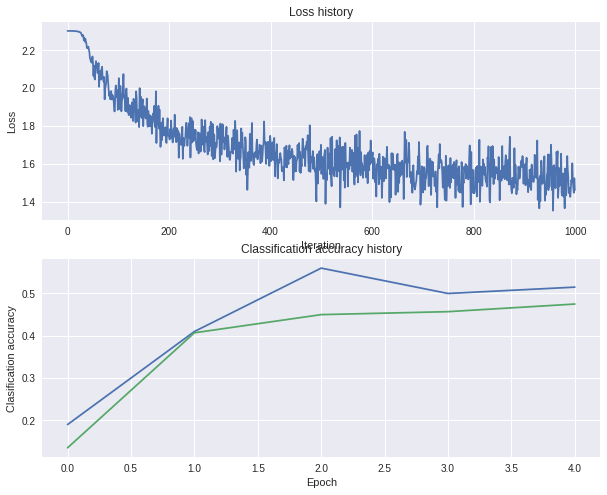

In [19]:
# Plot the loss function and train / validation accuracies
plt.subplot(2, 1, 1)
plt.plot(stats['loss_history'])
plt.title('Loss history')
plt.xlabel('Iteration')
plt.ylabel('Loss')

plt.subplot(2, 1, 2)
plt.plot(stats['train_acc_history'], label='train')
plt.plot(stats['val_acc_history'], label='val')
plt.title('Classification accuracy history')
plt.xlabel('Epoch')
plt.ylabel('Clasification accuracy')
plt.show()

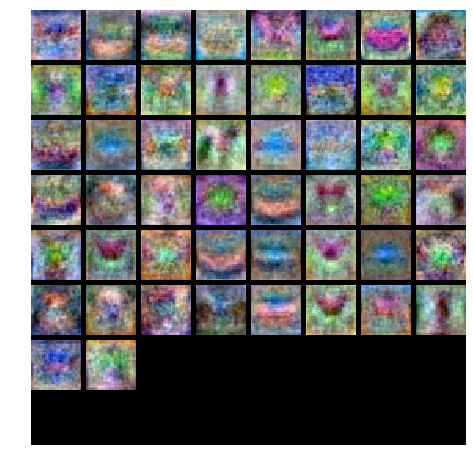

In [21]:
from drive.Stanford.CS231n_master.assignment1.cs231n.vis_utils import visualize_grid

# Visualize the weights of the network

def show_net_weights(net):
  W1 = net.params['W1']
  W1 = W1.reshape(32, 32, 3, -1).transpose(3, 0, 1, 2)
  plt.imshow(visualize_grid(W1, padding=3).astype('uint8'))
  plt.gca().axis('off')
  plt.show()

show_net_weights(net)

# Tune your hyperparameters

**What's wrong?**. Looking at the visualizations above, we see that the loss is decreasing more or less linearly, which seems to suggest that the learning rate may be too low. Moreover, there is no gap between the training and validation accuracy, suggesting that the model we used has low capacity, and that we should increase its size. On the other hand, with a very large model we would expect to see more overfitting, which would manifest itself as a very large gap between the training and validation accuracy.

**Tuning**. Tuning the hyperparameters and developing intuition for how they affect the final performance is a large part of using Neural Networks, so we want you to get a lot of practice. Below, you should experiment with different values of the various hyperparameters, including hidden layer size, learning rate, numer of training epochs, and regularization strength. You might also consider tuning the learning rate decay, but you should be able to get good performance using the default value.

**Approximate results**. You should be aim to achieve a classification accuracy of greater than 48% on the validation set. Our best network gets over 52% on the validation set.

**Experiment**: You goal in this exercise is to get as good of a result on CIFAR-10 as you can, with a fully-connected Neural Network. For every 1% above 52% on the Test set we will award you with one extra bonus point. Feel free implement your own techniques (e.g. PCA to reduce dimensionality, or adding dropout, or adding features to the solver, etc.).

In [22]:
best_net = None # store the best model into this 
#learning_rates = [1e-3, 1.2e-3, 1.4e-3, 1.6e-3, 1.8e-3]
#regularization_strengths = [1e-4, 1e-3, 1e-2]
learning_rates = [1.6e-3]
regularization_strengths = [1e-2]
hidden_size = 400
results = {}
best_val = -1
#################################################################################
# TODO: Tune hyperparameters using the validation set. Store your best trained  #
# model in best_net.                                                            #
#                                                                               #
# To help debug your network, it may help to use visualizations similar to the  #
# ones we used above; these visualizations will have significant qualitative    #
# differences from the ones we saw above for the poorly tuned network.          #
#                                                                               #
# Tweaking hyperparameters by hand can be fun, but you might find it useful to  #
# write code to sweep through possible combinations of hyperparameters          #
# automatically like we did on the previous exercises.                          #
#################################################################################
for lr in learning_rates:
    for rs in regularization_strengths:
        net = TwoLayerNet(input_size, hidden_size, num_classes)
        stats = net.train(X_train, y_train, X_val, y_val,
            num_iters=2000, batch_size=400,
            learning_rate=lr, learning_rate_decay=0.9,
            reg=rs, verbose=True)        
        y_train_pred = net.predict(X_train)
        acc_tr = np.mean(y_train == y_train_pred)
        y_val_pred = net.predict(X_val)
        acc_val = np.mean(y_val == y_val_pred)
        
        results[(lr, rs)] = (acc_tr, acc_val)
        if acc_val > best_val:
            best_val = acc_val
            best_net = net
            
for lr, reg in sorted(results):
    train_accuracy, val_accuracy = results[(lr, reg)]
    print ('lr %e reg %e train accuracy: %f val accuracy: %f' % (
                lr, reg, train_accuracy, val_accuracy))
    
print ('best validation accuracy achieved during cross-validation: %f' % best_val)
#################################################################################
#                               END OF YOUR CODE                                #
#################################################################################

W1 : [[-5.96623906e-07 -9.69494322e-05  3.96995084e-05 ...  2.64278847e-05
   9.46417850e-05 -6.39070824e-05]
 [ 2.51632536e-05 -1.32887106e-04 -4.96884931e-05 ...  1.70262257e-05
   6.89592212e-05 -6.21745631e-05]
 [-5.98230772e-05  3.61825694e-05 -6.38388869e-06 ...  9.64283530e-06
   1.65201337e-04  2.94097653e-05]
 ...
 [ 5.61046913e-05  1.65185332e-04 -7.00984953e-05 ...  2.72028470e-05
   1.36313621e-04  1.51062306e-04]
 [ 8.49362774e-05 -7.26918594e-05 -7.06791680e-05 ... -2.34341401e-04
  -1.73407316e-04  7.20226701e-05]
 [-7.32010579e-05  1.93402317e-05  5.31913173e-05 ...  5.15657363e-05
   7.29655769e-05 -9.42511365e-05]]
b1 : [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

W1 : [[-5.16862125e-06 -9.61084474e-05  3.96371731e-05 ...  2.42151344e-05
   9.67101452e-05 -6.66276713e-05]
 [ 2.06018406e-05 -1.31181214e-04 -4.95222811e-05 ...  1.44644961e-05
   7.30270045e-05 -6.34054668e-05]
 [-6.67623660e-05  3.90713454e-05 -5.67379117e-06 ...  4.72629819e-06
   1.71245385e-04  2.93802387e-05]
 ...
 [ 5.48880560e-05  1.63683888e-04 -6.95036370e-05 ...  2.50916315e-05
   1.38066877e-04  1.48420839e-04]
 [ 8.40759613e-05 -7.35486617e-05 -7.05228870e-05 ... -2.35849273e-04
  -1.71308640e-04  7.05782284e-05]
 [-7.61620943e-05  1.88102994e-05  5.39302629e-05 ...  4.91240976e-05
   7.39045492e-05 -9.49213435e-05]]
b1 : [ 9.25461180e-08 -5.62244844e-09  7.10682796e-08  8.66352036e-09
  7.45344656e-08  4.33608767e-09 -1.19931764e-08  2.31531375e-08
  2.51293373e-08 -1.20396222e-08 -1.74787777e-08  1.38756762e-07
 -1.50055146e-08  1.12474448e-08  1.35356622e-08 -3.60503694e-08
  6.00176253e-08  8.37097913e-08  5.46844706e-08 -1.97086180e-08
  1.26460160e-08  3.69615583e

W1 : [[-1.32344651e-05 -9.46541484e-05  3.83805217e-05 ...  1.93038561e-05
   1.02040511e-04 -6.67675859e-05]
 [ 1.07528555e-05 -1.27989146e-04 -5.05778459e-05 ...  8.02807437e-06
   8.08545953e-05 -6.23715470e-05]
 [-8.15406817e-05  4.47204852e-05 -5.93221032e-06 ... -5.74501271e-06
   1.82977592e-04  3.20469290e-05]
 ...
 [ 5.38574250e-05  1.61562342e-04 -6.82761586e-05 ...  2.31650374e-05
   1.40329695e-04  1.48938782e-04]
 [ 8.16200367e-05 -7.40884978e-05 -6.92443206e-05 ... -2.38287224e-04
  -1.67960613e-04  7.18626157e-05]
 [-8.27865817e-05  2.00113761e-05  5.53034800e-05 ...  4.50078058e-05
   7.71097108e-05 -9.27006734e-05]]
b1 : [ 2.78826133e-07  5.90794322e-08  1.60835651e-07  6.51141119e-08
  2.88719453e-07  7.34184658e-08 -3.47067440e-09  7.21403073e-08
  2.06632680e-07  6.52448837e-09 -1.11149549e-08  4.47821473e-07
 -3.82648078e-09  2.17891308e-08  3.57151342e-08  3.11843336e-08
  1.39744938e-07  2.62190150e-07  2.51948859e-07  1.69591817e-08
  1.46237355e-07  1.79647453e

[ 6.89379707e-07  1.80549079e-07  2.66355612e-07  1.93977232e-07
  7.10020804e-07  2.81203260e-07  4.17330315e-08  2.53712671e-07
  4.87773181e-07  9.11022742e-08  3.76392956e-08  1.16725425e-06
  5.07152969e-08  6.41012413e-08  6.61654063e-08  1.29689676e-07
  3.16080372e-07  6.98620969e-07  5.94365945e-07  1.46952961e-07
  3.84122499e-07  8.93160847e-08  6.38427169e-07  5.04675543e-07
  5.47128734e-07  1.06845514e-06  3.92998894e-07  8.49208642e-07
  4.11710920e-07  4.55314798e-07  3.91252870e-07  5.60370726e-09
  5.21379277e-07  3.84129573e-07  2.96262170e-07  2.33699651e-07
  3.65673635e-07  1.15052878e-07  6.64777764e-09  3.46050769e-07
  1.01864613e-06  6.68844783e-07  1.30905185e-06  4.06049424e-07
  5.89413914e-07  1.19671029e-07  7.79801193e-09  2.45299531e-07
  3.89975846e-07  9.23615958e-08  3.32583240e-07  6.37455394e-07
  3.33218082e-07  4.41580543e-07  9.07345406e-07  7.40277667e-08
  5.02745357e-07  5.42747177e-07  1.36697688e-08  2.72772322e-08
  3.81647026e-07  1.16171

 [[-5.69002380e-05 -9.94052432e-05  3.37640126e-05 ... -9.48840667e-06
   1.02284261e-04 -6.98898696e-05]
 [-4.83805287e-05 -1.22719550e-04 -5.79159856e-05 ... -3.05729440e-05
   9.21863437e-05 -6.21273484e-05]
 [-1.69467325e-04  6.59192311e-05 -1.23545367e-05 ... -6.61249674e-05
   2.15117116e-04  3.71558278e-05]
 ...
 [ 5.04099514e-05  1.46670300e-04 -5.77449709e-05 ...  1.64230213e-05
   1.38265221e-04  1.51941657e-04]
 [ 6.82845695e-05 -8.18045055e-05 -6.09646920e-05 ... -2.50588462e-04
  -1.66093875e-04  7.65200614e-05]
 [-1.18002631e-04  2.28092321e-05  6.63280709e-05 ...  1.82461759e-05
   8.20117351e-05 -8.65235334e-05]]
b1 : [ 1.49614530e-06  2.91299523e-07  6.06698544e-07  4.91681952e-07
  1.10541689e-06  7.03130408e-07  1.32302751e-07  5.51083929e-07
  7.43741530e-07  2.68726105e-07  1.63949293e-07  2.53867838e-06
  1.29724327e-07  1.27587254e-07  1.09307100e-07  4.20117091e-07
  6.64965956e-07  1.50792511e-06  9.18338206e-07  4.07897048e-07
  6.17514532e-07  2.19872868e-07 

W1 : [[-7.08954781e-05 -1.06601303e-04  2.98538334e-05 ... -1.71591978e-05
   9.85932437e-05 -7.17503582e-05]
 [-7.69702636e-05 -1.25954387e-04 -6.67824770e-05 ... -4.57570067e-05
   9.31128176e-05 -6.34268473e-05]
 [-2.29009729e-04  6.97768330e-05 -2.21271273e-05 ... -1.06153361e-04
   2.25132717e-04  3.84345889e-05]
 ...
 [ 5.45712681e-05  1.34353251e-04 -4.76780751e-05 ...  1.91841512e-05
   1.37061784e-04  1.53286163e-04]
 [ 6.44325178e-05 -8.94411488e-05 -5.43255274e-05 ... -2.51102933e-04
  -1.67448376e-04  7.74399311e-05]
 [-1.45446136e-04  2.19008625e-05  7.42825945e-05 ... -1.62593186e-06
   7.95390717e-05 -8.51529711e-05]]
b1 : [2.36840968e-06 3.83836039e-07 1.02713897e-06 8.25379520e-07
 1.41895378e-06 1.18435528e-06 2.36140775e-07 8.87235234e-07
 8.21770104e-07 5.31586312e-07 3.42640838e-07 3.97490205e-06
 2.08818667e-07 2.41625773e-07 1.87190229e-07 8.31419302e-07
 1.14314858e-06 2.39468567e-06 1.13280804e-06 7.34897977e-07
 9.03581858e-07 4.11057335e-07 1.17996060e-06 1.2

W1 : [[-7.04498985e-05 -1.14288826e-04  1.69780697e-05 ... -1.37977697e-05
   9.82720153e-05 -7.76552558e-05]
 [-8.63722629e-05 -1.30211935e-04 -8.37144269e-05 ... -4.79028664e-05
   9.91320723e-05 -6.76800205e-05]
 [-2.69165572e-04  7.21955384e-05 -4.07543580e-05 ... -1.32034414e-04
   2.42131617e-04  3.69753333e-05]
 ...
 [ 5.68963008e-05  1.19971559e-04 -4.76741030e-05 ...  2.41406980e-05
   1.37110098e-04  1.54101380e-04]
 [ 6.17872290e-05 -9.91977430e-05 -5.92790919e-05 ... -2.46037990e-04
  -1.68517684e-04  7.79169460e-05]
 [-1.71589626e-04  1.90909297e-05  7.05422284e-05 ... -1.52721203e-05
   7.76239272e-05 -8.34341497e-05]]
b1 : [3.08675974e-06 4.73267518e-07 1.34462311e-06 1.08815754e-06
 1.70873009e-06 1.53466161e-06 3.13353583e-07 1.21254965e-06
 8.30929455e-07 8.81162573e-07 4.74735856e-07 5.04894238e-06
 2.75789100e-07 3.27048860e-07 2.58139414e-07 1.12104516e-06
 1.50494129e-06 3.08363828e-06 1.34531215e-06 1.10070200e-06
 1.06484816e-06 6.09748800e-07 1.41980456e-06 1.5

W1 : [[-5.92663760e-05 -1.14810499e-04  1.11613305e-05 ... -1.24386795e-05
   9.59708751e-05 -8.46925144e-05]
 [-8.43775582e-05 -1.28682604e-04 -9.23890882e-05 ... -4.67208910e-05
   9.99075645e-05 -7.31525639e-05]
 [-2.91967891e-04  7.75742403e-05 -4.91024556e-05 ... -1.49762828e-04
   2.51174038e-04  3.66274950e-05]
 ...
 [ 5.75452195e-05  1.11281694e-04 -4.27105144e-05 ...  2.32683313e-05
   1.40390432e-04  1.56146501e-04]
 [ 5.97641874e-05 -1.03528475e-04 -6.08749146e-05 ... -2.45569335e-04
  -1.70832724e-04  7.75978020e-05]
 [-1.83180790e-04  2.04222369e-05  6.80517041e-05 ... -2.76511433e-05
   6.40118235e-05 -8.47480767e-05]]
b1 : [3.83064117e-06 6.12145934e-07 1.87807731e-06 1.30512535e-06
 2.07061350e-06 1.89104564e-06 4.77385503e-07 1.53978227e-06
 8.05337113e-07 1.25155238e-06 6.03355621e-07 5.97120428e-06
 3.78375707e-07 4.65798379e-07 3.72220747e-07 1.66754817e-06
 2.02821241e-06 3.96053865e-06 1.44467477e-06 1.50606540e-06
 1.33384038e-06 8.31580815e-07 1.69175703e-06 1.7

W1 : [[-5.31570436e-05 -1.18082363e-04  5.70569444e-06 ... -7.99551303e-06
   9.59585596e-05 -8.91899354e-05]
 [-8.51587264e-05 -1.31589688e-04 -9.73834178e-05 ... -4.38404125e-05
   1.09348032e-04 -7.36686113e-05]
 [-3.22337173e-04  7.60486666e-05 -5.29171376e-05 ... -1.73674977e-04
   2.73034119e-04  4.15162757e-05]
 ...
 [ 5.20199497e-05  9.98075955e-05 -2.75804881e-05 ...  2.21819840e-05
   1.43955588e-04  1.61947399e-04]
 [ 4.59471886e-05 -1.09368101e-04 -5.11116095e-05 ... -2.49327006e-04
  -1.67401888e-04  8.32951487e-05]
 [-2.18233260e-04  1.94991595e-05  7.58324542e-05 ... -5.14169040e-05
   5.80635752e-05 -7.99528352e-05]]
b1 : [4.79127433e-06 6.30686548e-07 2.40609848e-06 1.59551092e-06
 2.16693157e-06 2.47415467e-06 5.30202296e-07 1.75697597e-06
 7.99927481e-07 1.90180768e-06 7.93219058e-07 7.28940528e-06
 4.28521907e-07 5.54820488e-07 4.65487632e-07 2.19723926e-06
 2.45886545e-06 4.76547845e-06 1.39840309e-06 2.13508629e-06
 1.50780674e-06 1.06639606e-06 1.73567808e-06 1.7

W1 : [[-5.03107678e-05 -1.22728693e-04  1.15880485e-05 ... -5.34361869e-06
   1.01687895e-04 -8.82601342e-05]
 [-8.39873784e-05 -1.34903599e-04 -1.00576002e-04 ... -3.46562093e-05
   1.13888053e-04 -7.59734350e-05]
 [-3.39863534e-04  7.66451986e-05 -6.56071885e-05 ... -1.91877729e-04
   2.81253512e-04  3.92646169e-05]
 ...
 [ 5.49059451e-05  8.98170476e-05 -1.05180997e-05 ...  8.71508485e-06
   1.54271542e-04  1.68633175e-04]
 [ 4.80852325e-05 -1.16696500e-04 -4.31167091e-05 ... -2.53211007e-04
  -1.62152663e-04  8.74064091e-05]
 [-2.40131790e-04  1.66083366e-05  7.45557050e-05 ... -7.40015481e-05
   5.32179456e-05 -7.79795810e-05]]
b1 : [5.60666459e-06 7.26634669e-07 2.78352238e-06 1.74724116e-06
 2.49079559e-06 2.91599098e-06 6.09572564e-07 2.16200422e-06
 8.63382638e-07 2.51995620e-06 9.25292986e-07 8.44227147e-06
 5.33809865e-07 6.82046932e-07 5.22708883e-07 2.60056579e-06
 2.73963546e-06 5.60607994e-06 1.46254400e-06 2.65170662e-06
 1.68325588e-06 1.31931987e-06 1.90369871e-06 1.7

W1 : [[-3.68874562e-05 -1.22433554e-04  1.98197057e-05 ...  4.20015588e-06
   9.79316491e-05 -9.31962911e-05]
 [-6.44806728e-05 -1.37415689e-04 -9.22771289e-05 ... -1.61214343e-05
   1.17416733e-04 -7.90420857e-05]
 [-3.37123921e-04  7.53109384e-05 -6.24903563e-05 ... -1.90817907e-04
   2.90897749e-04  3.86889702e-05]
 ...
 [ 6.00922015e-05  7.99867720e-05  3.14288935e-06 ...  2.74857453e-05
   1.64021474e-04  1.80033739e-04]
 [ 5.73813380e-05 -1.25118014e-04 -3.80891640e-05 ... -2.28074951e-04
  -1.60254292e-04  9.43500356e-05]
 [-2.57809036e-04  1.53146402e-05  6.07355442e-05 ... -6.79664042e-05
   4.27213903e-05 -7.47756212e-05]]
b1 : [5.97135051e-06 8.08215680e-07 3.13472756e-06 1.99661625e-06
 2.93502316e-06 3.33740182e-06 7.54929561e-07 2.98831981e-06
 6.76212769e-07 3.14642580e-06 1.07188425e-06 9.09896638e-06
 6.81449251e-07 9.15131827e-07 6.43234141e-07 3.00636409e-06
 3.06473068e-06 5.78917096e-06 1.66676692e-06 3.12154716e-06
 1.90666860e-06 1.48062526e-06 2.20727257e-06 2.1

W1 : [[-5.45087107e-05 -1.17323668e-04  3.46607707e-05 ... -6.59597860e-06
   1.01633911e-04 -9.39777876e-05]
 [-7.27922749e-05 -1.35808719e-04 -7.36456060e-05 ... -2.08903469e-05
   1.32506932e-04 -7.67682323e-05]
 [-3.69522302e-04  7.53426283e-05 -5.18130564e-05 ... -2.06809668e-04
   3.13294926e-04  4.06234347e-05]
 ...
 [ 5.24995632e-05  7.51795852e-05  1.96821044e-05 ...  1.87802965e-05
   1.54890917e-04  1.85067467e-04]
 [ 5.37497442e-05 -1.28070766e-04 -3.31045269e-05 ... -2.32062412e-04
  -1.73108415e-04  9.59663948e-05]
 [-2.90130563e-04  1.50651199e-05  3.94371856e-05 ... -8.26306262e-05
   9.02797642e-06 -8.12655978e-05]]
b1 : [6.87588380e-06 7.61485236e-07 3.24400802e-06 2.17693751e-06
 2.98082202e-06 3.86403085e-06 6.78839194e-07 3.34071387e-06
 4.92786411e-07 3.84047699e-06 1.23993397e-06 1.02277507e-05
 7.70568874e-07 9.79664945e-07 6.43418885e-07 3.20966171e-06
 3.31024701e-06 6.33538111e-06 1.57765055e-06 3.77673852e-06
 1.80217779e-06 1.73842068e-06 2.07980746e-06 1.9

W1 : [[-4.68816930e-05 -1.10205999e-04  5.96959775e-05 ... -1.01026153e-05
   9.86156647e-05 -9.12720550e-05]
 [-6.01895928e-05 -1.31798931e-04 -5.71904670e-05 ... -1.44163048e-05
   1.38849987e-04 -7.45708801e-05]
 [-3.68040166e-04  8.06812625e-05 -4.09904738e-05 ... -2.18867573e-04
   3.37333108e-04  4.76677249e-05]
 ...
 [ 5.80534824e-05  7.14139199e-05  5.82900336e-05 ...  1.54262161e-05
   1.48129886e-04  1.92839480e-04]
 [ 5.96157718e-05 -1.27476746e-04 -1.17073632e-05 ... -2.24862854e-04
  -1.82542564e-04  9.98253695e-05]
 [-3.07478563e-04  1.96076506e-05  4.75470179e-05 ... -9.08252774e-05
  -1.26136650e-05 -7.68117160e-05]]
b1 : [7.53759058e-06 7.85632738e-07 3.44357212e-06 2.31321233e-06
 3.27233203e-06 4.12089818e-06 6.12672271e-07 3.71011596e-06
 3.28526291e-07 4.41384619e-06 1.35346614e-06 1.09754341e-05
 9.44957136e-07 1.02796861e-06 6.47166586e-07 3.53630108e-06
 3.44923729e-06 6.49849269e-06 1.67074980e-06 4.18862259e-06
 1.70182537e-06 1.83618446e-06 2.04545664e-06 2.0

 [[-5.19556725e-05 -1.05297007e-04  7.46603733e-05 ... -1.90826952e-05
   1.03819878e-04 -9.04598902e-05]
 [-5.88003067e-05 -1.29003177e-04 -5.19248680e-05 ... -1.13333656e-05
   1.56262154e-04 -7.36892850e-05]
 [-3.78436831e-04  8.12961136e-05 -4.57413305e-05 ... -2.32103845e-04
   3.67377739e-04  5.09903011e-05]
 ...
 [ 3.87622421e-05  6.60898494e-05  4.65543734e-05 ... -1.74876182e-06
   1.55564299e-04  1.94436672e-04]
 [ 4.51588178e-05 -1.30148480e-04 -3.85819889e-05 ... -2.30883475e-04
  -1.85387100e-04  9.81450750e-05]
 [-3.45980522e-04  2.01551079e-05  1.33472416e-05 ... -1.15808972e-04
  -3.44891113e-05 -8.02575958e-05]]
b1 : [ 8.11916140e-06  8.17263958e-07  3.77885895e-06  2.57369243e-06
  3.48213901e-06  4.59304119e-06  6.53085254e-07  4.06430205e-06
  3.39611059e-07  4.98422662e-06  1.58018577e-06  1.18890686e-05
  9.94830216e-07  1.09428187e-06  6.97813023e-07  4.05837122e-06
  3.57588974e-06  6.77757143e-06  1.86626948e-06  4.80228581e-06
  2.02213015e-06  2.14186811e-06 

W1 : [[-4.99715005e-05 -1.05158465e-04  9.19228780e-05 ... -2.51828892e-05
   9.55809358e-05 -9.39729405e-05]
 [-4.68959102e-05 -1.29319798e-04 -4.07131250e-05 ... -8.10065957e-06
   1.62184911e-04 -7.54667129e-05]
 [-3.82894052e-04  7.90978536e-05 -4.09860389e-05 ... -2.55560643e-04
   3.83574931e-04  5.35385527e-05]
 ...
 [ 4.81402766e-05  5.84948840e-05  7.79258182e-05 ...  3.47467466e-06
   1.60774042e-04  2.05408638e-04]
 [ 5.61618983e-05 -1.32124898e-04 -2.31677165e-05 ... -2.15033215e-04
  -1.87074323e-04  1.06183212e-04]
 [-3.53999420e-04  2.10527899e-05  1.37240544e-05 ... -1.14982797e-04
  -6.38017399e-05 -7.32548029e-05]]
b1 : [ 8.74126928e-06  8.28024906e-07  4.16579916e-06  2.73781833e-06
  3.63425007e-06  4.88834861e-06  6.34623474e-07  4.54712887e-06
  3.13524553e-07  5.56542429e-06  1.70805221e-06  1.27205695e-05
  1.17445729e-06  1.24795885e-06  7.27075792e-07  4.69665721e-06
  3.71872186e-06  6.94079332e-06  1.74513959e-06  5.16991605e-06
  2.15378879e-06  2.29156776e

W1 : [[-5.91202912e-05 -1.03915725e-04  9.23583170e-05 ... -4.05040639e-05
   1.10962666e-04 -9.38176144e-05]
 [-4.71525594e-05 -1.29881563e-04 -4.66757970e-05 ... -1.68194041e-05
   1.84483231e-04 -8.14020661e-05]
 [-4.02325543e-04  7.90086673e-05 -6.18998375e-05 ... -2.93224322e-04
   4.21024402e-04  4.47831527e-05]
 ...
 [ 6.59897864e-05  5.14111644e-05  9.70490387e-05 ...  4.13277724e-06
   1.74703232e-04  2.23749169e-04]
 [ 8.32024953e-05 -1.35596331e-04 -1.00266884e-05 ... -1.99565323e-04
  -1.89358033e-04  1.15375586e-04]
 [-3.43310173e-04  2.03180852e-05  1.78637388e-05 ... -1.14014893e-04
  -8.90616434e-05 -6.82864556e-05]]
b1 : [ 9.58683053e-06  8.26807589e-07  4.44908918e-06  3.00724402e-06
  3.73589103e-06  5.53402074e-06  7.16629584e-07  4.76418619e-06
  2.33011093e-08  6.03037365e-06  1.92311150e-06  1.38884628e-05
  1.27910752e-06  1.32203729e-06  7.69003454e-07  5.16812231e-06
  3.83626857e-06  7.62431147e-06  1.70865935e-06  5.81726104e-06
  2.10684717e-06  2.54491553e

W1 : [[-6.23042180e-05 -9.96211624e-05  9.19647539e-05 ... -6.16325887e-05
   1.12418410e-04 -9.79599556e-05]
 [-3.90874192e-05 -1.29604698e-04 -5.66618500e-05 ... -2.58137626e-05
   1.97638013e-04 -8.64069690e-05]
 [-4.10185748e-04  7.70323980e-05 -7.21786072e-05 ... -3.07170443e-04
   4.51024454e-04  4.58396088e-05]
 ...
 [ 5.52151549e-05  4.81991677e-05  1.19270987e-04 ... -1.97735313e-06
   1.95517805e-04  2.36784918e-04]
 [ 7.83472790e-05 -1.38078694e-04  4.96075462e-06 ... -1.98359283e-04
  -1.80819853e-04  1.25138509e-04]
 [-3.60053457e-04  1.86397551e-05  3.35898461e-05 ... -1.19445181e-04
  -1.10703453e-04 -5.64655770e-05]]
b1 : [ 9.95057594e-06  7.93632919e-07  5.12994974e-06  3.05973454e-06
  3.70130704e-06  5.57225834e-06  6.97802821e-07  4.93026820e-06
  2.03953174e-07  6.57613742e-06  2.05871005e-06  1.44899999e-05
  1.32934882e-06  1.33507282e-06  7.69444748e-07  6.21464922e-06
  4.15495540e-06  7.72684355e-06  1.61081063e-06  6.12927223e-06
  2.23398710e-06  2.68049376e

iteration 100 / 2000: loss 1.821605
W1 : [[-7.37290927e-05 -9.37258385e-05  8.89848988e-05 ... -7.29159554e-05
   1.04189632e-04 -1.17569291e-04]
 [-3.95736090e-05 -1.25022517e-04 -6.79139639e-05 ... -2.18468848e-05
   1.98829233e-04 -1.03583745e-04]
 [-4.22826712e-04  8.26830366e-05 -7.94710718e-05 ... -3.20013205e-04
   4.64013391e-04  3.84826530e-05]
 ...
 [ 5.86303907e-05  4.94402388e-05  1.16230142e-04 ... -2.44830331e-05
   2.05824661e-04  2.32811058e-04]
 [ 9.91813824e-05 -1.34581818e-04 -9.77890353e-06 ... -2.03140628e-04
  -1.85593891e-04  1.16847635e-04]
 [-3.48472412e-04  2.65858469e-05  2.22041241e-05 ... -1.30759259e-04
  -1.50177339e-04 -6.31004603e-05]]
b1 : [ 1.06291943e-05  8.10806655e-07  5.28606882e-06  3.10197360e-06
  4.05277912e-06  6.02844771e-06  7.01536122e-07  5.03386790e-06
  4.73446741e-07  6.85340576e-06  2.16055146e-06  1.53581886e-05
  1.31382722e-06  1.33375010e-06  7.61969272e-07  6.58738770e-06
  4.32065819e-06  7.68322886e-06  1.80605994e-06  7.025181

W1 : [[-8.87024733e-05 -8.34175180e-05  1.16510240e-04 ... -8.29673898e-05
   8.40446513e-05 -1.30410523e-04]
 [-4.88117017e-05 -1.16705837e-04 -4.43847366e-05 ... -2.45883015e-05
   2.05485192e-04 -1.06528939e-04]
 [-4.45923901e-04  9.04970568e-05 -6.18108657e-05 ... -3.39375330e-04
   5.00903169e-04  4.74745759e-05]
 ...
 [ 8.24523388e-05  4.72076760e-05  1.33886743e-04 ... -2.53751867e-05
   1.90205650e-04  2.27001304e-04]
 [ 1.21685411e-04 -1.34868816e-04 -5.72271252e-06 ... -2.03676080e-04
  -2.03475591e-04  1.13575993e-04]
 [-3.47650752e-04  2.99190844e-05  2.26721591e-05 ... -1.44548169e-04
  -1.98643112e-04 -5.80238859e-05]]
b1 : [ 1.17359455e-05  8.09638233e-07  5.83507606e-06  3.21655298e-06
  4.14378390e-06  6.47782604e-06  6.35299192e-07  5.24813363e-06
  2.85730663e-07  7.21241447e-06  2.33477888e-06  1.64597942e-05
  1.35061379e-06  1.39545992e-06  7.34351396e-07  7.10836232e-06
  4.65626041e-06  8.01475544e-06  1.60722554e-06  7.57071866e-06
  2.51616498e-06  3.37355769e

W1 : [[-1.08001311e-04 -8.84737128e-05  1.09778029e-04 ... -1.10551607e-04
   1.05365170e-04 -1.33267119e-04]
 [-5.51340851e-05 -1.21199016e-04 -5.81320063e-05 ... -4.26046805e-05
   2.34818683e-04 -1.10860513e-04]
 [-4.66883462e-04  8.47378092e-05 -7.68644224e-05 ... -3.70227742e-04
   5.34180187e-04  4.54229102e-05]
 ...
 [ 8.02608807e-05  4.23878110e-05  1.59042055e-04 ... -4.31337860e-05
   2.51002438e-04  2.48410618e-04]
 [ 1.30962023e-04 -1.37784249e-04  1.28763343e-06 ... -2.08172733e-04
  -1.64451388e-04  1.25963667e-04]
 [-3.56735590e-04  2.89185487e-05  2.56408048e-05 ... -1.61897065e-04
  -1.96301007e-04 -4.76130189e-05]]
b1 : [ 1.21312807e-05  7.31334041e-07  5.84075961e-06  3.43571266e-06
  4.09048269e-06  6.57789566e-06  5.60091722e-07  5.53332252e-06
  9.64609815e-08  7.62441669e-06  2.57326755e-06  1.74601598e-05
  1.45348426e-06  1.43249735e-06  6.24479234e-07  7.26325832e-06
  4.35703923e-06  8.01093475e-06  1.63646817e-06  7.91180779e-06
  2.64061507e-06  3.48211496e

W1 : [[-1.39407907e-04 -8.68031365e-05  1.12221263e-04 ... -9.56089716e-05
   1.08260549e-04 -1.32829768e-04]
 [-7.19231277e-05 -1.22703863e-04 -5.56877580e-05 ... -1.40091301e-05
   2.53651081e-04 -1.11175101e-04]
 [-4.94900324e-04  8.44746960e-05 -7.26246767e-05 ... -3.50462582e-04
   5.64220891e-04  5.06625699e-05]
 ...
 [ 5.29854828e-05  3.43810784e-05  1.71137674e-04 ... -5.02584397e-05
   2.99267722e-04  2.63359922e-04]
 [ 1.26833132e-04 -1.43435172e-04  1.77725988e-05 ... -2.05395440e-04
  -1.20692662e-04  1.35540949e-04]
 [-3.71892759e-04  2.42943088e-05  4.63607032e-05 ... -1.58292336e-04
  -1.99837553e-04 -4.11223399e-05]]
b1 : [ 1.26512869e-05  6.67389737e-07  6.22479411e-06  3.46503434e-06
  4.18938684e-06  6.88859423e-06  4.03120069e-07  5.52000344e-06
  8.74929442e-08  8.10287562e-06  2.62206624e-06  1.82565719e-05
  1.49700115e-06  1.41284710e-06  6.18460133e-07  7.90022373e-06
  4.51769984e-06  8.29465392e-06  1.59431444e-06  8.37397202e-06
  2.73251472e-06  3.86176332e

W1 : [[-1.55860053e-04 -8.14159652e-05  1.19535683e-04 ... -1.03828366e-04
   8.33095431e-05 -1.37042276e-04]
 [-8.89941487e-05 -1.18659979e-04 -6.35430480e-05 ... -1.59746595e-05
   2.55216565e-04 -1.14835320e-04]
 [-5.26315159e-04  8.86819557e-05 -8.63388005e-05 ... -3.73655812e-04
   5.93755554e-04  5.73263292e-05]
 ...
 [ 4.46530299e-05  3.09328302e-05  1.75200553e-04 ... -5.87695748e-05
   3.60284030e-04  2.72955956e-04]
 [ 1.18341091e-04 -1.46291764e-04  8.77514994e-06 ... -2.06541659e-04
  -6.70318792e-05  1.38096523e-04]
 [-3.91769200e-04  2.33367878e-05  5.55107541e-05 ... -1.72753382e-04
  -1.81147923e-04 -3.57471419e-05]]
b1 : [ 1.31998391e-05  5.51897592e-07  6.81393076e-06  3.90028194e-06
  4.41799811e-06  7.32092887e-06  4.31561529e-07  5.89607087e-06
  6.40153135e-08  8.98937224e-06  2.92535788e-06  1.92104751e-05
  1.52003805e-06  1.64408213e-06  6.31359979e-07  8.43224256e-06
  4.57496820e-06  8.41149689e-06  1.38010809e-06  8.93105767e-06
  2.81573639e-06  3.94905804e

W1 : [[-1.60410778e-04 -8.20211871e-05  1.50885312e-04 ... -9.38039793e-05
   8.17057647e-05 -1.26197034e-04]
 [-9.37657024e-05 -1.18258194e-04 -3.96357256e-05 ... -1.28990536e-05
   2.68290351e-04 -1.04924877e-04]
 [-5.49367209e-04  9.18321011e-05 -7.34600469e-05 ... -3.79473103e-04
   6.27233347e-04  7.32137472e-05]
 ...
 [ 4.56424563e-05  2.22544314e-05  1.48440042e-04 ... -5.88642651e-05
   4.17095207e-04  2.92415801e-04]
 [ 1.12584820e-04 -1.51256511e-04 -1.25716080e-05 ... -2.13962913e-04
  -2.55557401e-05  1.54040863e-04]
 [-4.18487095e-04  2.16932655e-05  3.95767449e-05 ... -1.85314707e-04
  -1.79869343e-04 -1.54572115e-05]]
b1 : [ 1.36622130e-05  5.87500294e-07  6.87980005e-06  3.68757606e-06
  4.55272688e-06  7.62788137e-06  3.40413100e-07  5.90473620e-06
  1.82823878e-07  9.38138646e-06  2.89067134e-06  1.98755746e-05
  1.64009510e-06  1.43937614e-06  6.47873456e-07  8.21115227e-06
  4.69464687e-06  8.27823277e-06  1.57951504e-06  9.87740674e-06
  3.01567251e-06  4.24663804e

W1 : [[-1.72092020e-04 -7.40291765e-05  1.56665525e-04 ... -9.57748032e-05
   2.58503178e-05 -1.49035378e-04]
 [-1.07329483e-04 -1.13056002e-04 -4.04330231e-05 ... -1.69436890e-05
   2.36603515e-04 -1.23869615e-04]
 [-5.68709918e-04  9.63324689e-05 -7.78440448e-05 ... -3.93689543e-04
   6.17972111e-04  6.47621397e-05]
 ...
 [ 1.40707134e-05  2.03115188e-05  1.53413095e-04 ... -7.62156065e-05
   4.16200246e-04  2.98546160e-04]
 [ 8.45732054e-05 -1.52525508e-04 -1.17181132e-05 ... -2.30344550e-04
  -4.17729741e-05  1.56548315e-04]
 [-4.56865548e-04  2.16554177e-05  5.33342749e-05 ... -1.98626597e-04
  -2.35440316e-04 -1.24607150e-05]]
b1 : [ 1.45018242e-05  5.00889759e-07  7.20855978e-06  3.87612470e-06
  4.76044337e-06  7.77582496e-06  2.63263255e-07  6.10321813e-06
  9.00702879e-08  9.87425464e-06  3.19127005e-06  2.14849256e-05
  1.34552412e-06  1.57005425e-06  5.23882332e-07  8.67478886e-06
  4.81943897e-06  8.66625459e-06  1.13362226e-06  1.05178867e-05
  3.02024676e-06  4.53365495e

 [[-1.71021296e-04 -6.94660984e-05  1.40770611e-04 ... -9.93834585e-05
   4.32767458e-05 -1.51788249e-04]
 [-1.04475729e-04 -1.10963449e-04 -7.38615061e-05 ... -1.92147477e-05
   2.72746784e-04 -1.37875840e-04]
 [-5.81476763e-04  9.53872580e-05 -1.21604966e-04 ... -4.07222091e-04
   6.70837294e-04  4.42830306e-05]
 ...
 [ 2.59801827e-07  2.17960802e-05  1.75999060e-04 ... -6.86051950e-05
   4.34368375e-04  3.15589503e-04]
 [ 8.27175856e-05 -1.49146729e-04 -2.44285284e-06 ... -2.16289313e-04
  -3.91429171e-05  1.56837538e-04]
 [-4.72077960e-04  2.63071498e-05  7.04406588e-05 ... -1.92974873e-04
  -2.69708868e-04 -1.56654883e-05]]
b1 : [ 1.49671210e-05  4.56528372e-07  7.21073843e-06  3.86512759e-06
  4.67573174e-06  7.96881151e-06  2.64056876e-07  5.96137801e-06
 -1.19903567e-07  1.07111164e-05  3.29562780e-06  2.19687934e-05
  1.44366532e-06  1.47448499e-06  5.64149341e-07  8.74208417e-06
  4.55282220e-06  8.83146847e-06  9.06313484e-07  1.09559593e-05
  3.12098939e-06  4.55191743e-06 

W1 : [[-1.82167007e-04 -7.25876881e-05  1.36312576e-04 ... -1.07980982e-04
   1.04496373e-04 -1.40382249e-04]
 [-1.23817669e-04 -1.13532839e-04 -8.92971268e-05 ... -3.25416625e-05
   3.31799319e-04 -1.27535302e-04]
 [-6.02158914e-04  9.62954211e-05 -1.59646879e-04 ... -4.16744361e-04
   7.19617565e-04  5.37844911e-05]
 ...
 [ 6.27345714e-06  1.41415398e-05  1.72909350e-04 ... -7.77009937e-05
   5.00495873e-04  3.20960494e-04]
 [ 8.38842246e-05 -1.52597550e-04 -8.58036596e-06 ... -2.38763974e-04
   2.10317516e-05  1.56234710e-04]
 [-4.64985795e-04  2.54226858e-05  6.18386627e-05 ... -2.09122075e-04
  -2.48772389e-04 -1.84946367e-05]]
b1 : [ 1.59197700e-05  5.48573815e-07  7.33574491e-06  4.01390421e-06
  4.96415519e-06  8.21227199e-06  2.36283068e-07  5.64009251e-06
 -1.85394859e-07  1.18969014e-05  3.44792156e-06  2.29065597e-05
  1.56463619e-06  1.36075936e-06  5.42750950e-07  8.74996106e-06
  4.68405918e-06  9.00805016e-06  1.22480355e-06  1.15331679e-05
  3.73509507e-06  4.76658798e

W1 : [[-2.04186315e-04 -7.62486467e-05  1.26023408e-04 ... -1.13470893e-04
   6.28346976e-05 -1.49351201e-04]
 [-1.48271077e-04 -1.16277946e-04 -1.16048921e-04 ... -4.04848968e-05
   2.87745629e-04 -1.39835475e-04]
 [-6.24132593e-04  9.04329322e-05 -1.91625242e-04 ... -4.29466407e-04
   7.10037855e-04  4.35069572e-05]
 ...
 [ 5.79024914e-06  1.14802964e-05  1.89463898e-04 ... -6.59557783e-05
   4.97066309e-04  3.37214764e-04]
 [ 8.32510678e-05 -1.53543871e-04 -5.06641516e-07 ... -2.20358058e-04
   9.70133491e-06  1.68039612e-04]
 [-4.71525228e-04  2.29534471e-05  9.22758417e-05 ... -2.02034226e-04
  -2.71847170e-04 -2.05451839e-06]]
b1 : [ 1.68401397e-05  4.31876723e-07  7.91909147e-06  4.18501089e-06
  4.78127825e-06  8.66029045e-06  1.12797709e-07  5.57287824e-06
 -3.74495972e-07  1.26735491e-05  3.66641287e-06  2.38332744e-05
  1.65837021e-06  1.17463020e-06  4.54801676e-07  9.26096591e-06
  5.00276417e-06  9.09633968e-06  1.08569971e-06  1.24948815e-05
  3.84334702e-06  5.24858726e

 [[-1.80532934e-04 -7.30752896e-05  1.29485556e-04 ... -9.99985407e-05
   7.85031151e-05 -1.59727080e-04]
 [-1.24450065e-04 -1.12551178e-04 -1.27631332e-04 ... -2.27853375e-05
   3.08277846e-04 -1.44867507e-04]
 [-6.18383168e-04  9.08232934e-05 -2.08522386e-04 ... -4.32245492e-04
   7.43743092e-04  4.92977228e-05]
 ...
 [ 5.05716976e-06  9.73177439e-06  1.55242045e-04 ... -1.00988432e-04
   5.69488746e-04  3.25477566e-04]
 [ 9.42088182e-05 -1.53781232e-04 -2.97409978e-05 ... -2.42444727e-04
   5.58291702e-05  1.55120823e-04]
 [-4.79348545e-04  2.07535195e-05  7.98854926e-05 ... -2.22512699e-04
  -2.60603767e-04 -9.32092334e-06]]
b1 : [ 1.73638939e-05  4.39996361e-07  7.98741403e-06  4.31250392e-06
  4.86475345e-06  8.87316334e-06 -3.00746323e-09  5.37256343e-06
 -5.21607511e-07  1.29660993e-05  3.86932163e-06  2.45280779e-05
  1.71086109e-06  1.11894857e-06  3.10099243e-07  9.22366057e-06
  4.62539044e-06  9.17013065e-06  8.20949165e-07  1.27542247e-05
  3.92122414e-06  5.32154489e-06 

W1 : [[-1.97894042e-04 -7.18918424e-05  1.06984070e-04 ... -1.26857278e-04
   6.49549034e-05 -1.79736160e-04]
 [-1.47726579e-04 -1.11303147e-04 -1.52950610e-04 ... -4.59685773e-05
   3.17786907e-04 -1.64226025e-04]
 [-6.58111166e-04  9.24761169e-05 -2.47392694e-04 ... -4.57844534e-04
   7.89400642e-04  3.09666308e-05]
 ...
 [ 8.64367170e-06  1.34663490e-06  1.61923496e-04 ... -9.55248100e-05
   6.12798066e-04  3.34572242e-04]
 [ 9.68752472e-05 -1.59203515e-04 -2.69409171e-05 ... -2.35956374e-04
   8.75550448e-05  1.56518879e-04]
 [-4.85225078e-04  1.80053030e-05  8.42423585e-05 ... -2.15423014e-04
  -2.70182035e-04 -1.04782776e-05]]
b1 : [ 1.75789758e-05  6.15483409e-07  7.92352398e-06  4.32971730e-06
  5.37254877e-06  8.86180482e-06 -5.96336775e-08  5.21011992e-06
 -3.13820840e-07  1.44433950e-05  4.00271895e-06  2.55077470e-05
  1.65222760e-06  1.06418784e-06  2.83029520e-07  9.20284546e-06
  4.64953157e-06  9.28940068e-06  8.23034365e-07  1.29791224e-05
  4.16910423e-06  5.67320163e

W1 : [[-2.01791762e-04 -6.35894331e-05  1.30577915e-04 ... -1.17597625e-04
   3.06721630e-05 -1.71967757e-04]
 [-1.54880390e-04 -1.05451862e-04 -1.39805003e-04 ... -3.92473461e-05
   2.92208046e-04 -1.58847934e-04]
 [-6.73267831e-04  9.13142747e-05 -2.51593598e-04 ... -4.60030499e-04
   7.67120157e-04  4.57985436e-05]
 ...
 [ 2.01663525e-05  4.14846975e-06  1.56943375e-04 ... -9.49659648e-05
   6.36895757e-04  3.46932534e-04]
 [ 9.44477436e-05 -1.57243183e-04 -4.07003212e-05 ... -2.35301442e-04
   9.21236417e-05  1.64343218e-04]
 [-4.96772617e-04  1.67907279e-05  7.64830273e-05 ... -2.33020135e-04
  -2.94622650e-04  6.42757652e-06]]
b1 : [ 1.80516151e-05  5.59600700e-07  8.29337868e-06  4.67280888e-06
  5.39229392e-06  9.04173305e-06 -2.51758975e-07  5.08799608e-06
 -5.46524324e-07  1.46540385e-05  4.27676847e-06  2.67224744e-05
  1.66999407e-06  8.47999140e-07  2.38399144e-07  9.53031102e-06
  4.74299386e-06  9.15925915e-06  5.59719134e-07  1.36304848e-05
  4.09620678e-06  5.74039027e

W1 : [[-1.97715839e-04 -6.58287141e-05  1.34911823e-04 ... -1.11490995e-04
   2.10604504e-05 -1.74748374e-04]
 [-1.46200830e-04 -1.05773624e-04 -1.31024089e-04 ... -2.90197062e-05
   2.96900097e-04 -1.67563649e-04]
 [-6.77581688e-04  9.47098815e-05 -2.49706260e-04 ... -4.53492799e-04
   7.86008795e-04  2.98056874e-05]
 ...
 [ 8.86082519e-06  1.05164273e-06  1.46250678e-04 ... -9.18618232e-05
   6.31983753e-04  3.45523474e-04]
 [ 7.49298978e-05 -1.56981371e-04 -6.94412924e-05 ... -2.40391634e-04
   8.55805860e-05  1.56953511e-04]
 [-5.36259015e-04  2.24973860e-05  5.65960380e-05 ... -2.32406156e-04
  -3.36869173e-04 -5.97112837e-06]]
b1 : [ 1.89022867e-05  6.33795492e-07  8.25674173e-06  4.74493475e-06
  5.83910757e-06  9.54242773e-06 -3.08404027e-07  5.12403556e-06
 -4.08820488e-07  1.55545209e-05  4.29929122e-06  2.74385561e-05
  1.62389308e-06  7.82112867e-07  2.34642525e-07  9.74958187e-06
  4.69493239e-06  9.43378899e-06  5.68428079e-07  1.40827659e-05
  4.59293475e-06  6.21120658e

W1 : [[-2.37049403e-04 -6.02890084e-05  1.06130176e-04 ... -1.26643465e-04
   3.99862870e-05 -1.66855257e-04]
 [-1.88786164e-04 -9.97708880e-05 -1.61493344e-04 ... -4.08621949e-05
   3.15247768e-04 -1.59084730e-04]
 [-7.25055423e-04  9.59894550e-05 -2.87900168e-04 ... -4.72253239e-04
   8.16405013e-04  4.47619674e-05]
 ...
 [ 1.29726617e-06 -3.49974516e-06  1.04335871e-04 ... -1.00806333e-04
   6.54097526e-04  3.55100105e-04]
 [ 6.71634659e-05 -1.60228128e-04 -1.12517857e-04 ... -2.53264427e-04
   1.18417888e-04  1.60542606e-04]
 [-5.61020920e-04  1.73293171e-05  2.08373139e-05 ... -2.39430210e-04
  -3.09938816e-04 -9.63701354e-07]]
b1 : [ 1.95204445e-05  5.40312463e-07  8.49066207e-06  5.23353211e-06
  5.95036861e-06  9.94221793e-06 -2.48853040e-07  5.13670519e-06
 -5.54981134e-07  1.48491434e-05  4.60061564e-06  2.80603325e-05
  1.59905652e-06  9.33767888e-07  2.05190488e-07  9.69494024e-06
  4.68075652e-06  9.90372515e-06  1.79622951e-07  1.41438625e-05
  4.24484351e-06  6.11381746e

 [[-2.11993384e-04 -6.13392258e-05  1.14771446e-04 ... -1.31149225e-04
   3.24618356e-05 -1.75074628e-04]
 [-1.68876216e-04 -1.00211422e-04 -1.51196755e-04 ... -5.05376521e-05
   3.32784908e-04 -1.63365747e-04]
 [-7.28623877e-04  9.50081663e-05 -2.95553863e-04 ... -4.92690223e-04
   8.61788165e-04  5.09102624e-05]
 ...
 [ 2.90006703e-06 -1.35238180e-05  1.15017956e-04 ... -9.78934779e-05
   6.82498209e-04  3.69269507e-04]
 [ 6.00494285e-05 -1.66328883e-04 -9.43151945e-05 ... -2.51383379e-04
   1.34544238e-04  1.71421315e-04]
 [-5.81346807e-04  1.34482810e-05  3.96022992e-05 ... -2.47705657e-04
  -3.04918435e-04  1.26273863e-05]]
b1 : [ 1.99503825e-05  5.71547410e-07  8.37352116e-06  5.27894536e-06
  6.32722291e-06  9.90623994e-06 -3.57264226e-07  5.29762173e-06
 -3.95289222e-07  1.52867105e-05  4.64419165e-06  2.82350921e-05
  1.54865668e-06  8.36247572e-07  1.38795355e-07  9.58001621e-06
  4.75567914e-06  9.65483467e-06  2.71691607e-07  1.43275636e-05
  4.17716994e-06  6.27801727e-06 

W1 : [[-2.44911281e-04 -5.97990752e-05  1.19569530e-04 ... -1.51388799e-04
   2.61540432e-05 -1.73815432e-04]
 [-2.04902504e-04 -9.81001341e-05 -1.67021607e-04 ... -7.27325782e-05
   3.01199286e-04 -1.70239814e-04]
 [-7.61679783e-04  9.53950111e-05 -3.06012217e-04 ... -5.25828265e-04
   8.08186978e-04  5.33452647e-05]
 ...
 [-8.17795929e-08 -1.05317494e-05  1.58830286e-04 ... -8.57135619e-05
   7.31000744e-04  3.87679112e-04]
 [ 4.68947264e-05 -1.61951045e-04 -5.91427986e-05 ... -2.49798128e-04
   1.57491427e-04  1.79792386e-04]
 [-5.95759177e-04  2.20508212e-05  7.89460685e-05 ... -2.52742585e-04
  -3.37132683e-04  2.31720232e-05]]
b1 : [ 2.01769889e-05  5.43937812e-07  8.26137674e-06  5.35355885e-06
  6.76438190e-06  1.00450271e-05 -5.81243029e-07  4.99087621e-06
 -3.20936658e-07  1.63187971e-05  4.77421466e-06  2.92141442e-05
  1.55990980e-06  7.27518789e-07  1.12348758e-07  9.66772955e-06
  4.80503675e-06  9.48202781e-06  3.69932764e-07  1.47362787e-05
  4.46945620e-06  6.37316788e

W1 : [[-2.42802899e-04 -5.73355561e-05  8.12413189e-05 ... -1.56426354e-04
   4.23869166e-05 -1.75607572e-04]
 [-2.15574527e-04 -9.46960746e-05 -2.10023011e-04 ... -7.21999551e-05
   3.39351153e-04 -1.73687164e-04]
 [-7.65926465e-04  9.59859481e-05 -3.55303391e-04 ... -5.26845602e-04
   8.69015844e-04  5.64779668e-05]
 ...
 [-7.23645485e-06 -1.49441060e-05  1.67757471e-04 ... -1.03919544e-04
   7.71762282e-04  3.96566844e-04]
 [ 3.47029214e-05 -1.63598862e-04 -5.28615902e-05 ... -2.64900116e-04
   2.11954563e-04  1.79731663e-04]
 [-6.14328033e-04  2.27412068e-05  8.73943466e-05 ... -2.72068152e-04
  -2.81730137e-04  2.53914909e-05]]
b1 : [ 2.06612356e-05  5.44083438e-07  8.84553180e-06  5.83584226e-06
  6.73811665e-06  1.04321574e-05 -6.31313041e-07  4.64516823e-06
 -4.97654522e-07  1.69078494e-05  5.09388046e-06  3.00080767e-05
  1.56994268e-06  7.58433310e-07 -2.36705753e-08  1.00571336e-05
  4.80466884e-06  9.62023465e-06  3.37353956e-07  1.52573154e-05
  4.40050220e-06  6.59204931e

W1 : [[-2.86414898e-04 -5.26777947e-05  1.30602772e-04 ... -1.38896796e-04
   6.17646283e-05 -1.63751138e-04]
 [-2.61333821e-04 -8.93619739e-05 -1.72569875e-04 ... -5.02496598e-05
   3.38450248e-04 -1.69524793e-04]
 [-8.23007012e-04  1.02761855e-04 -3.38602645e-04 ... -5.22870418e-04
   8.52071640e-04  5.69485342e-05]
 ...
 [-1.87886777e-06 -1.45154704e-05  1.82659719e-04 ... -9.97164890e-05
   7.91875792e-04  3.92719959e-04]
 [ 4.62059139e-05 -1.62126207e-04 -5.46401181e-05 ... -2.58475953e-04
   2.26960089e-04  1.68174632e-04]
 [-6.04504666e-04  2.75512002e-05  8.49607500e-05 ... -2.77538944e-04
  -2.86354010e-04  1.08345775e-05]]
b1 : [ 2.12551055e-05  5.30239138e-07  8.70519762e-06  5.95171517e-06
  6.67311024e-06  1.06285360e-05 -7.67779088e-07  4.50891188e-06
 -5.34643812e-07  1.71490576e-05  5.22675273e-06  3.14479698e-05
  1.57145543e-06  7.14446163e-07  1.25601488e-07  1.01620265e-05
  4.24662582e-06  9.60749755e-06  2.08026032e-08  1.56881346e-05
  4.55775625e-06  6.53735229e

W1 : [[-3.04472275e-04 -5.64808323e-05  1.44323693e-04 ... -1.61902381e-04
   5.04531483e-05 -1.82854488e-04]
 [-2.99187159e-04 -9.11604337e-05 -1.67454605e-04 ... -6.92452192e-05
   3.59426771e-04 -1.83553229e-04]
 [-8.74956279e-04  1.02040836e-04 -3.38290848e-04 ... -5.46269351e-04
   8.81604380e-04  6.04763915e-05]
 ...
 [-3.07359332e-05 -1.53241862e-05  1.76926354e-04 ... -1.12726756e-04
   7.88814166e-04  4.08488891e-04]
 [ 1.61411898e-05 -1.60454086e-04 -7.07925115e-05 ... -2.71539919e-04
   2.43850555e-04  1.75620604e-04]
 [-6.46485858e-04  3.18077103e-05  7.59135616e-05 ... -2.81658148e-04
  -3.04930068e-04  2.18980225e-05]]
b1 : [ 2.20279415e-05  5.81334196e-07  9.12581549e-06  6.26317267e-06
  7.63111392e-06  1.07970482e-05 -8.55138443e-07  4.36722859e-06
 -5.13224987e-07  1.73220539e-05  5.59010615e-06  3.25032799e-05
  1.48140581e-06  6.71924066e-07 -2.21674048e-07  1.11704485e-05
  3.81660598e-06  9.52170371e-06 -1.65294273e-07  1.60170291e-05
  4.64785176e-06  6.77898242e

W1 : [[-2.97287561e-04 -5.51906457e-05  1.37523957e-04 ... -1.42946583e-04
   1.47847330e-05 -1.89042831e-04]
 [-2.97357958e-04 -9.00768581e-05 -1.96669788e-04 ... -5.23735765e-05
   3.35469332e-04 -1.87914086e-04]
 [-8.73180882e-04  9.93627678e-05 -3.86926132e-04 ... -5.34778420e-04
   8.74957569e-04  6.87552213e-05]
 ...
 [-3.01823077e-05 -1.48031702e-05  1.78096530e-04 ... -1.07880480e-04
   7.89177228e-04  3.88106934e-04]
 [ 1.25877748e-05 -1.60018736e-04 -8.81158835e-05 ... -2.65267372e-04
   2.46091341e-04  1.50472977e-04]
 [-6.37364871e-04  3.00716770e-05  4.69320841e-05 ... -2.73367327e-04
  -3.30138771e-04 -1.09360021e-06]]
b1 : [ 2.17950076e-05  4.95527078e-07  9.27740641e-06  6.37704349e-06
  7.74740367e-06  1.08937806e-05 -1.03160586e-06  4.51202984e-06
 -3.34581204e-07  1.81381179e-05  5.57820782e-06  3.30007212e-05
  1.39051217e-06  7.53788140e-07 -1.04173080e-07  1.12336058e-05
  3.85386151e-06  9.65814330e-06  1.84586699e-08  1.62534990e-05
  5.08337031e-06  7.11550734e

W1 : [[-3.31632509e-04 -5.44779980e-05  1.08716534e-04 ... -1.73405457e-04
   5.04173147e-05 -2.06013144e-04]
 [-3.29343522e-04 -8.72282042e-05 -2.35874974e-04 ... -6.49547726e-05
   3.81775712e-04 -2.04103468e-04]
 [-9.19599741e-04  1.05875188e-04 -4.35706675e-04 ... -5.48657820e-04
   9.32495746e-04  5.35697172e-05]
 ...
 [ 1.77071294e-05 -2.42051345e-05  1.92484716e-04 ... -1.00926807e-04
   7.61587320e-04  3.94169515e-04]
 [ 4.92519785e-05 -1.66559928e-04 -9.13304658e-05 ... -2.56069991e-04
   2.54964470e-04  1.49756976e-04]
 [-6.13591181e-04  2.60130007e-05  4.27861959e-05 ... -2.78450599e-04
  -3.06474459e-04 -1.37498234e-06]]
b1 : [ 2.24006843e-05  6.17317980e-07  9.23641394e-06  6.60207495e-06
  7.84736621e-06  1.10447422e-05 -1.26811394e-06  4.37086439e-06
 -2.10018391e-07  1.67932000e-05  5.82744199e-06  3.37440395e-05
  1.21900278e-06  6.20962293e-07 -9.33452821e-08  1.15800006e-05
  3.53365079e-06  9.58854373e-06  2.43300744e-07  1.68993640e-05
  5.51968309e-06  6.99862910e

W1 : [[-3.29080508e-04 -5.75505319e-05  1.38531879e-04 ... -1.64767679e-04
   1.29768164e-06 -2.26374102e-04]
 [-3.29937125e-04 -8.84167272e-05 -2.07247332e-04 ... -6.44235044e-05
   3.34782021e-04 -2.25482156e-04]
 [-9.42967951e-04  9.98947576e-05 -4.10495554e-04 ... -5.64333440e-04
   9.03977165e-04  5.24418106e-05]
 ...
 [ 4.65077132e-05 -2.63343961e-05  1.87259396e-04 ... -8.68440658e-05
   7.73334943e-04  3.75873354e-04]
 [ 8.48764097e-05 -1.63290885e-04 -9.94649745e-05 ... -2.49104692e-04
   2.65149153e-04  1.19927441e-04]
 [-5.88502864e-04  2.78683071e-05  3.07894362e-05 ... -2.75491568e-04
  -3.30672081e-04 -2.52530926e-05]]
b1 : [ 2.30638910e-05  6.43522315e-07  9.38649027e-06  6.81270185e-06
  7.92113422e-06  1.12650077e-05 -1.36856024e-06  3.93661705e-06
  1.31976828e-07  1.74114650e-05  6.08177180e-06  3.42731284e-05
  1.31560614e-06  5.62623700e-07 -2.18557406e-07  1.22378079e-05
  3.14625021e-06  9.66043974e-06  1.71040374e-08  1.74217635e-05
  5.63059568e-06  7.00172134e

W1 : [[-3.26994714e-04 -4.67177269e-05  1.46575080e-04 ... -1.42030850e-04
   6.44006436e-05 -2.05032328e-04]
 [-3.34559878e-04 -7.81250203e-05 -1.97263775e-04 ... -5.26135590e-05
   4.01365150e-04 -2.09486883e-04]
 [-9.61247322e-04  1.06985925e-04 -4.02017310e-04 ... -5.58169066e-04
   9.76383889e-04  7.05258102e-05]
 ...
 [ 6.34618647e-05 -2.04141961e-05  1.96531231e-04 ... -6.79299330e-05
   8.11428942e-04  3.85999378e-04]
 [ 9.94875326e-05 -1.54943173e-04 -8.22380352e-05 ... -2.36889551e-04
   2.83385373e-04  1.23298592e-04]
 [-5.88146332e-04  3.68650463e-05  6.83312860e-05 ... -2.68343307e-04
  -3.19456691e-04 -1.60889424e-05]]
b1 : [ 2.32639114e-05  5.45582295e-07  9.87680499e-06  6.74606560e-06
  7.83163054e-06  1.15691130e-05 -1.60956697e-06  4.00664470e-06
 -1.20528334e-07  1.89693201e-05  6.01059256e-06  3.60195630e-05
  1.32421198e-06  5.36671222e-07 -2.86246399e-07  1.27210989e-05
  3.89863105e-06  9.38003295e-06 -2.54343907e-07  1.79929153e-05
  5.56844219e-06  7.46242611e

W1 : [[-3.19149975e-04 -4.27433272e-05  1.05782768e-04 ... -1.26603101e-04
   2.71266874e-05 -2.11687152e-04]
 [-3.24345725e-04 -7.42090266e-05 -2.23249348e-04 ... -4.44218134e-05
   3.46789718e-04 -2.20472454e-04]
 [-9.63591823e-04  1.07926709e-04 -4.18735639e-04 ... -5.56153539e-04
   9.18445944e-04  6.28246830e-05]
 ...
 [ 4.74148179e-05 -2.74370350e-05  1.60891782e-04 ... -5.27316341e-05
   8.16008388e-04  3.73018053e-04]
 [ 8.37539403e-05 -1.59112194e-04 -1.23746212e-04 ... -2.25625752e-04
   2.82039833e-04  1.11379050e-04]
 [-5.98120803e-04  3.09432648e-05  3.49559910e-05 ... -2.60480089e-04
  -3.26866523e-04 -2.57089130e-05]]
b1 : [ 2.35931508e-05  6.56696980e-07  9.50140156e-06  6.85889078e-06
  8.04091584e-06  1.14641837e-05 -1.63853446e-06  3.45401426e-06
 -5.52349149e-08  1.71480338e-05  6.16746994e-06  3.60197088e-05
  1.16605778e-06  4.93706662e-07 -1.72264692e-07  1.20512380e-05
  3.98699473e-06  9.36189498e-06 -3.50550396e-07  1.75959368e-05
  5.57824727e-06  7.12823555e

 [[-3.01318461e-04 -4.38567069e-05  1.35068814e-04 ... -1.29305444e-04
  -5.69654024e-06 -2.12578137e-04]
 [-3.12955316e-04 -7.46612236e-05 -1.95050462e-04 ... -5.34600498e-05
   3.18972921e-04 -2.21690075e-04]
 [-9.48687050e-04  1.03829395e-04 -3.91504207e-04 ... -5.60789240e-04
   8.75256657e-04  6.97521499e-05]
 ...
 [ 1.97329785e-05 -3.39310458e-05  1.79131139e-04 ... -7.11991709e-05
   8.42422629e-04  3.65954479e-04]
 [ 5.96198853e-05 -1.60572512e-04 -1.10293532e-04 ... -2.49312496e-04
   3.14233633e-04  9.22208117e-05]
 [-6.02205155e-04  2.81102083e-05  6.63276944e-05 ... -2.72990201e-04
  -3.09875671e-04 -4.46145898e-05]]
b1 : [ 2.35626900e-05  6.72516088e-07  9.66151686e-06  6.93291471e-06
  8.24669296e-06  1.13744798e-05 -1.78556678e-06  3.35951588e-06
 -1.47641788e-07  1.72710265e-05  6.25431648e-06  3.69178933e-05
  1.02746165e-06  4.51765159e-07 -2.42010029e-07  1.26797174e-05
  4.07701246e-06  9.89144279e-06 -8.50828132e-07  1.77852093e-05
  5.62685201e-06  7.15044842e-06 

W1 : [[-3.20177492e-04 -4.11515963e-05  1.59639384e-04 ... -1.41476968e-04
  -2.76314952e-06 -2.11284679e-04]
 [-3.44711794e-04 -7.51046583e-05 -1.84778314e-04 ... -5.67642451e-05
   3.01832830e-04 -2.29358474e-04]
 [-9.83899402e-04  9.94791258e-05 -3.85655417e-04 ... -5.72441159e-04
   8.56515690e-04  6.21768685e-05]
 ...
 [ 1.29804251e-05 -3.47915839e-05  2.24387307e-04 ... -6.65948348e-05
   8.48154035e-04  3.77487591e-04]
 [ 4.75381155e-05 -1.58390993e-04 -8.01644298e-05 ... -2.41995001e-04
   3.05419972e-04  9.41777369e-05]
 [-6.18404443e-04  3.09505343e-05  1.02916082e-04 ... -2.66321421e-04
  -3.22853232e-04 -3.66657065e-05]]
b1 : [ 2.44631317e-05  7.55367623e-07  9.58957005e-06  7.01739668e-06
  8.45848462e-06  1.20241113e-05 -1.93262887e-06  3.26831617e-06
 -6.83407286e-09  1.75424843e-05  6.30424652e-06  3.79788199e-05
  9.28283861e-07  1.03373064e-07 -2.75805475e-07  1.28734811e-05
  4.05716156e-06  9.89203881e-06 -3.92185260e-07  1.84631514e-05
  6.04999430e-06  7.41281549e

W1 : [[-3.26016999e-04 -3.55847254e-05  1.35418455e-04 ... -1.59024659e-04
  -2.18693031e-05 -2.15840577e-04]
 [-3.39829380e-04 -7.07324187e-05 -2.13696528e-04 ... -7.05473849e-05
   2.99940403e-04 -2.38861712e-04]
 [-9.85850075e-04  1.02991230e-04 -4.21111118e-04 ... -5.84342043e-04
   8.65031337e-04  5.67552158e-05]
 ...
 [ 3.28316238e-05 -2.28097737e-05  2.24028568e-04 ... -5.94749806e-05
   8.41169586e-04  3.84091938e-04]
 [ 7.51174704e-05 -1.42657620e-04 -8.81788398e-05 ... -2.39790163e-04
   2.94434609e-04  8.92563720e-05]
 [-5.93968580e-04  5.29108407e-05  9.89341441e-05 ... -2.71356850e-04
  -3.44317000e-04 -4.08316312e-05]]
b1 : [ 2.47394445e-05  8.12729041e-07  1.01864703e-05  7.46944219e-06
  8.40799965e-06  1.18066194e-05 -1.86335822e-06  3.38382949e-06
 -1.43468336e-07  1.71109419e-05  6.46355489e-06  3.85109532e-05
  8.53098773e-07  1.83199980e-07 -7.65403087e-08  1.33548888e-05
  4.41433935e-06  9.93848691e-06 -5.49165096e-07  1.88143824e-05
  5.97488014e-06  7.79701397e

W1 : [[-3.61439672e-04 -2.91214049e-05  1.24090913e-04 ... -1.91561762e-04
  -4.74054113e-05 -2.36941448e-04]
 [-3.70478229e-04 -6.54403864e-05 -2.36390830e-04 ... -9.37300631e-05
   2.91102071e-04 -2.58733122e-04]
 [-1.03118806e-03  1.02067749e-04 -4.61009100e-04 ... -6.14499538e-04
   8.76262789e-04  3.72725280e-05]
 ...
 [ 1.09110998e-06 -2.74036976e-05  2.51937392e-04 ... -5.69328402e-05
   8.28844775e-04  3.88667834e-04]
 [ 5.53173412e-05 -1.46308383e-04 -6.87825235e-05 ... -2.35334707e-04
   2.99208007e-04  9.49567560e-05]
 [-6.08016520e-04  4.72711844e-05  1.21752287e-04 ... -2.62380603e-04
  -3.66698637e-04 -2.19618866e-05]]
b1 : [ 2.52040732e-05  7.91586971e-07  1.00696065e-05  7.68364831e-06
  8.08834521e-06  1.21068980e-05 -2.06917552e-06  3.21908129e-06
 -1.96121582e-07  1.75928074e-05  6.54008431e-06  3.97831920e-05
  9.54173335e-07  1.87072586e-07 -1.37761641e-07  1.30717160e-05
  4.78611596e-06  1.04110590e-05 -5.19467092e-07  1.96661701e-05
  6.34735971e-06  7.92586898e

W1 : [[-3.67439521e-04 -2.72550540e-05  1.18154569e-04 ... -1.90379891e-04
  -8.10606834e-06 -2.24014242e-04]
 [-3.76554334e-04 -6.14284636e-05 -2.55315087e-04 ... -8.89948330e-05
   3.19380764e-04 -2.53123418e-04]
 [-1.02733788e-03  1.06700992e-04 -4.90098940e-04 ... -6.11875968e-04
   8.94628793e-04  5.11579139e-05]
 ...
 [ 1.60758316e-05 -2.55839750e-05  3.01987725e-04 ... -5.30476099e-05
   7.86778957e-04  3.97366914e-04]
 [ 6.33256819e-05 -1.42397561e-04 -2.42138213e-05 ... -2.26617689e-04
   2.58095851e-04  1.02538208e-04]
 [-6.14382594e-04  5.17583857e-05  1.56171612e-04 ... -2.61785977e-04
  -3.98822672e-04 -4.87315525e-06]]
b1 : [ 2.59005291e-05  7.08791368e-07  1.02610162e-05  7.72777979e-06
  8.09303598e-06  1.24576577e-05 -2.14513434e-06  2.62627336e-06
 -4.09782838e-08  1.72947947e-05  6.73258426e-06  4.06661620e-05
  7.55118586e-07  1.44307328e-07 -2.75045573e-07  1.33594606e-05
  4.88598242e-06  1.06063285e-05 -5.31024788e-07  1.98436022e-05
  6.64240842e-06  8.14241295e

W1 : [[-3.82286535e-04 -2.58501071e-05  1.08197758e-04 ... -1.99111081e-04
   5.11943149e-05 -2.10016310e-04]
 [-3.95622662e-04 -5.89230882e-05 -2.74406841e-04 ... -9.46332930e-05
   3.60261659e-04 -2.40071160e-04]
 [-1.04574385e-03  1.06362719e-04 -5.10051690e-04 ... -6.17291147e-04
   9.27558347e-04  8.13576709e-05]
 ...
 [-3.07780070e-05 -2.93314142e-05  2.94653674e-04 ... -6.18481516e-05
   8.23002211e-04  4.08102245e-04]
 [ 1.80050437e-05 -1.45003403e-04 -3.86479297e-05 ... -2.35396884e-04
   2.92545463e-04  1.10365842e-04]
 [-6.41808390e-04  4.67343046e-05  1.29712143e-04 ... -2.72282099e-04
  -3.75784480e-04  1.16992882e-05]]
b1 : [ 2.63530382e-05  6.29235186e-07  1.02264940e-05  7.92034610e-06
  8.50963055e-06  1.25110198e-05 -2.21364362e-06  2.73892028e-06
  2.77284811e-07  1.74236143e-05  6.85198591e-06  4.10083152e-05
  7.20673997e-07  1.53097519e-07 -5.69172033e-07  1.37611030e-05
  5.07435771e-06  1.05319006e-05 -6.25751745e-07  1.98407096e-05
  6.96809808e-06  8.01622373e

 [[-3.92925774e-04 -2.53445799e-05  1.12335593e-04 ... -1.94855095e-04
   6.69253683e-06 -2.20377528e-04]
 [-4.04201133e-04 -6.01937103e-05 -2.77570141e-04 ... -9.11513955e-05
   3.35308692e-04 -2.59535317e-04]
 [-1.06480642e-03  1.02192207e-04 -5.27184830e-04 ... -6.14289709e-04
   9.06513466e-04  6.13418315e-05]
 ...
 [-2.58719441e-05 -3.18470603e-05  3.35802626e-04 ... -5.71772510e-05
   7.81279505e-04  4.00496622e-04]
 [ 9.17317267e-06 -1.47937836e-04 -1.33460314e-05 ... -2.35920998e-04
   2.57896480e-04  8.92023346e-05]
 [-6.48145501e-04  4.35167014e-05  1.52792125e-04 ... -2.83138089e-04
  -4.19304542e-04 -7.21896409e-06]]
b1 : [ 2.66201339e-05  5.84952293e-07  1.00683636e-05  7.98612506e-06
  8.30543442e-06  1.27805909e-05 -2.41269991e-06  1.90254073e-06
  1.66005266e-07  1.72185169e-05  7.06265605e-06  4.20970723e-05
  8.28818847e-07  1.24482228e-07 -6.15938779e-07  1.35963663e-05
  4.87618880e-06  1.08876656e-05 -4.68676685e-07  2.00184318e-05
  7.30809637e-06  8.11352735e-06 

W1 : [[-3.62365556e-04 -2.33967240e-05  1.67670302e-04 ... -1.95262065e-04
  -5.10892843e-06 -2.21843107e-04]
 [-3.73282448e-04 -6.18346491e-05 -2.14460745e-04 ... -8.79957731e-05
   3.44414079e-04 -2.58006426e-04]
 [-1.06463170e-03  1.02066747e-04 -4.78490810e-04 ... -6.30279895e-04
   9.18052614e-04  6.32290121e-05]
 ...
 [-1.05654100e-05 -3.31062255e-05  3.63692450e-04 ... -6.20128072e-05
   7.99289328e-04  4.14173092e-04]
 [ 2.34375227e-05 -1.49093592e-04  1.89914067e-05 ... -2.37919025e-04
   2.65773019e-04  1.01168391e-04]
 [-6.43432021e-04  4.43933996e-05  1.89405860e-04 ... -2.97075723e-04
  -4.10934574e-04  2.91500658e-06]]
b1 : [ 2.72803664e-05  7.50979253e-07  1.05628878e-05  8.31932702e-06
  9.29577291e-06  1.29757525e-05 -2.47016717e-06  1.48033576e-06
  2.50098774e-07  1.64847803e-05  7.37938397e-06  4.26610755e-05
  4.02894047e-07  1.30848434e-07 -5.49697616e-07  1.42657906e-05
  4.80231960e-06  1.10846665e-05 -6.81155022e-07  1.98055103e-05
  7.33210813e-06  7.98417626e

W1 : [[-3.54772838e-04 -1.15772837e-05  1.54881628e-04 ... -1.61739863e-04
  -4.49397515e-05 -2.31241650e-04]
 [-3.65098115e-04 -5.21790553e-05 -2.29683915e-04 ... -6.24093660e-05
   3.23297356e-04 -2.64464951e-04]
 [-1.07222013e-03  1.10643980e-04 -5.04784088e-04 ... -6.17563501e-04
   9.12784173e-04  6.36152737e-05]
 ...
 [-3.76017607e-05 -3.56834031e-05  3.39265347e-04 ... -6.13007885e-05
   8.33157822e-04  4.13163868e-04]
 [ 1.09031606e-05 -1.50877475e-04 -1.04176552e-05 ... -2.38824552e-04
   2.92584173e-04  1.04472543e-04]
 [-6.59362030e-04  4.31969248e-05  1.67276191e-04 ... -2.93406789e-04
  -3.78936933e-04  8.54061116e-06]]
b1 : [ 2.73716648e-05  8.01837836e-07  1.09183373e-05  8.57140023e-06
  1.00451293e-05  1.28900188e-05 -2.67826014e-06  1.54188058e-06
  4.03260041e-07  1.62980213e-05  7.54068517e-06  4.36824710e-05
  2.08611202e-07  1.86305737e-07 -7.88615566e-07  1.44536547e-05
  4.45814035e-06  1.08917674e-05 -3.30570468e-07  1.99873574e-05
  7.76556036e-06  8.35934843e

W1 : [[-3.46092725e-04 -7.40846949e-06  1.84185797e-04 ... -1.24139448e-04
  -5.39347778e-05 -2.33016554e-04]
 [-3.70541170e-04 -4.59791838e-05 -2.09257688e-04 ... -3.05170880e-05
   3.24680390e-04 -2.73920292e-04]
 [-1.08100159e-03  1.16205862e-04 -4.90052754e-04 ... -5.99340387e-04
   9.30481999e-04  5.62270080e-05]
 ...
 [-4.17644476e-05 -3.05039048e-05  3.87423371e-04 ... -4.26135857e-05
   8.04145643e-04  4.17890532e-04]
 [ 1.07499251e-06 -1.45471812e-04  1.35425694e-05 ... -2.15032733e-04
   2.67555984e-04  9.92101412e-05]
 [-6.60877067e-04  4.85687772e-05  1.92407874e-04 ... -2.69151481e-04
  -4.13281307e-04  8.40536008e-06]]
b1 : [ 2.80252243e-05  8.64487525e-07  1.11963460e-05  8.52409063e-06
  9.78166773e-06  1.29818917e-05 -2.65206468e-06  1.13733331e-06
  7.31309210e-08  1.63889868e-05  7.41933196e-06  4.38719357e-05
  1.93728541e-07  1.19574153e-08 -5.66642667e-07  1.45789380e-05
  4.96147761e-06  1.14968230e-05 -5.87982320e-07  1.99907904e-05
  8.04750864e-06  8.41616950e

W1 : [[-3.26428988e-04  9.16556497e-06  2.18713435e-04 ... -1.55382258e-04
  -8.89115584e-05 -2.34387538e-04]
 [-3.56636746e-04 -3.06270367e-05 -1.58206527e-04 ... -5.57346093e-05
   2.82584038e-04 -2.75516930e-04]
 [-1.06044352e-03  1.29441763e-04 -4.31143383e-04 ... -6.37104614e-04
   8.86808687e-04  6.83911487e-05]
 ...
 [-5.05252542e-05 -3.24009869e-05  3.95540680e-04 ... -9.17714526e-05
   7.89306844e-04  4.20940243e-04]
 [-7.43603750e-06 -1.46975055e-04  3.62690302e-05 ... -2.54050288e-04
   2.31909860e-04  9.39555370e-05]
 [-6.58649796e-04  4.98704339e-05  2.22730993e-04 ... -3.12601229e-04
  -4.48975378e-04  7.98481142e-06]]
b1 : [ 2.85551009e-05  8.84039152e-07  1.14247106e-05  8.68903790e-06
  9.99515530e-06  1.32566164e-05 -2.97210233e-06  1.07104416e-06
  6.69666382e-07  1.63332020e-05  7.89498845e-06  4.55258210e-05
  8.30204470e-08 -1.19194488e-07 -7.32054746e-07  1.51684888e-05
  4.34435603e-06  1.15491596e-05 -5.51854647e-07  2.05188833e-05
  8.23081167e-06  8.16849808e

W1 : [[-3.65896229e-04  5.19537665e-06  1.84417350e-04 ... -1.74999065e-04
  -7.38198921e-05 -2.47251702e-04]
 [-3.99686155e-04 -3.28254489e-05 -1.95593653e-04 ... -7.37089153e-05
   3.21737206e-04 -2.87000784e-04]
 [-1.11890535e-03  1.28817970e-04 -4.90109322e-04 ... -6.56499573e-04
   9.36406779e-04  6.75173913e-05]
 ...
 [-4.21849115e-05 -3.73566783e-05  4.00886426e-04 ... -9.40760673e-05
   7.80054654e-04  4.06848300e-04]
 [ 2.19454616e-07 -1.48830752e-04  4.52999998e-05 ... -2.54256919e-04
   2.28494924e-04  7.77039210e-05]
 [-6.52949011e-04  4.82709906e-05  2.30736525e-04 ... -3.07926846e-04
  -4.34807997e-04  1.94783992e-07]]
b1 : [ 2.89817585e-05  9.70384749e-07  1.15714976e-05  8.64999464e-06
  1.01331996e-05  1.37027819e-05 -3.32429273e-06  9.59785150e-07
  3.99710898e-07  1.69946341e-05  7.99762225e-06  4.64677128e-05
  1.61833532e-08 -3.10293822e-07 -7.64415515e-07  1.58391530e-05
  5.15785837e-06  1.19651856e-05 -6.17281523e-07  2.10434179e-05
  7.72808206e-06  8.48663242e

W1 : [[-3.72885475e-04  8.57708469e-06  1.64649410e-04 ... -1.52038995e-04
  -1.03305778e-04 -2.62671664e-04]
 [-4.09982584e-04 -3.24144001e-05 -2.09076440e-04 ... -5.29782174e-05
   2.66713194e-04 -2.97004601e-04]
 [-1.12773739e-03  1.28548296e-04 -5.27845664e-04 ... -6.53602145e-04
   8.60580210e-04  6.99369339e-05]
 ...
 [-3.40254506e-05 -3.87983502e-05  3.94319244e-04 ... -8.46907564e-05
   7.89011151e-04  4.11401938e-04]
 [-4.29592926e-06 -1.49995642e-04  3.69059699e-05 ... -2.43546610e-04
   2.14281675e-04  7.71692591e-05]
 [-6.62167619e-04  4.79540655e-05  2.10593571e-04 ... -3.11305788e-04
  -4.53337814e-04 -2.17389257e-06]]
b1 : [ 2.90179499e-05  9.68694278e-07  1.15331637e-05  8.84398307e-06
  9.96814399e-06  1.35911588e-05 -3.57517438e-06  9.29088612e-07
  4.24610618e-07  1.65312734e-05  8.12185490e-06  4.77453743e-05
 -1.43834238e-07 -4.07219838e-07 -1.19213843e-06  1.59235288e-05
  5.08124472e-06  1.19214896e-05  1.64863239e-08  2.04878616e-05
  8.23267113e-06  8.33587532e

W1 : [[-3.94560559e-04  9.70385560e-06  1.91624277e-04 ... -1.36932808e-04
  -1.68393519e-04 -2.47405224e-04]
 [-4.25185173e-04 -3.34041347e-05 -1.85123197e-04 ... -4.49173096e-05
   2.16721978e-04 -2.78692429e-04]
 [-1.14375312e-03  1.23148812e-04 -4.99732222e-04 ... -6.45810868e-04
   8.00219493e-04  9.24888623e-05]
 ...
 [-3.08792706e-05 -3.97936608e-05  4.11640492e-04 ... -8.54098614e-05
   7.85549491e-04  4.16241314e-04]
 [-2.88719627e-06 -1.51592700e-04  6.09899984e-05 ... -2.36502203e-04
   1.86441618e-04  8.59379825e-05]
 [-6.63493143e-04  4.70582731e-05  2.52956755e-04 ... -3.07040521e-04
  -4.93230153e-04  5.10610627e-06]]
b1 : [ 2.93524953e-05  8.88561424e-07  1.17776045e-05  9.14640194e-06
  9.98047927e-06  1.36744947e-05 -3.88653409e-06  4.88897696e-07
  5.26758049e-07  1.59373600e-05  8.42023357e-06  4.85534338e-05
  6.48963777e-08 -3.59426168e-07 -1.41221977e-06  1.64401636e-05
  4.77951530e-06  1.17638524e-05 -3.00921523e-07  2.08629740e-05
  8.42178810e-06  8.12727285e

W1 : [[-3.89402790e-04  2.59674292e-05  1.78544975e-04 ... -1.31956951e-04
  -2.06164399e-04 -2.79161642e-04]
 [-4.13988791e-04 -1.99096348e-05 -1.92160073e-04 ... -3.54728030e-05
   1.68512173e-04 -3.10428256e-04]
 [-1.12744245e-03  1.32583602e-04 -5.10084066e-04 ... -6.47757268e-04
   7.55552512e-04  6.77872509e-05]
 ...
 [-2.70008339e-05 -5.03639546e-05  4.07752915e-04 ... -9.28806552e-05
   7.46565414e-04  3.88905982e-04]
 [ 7.46344060e-06 -1.57526469e-04  6.18202612e-05 ... -2.40062049e-04
   1.70670286e-04  5.52676392e-05]
 [-6.48987263e-04  4.03249343e-05  2.54919487e-04 ... -3.12116921e-04
  -4.97744287e-04 -1.86628036e-05]]
b1 : [ 2.93876518e-05  9.37517931e-07  1.18375916e-05  9.34445369e-06
  9.99195895e-06  1.36945775e-05 -4.08451580e-06  5.21706317e-07
  6.87256072e-07  1.50084913e-05  8.63716191e-06  4.91990527e-05
 -9.50741108e-08 -4.93619689e-07 -1.45588179e-06  1.66074769e-05
  4.68679911e-06  1.22919343e-05 -1.58766845e-07  2.09509060e-05
  8.45444933e-06  8.07704418e

W1 : [[-3.89218478e-04  4.12060334e-05  1.64960068e-04 ... -1.38042769e-04
  -2.00669593e-04 -2.82921345e-04]
 [-4.06538535e-04 -6.99821270e-06 -2.11068770e-04 ... -3.86569738e-05
   1.83791779e-04 -3.10503458e-04]
 [-1.14798527e-03  1.41202017e-04 -5.39625475e-04 ... -6.54843154e-04
   7.74679468e-04  7.01031136e-05]
 ...
 [-1.06944054e-05 -4.73089378e-05  4.01525911e-04 ... -6.26184411e-05
   7.92560240e-04  3.91203331e-04]
 [ 3.97052328e-05 -1.53404968e-04  6.21031229e-05 ... -2.17615514e-04
   2.24354894e-04  5.71726963e-05]
 [-6.30735955e-04  4.45872205e-05  2.67419370e-04 ... -2.88947492e-04
  -4.61938252e-04 -1.21871581e-05]]
b1 : [ 2.99945833e-05  9.52817797e-07  1.21105292e-05  9.38740705e-06
  9.78226892e-06  1.42731101e-05 -4.34572924e-06  3.16368948e-07
  6.53465230e-07  1.54020551e-05  8.71721488e-06  5.02947618e-05
 -1.93407504e-07 -6.51925402e-07 -1.28021667e-06  1.74041273e-05
  4.65774808e-06  1.29504902e-05  6.22738157e-08  2.14258950e-05
  9.04596791e-06  8.33265104e

W1 : [[-3.88613865e-04  3.44580370e-05  1.52864869e-04 ... -1.39086114e-04
  -1.89695352e-04 -2.91838272e-04]
 [-4.23613859e-04 -1.43462823e-05 -2.21106885e-04 ... -4.16883872e-05
   1.84314495e-04 -3.18268124e-04]
 [-1.15293543e-03  1.33107474e-04 -5.41798391e-04 ... -6.63362969e-04
   7.99736620e-04  6.83545453e-05]
 ...
 [-7.42501139e-05 -4.25138085e-05  3.80429164e-04 ... -6.64255306e-05
   7.81904157e-04  3.92660133e-04]
 [-3.38613509e-05 -1.48234369e-04  3.33613084e-05 ... -2.29340987e-04
   1.92994116e-04  5.82554973e-05]
 [-6.88086579e-04  5.05258958e-05  2.40765128e-04 ... -3.05004006e-04
  -4.84894698e-04 -2.47739336e-06]]
b1 : [ 3.03133816e-05  9.52379740e-07  1.25928194e-05  9.26217530e-06
  9.66374092e-06  1.43020890e-05 -4.45712730e-06  8.03167963e-08
  1.01591790e-06  1.51357935e-05  8.72778498e-06  5.06582019e-05
 -2.40835378e-07 -8.41140776e-07 -1.47444065e-06  1.76285980e-05
  4.98231932e-06  1.31114170e-05  6.14119400e-07  2.19983860e-05
  9.67621776e-06  8.62374688e

W1 : [[-3.83999938e-04  3.41924011e-05  1.51040012e-04 ... -1.48006098e-04
  -1.75278836e-04 -3.07364028e-04]
 [-4.17789138e-04 -1.54406250e-05 -2.34550836e-04 ... -4.78991388e-05
   1.74956791e-04 -3.24074684e-04]
 [-1.14773255e-03  1.32082570e-04 -5.52493596e-04 ... -6.64562749e-04
   7.73134965e-04  7.21690614e-05]
 ...
 [-8.94307051e-05 -4.12427020e-05  3.87098098e-04 ... -7.83780515e-05
   8.14238941e-04  3.87186436e-04]
 [-5.62878569e-05 -1.48673927e-04  2.61871134e-05 ... -2.42387571e-04
   2.32529629e-04  5.41235796e-05]
 [-7.00233980e-04  5.40948562e-05  2.43820743e-04 ... -3.21493364e-04
  -4.40131982e-04 -7.86298509e-06]]
b1 : [ 3.08451078e-05  9.99304590e-07  1.32462067e-05  9.65512569e-06
  1.06626796e-05  1.46374408e-05 -4.54875598e-06  3.19733548e-07
  1.29852844e-06  1.45336870e-05  8.94182203e-06  5.13601933e-05
 -6.03506074e-07 -7.85360501e-07 -1.73412283e-06  1.85044162e-05
  4.77077797e-06  1.30303397e-05  9.13264693e-07  2.22937092e-05
  9.57061122e-06  8.42527893e

W1 : [[-4.02565098e-04  3.84610161e-05  1.98623359e-04 ... -1.55306875e-04
  -1.76589142e-04 -3.18996244e-04]
 [-4.19988741e-04 -1.11711891e-05 -1.84279449e-04 ... -4.48370004e-05
   1.49016625e-04 -3.31589767e-04]
 [-1.16820836e-03  1.32143385e-04 -5.06303806e-04 ... -6.60243332e-04
   7.19078244e-04  7.49288046e-05]
 ...
 [-9.61458950e-05 -4.31338279e-05  4.07688760e-04 ... -8.81214217e-05
   8.19444144e-04  3.89473286e-04]
 [-5.38340069e-05 -1.49485615e-04  5.58493758e-05 ... -2.46594675e-04
   2.24729657e-04  5.91511189e-05]
 [-7.23232047e-04  5.25486281e-05  2.85832670e-04 ... -3.30637335e-04
  -4.72652277e-04  1.16821022e-05]]
b1 : [ 3.07709273e-05  1.06327131e-06  1.35614795e-05  9.51223277e-06
  1.01268125e-05  1.48623109e-05 -4.62799132e-06 -1.31744012e-07
  1.32034518e-06  1.48910174e-05  8.97846615e-06  5.18584725e-05
 -8.16478401e-07 -9.29958362e-07 -1.58271092e-06  1.85492848e-05
  4.79800125e-06  1.30607552e-05  8.27509899e-07  2.25223761e-05
  1.04160806e-05  8.67944039e

W1 : [[-4.19177744e-04  3.57907074e-05  1.40191255e-04 ... -1.69507975e-04
  -1.75034041e-04 -3.02285041e-04]
 [-4.37734866e-04 -1.25969613e-05 -2.44406104e-04 ... -6.63196427e-05
   1.79392671e-04 -3.23360278e-04]
 [-1.18134279e-03  1.32232632e-04 -5.64378890e-04 ... -6.87018355e-04
   7.73237850e-04  8.62275691e-05]
 ...
 [-1.04089108e-04 -4.61542594e-05  3.64676181e-04 ... -8.70996897e-05
   8.50308604e-04  3.79502741e-04]
 [-6.77488534e-05 -1.49032406e-04  3.76154659e-06 ... -2.46248532e-04
   2.51621570e-04  4.27146707e-05]
 [-7.27183162e-04  5.07159593e-05  2.35068739e-04 ... -3.41790119e-04
  -4.12497986e-04 -1.01050157e-06]]
b1 : [ 3.08152455e-05  9.50528209e-07  1.37963076e-05  9.86679479e-06
  9.97100121e-06  1.51413404e-05 -4.90641406e-06 -2.55363257e-07
  1.08083911e-06  1.49585160e-05  9.28730192e-06  5.31938648e-05
 -7.93248554e-07 -8.67349633e-07 -1.78225821e-06  1.89289136e-05
  4.59709117e-06  1.34455267e-05  4.42674470e-07  2.34711575e-05
  1.01700573e-05  8.99255841e

W1 : [[-4.24612500e-04  2.83553405e-05  1.76983509e-04 ... -1.66603638e-04
  -1.93667673e-04 -2.95518391e-04]
 [-4.41912995e-04 -2.08018510e-05 -1.99883313e-04 ... -6.19170653e-05
   1.73540860e-04 -3.12710452e-04]
 [-1.19248471e-03  1.25852286e-04 -5.20205818e-04 ... -6.87059699e-04
   7.64239133e-04  1.00436031e-04]
 ...
 [-1.50690992e-04 -5.42718732e-05  3.93553532e-04 ... -8.07762461e-05
   8.64252775e-04  3.64765146e-04]
 [-1.04413762e-04 -1.57434102e-04  3.22527588e-05 ... -2.42536647e-04
   2.60836090e-04  2.70161140e-05]
 [-7.56963072e-04  4.13222768e-05  2.66374694e-04 ... -3.41279386e-04
  -3.95477911e-04 -1.10578861e-05]]
b1 : [ 3.12377721e-05  1.01930917e-06  1.41880790e-05  1.00558976e-05
  1.04372907e-05  1.49433826e-05 -5.17734373e-06 -7.74507128e-07
  1.39236378e-06  1.34529816e-05  9.36543103e-06  5.42299548e-05
 -1.12115663e-06 -9.69520176e-07 -1.97706053e-06  1.95817037e-05
  3.96593396e-06  1.34550651e-05  1.18875113e-07  2.33090510e-05
  1.04596091e-05  8.07533436e

W1 : [[-4.23632349e-04  3.62952541e-05  1.43976273e-04 ... -1.53285108e-04
  -1.75723413e-04 -3.29248135e-04]
 [-4.38872617e-04 -1.30573302e-05 -2.25941361e-04 ... -4.20024986e-05
   2.17918533e-04 -3.44465751e-04]
 [-1.20144321e-03  1.26548242e-04 -5.57159819e-04 ... -6.74520972e-04
   8.05617041e-04  8.08099465e-05]
 ...
 [-1.64742333e-04 -4.26171412e-05  3.79237291e-04 ... -7.77167746e-05
   8.37672569e-04  3.49692671e-04]
 [-1.07080287e-04 -1.44502800e-04  1.64921328e-05 ... -2.21874873e-04
   2.62407625e-04  5.96868696e-06]
 [-7.76459521e-04  4.84080829e-05  2.51777299e-04 ... -3.36825720e-04
  -3.59650674e-04 -2.72418691e-05]]
b1 : [ 3.13744781e-05  9.00646923e-07  1.45227764e-05  1.04088479e-05
  1.04491444e-05  1.51140674e-05 -5.17877935e-06 -6.59621179e-07
  1.18496799e-06  1.24855627e-05  9.43954370e-06  5.45256945e-05
 -1.11197897e-06 -9.26540905e-07 -2.01740417e-06  1.96129334e-05
  3.66746810e-06  1.37635245e-05  6.74783483e-07  2.37733544e-05
  1.01076343e-05  7.90588284e

W1 : [[-4.25566375e-04  4.45711245e-05  1.81155149e-04 ... -1.59971064e-04
  -1.35906494e-04 -3.40326256e-04]
 [-4.62637655e-04 -7.63676992e-06 -2.08101442e-04 ... -4.13879975e-05
   2.46023663e-04 -3.54111802e-04]
 [-1.21647513e-03  1.29256401e-04 -5.56964796e-04 ... -6.88591151e-04
   8.42066398e-04  7.83837138e-05]
 ...
 [-1.42946278e-04 -4.19997314e-05  4.21400950e-04 ... -7.84115882e-05
   8.67470161e-04  3.35826279e-04]
 [-9.90301023e-05 -1.42595983e-04  5.04247456e-05 ... -2.13300741e-04
   2.94766747e-04 -7.01440780e-06]
 [-7.65565631e-04  5.15823633e-05  2.77454654e-04 ... -3.44038614e-04
  -3.27058753e-04 -2.89547814e-05]]
b1 : [ 3.15898077e-05  9.01520637e-07  1.45066628e-05  1.04589457e-05
  1.00149317e-05  1.54414924e-05 -5.33582560e-06 -1.06297976e-06
  1.15618680e-06  1.23667985e-05  9.65028110e-06  5.57331956e-05
 -1.39460768e-06 -1.15561256e-06 -1.74163687e-06  2.00310884e-05
  3.38801016e-06  1.44060176e-05  1.06842885e-06  2.42077693e-05
  1.09622354e-05  7.97940473e

W1 : [[-4.39879062e-04  4.75197385e-05  1.82267675e-04 ... -1.63981539e-04
  -1.18638571e-04 -3.41051638e-04]
 [-4.87620501e-04 -4.95894990e-06 -2.19326993e-04 ... -4.72300815e-05
   2.70737062e-04 -3.60435358e-04]
 [-1.23741028e-03  1.30835437e-04 -5.70508471e-04 ... -7.00020083e-04
   8.59832981e-04  8.23623857e-05]
 ...
 [-1.36138163e-04 -4.01113850e-05  4.51776846e-04 ... -7.91836596e-05
   8.43665779e-04  3.43042222e-04]
 [-1.02913997e-04 -1.36426513e-04  6.93642254e-05 ... -2.22792679e-04
   2.65156834e-04 -7.67160301e-06]
 [-7.63230134e-04  6.16462772e-05  3.09527252e-04 ... -3.55273144e-04
  -3.76532259e-04 -1.45151668e-05]]
b1 : [ 3.13471621e-05  9.37927540e-07  1.45241245e-05  1.03299734e-05
  9.49811149e-06  1.54071992e-05 -5.61230655e-06 -1.49679951e-06
  1.39581047e-06  1.14925220e-05  9.90429048e-06  5.77075191e-05
 -1.85417838e-06 -1.35620783e-06 -1.86052136e-06  2.04199529e-05
  3.40540549e-06  1.44119707e-05  1.14264827e-06  2.41222402e-05
  1.11631937e-05  8.02693880e

W1 : [[-4.42989104e-04  4.71014955e-05  1.78417643e-04 ... -1.68850933e-04
  -1.03417463e-04 -3.34657036e-04]
 [-5.01742895e-04 -4.99132910e-06 -2.32089520e-04 ... -5.11888676e-05
   2.85870259e-04 -3.50450034e-04]
 [-1.28874354e-03  1.29482749e-04 -6.04869999e-04 ... -7.10896673e-04
   8.76984827e-04  1.00013800e-04]
 ...
 [-1.46190839e-04 -3.19664082e-05  4.06035413e-04 ... -7.86308553e-05
   8.48820434e-04  3.50081707e-04]
 [-1.23637592e-04 -1.31540073e-04  1.57289297e-05 ... -2.17765823e-04
   2.81611636e-04 -6.30427806e-07]
 [-7.88807005e-04  6.74005555e-05  2.51228889e-04 ... -3.42244471e-04
  -3.66308661e-04 -2.22378536e-06]]
b1 : [ 3.11810737e-05  8.92632766e-07  1.42302015e-05  1.02664391e-05
  9.42636934e-06  1.52943836e-05 -5.64183854e-06 -1.57731217e-06
  1.47598179e-06  1.09957570e-05  9.94122609e-06  5.83330780e-05
 -1.84875018e-06 -1.43133574e-06 -1.87594694e-06  1.99116023e-05
  3.59341943e-06  1.44096245e-05  9.90389810e-07  2.41774147e-05
  1.12274496e-05  8.08942175e

W1 : [[-4.71495662e-04  4.72592362e-05  1.44330481e-04 ... -1.83286548e-04
  -1.32095208e-04 -3.31955792e-04]
 [-5.36113133e-04 -9.10366267e-06 -2.56994785e-04 ... -6.51028867e-05
   2.69425662e-04 -3.50765151e-04]
 [-1.29580546e-03  1.21716668e-04 -6.15639285e-04 ... -7.14987430e-04
   8.80140150e-04  1.05309117e-04]
 ...
 [-2.01893602e-04 -3.39188656e-05  4.08773770e-04 ... -7.53446907e-05
   8.45388562e-04  3.56652237e-04]
 [-1.89287203e-04 -1.35859827e-04  1.74255129e-05 ... -2.11578094e-04
   2.54805302e-04  2.92390896e-06]
 [-8.26351086e-04  6.34567298e-05  2.70159433e-04 ... -3.44698810e-04
  -4.09990446e-04  1.82728078e-06]]
b1 : [ 3.12861712e-05  8.86211600e-07  1.46254157e-05  1.02418758e-05
  9.38411053e-06  1.58069524e-05 -5.85099338e-06 -2.06360145e-06
  1.24068265e-06  1.14471215e-05  1.02100589e-05  5.90772548e-05
 -1.65058507e-06 -1.47218811e-06 -2.16467111e-06  2.06126546e-05
  3.56672779e-06  1.50444105e-05  7.83589624e-07  2.48934540e-05
  1.14094848e-05  8.61395899e

W1 : [[-5.00190983e-04  3.71858932e-05  1.44824556e-04 ... -2.12261919e-04
  -6.64241884e-05 -3.26914700e-04]
 [-5.65491236e-04 -1.80238971e-05 -2.62413031e-04 ... -9.73253170e-05
   3.37661495e-04 -3.52946466e-04]
 [-1.33423980e-03  1.18261014e-04 -6.30461072e-04 ... -7.49678220e-04
   9.59925974e-04  1.13142151e-04]
 ...
 [-2.18674459e-04 -3.54177038e-05  4.06736637e-04 ... -8.85134134e-05
   8.00169761e-04  3.74758440e-04]
 [-1.95485008e-04 -1.36351447e-04  1.62299588e-06 ... -2.30752564e-04
   2.43690715e-04  7.97470531e-06]
 [-8.36859605e-04  6.98210223e-05  2.57690729e-04 ... -3.51654036e-04
  -4.28077244e-04  1.59924231e-05]]
b1 : [ 3.14242431e-05  8.71409060e-07  1.48132080e-05  1.02899561e-05
  9.87951883e-06  1.56710239e-05 -6.09753590e-06 -1.90320427e-06
  1.10969850e-06  1.13678510e-05  1.01961730e-05  6.00239100e-05
 -1.90314738e-06 -1.50791443e-06 -2.24978988e-06  2.06900403e-05
  3.48813717e-06  1.49402687e-05  4.58995789e-07  2.49262098e-05
  1.10018592e-05  8.17486038e

W1 : [[-4.87055951e-04  4.05530534e-05  9.97744656e-05 ... -2.27362056e-04
  -6.34449745e-05 -3.41587537e-04]
 [-5.47917734e-04 -1.43393169e-05 -3.14805017e-04 ... -1.21018488e-04
   3.27582435e-04 -3.63449299e-04]
 [-1.32765257e-03  1.20235078e-04 -7.00722724e-04 ... -7.82668410e-04
   9.61007844e-04  1.09579285e-04]
 ...
 [-2.30023112e-04 -4.33229841e-05  4.07860374e-04 ... -1.00127735e-04
   7.92768364e-04  3.82493116e-04]
 [-1.94063287e-04 -1.41708588e-04 -1.03729763e-05 ... -2.41654205e-04
   2.19300680e-04  9.37545689e-06]
 [-8.44753949e-04  6.65807254e-05  2.40184030e-04 ... -3.69870752e-04
  -4.09821855e-04  1.54732451e-05]]
b1 : [ 3.17462789e-05  8.22781173e-07  1.49946720e-05  1.05017792e-05
  9.48382837e-06  1.60166171e-05 -6.45697965e-06 -2.31890192e-06
  1.46737179e-06  1.09556208e-05  1.07751087e-05  6.15763396e-05
 -2.02230813e-06 -1.70995337e-06 -2.31399443e-06  2.13688222e-05
  2.90729715e-06  1.53922334e-05  7.03699063e-07  2.56106270e-05
  1.15174843e-05  7.76780462e

W1 : [[-4.89339221e-04  3.76509951e-05  1.05811353e-04 ... -2.35919228e-04
  -1.20892494e-04 -3.44777250e-04]
 [-5.45522464e-04 -1.57842391e-05 -3.00455721e-04 ... -1.27121558e-04
   2.77742707e-04 -3.72209096e-04]
 [-1.32907537e-03  1.19010971e-04 -6.80433423e-04 ... -7.97283214e-04
   8.90767627e-04  8.73059247e-05]
 ...
 [-2.36853584e-04 -4.87228698e-05  4.38423493e-04 ... -1.02534588e-04
   7.40445621e-04  3.80235911e-04]
 [-2.09509676e-04 -1.45190843e-04  1.50090662e-05 ... -2.43911849e-04
   2.13397604e-04  1.00549280e-05]
 [-8.45801554e-04  6.24483480e-05  2.71969999e-04 ... -3.61465032e-04
  -4.52628988e-04  2.12591614e-05]]
b1 : [ 3.22477977e-05  8.63495693e-07  1.53153537e-05  1.08565760e-05
  8.42290205e-06  1.62362875e-05 -6.45488085e-06 -2.80452988e-06
  1.46019810e-06  9.42093448e-06  1.09402549e-05  6.18874127e-05
 -2.17944355e-06 -1.81493985e-06 -2.58899314e-06  2.20159541e-05
  2.74775387e-06  1.60773590e-05  8.78042633e-07  2.61885583e-05
  1.23819872e-05  7.61810557e

W1 : [[-4.92284627e-04  4.31327749e-05  1.13548343e-04 ... -2.27844331e-04
  -1.23097549e-04 -3.31303198e-04]
 [-5.39439289e-04 -1.02789521e-05 -2.78906068e-04 ... -1.17772222e-04
   2.63052581e-04 -3.69024399e-04]
 [-1.30258855e-03  1.25944734e-04 -6.60231252e-04 ... -7.83768684e-04
   8.92397241e-04  8.29415224e-05]
 ...
 [-2.47413567e-04 -4.55240982e-05  4.42056092e-04 ... -1.02634389e-04
   7.35991466e-04  3.83140428e-04]
 [-2.02833765e-04 -1.41501323e-04  1.60329130e-05 ... -2.36330502e-04
   2.16282731e-04  5.14206867e-06]
 [-8.32105263e-04  6.96645239e-05  2.79146935e-04 ... -3.52007242e-04
  -4.44442206e-04  1.42011936e-05]]
b1 : [ 3.19387208e-05  8.11427112e-07  1.47894400e-05  1.08262016e-05
  7.53691712e-06  1.59713905e-05 -6.79725898e-06 -3.09543798e-06
  1.51185426e-06  8.83831554e-06  1.10277499e-05  6.30508592e-05
 -2.26692277e-06 -1.93673235e-06 -2.46072845e-06  2.17504839e-05
  2.65140719e-06  1.58459019e-05  1.12755889e-06  2.61295692e-05
  1.27180468e-05  8.22473326e

W1 : [[-5.33144818e-04  4.63069567e-05  9.29066001e-05 ... -2.48542506e-04
  -7.91229801e-05 -3.30689005e-04]
 [-5.71939669e-04 -7.95438331e-06 -2.86722437e-04 ... -1.19837416e-04
   2.91384246e-04 -3.58976238e-04]
 [-1.33723659e-03  1.26761470e-04 -6.71907922e-04 ... -8.00398855e-04
   9.18123446e-04  9.54795109e-05]
 ...
 [-2.48378292e-04 -4.55685279e-05  4.74521162e-04 ... -1.03502432e-04
   6.71395434e-04  3.74938645e-04]
 [-2.08824259e-04 -1.42890679e-04  3.97234088e-05 ... -2.35604079e-04
   1.51372594e-04 -3.29424750e-06]
 [-8.41782346e-04  6.94147950e-05  2.95278519e-04 ... -3.64465796e-04
  -5.16073365e-04  1.29339955e-05]]
b1 : [ 3.18106455e-05  8.06648912e-07  1.49550890e-05  1.10702999e-05
  7.87622601e-06  1.64069041e-05 -6.98054190e-06 -3.64338329e-06
  2.00137190e-06  8.13103814e-06  1.13581090e-05  6.40077050e-05
 -2.54894075e-06 -2.07295541e-06 -2.30829070e-06  2.23602951e-05
  2.34148554e-06  1.58091442e-05  9.32834873e-07  2.62527738e-05
  1.24674583e-05  7.63246898e

W1 : [[-5.44730555e-04  4.99401385e-05  1.09337657e-04 ... -2.52274419e-04
  -1.22561236e-04 -3.31814620e-04]
 [-5.83968143e-04 -6.29298812e-06 -2.75877755e-04 ... -1.18100422e-04
   2.50376186e-04 -3.63494818e-04]
 [-1.35022152e-03  1.28625659e-04 -6.58938312e-04 ... -8.03676462e-04
   8.74730433e-04  1.07308998e-04]
 ...
 [-2.36205464e-04 -4.05846065e-05  4.57737451e-04 ... -9.85271773e-05
   6.93925418e-04  3.65743902e-04]
 [-2.05517105e-04 -1.37177520e-04  2.63030468e-05 ... -2.25171320e-04
   1.53556862e-04 -2.53420032e-05]
 [-8.46498873e-04  7.54311270e-05  2.98614829e-04 ... -3.62171699e-04
  -5.01301649e-04  3.63570273e-06]]
b1 : [ 3.21951891e-05  7.00166782e-07  1.50461184e-05  1.10336387e-05
  7.74876475e-06  1.65010552e-05 -7.39869420e-06 -4.12479170e-06
  2.33958269e-06  7.81287476e-06  1.13780094e-05  6.52251224e-05
 -2.29114645e-06 -2.29103016e-06 -2.53957398e-06  2.25134134e-05
  3.09969604e-06  1.63839058e-05  1.36761904e-06  2.68602136e-05
  1.28350651e-05  7.35424753e

W1 : [[-5.12401603e-04  5.23762007e-05  1.21194930e-04 ... -2.56765661e-04
  -1.32053014e-04 -3.58469561e-04]
 [-5.51868808e-04 -5.09226164e-06 -2.60584988e-04 ... -1.24950873e-04
   2.53777072e-04 -3.84848360e-04]
 [-1.29046644e-03  1.25644851e-04 -6.51920257e-04 ... -8.12222985e-04
   8.79782180e-04  1.01025800e-04]
 ...
 [-2.37163443e-04 -3.43323654e-05  4.64828119e-04 ... -9.88977172e-05
   7.56746299e-04  3.52913244e-04]
 [-2.01318177e-04 -1.28257294e-04  4.08560006e-05 ... -2.16108804e-04
   2.19078119e-04 -3.47160307e-05]
 [-8.23679779e-04  8.13548698e-05  3.22465023e-04 ... -3.57634218e-04
  -4.14416369e-04  1.49212120e-05]]
b1 : [ 3.21215426e-05  7.56195606e-07  1.49321016e-05  1.11532566e-05
  7.49628700e-06  1.65098503e-05 -7.44560337e-06 -4.44694651e-06
  2.71666300e-06  7.82030010e-06  1.16605824e-05  6.57592681e-05
 -2.18885844e-06 -2.33793661e-06 -2.65093543e-06  2.23461869e-05
  3.22691661e-06  1.63230058e-05  1.62807015e-06  2.70645889e-05
  1.29623192e-05  7.28550619e

W1 : [[-5.11905392e-04  5.49135628e-05  9.81363726e-05 ... -2.75232165e-04
  -9.84352909e-05 -3.67154269e-04]
 [-5.54902680e-04 -7.41821074e-06 -2.92754381e-04 ... -1.53581346e-04
   2.93164260e-04 -3.89466865e-04]
 [-1.28700067e-03  1.21761322e-04 -6.84244810e-04 ... -8.44166155e-04
   9.13304242e-04  9.40351319e-05]
 ...
 [-2.23203304e-04 -3.30211677e-05  4.77882660e-04 ... -8.15010308e-05
   7.64018201e-04  3.65301132e-04]
 [-2.02616044e-04 -1.26365715e-04  5.57975470e-05 ... -2.10630156e-04
   2.42401719e-04 -2.35352469e-05]
 [-8.21967850e-04  8.29845663e-05  3.38082820e-04 ... -3.42263807e-04
  -4.02082695e-04  2.64439832e-05]]
b1 : [ 3.21891729e-05  6.50202145e-07  1.51243586e-05  1.13259581e-05
  7.30104253e-06  1.67047770e-05 -7.62538592e-06 -4.35989839e-06
  2.77445447e-06  6.56855977e-06  1.15850960e-05  6.67571917e-05
 -2.33121903e-06 -2.42019740e-06 -2.74498471e-06  2.30172871e-05
  2.93625697e-06  1.62712131e-05  1.83733498e-06  2.71829316e-05
  1.36198620e-05  7.46090296e


b1 : [ 3.23345418e-05  6.77530603e-07  1.55697872e-05  1.14597908e-05
  6.67026743e-06  1.73686699e-05 -7.89867496e-06 -4.45869878e-06
  2.45932843e-06  5.91348051e-06  1.17928404e-05  6.80082536e-05
 -2.57545554e-06 -2.52728849e-06 -2.69744748e-06  2.32335377e-05
  2.68168091e-06  1.68149135e-05  2.50430169e-06  2.73177414e-05
  1.46019630e-05  7.94134778e-06  9.02310554e-06 -3.84462447e-06
  7.21752976e-06  1.31984046e-05  6.01597120e-06  1.79389566e-05
  8.57929574e-07  5.87605620e-06  3.05687951e-05  3.10951841e-06
  4.21398381e-06  4.93884181e-07 -3.38484570e-06  8.46799039e-06
 -1.77541275e-05 -5.13396689e-06  6.15715925e-06  1.35421274e-05
 -3.49698645e-05  7.98417105e-07  3.44917829e-06  3.60090400e-05
 -3.71134550e-06  1.83622121e-05  1.68952826e-05  1.23290059e-05
 -1.23644850e-06  6.10466941e-06  1.98310401e-05  3.09811373e-05
  6.79171609e-06 -2.72308721e-06  1.36420106e-05  1.41970708e-05
  4.08286461e-05  5.43817864e-05  5.12688944e-06 -5.15567785e-08
  4.69772012e-05 -7

W1 : [[-5.41869872e-04  6.32841799e-05  8.82248977e-05 ... -3.00891074e-04
  -5.88656357e-05 -3.59471289e-04]
 [-6.13287434e-04  1.65572597e-06 -2.96818744e-04 ... -1.76879584e-04
   3.22185215e-04 -3.93401054e-04]
 [-1.34392855e-03  1.32754270e-04 -7.13803618e-04 ... -8.76648687e-04
   9.05799093e-04  8.31608490e-05]
 ...
 [-2.26978611e-04 -4.82534786e-05  4.32855105e-04 ... -7.10917635e-05
   7.20126432e-04  3.81746264e-04]
 [-2.05612773e-04 -1.37014898e-04  2.55880770e-05 ... -2.03063819e-04
   2.09075934e-04 -2.65133810e-05]
 [-8.08190172e-04  7.53247323e-05  3.03323515e-04 ... -3.32762041e-04
  -4.64776813e-04  1.31339912e-05]]
b1 : [ 3.24103048e-05  6.53557975e-07  1.57231931e-05  1.14819934e-05
  6.33246223e-06  1.72725923e-05 -7.87869487e-06 -4.55896370e-06
  2.29817508e-06  5.12065104e-06  1.19212326e-05  6.85004445e-05
 -2.63173922e-06 -2.53673871e-06 -2.63582955e-06  2.38474913e-05
  2.16125745e-06  1.71828682e-05  1.88767955e-06  2.70772494e-05
  1.45229940e-05  7.96103740e

W1 : [[-5.21888596e-04  6.36950552e-05  1.19750223e-04 ... -3.23895148e-04
  -6.64894241e-05 -3.63645430e-04]
 [-6.06116516e-04 -1.87631641e-06 -2.62915785e-04 ... -2.10123340e-04
   3.24697787e-04 -3.84641153e-04]
 [-1.33129252e-03  1.30981590e-04 -6.86093489e-04 ... -9.11076343e-04
   9.30865002e-04  1.13215635e-04]
 ...
 [-2.05735924e-04 -4.93027621e-05  4.71771114e-04 ... -7.59663558e-05
   6.96994999e-04  3.46783683e-04]
 [-1.74228476e-04 -1.39361016e-04  7.29853820e-05 ... -2.18248106e-04
   1.75712591e-04 -5.61425935e-05]
 [-7.89856870e-04  7.47993370e-05  3.47644252e-04 ... -3.55867546e-04
  -4.79688753e-04 -2.85468708e-06]]
b1 : [ 3.27778094e-05  6.71384212e-07  1.61393694e-05  1.16486420e-05
  5.52454238e-06  1.77297450e-05 -8.07267100e-06 -4.75747878e-06
  2.58832639e-06  4.64517599e-06  1.22980905e-05  6.91255952e-05
 -2.96662092e-06 -2.56162148e-06 -2.77286823e-06  2.37772088e-05
  1.77069383e-06  1.79934007e-05  2.66160019e-06  2.71333017e-05
  1.50381257e-05  7.78427981e

W1 : [[-5.05748284e-04  6.65685229e-05  8.49786507e-05 ... -3.49960467e-04
  -4.31918779e-05 -3.77083752e-04]
 [-5.91564615e-04  1.87779833e-06 -3.12275462e-04 ... -2.29064234e-04
   3.69607026e-04 -4.02135876e-04]
 [-1.32062865e-03  1.35130548e-04 -7.44250303e-04 ... -9.38427014e-04
   9.91699549e-04  9.54877015e-05]
 ...
 [-1.53294352e-04 -5.13723364e-05  4.26025218e-04 ... -8.42242341e-05
   7.25788455e-04  3.50498966e-04]
 [-1.33676405e-04 -1.42304556e-04  2.53637679e-05 ... -2.17381869e-04
   2.04336786e-04 -5.89530016e-05]
 [-7.47286975e-04  7.35906598e-05  3.05199021e-04 ... -3.62815556e-04
  -4.38487643e-04 -9.82271822e-06]]
b1 : [ 3.34679324e-05  6.39893060e-07  1.64068602e-05  1.17868440e-05
  5.00765271e-06  1.78983309e-05 -8.03718613e-06 -5.45962717e-06
  2.82151282e-06  4.46479695e-06  1.24332665e-05  6.96063220e-05
 -2.98026401e-06 -2.75330719e-06 -2.95066610e-06  2.44793770e-05
  2.13626966e-06  1.78831747e-05  2.81225575e-06  2.77908821e-05
  1.56089177e-05  8.15190567e

W1 : [[-4.94103504e-04  6.44706248e-05  2.70118029e-05 ... -3.43792979e-04
  -5.55881324e-05 -3.64905591e-04]
 [-5.67320073e-04  1.70001219e-06 -3.52813492e-04 ... -2.32886764e-04
   3.83020517e-04 -3.98237703e-04]
 [-1.28478386e-03  1.33063682e-04 -7.92907371e-04 ... -9.41644715e-04
   1.03436514e-03  9.57141184e-05]
 ...
 [-1.87489953e-04 -5.90556404e-05  4.07320242e-04 ... -8.99789010e-05
   7.22901626e-04  3.57380998e-04]
 [-1.64549008e-04 -1.47666100e-04  1.02881943e-05 ... -2.19339061e-04
   1.90066135e-04 -6.31039447e-05]
 [-7.50606834e-04  6.89643776e-05  2.89584058e-04 ... -3.55619005e-04
  -4.54865970e-04 -1.26028272e-05]]
b1 : [ 3.37430897e-05  6.10297227e-07  1.65815678e-05  1.20582172e-05
  4.93606039e-06  1.84672377e-05 -8.43009653e-06 -5.61324435e-06
  2.81467582e-06  4.29400581e-06  1.28416185e-05  7.03563726e-05
 -3.10341284e-06 -2.77453742e-06 -3.08167638e-06  2.46192536e-05
  2.36646545e-06  1.79175408e-05  2.55176108e-06  2.86187356e-05
  1.55123166e-05  8.07517603e


b1 : [ 3.29239715e-05  4.58446430e-07  1.64975017e-05  1.20786373e-05
  4.11622511e-06  1.82297963e-05 -8.46330327e-06 -5.69333479e-06
  3.22347766e-06  2.46765174e-06  1.29134813e-05  7.11884222e-05
 -3.65000151e-06 -2.96153487e-06 -2.76210390e-06  2.48235707e-05
  1.70497872e-06  1.82242774e-05  2.77848797e-06  2.88819196e-05
  1.59247514e-05  7.89981202e-06  9.56325462e-06 -4.01187083e-06
  4.89980353e-06  1.32204528e-05  6.96136828e-06  1.99553925e-05
  9.67200373e-07  5.76137970e-06  3.23716164e-05  4.24124468e-06
  4.38996552e-06  2.28103866e-07 -3.74854510e-06  8.79414383e-06
 -2.23743493e-05 -5.82928741e-06  6.43467055e-06  1.54056361e-05
 -3.82266626e-05  1.14544839e-07  3.19564268e-06  3.86998790e-05
 -3.71534119e-06  1.97133675e-05  1.78808916e-05  1.26159911e-05
 -3.18154253e-06  5.73286019e-06  2.08141865e-05  3.21093696e-05
  7.35704618e-06 -3.14760124e-06  1.47382447e-05  1.61607960e-05
  4.37052830e-05  5.77972219e-05  4.46369842e-06 -2.80312917e-07
  5.00544223e-05 -9

W1 : [[-5.03966262e-04  6.15419863e-05  5.54331351e-05 ... -3.70936270e-04
  -1.00331324e-04 -3.98258730e-04]
 [-5.61273637e-04  1.22706605e-06 -3.28345894e-04 ... -2.45546582e-04
   3.13303218e-04 -4.35405442e-04]
 [-1.31713084e-03  1.29115796e-04 -8.05240781e-04 ... -9.68225835e-04
   9.73492539e-04  7.70641202e-05]
 ...
 [-2.58177644e-04 -6.58139118e-05  4.37256803e-04 ... -8.78294160e-05
   6.85008073e-04  3.54130484e-04]
 [-2.19145126e-04 -1.48902971e-04  3.25988736e-05 ... -2.13708641e-04
   1.39886589e-04 -9.92472748e-05]
 [-7.78700792e-04  7.01431624e-05  3.10966420e-04 ... -3.80920147e-04
  -4.89303216e-04 -4.83158822e-05]]
b1 : [ 3.31222648e-05  4.97678252e-07  1.66199644e-05  1.22527584e-05
  4.00644002e-06  1.84659648e-05 -8.48012995e-06 -5.57998205e-06
  2.87923706e-06  2.32308457e-06  1.31097190e-05  7.24005803e-05
 -3.70032229e-06 -2.91931590e-06 -2.93258745e-06  2.51292066e-05
  1.56190484e-06  1.86561892e-05  2.54987564e-06  2.86702184e-05
  1.62999330e-05  7.92446710e

W1 : [[-5.05993551e-04  6.08877393e-05  7.85505042e-05 ... -3.71507219e-04
  -1.48986019e-04 -4.03078019e-04]
 [-5.59424342e-04  7.56950323e-07 -3.09127085e-04 ... -2.43707822e-04
   2.73046858e-04 -4.42097765e-04]
 [-1.31129304e-03  1.29901652e-04 -7.92246337e-04 ... -9.64301802e-04
   9.53768006e-04  7.57071132e-05]
 ...
 [-2.75086930e-04 -6.45389775e-05  4.53864942e-04 ... -6.90278395e-05
   6.94489496e-04  3.65646669e-04]
 [-2.37440895e-04 -1.46211941e-04  3.88237860e-05 ... -2.00423035e-04
   1.51609813e-04 -9.97127199e-05]
 [-7.80018631e-04  7.71078144e-05  3.10229087e-04 ... -3.60670507e-04
  -4.64992111e-04 -5.13800939e-05]]
b1 : [ 3.30040858e-05  4.46085671e-07  1.67383367e-05  1.23837335e-05
  3.78177187e-06  1.86736960e-05 -8.59194991e-06 -5.61319114e-06
  2.89984853e-06  1.87106734e-06  1.31382892e-05  7.29300707e-05
 -3.85382056e-06 -2.94586950e-06 -2.73710239e-06  2.55031306e-05
  1.01523721e-06  1.89056399e-05  3.10354128e-06  2.89824546e-05
  1.64574982e-05  8.08205969e

W1 : [[-5.23928656e-04  5.59745042e-05  8.09597335e-05 ... -3.57051805e-04
  -1.01174590e-04 -4.02766871e-04]
 [-5.82339152e-04 -3.33864901e-06 -3.04320577e-04 ... -2.32223133e-04
   3.21041461e-04 -4.46466682e-04]
 [-1.32593182e-03  1.26677297e-04 -7.85977146e-04 ... -9.63747825e-04
   1.04619110e-03  7.96299255e-05]
 ...
 [-3.16962367e-04 -6.83624802e-05  4.33847176e-04 ... -6.02251202e-05
   7.03105018e-04  3.66156971e-04]
 [-2.71567100e-04 -1.52036210e-04  2.81015874e-05 ... -2.01124853e-04
   1.49994997e-04 -9.75438375e-05]
 [-7.91713872e-04  7.23686980e-05  2.94717332e-04 ... -3.60992094e-04
  -4.43539362e-04 -3.31176254e-05]]
b1 : [ 3.33659202e-05  6.08303440e-07  1.65104823e-05  1.25381838e-05
  3.61709444e-06  1.86718125e-05 -8.93548704e-06 -5.31901220e-06
  3.23144369e-06  2.23522287e-06  1.30524753e-05  7.35965024e-05
 -4.15878084e-06 -3.11936305e-06 -2.80441497e-06  2.55189032e-05
  9.35108283e-07  1.90967846e-05  3.90081310e-06  2.89496658e-05
  1.67055901e-05  8.23502653e

W1 : [[-4.78964534e-04  6.07634065e-05  1.12147484e-04 ... -3.44771177e-04
  -1.34686804e-04 -3.90637689e-04]
 [-5.44413363e-04 -8.45028115e-09 -2.72721148e-04 ... -2.21730295e-04
   2.89247975e-04 -4.41010789e-04]
 [-1.27237068e-03  1.30798647e-04 -7.46365910e-04 ... -9.52823134e-04
   1.00410351e-03  8.19445766e-05]
 ...
 [-2.92379899e-04 -6.68368062e-05  4.64058219e-04 ... -8.05214566e-05
   6.84327845e-04  3.51556418e-04]
 [-2.51688868e-04 -1.51325299e-04  5.28164689e-05 ... -2.12845046e-04
   1.24996215e-04 -1.12323576e-04]
 [-7.97726444e-04  7.23749831e-05  3.18364578e-04 ... -3.82156891e-04
  -4.83191564e-04 -5.12552809e-05]]
b1 : [ 3.42833054e-05  6.23657569e-07  1.69650061e-05  1.26957888e-05
  3.67695011e-06  1.88344260e-05 -9.08768387e-06 -5.65382372e-06
  2.72212106e-06  1.71355716e-06  1.33029125e-05  7.41777545e-05
 -4.12902377e-06 -3.23153553e-06 -2.73415744e-06  2.59027683e-05
  7.70517541e-07  1.94588397e-05  3.71265508e-06  2.96011624e-05
  1.72948850e-05  8.61654619e

W1 : [[-5.11101143e-04  6.33500441e-05  1.02521310e-04 ... -3.45045178e-04
  -1.87604468e-04 -4.01117669e-04]
 [-5.79113240e-04  1.94335541e-07 -2.89152855e-04 ... -2.19185680e-04
   2.41596432e-04 -4.48078604e-04]
 [-1.30965977e-03  1.29279390e-04 -7.70371127e-04 ... -9.51788385e-04
   9.52702966e-04  9.37667532e-05]
 ...
 [-2.96837095e-04 -6.29424035e-05  4.47736285e-04 ... -7.58549621e-05
   7.68226256e-04  3.35161648e-04]
 [-2.55080232e-04 -1.50075141e-04  3.58957419e-05 ... -2.03216744e-04
   2.16220559e-04 -1.28645908e-04]
 [-8.09677153e-04  7.18951989e-05  3.11738392e-04 ... -3.82642453e-04
  -3.91447426e-04 -5.21841300e-05]]
b1 : [ 3.38723986e-05  5.96453470e-07  1.69917167e-05  1.26665267e-05
  3.92521306e-06  1.87440990e-05 -9.20949729e-06 -6.15846599e-06
  3.11779325e-06  1.27692778e-06  1.33440266e-05  7.45899802e-05
 -4.11034339e-06 -3.29540962e-06 -2.88085858e-06  2.63381027e-05
  8.36113097e-07  1.90500887e-05  4.07964824e-06  3.00571987e-05
  1.72525660e-05  8.72835050e

W1 : [[-5.20707028e-04  6.43736186e-05  1.27644324e-04 ... -3.69998412e-04
  -1.91919782e-04 -4.03005899e-04]
 [-5.86558365e-04 -9.38967848e-07 -2.66638131e-04 ... -2.44729574e-04
   2.39402636e-04 -4.46844760e-04]
 [-1.32661469e-03  1.28354863e-04 -7.56048846e-04 ... -9.87797353e-04
   9.61989802e-04  1.05489201e-04]
 ...
 [-3.35093789e-04 -5.96458329e-05  4.42699109e-04 ... -9.95089607e-05
   7.90472317e-04  3.34499046e-04]
 [-2.81130923e-04 -1.46708985e-04  3.63123558e-05 ... -2.20510987e-04
   2.16254130e-04 -1.21871272e-04]
 [-8.23132666e-04  7.68723130e-05  3.05538676e-04 ... -4.02754129e-04
  -3.94271339e-04 -3.79038803e-05]]
b1 : [ 3.37826506e-05  5.45125571e-07  1.68200250e-05  1.27877214e-05
  2.84697671e-06  1.91728567e-05 -9.45492839e-06 -6.45729709e-06
  3.54160576e-06  1.52487461e-06  1.35340699e-05  7.56026411e-05
 -4.40624479e-06 -3.35794169e-06 -3.11391786e-06  2.65169104e-05
  4.57117675e-07  1.92121361e-05  5.01372717e-06  3.01538840e-05
  1.77798577e-05  8.63723058e

W1 : [[-5.06319563e-04  5.71337276e-05  9.38467427e-05 ... -3.56850681e-04
  -2.27383202e-04 -4.08051534e-04]
 [-5.68722928e-04 -6.06643204e-06 -3.06090636e-04 ... -2.28932163e-04
   2.22848766e-04 -4.43899968e-04]
 [-1.29955579e-03  1.20747713e-04 -7.93553112e-04 ... -9.75596590e-04
   9.66863723e-04  1.20128956e-04]
 ...
 [-3.47916920e-04 -6.24610349e-05  4.45521138e-04 ... -6.66255324e-05
   7.89450098e-04  3.20138851e-04]
 [-2.91229084e-04 -1.46820352e-04  4.44360795e-05 ... -1.72754888e-04
   2.17498219e-04 -1.34835864e-04]
 [-8.20263084e-04  7.49024193e-05  3.21048397e-04 ... -3.53475759e-04
  -3.95911641e-04 -4.81847452e-05]]
b1 : [ 3.33774446e-05  6.58879981e-07  1.71452563e-05  1.27497289e-05
  2.21277290e-06  1.91478878e-05 -9.66347668e-06 -7.33173031e-06
  3.71666101e-06  7.07293884e-07  1.37698880e-05  7.67902293e-05
 -4.86411353e-06 -3.40564584e-06 -2.97357256e-06  2.67975100e-05
 -1.38091654e-07  1.94264006e-05  5.58163490e-06  3.12346150e-05
  1.81962348e-05  8.44386163e

W1 : [[-5.32273608e-04  6.61246626e-05  6.52454284e-05 ... -3.55692220e-04
  -2.09339355e-04 -4.15143237e-04]
 [-6.05043542e-04  2.99889065e-06 -3.30058131e-04 ... -2.29656026e-04
   2.40842983e-04 -4.52732173e-04]
 [-1.35136666e-03  1.29376312e-04 -8.22761142e-04 ... -9.77418703e-04
   9.53346586e-04  1.14587041e-04]
 ...
 [-3.38239265e-04 -5.64895300e-05  4.18031824e-04 ... -7.52221840e-05
   8.24394948e-04  3.02629484e-04]
 [-2.95325676e-04 -1.39847743e-04  2.28077148e-05 ... -1.80011631e-04
   2.49696438e-04 -1.51659085e-04]
 [-8.44536481e-04  8.30371456e-05  3.11453452e-04 ... -3.76916771e-04
  -3.65078790e-04 -5.78868313e-05]]
b1 : [ 3.37834776e-05  5.82694852e-07  1.73027571e-05  1.27679598e-05
  1.79196991e-06  1.97525601e-05 -9.91945909e-06 -7.97280981e-06
  3.99332380e-06 -3.02515357e-07  1.39825418e-05  7.78984167e-05
 -4.72351147e-06 -3.53507506e-06 -3.22135349e-06  2.73517161e-05
  6.44746749e-08  1.98132210e-05  5.20952416e-06  3.17012638e-05
  1.88394765e-05  8.50741500e

W1 : [[-5.05359359e-04  7.45760018e-05  1.15079584e-04 ... -3.56592635e-04
  -2.31156460e-04 -4.11574723e-04]
 [-5.85998356e-04  7.91601137e-06 -2.77784974e-04 ... -2.23088383e-04
   2.07467607e-04 -4.45025878e-04]
 [-1.33126684e-03  1.25558693e-04 -7.65041982e-04 ... -9.74433258e-04
   9.35386075e-04  1.30462869e-04]
 ...
 [-3.11786269e-04 -6.45048199e-05  4.50851951e-04 ... -5.80666759e-05
   8.08124956e-04  3.24430599e-04]
 [-2.62525890e-04 -1.45530697e-04  4.42167136e-05 ... -1.60282788e-04
   2.18437040e-04 -1.31087942e-04]
 [-8.06601138e-04  7.41051496e-05  3.43413178e-04 ... -3.61754327e-04
  -4.14093818e-04 -3.60739602e-05]]
b1 : [ 3.35110494e-05  6.37200112e-07  1.75592486e-05  1.27191053e-05
  1.44849568e-06  1.98012278e-05 -1.01929019e-05 -7.48407854e-06
  3.83475233e-06 -9.64476848e-07  1.40777696e-05  7.89307554e-05
 -5.07244936e-06 -3.59049254e-06 -3.21710569e-06  2.81416399e-05
  1.30768547e-07  2.00139160e-05  5.48915003e-06  3.20235861e-05
  1.95002690e-05  7.96825425e

W1 : [[-5.23137145e-04  7.27396166e-05  1.52646985e-04 ... -3.72088709e-04
  -2.17170320e-04 -3.90584576e-04]
 [-6.17244512e-04  6.74498355e-06 -2.39124968e-04 ... -2.44883563e-04
   2.21696262e-04 -4.25843364e-04]
 [-1.34697797e-03  1.24559271e-04 -7.34514682e-04 ... -1.00548303e-03
   9.64580362e-04  1.57359476e-04]
 ...
 [-3.37383872e-04 -6.52369774e-05  4.44815854e-04 ... -9.18023762e-05
   8.52604228e-04  3.28539281e-04]
 [-2.94317713e-04 -1.47102924e-04  3.57165529e-05 ... -1.94823847e-04
   2.53945028e-04 -1.30535365e-04]
 [-8.32570576e-04  7.19822988e-05  3.46141129e-04 ... -4.07296215e-04
  -3.43201937e-04 -2.98331667e-05]]
b1 : [ 3.43923992e-05  6.51779725e-07  1.72921187e-05  1.29632839e-05
  3.13095246e-07  2.02867470e-05 -1.04713290e-05 -7.73275192e-06
  3.92115016e-06 -1.07805116e-06  1.40809631e-05  7.99687392e-05
 -5.45515292e-06 -3.63827219e-06 -3.01300801e-06  2.84905519e-05
  8.84226148e-08  2.05228014e-05  5.91968474e-06  3.23411944e-05
  1.98452775e-05  8.31357590e

W1 : [[-5.53337627e-04  7.13811680e-05  1.36112344e-04 ... -3.50018445e-04
  -2.23162304e-04 -4.00851286e-04]
 [-6.15422442e-04  7.80644823e-06 -2.61088739e-04 ... -2.31526620e-04
   2.25408063e-04 -4.44207591e-04]
 [-1.34456266e-03  1.24729560e-04 -7.60510633e-04 ... -9.97418289e-04
   9.86328607e-04  1.37582725e-04]
 ...
 [-3.45979967e-04 -6.84962231e-05  3.97683854e-04 ... -8.32376922e-05
   8.53335363e-04  3.23257352e-04]
 [-2.75338836e-04 -1.50624950e-04 -1.57363877e-05 ... -1.96564743e-04
   2.55394537e-04 -1.41267807e-04]
 [-8.07781830e-04  6.78928769e-05  3.03444256e-04 ... -4.11560414e-04
  -3.44484406e-04 -3.59842689e-05]]
b1 : [ 3.48200729e-05  5.89020986e-07  1.73318517e-05  1.31962558e-05
  2.55984635e-07  2.04994335e-05 -1.06583712e-05 -7.89140531e-06
  4.10161056e-06 -1.27964955e-06  1.42627067e-05  8.03467974e-05
 -5.60997534e-06 -3.52300583e-06 -2.88789601e-06  2.84636533e-05
 -1.06116216e-07  2.03873625e-05  5.70720926e-06  3.23514666e-05
  1.99915264e-05  8.32510167e

[ 3.50614790e-05  5.39446669e-07  1.74628034e-05  1.34883762e-05
  1.21907539e-07  2.06722710e-05 -1.09311215e-05 -8.05897890e-06
  3.90590790e-06 -1.18697589e-06  1.46106052e-05  8.08601033e-05
 -5.51452994e-06 -3.56367825e-06 -2.95831386e-06  2.87918281e-05
 -4.91231512e-07  2.08482439e-05  5.06948915e-06  3.29762887e-05
  1.96613915e-05  8.26714645e-06  1.22933840e-05 -4.39921306e-06
 -4.01799999e-07  1.00145668e-05  8.21905985e-06  2.06214527e-05
  1.11332118e-06  7.07187982e-06  3.66144195e-05  5.92570092e-06
  5.20358881e-06 -1.95054298e-06 -4.33920000e-06  9.27415590e-06
 -3.23151036e-05 -6.29216858e-06  7.10873714e-06  1.92320830e-05
 -4.76707665e-05 -2.73011980e-06  5.02932456e-06  4.37756603e-05
 -4.69836107e-06  2.23567749e-05  2.21822477e-05  1.41891201e-05
 -8.05042750e-06  5.78700560e-06  2.42525853e-05  3.50552963e-05
  8.45966790e-06 -2.55933351e-06  1.92201803e-05  2.05432856e-05
  5.03552366e-05  6.47080275e-05  5.11294787e-06 -5.17496329e-07
  5.67188909e-05 -1.55587

W1 : [[-6.02566359e-04  7.92968689e-05  7.39136058e-05 ... -4.19541547e-04
  -2.25934869e-04 -3.94893849e-04]
 [-6.21613953e-04  1.56309769e-05 -3.12116749e-04 ... -2.79818490e-04
   1.92920237e-04 -4.39617578e-04]
 [-1.34791188e-03  1.28408603e-04 -8.21291477e-04 ... -1.05315904e-03
   9.58098146e-04  1.51557211e-04]
 ...
 [-4.37974516e-04 -5.89218467e-05  4.19973291e-04 ... -1.12168732e-04
   9.20111540e-04  3.11216308e-04]
 [-3.37691593e-04 -1.41198986e-04 -1.37574530e-05 ... -2.10410008e-04
   2.95050072e-04 -1.57485065e-04]
 [-8.65730116e-04  7.47844365e-05  3.07326163e-04 ... -4.30679465e-04
  -3.38605335e-04 -4.27708225e-05]]
b1 : [ 3.52203921e-05  5.88307444e-07  1.74619702e-05  1.34397363e-05
  5.42260500e-07  2.09125106e-05 -1.11993950e-05 -8.07730680e-06
  4.19614597e-06 -1.13614824e-06  1.46914539e-05  8.24435566e-05
 -5.65838093e-06 -3.72278523e-06 -2.86678269e-06  2.93432457e-05
 -2.81092541e-07  2.07674267e-05  5.70837123e-06  3.39111270e-05
  2.01282277e-05  8.34689094e

 [[-5.29987727e-04  8.74547707e-05  9.34206384e-05 ... -4.45664494e-04
  -1.60981704e-04 -3.78638520e-04]
 [-5.53004638e-04  2.24066555e-05 -2.97537992e-04 ... -3.08908639e-04
   2.40786954e-04 -4.23756771e-04]
 [-1.25890979e-03  1.38049766e-04 -8.06946659e-04 ... -1.08706451e-03
   1.03379018e-03  1.77116125e-04]
 ...
 [-4.18565776e-04 -5.38312770e-05  4.46118914e-04 ... -9.65256475e-05
   9.20371005e-04  2.84566078e-04]
 [-3.29288915e-04 -1.32591734e-04 -4.96312787e-06 ... -2.05287430e-04
   2.99438174e-04 -1.92753667e-04]
 [-8.49673570e-04  8.39916598e-05  3.16822063e-04 ... -4.31427591e-04
  -3.09883662e-04 -7.55982061e-05]]
b1 : [ 3.54326609e-05  6.11407108e-07  1.79863545e-05  1.36629030e-05
  1.36457229e-07  2.07969379e-05 -1.15861458e-05 -7.96451641e-06
  4.45494308e-06 -2.44839898e-06  1.50268366e-05  8.34922873e-05
 -5.78800749e-06 -3.86374253e-06 -2.87483415e-06  3.05785112e-05
 -8.79607758e-07  2.11137883e-05  6.00851539e-06  3.37822673e-05
  2.08284263e-05  7.57638107e-06 

W1 : [[-5.34331311e-04  8.80878267e-05  5.92977811e-05 ... -4.64721624e-04
  -1.81460671e-04 -3.80774720e-04]
 [-5.60836943e-04  2.32599319e-05 -3.35080501e-04 ... -3.08825721e-04
   2.29631755e-04 -4.28327466e-04]
 [-1.27677066e-03  1.34875281e-04 -8.53303131e-04 ... -1.09190734e-03
   1.03068438e-03  1.79170900e-04]
 ...
 [-4.19128479e-04 -5.13307042e-05  4.21177694e-04 ... -1.16447635e-04
   9.22454938e-04  2.77378579e-04]
 [-3.02627156e-04 -1.31937086e-04 -3.32233915e-05 ... -2.16537645e-04
   3.05237567e-04 -1.98691891e-04]
 [-8.15445330e-04  8.27349133e-05  3.01671304e-04 ... -4.49649643e-04
  -2.98137678e-04 -6.92809912e-05]]
b1 : [ 3.59614808e-05  5.00400758e-07  1.79499537e-05  1.36362765e-05
  3.06357777e-07  2.12146460e-05 -1.15580977e-05 -7.98726532e-06
  4.58213611e-06 -2.82098908e-06  1.51499479e-05  8.40143402e-05
 -5.89433337e-06 -3.80494748e-06 -3.10729159e-06  3.06677403e-05
 -5.81695532e-07  2.14715719e-05  6.59129449e-06  3.45595183e-05
  2.11989850e-05  7.38681250e

 [[-5.57336536e-04  7.94700759e-05  4.63581468e-05 ... -4.66629196e-04
  -1.39869603e-04 -3.56599267e-04]
 [-5.87124232e-04  1.50678805e-05 -3.52803837e-04 ... -3.09291425e-04
   2.72957484e-04 -4.09213048e-04]
 [-1.30159856e-03  1.25111257e-04 -8.84999835e-04 ... -1.08800820e-03
   1.09825618e-03  1.98683966e-04]
 ...
 [-4.43874632e-04 -5.89751440e-05  4.18299769e-04 ... -9.31247164e-05
   9.27844112e-04  2.91845138e-04]
 [-3.24774000e-04 -1.38305841e-04 -3.61433628e-05 ... -1.95279319e-04
   3.10242305e-04 -1.90722921e-04]
 [-8.40064642e-04  7.88211152e-05  3.00540100e-04 ... -4.35062101e-04
  -2.88041880e-04 -5.67400317e-05]]
b1 : [ 3.64843517e-05  5.24404559e-07  1.77948378e-05  1.36880629e-05
 -3.70433768e-07  2.16072787e-05 -1.19348405e-05 -8.24323821e-06
  4.48661869e-06 -2.60364386e-06  1.53341913e-05  8.47627143e-05
 -5.90719920e-06 -3.94350572e-06 -2.90692793e-06  3.04364868e-05
 -1.56049851e-07  2.15616029e-05  5.87320409e-06  3.44301695e-05
  2.10016892e-05  8.04433674e-06 

W1 : [[-5.12366412e-04  8.26767069e-05  5.11526040e-05 ... -4.68764567e-04
  -1.28314998e-04 -3.55790150e-04]
 [-5.21356802e-04  1.68967786e-05 -3.50362344e-04 ... -2.99179455e-04
   3.04388360e-04 -4.17715767e-04]
 [-1.21984462e-03  1.25579181e-04 -8.78727404e-04 ... -1.06562126e-03
   1.12189567e-03  1.76985223e-04]
 ...
 [-4.43413750e-04 -4.76583588e-05  4.41059675e-04 ... -1.08510275e-04
   9.30893778e-04  3.09271671e-04]
 [-3.25693998e-04 -1.30840967e-04 -3.32252791e-05 ... -2.00731688e-04
   3.32996795e-04 -1.81231820e-04]
 [-8.32948851e-04  8.53383405e-05  3.02582725e-04 ... -4.33252388e-04
  -2.86345283e-04 -5.33676890e-05]]
b1 : [ 3.63089232e-05  4.36249117e-07  1.79581795e-05  1.38958004e-05
 -6.19178085e-07  2.17401545e-05 -1.19377145e-05 -8.70521072e-06
  4.60119640e-06 -3.33159153e-06  1.54903836e-05  8.58051385e-05
 -6.06946157e-06 -4.02920838e-06 -3.06158308e-06  3.08268018e-05
 -6.28542726e-07  2.17860877e-05  5.89854867e-06  3.44816783e-05
  2.20445477e-05  7.73503674e

W1 : [[-5.61752401e-04  8.69288567e-05  1.88654021e-05 ... -4.79653596e-04
  -1.63061658e-04 -3.88178521e-04]
 [-5.67418771e-04  2.08446864e-05 -3.72570886e-04 ... -3.18560731e-04
   2.69996775e-04 -4.47182279e-04]
 [-1.26216936e-03  1.25033265e-04 -8.94841807e-04 ... -1.08381652e-03
   1.09154365e-03  1.53301842e-04]
 ...
 [-4.45812100e-04 -5.74746512e-05  4.35588610e-04 ... -9.47136464e-05
   8.89203865e-04  3.19633178e-04]
 [-3.45646250e-04 -1.38059654e-04 -3.89718580e-05 ... -1.88255361e-04
   2.89144804e-04 -1.83414718e-04]
 [-8.49046612e-04  7.56141719e-05  2.93844666e-04 ... -4.26247616e-04
  -3.56837339e-04 -6.13404567e-05]]
b1 : [ 3.65018814e-05  4.42661886e-07  1.78429223e-05  1.37231864e-05
 -1.07058942e-06  2.20487953e-05 -1.22096733e-05 -8.56787131e-06
  4.71028307e-06 -3.53120584e-06  1.57819984e-05  8.69369471e-05
 -6.35643997e-06 -4.23814520e-06 -3.28319360e-06  3.11389337e-05
 -3.96773467e-07  2.24687859e-05  6.65686631e-06  3.48981902e-05
  2.23591831e-05  8.36182682e

W1 : [[-5.37662346e-04  8.28209411e-05  3.46572337e-05 ... -5.03439273e-04
  -1.82879787e-04 -4.18505638e-04]
 [-5.45905022e-04  2.04525511e-05 -3.56100998e-04 ... -3.34078591e-04
   2.63613834e-04 -4.56583558e-04]
 [-1.25820736e-03  1.25074097e-04 -8.85654268e-04 ... -1.10732780e-03
   1.06066260e-03  1.66583227e-04]
 ...
 [-4.38367343e-04 -5.06692401e-05  4.56138145e-04 ... -7.93705719e-05
   8.83885670e-04  3.23221258e-04]
 [-3.34397748e-04 -1.30372324e-04 -1.99744681e-05 ... -1.62273862e-04
   2.86139797e-04 -1.74283053e-04]
 [-8.58981828e-04  8.37306980e-05  3.04572175e-04 ... -4.05360203e-04
  -3.69177076e-04 -3.95808126e-05]]
b1 : [ 3.60388428e-05  3.13194315e-07  1.74631080e-05  1.37598863e-05
 -1.92594665e-06  2.24577916e-05 -1.26174006e-05 -8.97469651e-06
  4.94205721e-06 -4.30439884e-06  1.59210375e-05  8.81536805e-05
 -6.37344986e-06 -4.42719419e-06 -3.02575673e-06  3.13365202e-05
  1.32208133e-07  2.31232445e-05  6.77780133e-06  3.50510918e-05
  2.26278441e-05  8.10049025e

W1 : [[-5.42776445e-04  7.49180294e-05  4.60804060e-05 ... -4.77858011e-04
  -2.25150837e-04 -3.99527104e-04]
 [-5.60546269e-04  1.61076977e-05 -3.42691228e-04 ... -3.08235928e-04
   2.29267826e-04 -4.35595571e-04]
 [-1.26511525e-03  1.16962161e-04 -8.55302281e-04 ... -1.08796662e-03
   1.04450510e-03  1.95430806e-04]
 ...
 [-4.64960488e-04 -5.63724765e-05  4.86821760e-04 ... -9.36887447e-05
   8.50739998e-04  3.19225366e-04]
 [-3.65819275e-04 -1.31767992e-04  8.64764724e-06 ... -1.79176325e-04
   2.66015156e-04 -1.76960097e-04]
 [-8.87318012e-04  8.09609138e-05  3.40877754e-04 ... -4.23725005e-04
  -3.79744055e-04 -4.26656023e-05]]
b1 : [ 3.57074802e-05  4.44930750e-07  1.75652640e-05  1.40404662e-05
 -2.28033677e-06  2.24536802e-05 -1.27032802e-05 -9.29182563e-06
  5.39366613e-06 -4.66522297e-06  1.60869156e-05  8.92154579e-05
 -6.30763193e-06 -4.54275258e-06 -3.21181081e-06  3.18841519e-05
 -5.36969690e-07  2.37583954e-05  6.77801722e-06  3.47582974e-05
  2.26046330e-05  7.66558007e

W1 : [[-5.44702186e-04  6.43222346e-05  4.67032921e-05 ... -4.80162383e-04
  -2.58026345e-04 -3.87590484e-04]
 [-5.64872366e-04  5.01713151e-06 -3.32607642e-04 ... -2.98836400e-04
   1.50811473e-04 -4.28313487e-04]
 [-1.26581343e-03  1.03124253e-04 -8.55745907e-04 ... -1.07101893e-03
   9.69207465e-04  1.98264793e-04]
 ...
 [-4.76441152e-04 -5.51330960e-05  4.63106880e-04 ... -8.48796430e-05
   8.58445859e-04  3.15554269e-04]
 [-3.75680946e-04 -1.30984549e-04 -2.72741108e-06 ... -1.68976233e-04
   2.43269281e-04 -1.80288879e-04]
 [-8.90323495e-04  8.10028493e-05  3.15863890e-04 ... -4.13330004e-04
  -3.62472076e-04 -4.53427244e-05]]
b1 : [ 3.63198727e-05  2.77080910e-07  1.82025461e-05  1.43059176e-05
 -3.33681862e-06  2.26458329e-05 -1.26863828e-05 -9.97637272e-06
  5.72176478e-06 -6.32195569e-06  1.61990510e-05  9.00953194e-05
 -6.56527947e-06 -4.65819395e-06 -3.03029576e-06  3.26857082e-05
 -2.84186606e-07  2.39163188e-05  7.07304025e-06  3.53166308e-05
  2.29244087e-05  7.31648548e

 [[-5.55276759e-04  7.45488351e-05 -4.94821835e-06 ... -5.15447580e-04
  -1.83020181e-04 -3.83179441e-04]
 [-5.71258949e-04  1.38120549e-05 -3.79583330e-04 ... -3.27161451e-04
   2.40458895e-04 -4.25281605e-04]
 [-1.27632957e-03  1.10114056e-04 -9.03469572e-04 ... -1.09837260e-03
   1.04660197e-03  2.15196552e-04]
 ...
 [-4.82965800e-04 -5.32700330e-05  4.11483713e-04 ... -5.70231207e-05
   8.78686713e-04  3.10184619e-04]
 [-3.88816897e-04 -1.31747114e-04 -6.71260742e-05 ... -1.51063000e-04
   2.73584931e-04 -1.84943810e-04]
 [-9.13443675e-04  8.20418765e-05  2.48020178e-04 ... -3.99973652e-04
  -3.32919297e-04 -3.55799767e-05]]
b1 : [ 3.63661080e-05  2.59181768e-07  1.77858584e-05  1.48366935e-05
 -3.18072781e-06  2.28491019e-05 -1.30280280e-05 -9.90537091e-06
  5.65758319e-06 -6.53804818e-06  1.65669293e-05  9.13714808e-05
 -6.61181056e-06 -4.68151050e-06 -3.53844649e-06  3.22005339e-05
 -6.11589109e-07  2.38613118e-05  7.17327412e-06  3.51702455e-05
  2.30344328e-05  7.72865015e-06 

W1 : [[-6.23603999e-04  8.20526222e-05  1.38288655e-05 ... -5.42271632e-04
  -1.63048499e-04 -3.77198091e-04]
 [-6.15872093e-04  2.00948472e-05 -3.52033555e-04 ... -3.47350716e-04
   2.43619861e-04 -4.29241612e-04]
 [-1.31251261e-03  1.17135692e-04 -8.75730836e-04 ... -1.11380654e-03
   1.06870381e-03  1.82083261e-04]
 ...
 [-4.96364697e-04 -4.85634105e-05  4.24419667e-04 ... -1.07444875e-04
   9.60666361e-04  3.14230993e-04]
 [-4.08310180e-04 -1.27062397e-04 -6.82165672e-05 ... -1.96324780e-04
   3.54317100e-04 -1.92213410e-04]
 [-9.35002723e-04  9.09791953e-05  2.51182411e-04 ... -4.50950780e-04
  -2.34050633e-04 -5.12691669e-05]]
b1 : [ 3.66184680e-05  1.75439337e-07  1.73039236e-05  1.47495922e-05
 -3.35168594e-06  2.29873491e-05 -1.31684685e-05 -9.36983974e-06
  5.86057686e-06 -8.25379894e-06  1.66384214e-05  9.23498891e-05
 -6.95750418e-06 -4.77918029e-06 -3.21622238e-06  3.15091549e-05
 -1.08948168e-06  2.41143543e-05  7.95910750e-06  3.57782721e-05
  2.38357758e-05  7.61602332e

W1 : [[-6.26443567e-04  7.89458118e-05 -8.44521664e-06 ... -5.28574903e-04
  -9.47480118e-05 -3.74623749e-04]
 [-6.24534565e-04  1.45320326e-05 -3.66118590e-04 ... -3.32349562e-04
   2.99417142e-04 -4.26511252e-04]
 [-1.34343467e-03  1.10552618e-04 -8.89840633e-04 ... -1.11413672e-03
   1.12595570e-03  1.91662366e-04]
 ...
 [-4.83057002e-04 -4.57516299e-05  4.12288897e-04 ... -1.19343429e-04
   1.02923986e-03  3.39878463e-04]
 [-3.95855792e-04 -1.23298188e-04 -7.62999382e-05 ... -1.98087331e-04
   3.91777688e-04 -1.75446194e-04]
 [-9.37738381e-04  9.55943373e-05  2.43080425e-04 ... -4.57412198e-04
  -2.08359539e-04 -3.25788704e-05]]
b1 : [ 3.68899292e-05  1.58073867e-07  1.82684573e-05  1.49766492e-05
 -3.76089916e-06  2.34835159e-05 -1.34980487e-05 -9.88269398e-06
  6.22052260e-06 -8.71826801e-06  1.70184909e-05  9.33810897e-05
 -7.09256829e-06 -4.86350058e-06 -3.21668389e-06  3.28168050e-05
 -1.06854067e-06  2.49128174e-05  7.77661912e-06  3.63731839e-05
  2.39540913e-05  7.44902400e

W1 : [[-5.74737928e-04  8.78525785e-05 -2.63557425e-05 ... -5.54145129e-04
  -7.20674716e-05 -3.89638610e-04]
 [-5.70329488e-04  1.96349901e-05 -3.83647548e-04 ... -3.44824968e-04
   2.93743988e-04 -4.26273933e-04]
 [-1.28778916e-03  1.15383660e-04 -8.97150488e-04 ... -1.12744443e-03
   1.09734640e-03  1.97347019e-04]
 ...
 [-4.79233903e-04 -4.83153961e-05  3.95029019e-04 ... -1.10682816e-04
   1.07327265e-03  3.40409633e-04]
 [-3.94943555e-04 -1.27030730e-04 -8.52118377e-05 ... -1.77784646e-04
   4.27083909e-04 -1.72500911e-04]
 [-9.28216686e-04  9.25010264e-05  2.33283845e-04 ... -4.48566980e-04
  -1.63268699e-04 -2.05239114e-05]]
b1 : [ 3.65299997e-05  7.29208090e-08  1.83493532e-05  1.50595447e-05
 -4.23287982e-06  2.35605739e-05 -1.37907981e-05 -9.76779391e-06
  6.32414517e-06 -9.39233104e-06  1.73590192e-05  9.42289372e-05
 -7.21052185e-06 -4.93165689e-06 -3.34273700e-06  3.33126690e-05
 -9.73389113e-07  2.51268597e-05  7.75880145e-06  3.64316099e-05
  2.43597731e-05  7.60859755e

W1 : [[-5.85141368e-04  8.51905568e-05 -3.05874997e-05 ... -5.24917314e-04
  -1.61682058e-04 -3.74470476e-04]
 [-5.84494547e-04  1.87689909e-05 -3.88103265e-04 ... -3.24177901e-04
   2.03960438e-04 -4.16473959e-04]
 [-1.30684376e-03  1.18160105e-04 -9.07028943e-04 ... -1.11509440e-03
   1.02985982e-03  2.03886589e-04]
 ...
 [-4.74118226e-04 -4.46959563e-05  3.92012313e-04 ... -8.81240430e-05
   1.06273660e-03  3.51052512e-04]
 [-3.86239456e-04 -1.23200233e-04 -8.89152125e-05 ... -1.67231841e-04
   4.08937747e-04 -1.66607226e-04]
 [-9.16802874e-04  9.92739494e-05  2.30090231e-04 ... -4.38106001e-04
  -1.72139303e-04 -1.35127783e-05]]
b1 : [ 3.64133838e-05  1.83201922e-07  1.82131160e-05  1.51274796e-05
 -4.25974796e-06  2.36822305e-05 -1.39707129e-05 -1.04595738e-05
  6.40074875e-06 -9.55096668e-06  1.76332101e-05  9.51512793e-05
 -7.55588908e-06 -5.04276991e-06 -3.59344067e-06  3.40282990e-05
 -1.23592089e-06  2.55088223e-05  7.68412938e-06  3.66201120e-05
  2.45884608e-05  7.29190870e

W1 : [[-5.66040324e-04  8.88526634e-05 -1.23141604e-05 ... -5.34052741e-04
  -2.11771249e-04 -3.72117731e-04]
 [-5.70535108e-04  1.86665770e-05 -3.83591660e-04 ... -3.39882328e-04
   1.55688809e-04 -4.14129006e-04]
 [-1.29963973e-03  1.18588501e-04 -9.13083558e-04 ... -1.14184918e-03
   9.78354928e-04  1.99046732e-04]
 ...
 [-4.96670790e-04 -4.04566323e-05  3.86026427e-04 ... -9.56775710e-05
   1.06634559e-03  3.71835885e-04]
 [-4.03848707e-04 -1.19335650e-04 -1.00111657e-04 ... -1.79078701e-04
   4.06542699e-04 -1.48180391e-04]
 [-9.24316948e-04  1.05343951e-04  2.21871981e-04 ... -4.62781646e-04
  -1.76213863e-04  6.33691678e-08]]
b1 : [ 3.68243253e-05  2.79954445e-07  1.83166937e-05  1.52248523e-05
 -4.27207270e-06  2.37278788e-05 -1.42689516e-05 -1.02909526e-05
  6.51912649e-06 -9.74093952e-06  1.78394005e-05  9.56138631e-05
 -7.77329366e-06 -5.19714513e-06 -3.91919827e-06  3.43471610e-05
 -1.46725538e-06  2.56807065e-05  8.16718314e-06  3.64628951e-05
  2.51741526e-05  6.92606854e

W1 : [[-5.57872060e-04  9.08176729e-05 -4.09255908e-05 ... -5.07935503e-04
  -2.73569390e-04 -3.87615082e-04]
 [-5.72227279e-04  1.92904122e-05 -3.93517837e-04 ... -3.14285193e-04
   1.01267997e-04 -4.29700545e-04]
 [-1.29896990e-03  1.17399464e-04 -9.16574406e-04 ... -1.12229522e-03
   9.57744622e-04  1.85762849e-04]
 ...
 [-4.90351573e-04 -4.15776462e-05  4.24535285e-04 ... -1.07033901e-04
   1.06138099e-03  3.55157378e-04]
 [-4.23529767e-04 -1.22671935e-04 -4.86520248e-05 ... -1.82978396e-04
   3.94546185e-04 -1.57266693e-04]
 [-9.43652155e-04  1.01860168e-04  2.79124499e-04 ... -4.75572413e-04
  -1.47542899e-04 -5.98334045e-06]]
b1 : [ 3.72399824e-05  2.56813228e-07  1.83704945e-05  1.53757393e-05
 -4.55966397e-06  2.39060275e-05 -1.43574955e-05 -1.04089394e-05
  6.49106390e-06 -9.44804413e-06  1.79300109e-05  9.65770225e-05
 -8.15009207e-06 -5.32035327e-06 -4.04570866e-06  3.39773807e-05
 -8.60157537e-07  2.56310614e-05  8.57532580e-06  3.68214972e-05
  2.53284115e-05  7.47962057e

W1 : [[-5.35440489e-04  9.24826269e-05 -3.10575747e-05 ... -5.36517399e-04
  -2.48582195e-04 -4.06907874e-04]
 [-5.45763244e-04  2.32751347e-05 -3.83990894e-04 ... -3.30725930e-04
   1.09802946e-04 -4.39987407e-04]
 [-1.26824027e-03  1.19968928e-04 -8.94341120e-04 ... -1.13441521e-03
   9.67078986e-04  1.97963949e-04]
 ...
 [-4.48759844e-04 -4.07042408e-05  4.07320680e-04 ... -9.04526804e-05
   1.05874193e-03  3.30761030e-04]
 [-3.89254555e-04 -1.23733691e-04 -7.13464063e-05 ... -1.64578048e-04
   3.74923340e-04 -1.82423800e-04]
 [-9.03529304e-04  1.02436658e-04  2.66804251e-04 ... -4.68898882e-04
  -1.65700891e-04 -1.95794661e-05]]
b1 : [ 3.75986284e-05  2.57344277e-07  1.86778247e-05  1.56421154e-05
 -4.43042626e-06  2.40715349e-05 -1.44279355e-05 -1.02122566e-05
  6.57403008e-06 -1.11603064e-05  1.80591424e-05  9.77366119e-05
 -8.31843160e-06 -5.30438640e-06 -4.14134649e-06  3.45792905e-05
 -1.95881674e-06  2.57224693e-05  8.63597249e-06  3.67493501e-05
  2.55811512e-05  6.66606388e

W1 : [[-5.78596687e-04  8.29278337e-05 -3.70167484e-05 ... -5.32970159e-04
  -2.54912817e-04 -4.19794566e-04]
 [-5.92237750e-04  1.17609564e-05 -3.89096248e-04 ... -3.23214290e-04
   9.03303220e-05 -4.56248582e-04]
 [-1.30702643e-03  1.01879453e-04 -9.04964773e-04 ... -1.12857051e-03
   9.62585594e-04  1.82279108e-04]
 ...
 [-4.65691818e-04 -4.28199904e-05  4.07201656e-04 ... -7.86932944e-05
   9.90760803e-04  3.28749068e-04]
 [-4.07836317e-04 -1.27685905e-04 -7.38869216e-05 ... -1.51384926e-04
   3.05750020e-04 -1.84990543e-04]
 [-9.14158472e-04  9.76648401e-05  2.62895997e-04 ... -4.66014015e-04
  -2.12629872e-04 -2.16400624e-05]]
b1 : [ 3.77353474e-05  3.44298775e-07  1.87389247e-05  1.55836646e-05
 -4.52746723e-06  2.39021384e-05 -1.47182795e-05 -1.04836391e-05
  6.82014965e-06 -1.20985189e-05  1.82141944e-05  9.78850423e-05
 -8.42867993e-06 -5.39769662e-06 -4.12297623e-06  3.52253432e-05
 -2.18499414e-06  2.61732222e-05  8.87103552e-06  3.67483013e-05
  2.61828951e-05  6.37525731e

W1 : [[-6.35103852e-04  8.30357154e-05  2.22025850e-05 ... -5.10516988e-04
  -3.51474598e-04 -3.95007846e-04]
 [-6.28360155e-04  1.02901135e-05 -3.45579187e-04 ... -2.94038840e-04
  -5.85065017e-06 -4.29573836e-04]
 [-1.33760205e-03  1.02651948e-04 -8.60459686e-04 ... -1.10469852e-03
   8.56775461e-04  2.17212365e-04]
 ...
 [-4.73493072e-04 -3.24657464e-05  4.28383196e-04 ... -6.64719576e-05
   9.76375409e-04  3.41553716e-04]
 [-3.90693262e-04 -1.19640136e-04 -5.94910638e-05 ... -1.42478503e-04
   2.92541245e-04 -1.62617972e-04]
 [-8.98882501e-04  1.10166338e-04  2.87338675e-04 ... -4.54533437e-04
  -2.46223577e-04  1.63033281e-05]]
b1 : [ 3.76546659e-05  4.31705279e-07  1.94314299e-05  1.56763168e-05
 -4.80331014e-06  2.41684368e-05 -1.47781036e-05 -1.13820989e-05
  7.19216020e-06 -1.21024385e-05  1.84551323e-05  9.83955341e-05
 -8.29941095e-06 -5.48858875e-06 -4.17408392e-06  3.57925566e-05
 -1.80749294e-06  2.61840190e-05  8.60085931e-06  3.74088549e-05
  2.64870373e-05  6.06051131e

W1 : [[-5.95324516e-04  8.34706174e-05 -2.78446250e-06 ... -5.11008228e-04
  -2.90459111e-04 -4.24101029e-04]
 [-6.02661298e-04  1.17147328e-05 -3.68343570e-04 ... -2.90777098e-04
   5.47379476e-05 -4.58711025e-04]
 [-1.29934840e-03  1.05113087e-04 -8.57098117e-04 ... -1.09773768e-03
   9.22579485e-04  1.88564750e-04]
 ...
 [-4.77474308e-04 -2.95575719e-05  4.13993297e-04 ... -7.96685981e-05
   1.03667832e-03  3.34803297e-04]
 [-3.95746712e-04 -1.15102601e-04 -7.34090508e-05 ... -1.50828272e-04
   3.41344751e-04 -1.73018016e-04]
 [-8.65794537e-04  1.14137257e-04  2.80206892e-04 ... -4.58365456e-04
  -1.79698916e-04  4.57018082e-06]]
b1 : [ 3.75250050e-05  2.99184960e-07  1.94723875e-05  1.56711149e-05
 -5.02462586e-06  2.43399574e-05 -1.53066974e-05 -1.10731903e-05
  7.20747555e-06 -1.17272830e-05  1.87971714e-05  9.96460983e-05
 -8.83271806e-06 -5.73716840e-06 -3.47477866e-06  3.62386486e-05
 -2.32153128e-06  2.64711844e-05  9.33073099e-06  3.74598038e-05
  2.72803914e-05  6.22655485e

W1 : [[-6.07074026e-04  9.17720048e-05 -1.94726318e-05 ... -4.95888605e-04
  -2.43088747e-04 -4.26983665e-04]
 [-6.41324871e-04  1.75968208e-05 -3.85580678e-04 ... -2.65676915e-04
   6.15582504e-05 -4.55737425e-04]
 [-1.32902554e-03  1.11096612e-04 -8.72069950e-04 ... -1.08811757e-03
   9.41837447e-04  1.86776882e-04]
 ...
 [-4.53255978e-04 -2.07391654e-05  3.92676081e-04 ... -7.08416540e-05
   1.03364388e-03  3.52983103e-04]
 [-3.97624449e-04 -1.06825814e-04 -1.06544768e-04 ... -1.36242937e-04
   3.21260984e-04 -1.56200056e-04]
 [-8.66978717e-04  1.22960746e-04  2.49553439e-04 ... -4.55032128e-04
  -1.79866043e-04  1.42480366e-05]]
b1 : [ 3.81266965e-05  2.74964746e-07  1.91382068e-05  1.58156353e-05
 -5.18902593e-06  2.43641620e-05 -1.51431695e-05 -1.08842413e-05
  7.07283719e-06 -1.27702512e-05  1.87772700e-05  9.99216224e-05
 -8.82504738e-06 -5.60178432e-06 -3.73752488e-06  3.63255713e-05
 -2.83105845e-06  2.63181464e-05  9.11497438e-06  3.72794197e-05
  2.74198427e-05  5.66954417e

[[-5.95126815e-04  7.83803628e-05  3.90753471e-05 ... -5.03262693e-04
  -1.75893090e-04 -3.92028009e-04]
 [-6.25689779e-04  8.06885146e-06 -3.35330590e-04 ... -2.76418249e-04
   1.29177372e-04 -4.33342321e-04]
 [-1.32328998e-03  1.07511839e-04 -8.21405863e-04 ... -1.10904462e-03
   9.98368356e-04  2.10880332e-04]
 ...
 [-4.50326641e-04 -2.32059887e-05  4.12809262e-04 ... -8.03341677e-05
   1.07805581e-03  3.61758303e-04]
 [-4.05613056e-04 -1.06739065e-04 -9.21473362e-05 ... -1.41312495e-04
   3.56681436e-04 -1.42737964e-04]
 [-8.67643407e-04  1.25076200e-04  2.62795484e-04 ... -4.64708465e-04
  -1.48257092e-04  2.76838875e-05]]
b1 : [ 3.76521291e-05  2.38764283e-07  1.92603938e-05  1.59318885e-05
 -5.82334350e-06  2.46755116e-05 -1.56024612e-05 -1.24719954e-05
  7.59700948e-06 -1.34255270e-05  1.89764303e-05  1.00763387e-04
 -9.19689955e-06 -5.97879461e-06 -3.95273534e-06  3.74965802e-05
 -2.83173887e-06  2.62104589e-05  9.19014170e-06  3.79080864e-05
  2.78837749e-05  6.59192946e-06  

W1 : [[-6.43824238e-04  7.02702122e-05 -7.84380926e-06 ... -5.19979494e-04
  -1.68180851e-04 -4.24145922e-04]
 [-6.60603960e-04 -2.00471286e-06 -3.73339364e-04 ... -2.87204015e-04
   1.45432214e-04 -4.63754276e-04]
 [-1.35464081e-03  9.38675609e-05 -8.57573819e-04 ... -1.12424163e-03
   1.05465833e-03  1.82036141e-04]
 ...
 [-4.73348044e-04 -2.77027343e-05  4.33296552e-04 ... -7.18309604e-05
   1.06493834e-03  3.63838355e-04]
 [-4.31136184e-04 -1.10610711e-04 -9.83888597e-05 ... -1.31631081e-04
   3.55071330e-04 -1.61718764e-04]
 [-9.00324212e-04  1.25353311e-04  2.59325181e-04 ... -4.70105697e-04
  -1.32120662e-04 -4.45774273e-06]]
b1 : [ 3.76100168e-05  3.55720355e-07  1.95000744e-05  1.63451800e-05
 -6.48521427e-06  2.48136257e-05 -1.58944711e-05 -1.21242021e-05
  7.45051033e-06 -1.45393737e-05  1.92226082e-05  1.01746985e-04
 -9.38270300e-06 -6.29823614e-06 -4.39360479e-06  3.74585212e-05
 -2.58732582e-06  2.66978685e-05  9.68679504e-06  3.81904552e-05
  2.82966560e-05  6.44955567e

W1 : [[-6.48734498e-04  7.93935699e-05 -2.52278426e-05 ... -5.21282068e-04
  -2.34760244e-04 -4.15669462e-04]
 [-6.46010963e-04  4.76503554e-06 -3.92941661e-04 ... -2.95619045e-04
   7.86901508e-05 -4.38376283e-04]
 [-1.35292199e-03  9.53033081e-05 -8.72207685e-04 ... -1.13069523e-03
   9.66792723e-04  2.24685201e-04]
 ...
 [-4.84476087e-04 -2.17197813e-05  4.71554116e-04 ... -8.57933818e-05
   1.10844364e-03  3.83704252e-04]
 [-4.22420666e-04 -1.07441823e-04 -5.21122398e-05 ... -1.56987223e-04
   3.91899810e-04 -1.34576150e-04]
 [-9.10321518e-04  1.23388321e-04  3.10196673e-04 ... -4.95994189e-04
  -9.08101457e-05  3.31077647e-05]]
b1 : [ 3.80473422e-05  3.72223601e-07  2.01572206e-05  1.64829126e-05
 -6.52585518e-06  2.53659940e-05 -1.59741294e-05 -1.26942609e-05
  8.11476032e-06 -1.45060199e-05  1.95524487e-05  1.02376339e-04
 -9.57601602e-06 -6.28548807e-06 -4.57704839e-06  3.85677701e-05
 -2.43373763e-06  2.69867656e-05  9.54764049e-06  3.85365590e-05
  2.84868874e-05  6.36473236e

W1 : [[-6.03385670e-04  7.76605849e-05 -4.06132905e-05 ... -5.41910807e-04
  -1.12062258e-04 -4.20102803e-04]
 [-6.10072158e-04  6.55426101e-07 -4.08618059e-04 ... -3.08775947e-04
   1.99750884e-04 -4.59430906e-04]
 [-1.34255535e-03  9.18350324e-05 -8.84626076e-04 ... -1.13931426e-03
   1.08234616e-03  1.98130112e-04]
 ...
 [-4.89419705e-04 -2.07109866e-05  4.74295193e-04 ... -8.64921116e-05
   1.13799325e-03  3.89651128e-04]
 [-4.18555261e-04 -1.09224342e-04 -5.61345180e-05 ... -1.52364914e-04
   4.23683082e-04 -1.39556194e-04]
 [-8.94807937e-04  1.21716642e-04  2.96907229e-04 ... -4.97512571e-04
  -8.06670644e-05  3.14728917e-05]]
b1 : [ 3.75731357e-05  3.79580301e-07  2.02437203e-05  1.66391573e-05
 -7.69048521e-06  2.55135292e-05 -1.59443808e-05 -1.31602447e-05
  8.24199170e-06 -1.50547716e-05  1.98404153e-05  1.02489466e-04
 -9.86259344e-06 -6.43889086e-06 -4.82509300e-06  3.88559792e-05
 -2.54214498e-06  2.72703271e-05  1.02793518e-05  3.87432647e-05
  2.88407450e-05  5.67706998e

W1 : [[-6.56690115e-04  7.87959358e-05 -3.84852717e-05 ... -5.59792348e-04
  -1.78387454e-04 -4.29351292e-04]
 [-6.72897613e-04  3.10859017e-07 -4.16460897e-04 ... -3.17748224e-04
   1.44145466e-04 -4.73583544e-04]
 [-1.37661232e-03  8.74335324e-05 -8.94004424e-04 ... -1.13365959e-03
   1.04351241e-03  1.86988980e-04]
 ...
 [-5.22130831e-04 -1.53440473e-05  4.89517317e-04 ... -1.09865544e-04
   1.08889439e-03  3.80164766e-04]
 [-4.74964051e-04 -1.03593286e-04 -4.61911644e-05 ... -1.76006622e-04
   3.69315408e-04 -1.52461344e-04]
 [-9.24025313e-04  1.24131902e-04  3.21338477e-04 ... -5.01502853e-04
  -1.40892697e-04  2.76481526e-05]]
b1 : [ 3.78417874e-05  2.80282010e-07  2.06710540e-05  1.67325442e-05
 -8.28622952e-06  2.53146781e-05 -1.62179507e-05 -1.30435129e-05
  8.29442862e-06 -1.58465100e-05  1.99929042e-05  1.03836505e-04
 -1.00647658e-05 -6.44166296e-06 -4.93830708e-06  4.00977131e-05
 -2.72088610e-06  2.68081725e-05  1.00417915e-05  3.83226582e-05
  2.88889772e-05  5.42485329e

W1 : [[-6.47472104e-04  8.53887078e-05 -3.43559990e-05 ... -5.71802231e-04
  -2.18110698e-04 -4.51827223e-04]
 [-6.54482988e-04  5.70039184e-06 -4.19149051e-04 ... -3.21701419e-04
   1.13697092e-04 -4.92511571e-04]
 [-1.38707054e-03  9.00628553e-05 -9.02896114e-04 ... -1.15641840e-03
   1.03631419e-03  1.63940425e-04]
 ...
 [-5.23631155e-04 -1.61006864e-05  4.62323728e-04 ... -1.28159679e-04
   1.09929197e-03  3.43785044e-04]
 [-4.52560738e-04 -1.03122448e-04 -6.70907043e-05 ... -1.77758175e-04
   3.60526498e-04 -1.96983937e-04]
 [-9.10266057e-04  1.19047965e-04  3.03559076e-04 ... -5.05663774e-04
  -1.55903729e-04 -2.16115739e-05]]
b1 : [ 3.75215558e-05  2.86107600e-07  2.04768610e-05  1.66981056e-05
 -8.56768646e-06  2.54896951e-05 -1.64611243e-05 -1.29201043e-05
  8.07696998e-06 -1.50706468e-05  2.04436961e-05  1.04693278e-04
 -1.00810423e-05 -6.52304628e-06 -4.82457248e-06  3.90944774e-05
 -2.61254201e-06  2.73479981e-05  1.09047425e-05  3.92682833e-05
  2.96379616e-05  5.46646175e


b1 : [ 3.75892374e-05  4.25017009e-07  2.11463560e-05  1.68345049e-05
 -9.09291463e-06  2.58338247e-05 -1.66491381e-05 -1.34743627e-05
  8.73382193e-06 -1.57737737e-05  2.08709215e-05  1.05595243e-04
 -1.04550535e-05 -6.77325173e-06 -5.18739604e-06  3.93737233e-05
 -2.84370770e-06  2.78119133e-05  1.19530201e-05  3.86604284e-05
  3.08584730e-05  5.14370907e-06  1.90348340e-05 -6.26039480e-06
 -1.40572977e-05  7.31795943e-06  1.25244474e-05  2.74570358e-05
 -9.85370144e-07  1.15510018e-05  4.51865022e-05  1.13442554e-05
  9.66513497e-06 -7.34369352e-06 -8.21372295e-07  1.00940291e-05
 -5.42051339e-05 -9.31339624e-06  7.11242546e-06  2.40366220e-05
 -6.88691912e-05 -6.79671673e-06  8.41804643e-06  5.65119225e-05
 -7.10861097e-06  2.83720193e-05  3.38876748e-05  1.85695995e-05
 -2.06651857e-05  5.18097831e-06  3.30705674e-05  4.55965515e-05
  1.05259811e-05 -3.00075626e-06  2.95666756e-05  3.18944484e-05
  6.74253099e-05  8.32721485e-05  1.73292096e-06 -2.19994985e-06
  7.46158603e-05 -2

W1 : [[-6.94777571e-04  8.79331224e-05  2.65320166e-05 ... -6.09807197e-04
  -3.44760888e-04 -4.39130397e-04]
 [-6.80218005e-04  9.80825021e-06 -3.49409722e-04 ... -3.38582912e-04
  -1.68960008e-05 -4.78220368e-04]
 [-1.42373666e-03  9.55649810e-05 -8.19363433e-04 ... -1.17512586e-03
   9.37088887e-04  1.89770456e-04]
 ...
 [-4.78906310e-04 -2.03327917e-05  5.13638982e-04 ... -1.10695726e-04
   1.03976994e-03  3.29832914e-04]
 [-4.01958402e-04 -1.06594511e-04 -1.13346161e-05 ... -1.59609512e-04
   2.99891049e-04 -2.02998267e-04]
 [-8.96125203e-04  1.19322623e-04  3.69101296e-04 ... -5.17189377e-04
  -1.85456743e-04 -1.82210883e-05]]
b1 : [ 3.75641377e-05  3.25422967e-07  2.12997077e-05  1.70239329e-05
 -9.53111179e-06  2.60823762e-05 -1.68170111e-05 -1.39158201e-05
  8.84080127e-06 -1.60323366e-05  2.10435671e-05  1.06915302e-04
 -1.04131312e-05 -6.80677059e-06 -5.42086343e-06  4.03093981e-05
 -3.36830653e-06  2.76901015e-05  1.11031365e-05  3.91353705e-05
  3.04673932e-05  4.77683550e

 [[-6.68396077e-04  8.54124798e-05 -1.75877769e-05 ... -6.10742758e-04
  -3.03103714e-04 -4.69595919e-04]
 [-6.55361855e-04  6.71836152e-06 -3.62863975e-04 ... -3.43802650e-04
   2.07738653e-06 -5.01746863e-04]
 [-1.37783007e-03  9.20460628e-05 -8.34899705e-04 ... -1.18450676e-03
   9.88956196e-04  1.79896090e-04]
 ...
 [-4.62531030e-04 -2.55125351e-05  5.27713836e-04 ... -1.28795763e-04
   1.04668347e-03  3.31055453e-04]
 [-3.89996640e-04 -1.11102547e-04  1.04056853e-05 ... -1.71008409e-04
   2.75136109e-04 -2.08507390e-04]
 [-8.74552094e-04  1.18096272e-04  3.87859270e-04 ... -5.19175339e-04
  -1.94226359e-04 -1.78493414e-05]]
b1 : [ 3.78267788e-05  2.96236449e-07  2.14131125e-05  1.72142922e-05
 -1.06918586e-05  2.61580228e-05 -1.71056931e-05 -1.37780693e-05
  9.17627983e-06 -1.75372456e-05  2.10781126e-05  1.07446940e-04
 -1.04296650e-05 -6.80333250e-06 -5.70272539e-06  4.05322245e-05
 -3.01613854e-06  2.77077706e-05  1.10567792e-05  3.90696887e-05
  3.08647288e-05  5.14147335e-06 

W1 : [[-6.99534838e-04  8.30037003e-05  1.07140863e-05 ... -6.30065583e-04
  -2.63638403e-04 -4.71755916e-04]
 [-7.03609064e-04  8.02240383e-06 -3.46985920e-04 ... -3.65823059e-04
   4.43031149e-05 -5.03492456e-04]
 [-1.43410716e-03  9.46557089e-05 -8.18961289e-04 ... -1.21730435e-03
   1.04843717e-03  1.90258804e-04]
 ...
 [-4.85575545e-04 -2.47250315e-05  5.44804822e-04 ... -1.06649411e-04
   1.00525075e-03  3.49903776e-04]
 [-4.27602897e-04 -1.08282985e-04  1.78230955e-05 ... -1.57279795e-04
   2.33792872e-04 -1.86945978e-04]
 [-9.24173691e-04  1.23740375e-04  3.94966128e-04 ... -5.17967040e-04
  -2.31506590e-04  8.98917745e-06]]
b1 : [ 3.80114095e-05  2.59935586e-07  2.11770154e-05  1.72734347e-05
 -1.14728774e-05  2.63761588e-05 -1.74206344e-05 -1.36387320e-05
  9.13282909e-06 -1.72452911e-05  2.10602890e-05  1.08362378e-04
 -1.07083170e-05 -6.76804539e-06 -5.34483993e-06  4.02590566e-05
 -3.32361662e-06  2.83328676e-05  1.28593054e-05  3.95266573e-05
  3.17459050e-05  4.99869295e

W1 : [[-7.16678410e-04  7.66677313e-05  1.54966895e-05 ... -6.33907801e-04
  -2.12719717e-04 -4.56044472e-04]
 [-7.30320626e-04 -2.62066453e-07 -3.34833081e-04 ... -3.82891063e-04
   5.55117562e-05 -4.92828262e-04]
 [-1.43400667e-03  7.76586874e-05 -8.20185858e-04 ... -1.23255205e-03
   1.04330667e-03  1.87729519e-04]
 ...
 [-4.95010346e-04 -1.83302260e-05  5.05028922e-04 ... -7.96944916e-05
   1.01576831e-03  3.15701132e-04]
 [-4.26611428e-04 -1.02466725e-04 -1.86282144e-08 ... -1.34827521e-04
   2.46086643e-04 -2.22982735e-04]
 [-9.15677413e-04  1.23790334e-04  3.63689792e-04 ... -4.98106827e-04
  -2.17175837e-04 -3.07661240e-05]]
b1 : [ 3.83778274e-05  2.90497253e-07  2.10383555e-05  1.73981781e-05
 -1.19253488e-05  2.62289412e-05 -1.75538313e-05 -1.43337830e-05
  8.97359560e-06 -1.76612481e-05  2.14503998e-05  1.08853766e-04
 -1.05309794e-05 -6.94574036e-06 -5.61874459e-06  4.04168312e-05
 -3.80903773e-06  2.91677097e-05  1.25279971e-05  4.02109486e-05
  3.18657801e-05  4.89835348e

W1 : [[-7.16870546e-04  7.84844601e-05 -2.55371504e-05 ... -6.19474576e-04
  -2.43048000e-04 -4.42498275e-04]
 [-7.26895188e-04  3.17454338e-06 -3.66282976e-04 ... -3.57991323e-04
   1.89333653e-05 -4.70993164e-04]
 [-1.45343639e-03  7.99634573e-05 -8.57353188e-04 ... -1.22268629e-03
   1.02557220e-03  2.24413685e-04]
 ...
 [-4.97622238e-04 -8.09702113e-06  5.00225697e-04 ... -4.53442011e-05
   9.84091478e-04  3.24877291e-04]
 [-4.42643780e-04 -9.21963122e-05 -1.98626320e-06 ... -1.02845931e-04
   1.97829421e-04 -2.13543559e-04]
 [-9.48824234e-04  1.32856931e-04  3.52639002e-04 ... -4.76702864e-04
  -2.49455368e-04 -1.88139251e-05]]
b1 : [ 3.90276060e-05  2.34886183e-07  2.06282235e-05  1.73946590e-05
 -1.22585425e-05  2.66351805e-05 -1.76499483e-05 -1.50716015e-05
  9.28701766e-06 -1.76886067e-05  2.18472308e-05  1.09895910e-04
 -1.04977721e-05 -7.01430009e-06 -5.66132060e-06  4.05425413e-05
 -3.59339023e-06  2.93691539e-05  1.18063029e-05  4.06775902e-05
  3.20485855e-05  5.17653265e

W1 : [[-7.35234758e-04  7.97306143e-05 -5.84074072e-07 ... -6.13208747e-04
  -1.80176497e-04 -4.65714367e-04]
 [-7.15687594e-04  7.21576498e-06 -3.36098415e-04 ... -3.57532304e-04
   9.89088695e-05 -4.87538194e-04]
 [-1.43889864e-03  8.42591692e-05 -8.13728247e-04 ... -1.22484126e-03
   1.12624499e-03  2.19359113e-04]
 ...
 [-4.93268809e-04 -1.65228391e-05  5.25544869e-04 ... -5.41735788e-05
   1.00948322e-03  3.26838141e-04]
 [-4.17233221e-04 -9.76778577e-05  2.41834391e-05 ... -1.19661205e-04
   2.36807514e-04 -2.17564745e-04]
 [-9.08403872e-04  1.32567206e-04  3.94601427e-04 ... -4.89765702e-04
  -1.90900489e-04 -1.21814695e-05]]
b1 : [ 3.85371970e-05  3.41897234e-07  2.01004937e-05  1.73931293e-05
 -1.24077854e-05  2.66768755e-05 -1.76664706e-05 -1.53382850e-05
  9.42714811e-06 -1.82676667e-05  2.18421723e-05  1.10692207e-04
 -1.06421404e-05 -7.18395007e-06 -5.48195996e-06  4.04762586e-05
 -4.25616216e-06  2.94366379e-05  1.21545938e-05  3.99782464e-05
  3.28052960e-05  4.89339541e

W1 : [[-7.40350105e-04  7.50888427e-05 -1.45227586e-06 ... -6.03846921e-04
  -2.02212953e-04 -4.55069871e-04]
 [-7.06207867e-04  2.22886418e-06 -3.41558060e-04 ... -3.44405842e-04
   5.74908567e-05 -4.82852694e-04]
 [-1.43435809e-03  7.74867392e-05 -8.33465582e-04 ... -1.21932651e-03
   1.09720466e-03  2.20005719e-04]
 ...
 [-5.32259736e-04 -1.08087579e-05  5.27534073e-04 ... -8.83586224e-05
   1.04287153e-03  3.18537394e-04]
 [-4.32173313e-04 -9.24215557e-05  3.10988669e-05 ... -1.45400543e-04
   2.62238703e-04 -2.29597250e-04]
 [-9.11960776e-04  1.36820334e-04  4.12694980e-04 ... -5.11181272e-04
  -2.10050649e-04 -2.59458471e-05]]
b1 : [ 3.89470865e-05  2.53410698e-07  2.01270872e-05  1.74832649e-05
 -1.35183836e-05  2.73760125e-05 -1.77102216e-05 -1.56081515e-05
  9.65211817e-06 -1.92010585e-05  2.19674012e-05  1.11721122e-04
 -1.08200149e-05 -7.11034661e-06 -5.62494653e-06  4.08046239e-05
 -4.43561999e-06  3.01022460e-05  1.30091967e-05  4.03173064e-05
  3.31280117e-05  4.78824082e

W1 : [[-7.60095988e-04  7.76438264e-05 -1.61513017e-05 ... -5.76986603e-04
  -3.18346987e-04 -4.65252982e-04]
 [-7.25440706e-04  4.56705065e-06 -3.44962683e-04 ... -3.20174508e-04
  -6.90346303e-05 -4.89559967e-04]
 [-1.45546317e-03  7.46764932e-05 -8.27981049e-04 ... -1.18714095e-03
   9.65502589e-04  2.30113845e-04]
 ...
 [-5.72317790e-04 -1.66840860e-05  5.26626185e-04 ... -4.88310220e-05
   9.80924333e-04  3.03916213e-04]
 [-4.78100308e-04 -9.56965979e-05  3.34124958e-05 ... -1.12830203e-04
   2.24256480e-04 -2.41164024e-04]
 [-9.38475410e-04  1.30935733e-04  4.18230350e-04 ... -4.89835374e-04
  -2.35972812e-04 -2.72708955e-05]]
b1 : [ 3.90223895e-05  4.20240515e-07  2.01244360e-05  1.76374421e-05
 -1.33447549e-05  2.74148810e-05 -1.76524108e-05 -1.63753176e-05
  9.81542895e-06 -2.02024599e-05  2.18120396e-05  1.11722565e-04
 -1.09005436e-05 -7.27291826e-06 -5.81902276e-06  4.08607853e-05
 -4.46570532e-06  2.99485408e-05  1.32364085e-05  4.00119443e-05
  3.39507092e-05  4.66872527e


b1 : [ 3.89956405e-05  5.01772034e-07  2.00490707e-05  1.77586046e-05
 -1.35947077e-05  2.74339333e-05 -1.80131899e-05 -1.66285063e-05
  9.60676165e-06 -1.97748468e-05  2.20872429e-05  1.12411789e-04
 -1.08616352e-05 -7.47815740e-06 -5.51654254e-06  4.11939982e-05
 -4.18148665e-06  3.01803799e-05  1.34750858e-05  4.05733030e-05
  3.39499885e-05  4.40742584e-06  2.07229306e-05 -7.58264931e-06
 -1.77996166e-05  4.99153589e-06  1.32991768e-05  2.77009740e-05
 -1.27909796e-06  1.29323681e-05  4.76603507e-05  1.34407909e-05
  1.03974163e-05 -9.04357383e-06  2.80960798e-07  1.02986433e-05
 -6.06001976e-05 -1.08584899e-05  7.49672192e-06  2.64344944e-05
 -7.56243576e-05 -7.78746731e-06  7.64880344e-06  6.05361464e-05
 -8.71467725e-06  3.01094936e-05  3.56014944e-05  1.98689538e-05
 -2.30898771e-05  5.73148911e-06  3.51552218e-05  4.96246014e-05
  1.12596030e-05 -1.93073262e-06  3.02518896e-05  3.44014840e-05
  7.09983357e-05  8.67537034e-05 -3.48595995e-07 -2.96287675e-06
  7.87440619e-05 -3

W1 : [[-8.06311916e-04  7.60459153e-05 -5.06547244e-05 ... -6.08630131e-04
  -2.49660189e-04 -4.85782540e-04]
 [-7.85249610e-04  4.32972507e-06 -3.74402798e-04 ... -3.53481677e-04
  -4.37239225e-05 -5.17046545e-04]
 [-1.48408774e-03  7.64304935e-05 -8.47233677e-04 ... -1.22822221e-03
   9.99327005e-04  2.19292737e-04]
 ...
 [-5.70779187e-04 -1.69755040e-05  5.67208371e-04 ... -8.39920364e-05
   1.06345719e-03  2.93511076e-04]
 [-4.90587142e-04 -9.24730863e-05  6.55044746e-05 ... -1.34484886e-04
   3.03903973e-04 -2.52663107e-04]
 [-9.34921734e-04  1.39832680e-04  4.54394590e-04 ... -5.27661684e-04
  -1.00308433e-04 -3.09670552e-05]]
b1 : [ 3.99181654e-05  5.84614224e-07  2.04219578e-05  1.75468741e-05
 -1.45873335e-05  2.80433514e-05 -1.82595186e-05 -1.64347193e-05
  9.82139301e-06 -1.98882579e-05  2.22651118e-05  1.12971675e-04
 -1.10654944e-05 -7.72674573e-06 -5.46184327e-06  4.17081334e-05
 -4.08265157e-06  3.10385886e-05  1.34428097e-05  4.10262251e-05
  3.45784382e-05  4.25101297e

W1 : [[-7.80201713e-04  6.96625766e-05 -4.33392398e-05 ... -5.87579631e-04
  -3.46775634e-04 -4.71875930e-04]
 [-7.59977979e-04 -2.15888690e-06 -3.72404184e-04 ... -3.36213971e-04
  -1.51979047e-04 -4.96518403e-04]
 [-1.46010261e-03  7.23737788e-05 -8.45534226e-04 ... -1.21806084e-03
   8.84748104e-04  2.37475544e-04]
 ...
 [-5.85847441e-04 -1.83557619e-05  5.57894746e-04 ... -8.36981470e-05
   1.08287710e-03  3.10347097e-04]
 [-5.01195097e-04 -9.44275498e-05  5.03976027e-05 ... -1.39347871e-04
   2.84998304e-04 -2.45907866e-04]
 [-9.44286890e-04  1.35437077e-04  4.34355762e-04 ... -5.25313515e-04
  -1.29594743e-04 -3.37305931e-05]]
b1 : [ 3.94615760e-05  4.83427821e-07  2.05227416e-05  1.77091374e-05
 -1.56221024e-05  2.82831255e-05 -1.83877622e-05 -1.74180372e-05
  9.70976092e-06 -1.85455605e-05  2.24178768e-05  1.13033733e-04
 -1.11867549e-05 -7.73122112e-06 -5.97022950e-06  4.15130841e-05
 -4.25669432e-06  3.09312209e-05  1.36750340e-05  4.14569865e-05
  3.46902808e-05  4.47687205e

W1 : [[-7.63410621e-04  6.69822035e-05 -4.55111907e-05 ... -5.81960180e-04
  -3.16273876e-04 -4.91477984e-04]
 [-7.57383602e-04 -3.03299432e-06 -3.68695357e-04 ... -3.29953877e-04
  -1.19341382e-04 -5.09314883e-04]
 [-1.47356246e-03  7.02659105e-05 -8.32126613e-04 ... -1.21170711e-03
   9.37918669e-04  2.36650101e-04]
 ...
 [-5.24281818e-04 -2.44074131e-05  6.02061443e-04 ... -7.98589549e-05
   1.06389129e-03  3.30105515e-04]
 [-4.61341883e-04 -9.64002870e-05  7.99278040e-05 ... -1.36177510e-04
   2.65802199e-04 -2.36510548e-04]
 [-9.15255590e-04  1.34832476e-04  4.55506151e-04 ... -5.31224537e-04
  -1.38621764e-04 -2.21942516e-05]]
b1 : [ 3.94926665e-05  6.17846573e-07  2.09079295e-05  1.79571519e-05
 -1.60177891e-05  2.82039007e-05 -1.85126550e-05 -1.69896146e-05
  1.00176760e-05 -1.96393779e-05  2.26888268e-05  1.14172699e-04
 -1.17038523e-05 -7.81062825e-06 -6.44941687e-06  4.21136920e-05
 -3.99986006e-06  3.10421770e-05  1.44637528e-05  4.12025866e-05
  3.48993536e-05  4.48112140e

W1 : [[-8.04055574e-04  7.27172915e-05 -5.61110459e-05 ... -5.99525614e-04
  -3.15751104e-04 -5.33125494e-04]
 [-8.01980145e-04  5.18356297e-06 -3.68328725e-04 ... -3.42840563e-04
  -1.24723228e-04 -5.41380598e-04]
 [-1.53951745e-03  7.70096430e-05 -8.33411915e-04 ... -1.21891746e-03
   9.20485618e-04  2.16172340e-04]
 ...
 [-5.30900003e-04 -3.64665668e-05  6.12265404e-04 ... -8.09576147e-05
   1.08941564e-03  3.31660463e-04]
 [-4.62020671e-04 -1.06262052e-04  1.00241241e-04 ... -1.28914993e-04
   2.55819773e-04 -2.32243194e-04]
 [-9.29494051e-04  1.27197962e-04  4.72855556e-04 ... -5.27767600e-04
  -1.54881246e-04 -9.54199163e-06]]
b1 : [ 3.96036432e-05  6.54900364e-07  2.10813597e-05  1.79629656e-05
 -1.64006947e-05  2.83205463e-05 -1.85855742e-05 -1.70416307e-05
  1.03013906e-05 -2.03219766e-05  2.28184139e-05  1.14707347e-04
 -1.17141069e-05 -7.78103556e-06 -6.81140907e-06  4.21554517e-05
 -4.84338849e-06  3.14867085e-05  1.45535871e-05  4.11311122e-05
  3.51715336e-05  3.59274429e

W1 : [[-7.94866341e-04  7.83625232e-05 -2.30833374e-05 ... -5.99307404e-04
  -2.78717881e-04 -5.25935415e-04]
 [-7.87551035e-04  1.18001744e-05 -3.28241400e-04 ... -3.45735402e-04
  -1.32265047e-04 -5.33622811e-04]
 [-1.51056340e-03  8.01380757e-05 -8.00949066e-04 ... -1.22835757e-03
   9.39140058e-04  2.26329800e-04]
 ...
 [-5.58644467e-04 -3.62715582e-05  6.08601452e-04 ... -9.82220029e-05
   1.12129859e-03  3.28974859e-04]
 [-5.02519146e-04 -1.06059210e-04  9.31675284e-05 ... -1.52884054e-04
   2.57683904e-04 -2.38414574e-04]
 [-9.29930980e-04  1.32474134e-04  4.66556512e-04 ... -5.47552063e-04
  -1.54227431e-04 -8.96072193e-06]]
b1 : [ 3.99298733e-05  5.57256158e-07  2.12765567e-05  1.81468427e-05
 -1.74278264e-05  2.85944753e-05 -1.88988523e-05 -1.73895766e-05
  1.02716727e-05 -2.04722120e-05  2.31676615e-05  1.15660562e-04
 -1.18225588e-05 -7.89836443e-06 -6.71466117e-06  4.24585029e-05
 -4.95770582e-06  3.20308560e-05  1.49043086e-05  4.19781513e-05
  3.56568202e-05  3.85794566e

W1 : [[-7.77835039e-04  9.26956485e-05 -2.83607365e-06 ... -5.92273315e-04
  -2.59838509e-04 -5.30517952e-04]
 [-7.67500797e-04  2.58275736e-05 -3.21741011e-04 ... -3.48061432e-04
  -1.13534973e-04 -5.40656787e-04]
 [-1.47869800e-03  9.47592815e-05 -8.09704008e-04 ... -1.23494285e-03
   9.93846782e-04  2.04190797e-04]
 ...
 [-5.57994381e-04 -3.81388374e-05  5.98632327e-04 ... -6.74901652e-05
   1.11186877e-03  3.44841005e-04]
 [-5.04487680e-04 -1.07766570e-04  7.26764703e-05 ... -1.30655957e-04
   2.46779232e-04 -2.33809752e-04]
 [-9.15108177e-04  1.33615918e-04  4.35962250e-04 ... -5.28779824e-04
  -1.52770402e-04 -1.87503353e-05]]
b1 : [ 3.98437647e-05  4.46821129e-07  2.14852560e-05  1.83814906e-05
 -1.83514323e-05  2.89551337e-05 -1.92349194e-05 -1.73870942e-05
  1.06528200e-05 -2.05612911e-05  2.32275290e-05  1.16442140e-04
 -1.18991196e-05 -8.06166483e-06 -5.99121746e-06  4.32026382e-05
 -4.99425251e-06  3.23196656e-05  1.56395110e-05  4.24798414e-05
  3.61488643e-05  3.61603928e

W1 : [[-8.04701489e-04  8.92544503e-05  3.07665284e-05 ... -6.08864297e-04
  -2.37545264e-04 -5.23046621e-04]
 [-7.83456592e-04  2.38283112e-05 -2.83490039e-04 ... -3.60536924e-04
  -7.73144068e-05 -5.31952402e-04]
 [-1.49966495e-03  9.12111262e-05 -7.68761820e-04 ... -1.25263208e-03
   1.05938489e-03  2.22912528e-04]
 ...
 [-5.59246449e-04 -3.26352723e-05  6.34954398e-04 ... -4.81631579e-05
   1.16769146e-03  3.44042819e-04]
 [-4.92487934e-04 -9.80097436e-05  1.09408965e-04 ... -1.16215598e-04
   3.03569402e-04 -2.35571487e-04]
 [-9.06853958e-04  1.43366962e-04  4.84278423e-04 ... -5.21299585e-04
  -8.34755126e-05 -1.99675726e-05]]
b1 : [ 4.01336403e-05  4.86632900e-07  2.15484967e-05  1.85356130e-05
 -1.78199642e-05  2.92261647e-05 -1.92873111e-05 -1.78452886e-05
  1.06290584e-05 -2.08608553e-05  2.35976869e-05  1.17301179e-04
 -1.15274558e-05 -8.14014935e-06 -6.27788508e-06  4.35641385e-05
 -4.92108943e-06  3.31888181e-05  1.52779220e-05  4.26803770e-05
  3.62374901e-05  4.05591116e

W1 : [[-7.83022088e-04  9.25006296e-05  4.26666226e-05 ... -6.05475591e-04
  -2.68864467e-04 -5.13760930e-04]
 [-7.95735087e-04  2.73947547e-05 -2.71056810e-04 ... -3.66065407e-04
  -1.10762926e-04 -5.14375052e-04]
 [-1.50292549e-03  9.42298826e-05 -7.48483545e-04 ... -1.26293138e-03
   1.04624693e-03  2.48353958e-04]
 ...
 [-5.79480947e-04 -3.67836306e-05  6.47935107e-04 ... -6.50604985e-05
   1.18902064e-03  3.72854708e-04]
 [-5.27926804e-04 -1.01228732e-04  1.15843035e-04 ... -1.29409280e-04
   3.02769383e-04 -2.02473769e-04]
 [-9.42616701e-04  1.42398395e-04  4.81883736e-04 ... -5.47889042e-04
  -3.91164055e-05  1.72907431e-05]]
b1 : [ 4.01783900e-05  5.06583355e-07  2.17797301e-05  1.89703644e-05
 -1.80495374e-05  2.92851718e-05 -1.93900599e-05 -1.85481713e-05
  1.11450743e-05 -2.08181466e-05  2.40453268e-05  1.17966421e-04
 -1.16018470e-05 -8.30484143e-06 -6.56244810e-06  4.40916559e-05
 -4.60922465e-06  3.31567350e-05  1.60525824e-05  4.33218142e-05
  3.67081863e-05  3.77381784e

W1 : [[-8.08609611e-04  9.41837391e-05  4.02420556e-06 ... -5.99672526e-04
  -2.76964670e-04 -5.12585592e-04]
 [-8.26615941e-04  2.44844213e-05 -2.92580716e-04 ... -3.56652000e-04
  -1.33391633e-04 -5.04973738e-04]
 [-1.55113217e-03  9.29584286e-05 -7.68436532e-04 ... -1.27088474e-03
   1.03790916e-03  2.53837741e-04]
 ...
 [-5.90468111e-04 -3.16460782e-05  6.25416243e-04 ... -6.55957676e-05
   1.25408267e-03  3.82747207e-04]
 [-5.46525593e-04 -1.00881395e-04  1.03783550e-04 ... -1.22658876e-04
   3.61375124e-04 -1.90485638e-04]
 [-9.58115834e-04  1.45100301e-04  4.77803093e-04 ... -5.44541276e-04
   1.68728931e-05  2.92134490e-05]]
b1 : [ 4.08850218e-05  4.86304627e-07  2.06386620e-05  1.86937395e-05
 -1.82007753e-05  2.94114292e-05 -1.95519000e-05 -1.85819805e-05
  1.13198084e-05 -2.05740283e-05  2.40343427e-05  1.18308402e-04
 -1.14211053e-05 -8.43717849e-06 -6.46701858e-06  4.32704039e-05
 -4.88573726e-06  3.34779834e-05  1.58969113e-05  4.40952692e-05
  3.71279537e-05  3.68230684e

W1 : [[-7.41144522e-04  1.02877401e-04  3.87117465e-05 ... -6.05219698e-04
  -2.44420453e-04 -5.16754170e-04]
 [-7.77261033e-04  3.13272713e-05 -2.70638734e-04 ... -3.59462097e-04
  -8.82601293e-05 -5.07050957e-04]
 [-1.50489429e-03  1.01496176e-04 -7.56099642e-04 ... -1.27992685e-03
   1.09739668e-03  2.51734602e-04]
 ...
 [-5.66052189e-04 -2.55767078e-05  6.48388428e-04 ... -6.44520001e-05
   1.21495943e-03  4.04092677e-04]
 [-5.44082697e-04 -9.76679664e-05  1.21952993e-04 ... -1.13639362e-04
   3.42407537e-04 -1.77639756e-04]
 [-9.65269807e-04  1.49101415e-04  4.95345339e-04 ... -5.36268366e-04
   1.44460063e-05  4.41810502e-05]]
b1 : [ 4.14960243e-05  4.84386355e-07  2.15749404e-05  1.91173332e-05
 -1.80308387e-05  2.94161546e-05 -1.97486612e-05 -1.83689761e-05
  1.14532787e-05 -2.17471063e-05  2.41181303e-05  1.18903618e-04
 -1.22406432e-05 -8.37420015e-06 -6.50575245e-06  4.42082149e-05
 -5.65853781e-06  3.32270608e-05  1.65475134e-05  4.34037271e-05
  3.77479128e-05  3.09954607e

W1 : [[-7.36048761e-04  9.46687104e-05 -7.14708462e-06 ... -5.86101739e-04
  -2.46582423e-04 -5.46017776e-04]
 [-7.69891629e-04  2.39160963e-05 -3.07905355e-04 ... -3.36911697e-04
  -1.01372579e-04 -5.37214674e-04]
 [-1.49942426e-03  9.40862673e-05 -7.88779457e-04 ... -1.26427806e-03
   1.06113487e-03  2.12414203e-04]
 ...
 [-5.78064107e-04 -3.36713959e-05  6.20911730e-04 ... -4.87224779e-05
   1.21616369e-03  3.65087072e-04]
 [-5.53412271e-04 -1.06317586e-04  1.04558718e-04 ... -1.04177357e-04
   3.40326279e-04 -2.10449370e-04]
 [-9.80583668e-04  1.40728110e-04  4.85026750e-04 ... -5.20438921e-04
  -2.55737544e-05  8.86954594e-06]]
b1 : [ 4.07991599e-05  5.46869142e-07  2.11616975e-05  1.91080818e-05
 -1.88465050e-05  2.97418791e-05 -2.02446450e-05 -1.91952481e-05
  1.14934806e-05 -2.10440869e-05  2.43185276e-05  1.19527241e-04
 -1.19130512e-05 -8.59850872e-06 -6.16209457e-06  4.40805069e-05
 -6.34377855e-06  3.43533474e-05  1.64561744e-05  4.41980895e-05
  3.81558901e-05  2.77836655e

W1 : [[-7.23723263e-04  9.37276645e-05  2.05305149e-05 ... -5.90321185e-04
  -3.33746490e-04 -5.44034063e-04]
 [-7.63433415e-04  2.67783062e-05 -2.79782430e-04 ... -3.41932382e-04
  -1.98839482e-04 -5.38615053e-04]
 [-1.47462409e-03  9.37984471e-05 -7.71878224e-04 ... -1.27042710e-03
   1.00054894e-03  2.05038939e-04]
 ...
 [-6.27498167e-04 -4.01383150e-05  6.63963682e-04 ... -5.31955885e-05
   1.20306066e-03  3.81796373e-04]
 [-6.01909384e-04 -1.07738051e-04  1.37975440e-04 ... -9.95023887e-05
   3.21029077e-04 -1.97064111e-04]
 [-1.00029566e-03  1.37092814e-04  5.15663012e-04 ... -5.30161485e-04
  -4.84818291e-06  2.31456918e-05]]
b1 : [ 4.03959677e-05  6.98201428e-07  2.13560030e-05  1.95526615e-05
 -2.01036354e-05  2.95462458e-05 -2.06452089e-05 -2.00434315e-05
  1.19945097e-05 -2.16286794e-05  2.44892862e-05  1.20289629e-04
 -1.21556912e-05 -8.92214644e-06 -6.24061128e-06  4.40868955e-05
 -6.44198829e-06  3.38415298e-05  1.65502087e-05  4.45458934e-05
  3.83691172e-05  2.95303856e

W1 : [[-7.14923484e-04  9.57204534e-05  1.80824489e-05 ... -5.66106663e-04
  -3.32273087e-04 -5.59255944e-04]
 [-7.54309199e-04  2.91773016e-05 -2.68465389e-04 ... -3.00809382e-04
  -2.00216542e-04 -5.45877353e-04]
 [-1.43367797e-03  9.81203661e-05 -7.60856896e-04 ... -1.22495634e-03
   1.00907978e-03  2.07255326e-04]
 ...
 [-6.63186651e-04 -3.59894795e-05  6.47074668e-04 ... -7.82600833e-05
   1.23647092e-03  3.60274689e-04]
 [-6.32875353e-04 -1.04064194e-04  1.13230903e-04 ... -1.05094492e-04
   3.47434131e-04 -2.20566280e-04]
 [-1.02062675e-03  1.40815910e-04  4.84686809e-04 ... -5.30000532e-04
  -1.94808101e-06  3.11446097e-06]]
b1 : [ 4.05452961e-05  5.75528822e-07  2.11195374e-05  1.98566509e-05
 -1.99206926e-05  2.97466245e-05 -2.04771281e-05 -1.98508043e-05
  1.20269960e-05 -2.26181511e-05  2.47526091e-05  1.21193846e-04
 -1.23707356e-05 -8.75278129e-06 -6.82917165e-06  4.48639920e-05
 -6.91112622e-06  3.40040419e-05  1.62627496e-05  4.49107999e-05
  3.81620700e-05  3.05736960e

W1 : [[-6.80655969e-04  9.24931865e-05  5.51041346e-05 ... -5.89053628e-04
  -3.69612055e-04 -5.74989322e-04]
 [-7.16534860e-04  2.71650784e-05 -2.30408764e-04 ... -3.20592076e-04
  -2.37515192e-04 -5.57711739e-04]
 [-1.40789727e-03  9.54857400e-05 -7.34523741e-04 ... -1.24452249e-03
   1.00151457e-03  2.07033164e-04]
 ...
 [-6.41516481e-04 -3.78072403e-05  6.91336121e-04 ... -5.90612748e-05
   1.17950405e-03  3.43117431e-04]
 [-6.16187613e-04 -1.05903423e-04  1.55606154e-04 ... -8.85567622e-05
   3.01095274e-04 -2.32902977e-04]
 [-1.00382097e-03  1.38594680e-04  5.21356402e-04 ... -5.18400619e-04
  -4.20910641e-05  1.44864772e-06]]
b1 : [ 4.03329235e-05  4.34504638e-07  2.14973531e-05  1.97282974e-05
 -2.07233034e-05  3.01099751e-05 -2.04179484e-05 -1.96922485e-05
  1.23741945e-05 -2.30558222e-05  2.47765755e-05  1.21866270e-04
 -1.25272998e-05 -8.84414878e-06 -6.96801133e-06  4.50225375e-05
 -7.17485758e-06  3.35650131e-05  1.72263501e-05  4.49219559e-05
  3.88844739e-05  3.10544399e

W1 : [[-6.34775296e-04  9.01481640e-05  3.18364664e-05 ... -5.91169802e-04
  -3.55403737e-04 -5.67357126e-04]
 [-6.93455568e-04  2.47961653e-05 -2.45462834e-04 ... -3.17405817e-04
  -2.37653489e-04 -5.40952691e-04]
 [-1.37509467e-03  9.44750775e-05 -7.51991389e-04 ... -1.24000002e-03
   1.02679043e-03  2.31556712e-04]
 ...
 [-6.51086953e-04 -4.58360827e-05  7.15374623e-04 ... -8.36294570e-05
   1.15608504e-03  3.37075329e-04]
 [-6.31099877e-04 -1.12647825e-04  1.79002727e-04 ... -1.06941869e-04
   3.00124595e-04 -2.34399062e-04]
 [-1.02143273e-03  1.36179418e-04  5.33890853e-04 ... -5.38911620e-04
   1.46681283e-06  6.10805522e-06]]
b1 : [ 4.15632676e-05  4.88477008e-07  2.19003456e-05  1.97891377e-05
 -2.18104740e-05  3.01991243e-05 -2.06934045e-05 -2.03413817e-05
  1.25013361e-05 -2.49339446e-05  2.49741513e-05  1.22931852e-04
 -1.26633639e-05 -9.07183072e-06 -7.29442382e-06  4.54353367e-05
 -6.98213826e-06  3.40771003e-05  1.70721845e-05  4.46413292e-05
  3.95382182e-05  3.45380243e

W1 : [[-6.36815304e-04  9.00342444e-05  8.38381750e-06 ... -5.87750713e-04
  -3.06035310e-04 -5.63874420e-04]
 [-6.63593550e-04  2.54918571e-05 -2.40010199e-04 ... -3.06147521e-04
  -2.14979072e-04 -5.49550944e-04]
 [-1.32440114e-03  9.10148006e-05 -7.33925375e-04 ... -1.24004965e-03
   1.03762174e-03  2.17522560e-04]
 ...
 [-6.45721510e-04 -4.81298475e-05  6.88996691e-04 ... -1.08742690e-04
   1.17258433e-03  3.42520993e-04]
 [-6.05191571e-04 -1.09007126e-04  1.64008579e-04 ... -1.19254724e-04
   3.25851888e-04 -2.39597124e-04]
 [-9.75132286e-04  1.37015121e-04  5.22272317e-04 ... -5.34836531e-04
   4.45374645e-05 -4.64581888e-07]]
b1 : [ 4.02827553e-05  4.57373522e-07  2.12864363e-05  1.97739255e-05
 -2.23688167e-05  3.03735600e-05 -2.08312614e-05 -2.01187759e-05
  1.23012569e-05 -2.47795460e-05  2.52120831e-05  1.23877285e-04
 -1.27520058e-05 -9.15133975e-06 -6.91415225e-06  4.51764840e-05
 -7.20141045e-06  3.42070321e-05  1.78306072e-05  4.49004753e-05
  3.99007476e-05  2.68300742e


b1 : [ 4.13864374e-05  4.56886319e-07  2.10822439e-05  1.99471770e-05
 -2.17928929e-05  3.01618213e-05 -2.07915014e-05 -2.00673938e-05
  1.19080478e-05 -2.44061597e-05  2.53990776e-05  1.24178062e-04
 -1.30289410e-05 -9.19555422e-06 -7.52958514e-06  4.49942786e-05
 -7.08168147e-06  3.47905965e-05  1.85054686e-05  4.49487384e-05
  4.05590549e-05  3.05053398e-06  2.45573794e-05 -8.63719938e-06
 -2.53474335e-05  2.55227954e-06  1.53756652e-05  2.90834491e-05
 -1.86895756e-06  1.51357578e-05  5.28994513e-05  1.50329956e-05
  1.20402661e-05 -1.15639132e-05  1.95422233e-07  1.04403726e-05
 -7.09435210e-05 -1.41534249e-05  7.12598091e-06  3.06627137e-05
 -8.74575609e-05 -9.37486576e-06  1.02064755e-05  6.82473080e-05
 -1.02172944e-05  3.39940733e-05  4.23479527e-05  2.20822266e-05
 -2.86646709e-05  5.81575799e-06  3.98680556e-05  5.56586463e-05
  1.42582192e-05  5.63588738e-07  3.57947696e-05  4.09597967e-05
  7.88529555e-05  9.72239888e-05 -3.89546325e-06 -3.93163552e-06
  8.71908123e-05 -4

W1 : [[-6.57478227e-04  7.64029455e-05  9.54662737e-06 ... -5.86593572e-04
  -3.12631490e-04 -5.31862006e-04]
 [-6.89057154e-04  9.55018599e-06 -2.40148468e-04 ... -3.07427627e-04
  -2.12021222e-04 -5.17332777e-04]
 [-1.37748710e-03  7.66785973e-05 -7.24552369e-04 ... -1.25655269e-03
   1.04020464e-03  2.56448260e-04]
 ...
 [-6.86172598e-04 -2.99376819e-05  7.31400259e-04 ... -1.09233420e-04
   1.16694520e-03  3.42948206e-04]
 [-6.55966944e-04 -9.19984986e-05  1.82214602e-04 ... -1.03815914e-04
   2.91355529e-04 -2.59597217e-04]
 [-1.05028230e-03  1.60884780e-04  5.23704017e-04 ... -5.43456792e-04
  -2.00532432e-05 -1.54478055e-05]]
b1 : [ 4.13308918e-05  5.24768305e-07  2.15524803e-05  2.00054911e-05
 -2.24909798e-05  3.00008804e-05 -2.09735012e-05 -2.07455035e-05
  1.22770768e-05 -2.45976530e-05  2.53949010e-05  1.24841557e-04
 -1.32266034e-05 -9.23866940e-06 -7.49846618e-06  4.57522223e-05
 -6.36476893e-06  3.48424575e-05  1.88985771e-05  4.49700451e-05
  4.07611518e-05  2.27406127e

W1 : [[-6.78359260e-04  8.06150843e-05  4.62127911e-05 ... -5.98884401e-04
  -3.16760129e-04 -5.27973505e-04]
 [-7.12770313e-04  1.27333951e-05 -2.21103034e-04 ... -3.18236118e-04
  -2.10521705e-04 -5.06692172e-04]
 [-1.39180868e-03  7.94169751e-05 -7.28288419e-04 ... -1.26911120e-03
   1.03504527e-03  2.66455782e-04]
 ...
 [-6.45952830e-04 -3.65925567e-05  7.48112837e-04 ... -1.05153461e-04
   1.17666025e-03  3.32441345e-04]
 [-6.24609260e-04 -9.84995572e-05  1.99814726e-04 ... -9.99882734e-05
   3.15714956e-04 -2.68978259e-04]
 [-1.01522816e-03  1.49613579e-04  5.25858513e-04 ... -5.51746117e-04
   2.45212278e-05 -3.39644553e-05]]
b1 : [ 4.12045252e-05  5.03350894e-07  2.16751843e-05  2.01120774e-05
 -2.35552624e-05  3.03992178e-05 -2.12792320e-05 -2.10177224e-05
  1.25720215e-05 -2.52326806e-05  2.57615851e-05  1.26259347e-04
 -1.33889412e-05 -9.24115282e-06 -7.88883550e-06  4.61728527e-05
 -5.95576057e-06  3.53724742e-05  1.88973313e-05  4.50616995e-05
  4.11886501e-05  2.64524404e

W1 : [[-6.60187964e-04  8.15490195e-05  2.81528880e-05 ... -5.96695452e-04
  -2.98192023e-04 -5.23139442e-04]
 [-6.92641174e-04  1.18201629e-05 -2.39378159e-04 ... -3.14491655e-04
  -2.51785142e-04 -5.09679455e-04]
 [-1.35205861e-03  7.53617618e-05 -7.39806281e-04 ... -1.26822222e-03
   9.86005300e-04  2.66836120e-04]
 ...
 [-5.93181812e-04 -4.30862914e-05  7.61818477e-04 ... -1.05530840e-04
   1.15451766e-03  3.60308218e-04]
 [-5.87327130e-04 -1.04396841e-04  2.05430347e-04 ... -1.00668719e-04
   2.92794957e-04 -2.46099263e-04]
 [-9.61578658e-04  1.44063262e-04  5.32649886e-04 ... -5.51360298e-04
   5.85109567e-06 -1.14353812e-05]]
b1 : [ 4.06247783e-05  4.76424046e-07  2.19559572e-05  2.00392964e-05
 -2.37192182e-05  3.04440914e-05 -2.16303919e-05 -2.14230087e-05
  1.26602671e-05 -2.60687980e-05  2.57990424e-05  1.26798976e-04
 -1.36419085e-05 -9.61533195e-06 -7.24051927e-06  4.68160407e-05
 -6.68527697e-06  3.56964712e-05  1.89327963e-05  4.54628183e-05
  4.16670591e-05  2.00822896e

W1 : [[-6.34039991e-04  7.65853687e-05  3.55291682e-06 ... -6.02523431e-04
  -3.63025956e-04 -5.47641496e-04]
 [-6.72867399e-04  8.58626394e-06 -2.67671529e-04 ... -3.18990999e-04
  -3.10727529e-04 -5.27958669e-04]
 [-1.36147985e-03  6.72499312e-05 -7.66285150e-04 ... -1.26974944e-03
   9.48361855e-04  2.55124927e-04]
 ...
 [-5.53093307e-04 -4.16489614e-05  7.59060284e-04 ... -9.94934773e-05
   1.10159034e-03  3.21592250e-04]
 [-5.61253513e-04 -1.00025155e-04  2.10473550e-04 ... -1.00257050e-04
   2.61356239e-04 -2.84344402e-04]
 [-9.57381189e-04  1.50496052e-04  5.57511632e-04 ... -5.54985389e-04
   2.30839497e-06 -4.16266559e-05]]
b1 : [ 4.08075206e-05  5.17820824e-07  2.23189868e-05  2.01801991e-05
 -2.34245689e-05  3.05620383e-05 -2.17315484e-05 -2.17927933e-05
  1.31628291e-05 -2.72922582e-05  2.62196540e-05  1.27477444e-04
 -1.37207264e-05 -9.67033306e-06 -7.79497647e-06  4.69203922e-05
 -7.18094859e-06  3.52604376e-05  1.90668406e-05  4.50591937e-05
  4.15387802e-05  1.89454531e

W1 : [[-6.64953790e-04  7.82701334e-05  2.74864370e-05 ... -6.00530275e-04
  -2.93204764e-04 -5.31930293e-04]
 [-7.02242193e-04  1.18086047e-05 -2.45170066e-04 ... -3.46249998e-04
  -2.34457140e-04 -4.97057120e-04]
 [-1.38105704e-03  7.49849070e-05 -7.42291273e-04 ... -1.31024095e-03
   1.04137347e-03  2.96248242e-04]
 ...
 [-5.46348038e-04 -4.08322001e-05  7.92574783e-04 ... -9.96891316e-05
   1.10018131e-03  3.23927410e-04]
 [-5.41696851e-04 -9.66829062e-05  2.58013398e-04 ... -9.89867994e-05
   2.46606738e-04 -2.72754944e-04]
 [-9.41900070e-04  1.60270166e-04  6.18081533e-04 ... -5.55973371e-04
  -5.23296051e-06 -2.05039052e-05]]
b1 : [ 4.07833685e-05  5.21439897e-07  2.26220242e-05  1.98362454e-05
 -2.40280979e-05  3.06785430e-05 -2.18717004e-05 -2.22397574e-05
  1.37438274e-05 -2.73058593e-05  2.62562989e-05  1.28559306e-04
 -1.38757640e-05 -9.87745291e-06 -7.78939975e-06  4.63225189e-05
 -7.72479214e-06  3.51771675e-05  1.99954307e-05  4.43806709e-05
  4.22365114e-05  1.54486074e

W1 : [[-6.71655438e-04  8.91715653e-05 -3.90288323e-06 ... -5.94373384e-04
  -2.31272151e-04 -5.50909216e-04]
 [-7.09473797e-04  2.40510336e-05 -2.69405074e-04 ... -3.40107471e-04
  -1.55652730e-04 -5.10609221e-04]
 [-1.38216151e-03  8.90073582e-05 -7.61139247e-04 ... -1.30633388e-03
   1.13228272e-03  2.83149291e-04]
 ...
 [-5.69611465e-04 -3.17914000e-05  7.95680691e-04 ... -9.74285692e-05
   1.10420826e-03  3.22948896e-04]
 [-5.70165517e-04 -8.51579763e-05  2.60293343e-04 ... -9.31809625e-05
   2.43480989e-04 -2.79314583e-04]
 [-9.82866740e-04  1.69090792e-04  6.13054698e-04 ... -5.60066391e-04
  -2.42560567e-05 -3.58146366e-05]]
b1 : [ 4.07190881e-05  3.68610851e-07  2.26321938e-05  1.99424790e-05
 -2.45181724e-05  3.07360229e-05 -2.17558261e-05 -2.21236228e-05
  1.37769436e-05 -2.84439130e-05  2.65754850e-05  1.29304285e-04
 -1.42107914e-05 -9.75162885e-06 -8.10373530e-06  4.65060460e-05
 -7.78684610e-06  3.49743646e-05  1.98520992e-05  4.46913594e-05
  4.26249196e-05  1.48726397e

W1 : [[-7.38832907e-04  8.50001709e-05  9.61287098e-06 ... -5.99714643e-04
  -3.06680951e-04 -5.33863597e-04]
 [-7.82464858e-04  2.06007073e-05 -2.58738192e-04 ... -3.58480973e-04
  -2.09880150e-04 -5.01882287e-04]
 [-1.47510852e-03  7.77448119e-05 -7.45951386e-04 ... -1.33481490e-03
   1.05629294e-03  2.89512136e-04]
 ...
 [-5.66101566e-04 -2.64857628e-05  8.04149111e-04 ... -1.06360758e-04
   1.06130085e-03  3.25273688e-04]
 [-5.74019553e-04 -8.21463570e-05  2.77614524e-04 ... -1.09265376e-04
   2.03894692e-04 -2.76679112e-04]
 [-1.00082967e-03  1.72637217e-04  6.45504421e-04 ... -5.95122924e-04
  -8.74479410e-05 -4.28143669e-05]]
b1 : [ 4.08420427e-05  3.63255349e-07  2.30637606e-05  2.05834972e-05
 -2.49649063e-05  3.15143718e-05 -2.21099330e-05 -2.24085813e-05
  1.38660677e-05 -2.92888521e-05  2.68088558e-05  1.30659885e-04
 -1.42456102e-05 -9.96583718e-06 -8.44018191e-06  4.74683638e-05
 -7.89359051e-06  3.62472908e-05  1.94528659e-05  4.49710967e-05
  4.34306511e-05  1.94159715e

 [[-7.26026078e-04  8.51028065e-05 -4.56225304e-05 ... -5.69172562e-04
  -3.00719621e-04 -5.09081570e-04]
 [-7.86958044e-04  2.16632148e-05 -3.05939272e-04 ... -3.31221679e-04
  -1.72786910e-04 -4.80642547e-04]
 [-1.46326426e-03  7.91331586e-05 -7.75449472e-04 ... -1.31138011e-03
   1.14884307e-03  3.07650170e-04]
 ...
 [-5.48632085e-04 -3.23010257e-05  7.93719997e-04 ... -1.11674094e-04
   1.07497174e-03  3.42713049e-04]
 [-5.51646735e-04 -8.58915124e-05  2.77034711e-04 ... -1.11213301e-04
   2.28371313e-04 -2.53276944e-04]
 [-9.81611344e-04  1.68809944e-04  6.56200931e-04 ... -6.05615671e-04
  -3.87604292e-05 -1.06705814e-05]]
b1 : [ 4.11021181e-05  3.49008399e-07  2.29881679e-05  2.06967615e-05
 -2.48468795e-05  3.18550830e-05 -2.25580748e-05 -2.18982378e-05
  1.39778860e-05 -2.98876756e-05  2.69600057e-05  1.30838252e-04
 -1.45338865e-05 -1.00888361e-05 -8.41777981e-06  4.73512343e-05
 -8.10647773e-06  3.69586462e-05  1.97978857e-05  4.47828041e-05
  4.36672977e-05  2.03913041e-06 

 [[-7.07914645e-04  7.19016299e-05 -5.28676480e-05 ... -5.84046804e-04
  -2.62352093e-04 -5.14959547e-04]
 [-7.91392963e-04  9.18190856e-06 -3.13364339e-04 ... -3.42506338e-04
  -1.32815033e-04 -4.85676253e-04]
 [-1.46337925e-03  6.67422752e-05 -7.92552862e-04 ... -1.32717661e-03
   1.18578789e-03  3.04782843e-04]
 ...
 [-4.95137298e-04 -4.03989093e-05  8.20008734e-04 ... -8.91262512e-05
   1.09700079e-03  3.27558955e-04]
 [-4.81964402e-04 -9.47508680e-05  3.09166998e-04 ... -9.33940512e-05
   2.31224434e-04 -2.59992693e-04]
 [-8.95580568e-04  1.60916561e-04  6.88035845e-04 ... -6.07560194e-04
  -4.39545575e-05 -5.59583294e-06]]
b1 : [ 4.08755363e-05  3.79754660e-07  2.32818931e-05  2.10050154e-05
 -2.57778604e-05  3.20468605e-05 -2.26382574e-05 -2.16495941e-05
  1.38516778e-05 -3.06932538e-05  2.72518783e-05  1.32224333e-04
 -1.45110076e-05 -1.01293233e-05 -8.37568203e-06  4.74344221e-05
 -9.19358279e-06  3.68188019e-05  2.03302208e-05  4.47277773e-05
  4.45354230e-05  1.91303341e-06 

W1 : [[-7.13525827e-04  7.52208609e-05 -7.54362961e-05 ... -5.88362746e-04
  -2.84152751e-04 -5.16166907e-04]
 [-8.02122089e-04  1.08481491e-05 -3.27050907e-04 ... -3.32095343e-04
  -1.79326061e-04 -4.87126766e-04]
 [-1.49002983e-03  6.14706416e-05 -7.93664205e-04 ... -1.32003266e-03
   1.14287443e-03  3.04938928e-04]
 ...
 [-5.07207074e-04 -4.05135932e-05  8.37625688e-04 ... -6.87132293e-05
   1.08758505e-03  3.46451995e-04]
 [-5.06291544e-04 -9.30411057e-05  3.10564203e-04 ... -6.52566421e-05
   1.99659018e-04 -2.48604680e-04]
 [-9.30589931e-04  1.62041959e-04  6.92976333e-04 ... -5.81529378e-04
  -7.74402192e-05 -1.04465769e-06]]
b1 : [ 3.98786994e-05  6.22213513e-07  2.34690471e-05  2.08712550e-05
 -2.66948241e-05  3.23583417e-05 -2.29532342e-05 -2.27400048e-05
  1.41821304e-05 -3.04578063e-05  2.72781367e-05  1.32769238e-04
 -1.47575652e-05 -1.04641902e-05 -8.56446620e-06  4.76274185e-05
 -9.27806396e-06  3.65861993e-05  2.17156799e-05  4.51999780e-05
  4.56835041e-05  1.81119116e

W1 : [[-7.16443861e-04  7.95302936e-05 -9.64498879e-05 ... -5.83232989e-04
  -3.33802992e-04 -5.11919001e-04]
 [-8.11913170e-04  1.51887792e-05 -3.58838758e-04 ... -3.21971533e-04
  -2.61278073e-04 -4.75573022e-04]
 [-1.48451002e-03  6.36711150e-05 -8.30690638e-04 ... -1.31286063e-03
   1.04966902e-03  3.21568721e-04]
 ...
 [-5.36751724e-04 -3.67364464e-05  8.11676596e-04 ... -7.35254503e-05
   1.11759186e-03  3.44507264e-04]
 [-5.53847725e-04 -8.54879604e-05  2.63010548e-04 ... -5.99989143e-05
   2.26236963e-04 -2.49871577e-04]
 [-9.69751160e-04  1.68137326e-04  6.47642905e-04 ... -5.73969263e-04
  -3.92291993e-05  1.05773231e-05]]
b1 : [ 3.96916651e-05  6.07965963e-07  2.32897727e-05  2.09056650e-05
 -2.67775078e-05  3.25560463e-05 -2.30598356e-05 -2.19767142e-05
  1.41230799e-05 -3.07468330e-05  2.74702299e-05  1.33157269e-04
 -1.49231130e-05 -1.03347087e-05 -8.40832818e-06  4.81994008e-05
 -9.69185845e-06  3.67855785e-05  2.14867772e-05  4.54116894e-05
  4.53453471e-05  1.46346501e

W1 : [[-6.90430671e-04  7.91225390e-05 -8.79372816e-05 ... -6.12357749e-04
  -3.38068661e-04 -5.12270899e-04]
 [-8.02100223e-04  1.68177129e-05 -3.56856755e-04 ... -3.62353657e-04
  -2.60370379e-04 -4.88901150e-04]
 [-1.47203544e-03  6.84557610e-05 -8.11711099e-04 ... -1.36294473e-03
   1.09318540e-03  3.06333383e-04]
 ...
 [-5.66068173e-04 -2.84033025e-05  8.25106251e-04 ... -7.42994887e-05
   1.12484880e-03  3.20598630e-04]
 [-5.83726326e-04 -7.76605007e-05  2.62887357e-04 ... -5.82265109e-05
   2.18013441e-04 -2.77912201e-04]
 [-1.00415525e-03  1.77791498e-04  6.66594434e-04 ... -5.81214390e-04
  -3.35696510e-05 -5.51893122e-06]]
b1 : [ 4.04139183e-05  5.38152337e-07  2.38858142e-05  2.14635902e-05
 -2.88631625e-05  3.31810046e-05 -2.35097465e-05 -2.26877428e-05
  1.41144550e-05 -3.10226674e-05  2.79402937e-05  1.34722097e-04
 -1.49961120e-05 -1.03467673e-05 -8.71097409e-06  4.90718024e-05
 -9.43658534e-06  3.74993172e-05  2.15787962e-05  4.55480874e-05
  4.62201291e-05  1.86220262e

W1 : [[-6.54583471e-04  7.05841452e-05 -1.41904584e-04 ... -6.15226358e-04
  -3.40246252e-04 -5.11203074e-04]
 [-7.59754460e-04  5.89818432e-06 -3.93003637e-04 ... -3.59660346e-04
  -2.85643795e-04 -4.80762525e-04]
 [-1.46829659e-03  5.60437208e-05 -8.44381708e-04 ... -1.37725040e-03
   1.06624539e-03  3.19109222e-04]
 ...
 [-5.71255506e-04 -4.07111926e-05  7.97286590e-04 ... -5.42464637e-05
   1.10675916e-03  3.29668468e-04]
 [-5.65005724e-04 -9.02121331e-05  2.47336253e-04 ... -3.47064760e-05
   1.82635758e-04 -2.72878718e-04]
 [-1.00968082e-03  1.65949035e-04  6.61957262e-04 ... -5.61223884e-04
  -9.85072352e-05  5.36795850e-07]]
b1 : [ 4.03171219e-05  7.41741912e-07  2.37369279e-05  2.15637731e-05
 -2.88246687e-05  3.33647409e-05 -2.36531582e-05 -2.27337460e-05
  1.39822104e-05 -3.15965496e-05  2.79280722e-05  1.34730794e-04
 -1.49742743e-05 -1.05526452e-05 -9.21297236e-06  4.93298036e-05
 -9.64144477e-06  3.75610701e-05  2.24127250e-05  4.53613823e-05
  4.63511734e-05  1.45762508e

W1 : [[-6.75298411e-04  7.17913141e-05 -1.39750570e-04 ... -6.33442050e-04
  -3.15843958e-04 -5.25678092e-04]
 [-7.62945455e-04  6.30339899e-06 -3.83084088e-04 ... -3.71222547e-04
  -2.79211743e-04 -4.87889882e-04]
 [-1.48178911e-03  5.75237876e-05 -8.23115206e-04 ... -1.38749754e-03
   1.07877570e-03  3.19045169e-04]
 ...
 [-6.17641520e-04 -3.74363148e-05  7.68786796e-04 ... -7.90143609e-05
   1.15858198e-03  3.09025978e-04]
 [-6.14419874e-04 -8.82106229e-05  2.27368786e-04 ... -5.02479692e-05
   2.21391648e-04 -2.88435523e-04]
 [-1.06408957e-03  1.66470240e-04  6.44020989e-04 ... -5.79343754e-04
  -3.86506054e-05 -1.44055747e-05]]
b1 : [ 3.97892207e-05  6.03107682e-07  2.33483193e-05  2.12965509e-05
 -2.93886397e-05  3.34452065e-05 -2.36837420e-05 -2.22748427e-05
  1.44589049e-05 -3.20351633e-05  2.79720154e-05  1.35175560e-04
 -1.53451672e-05 -1.05939949e-05 -8.84421282e-06  4.92134147e-05
 -8.89914895e-06  3.74877911e-05  2.30540233e-05  4.54654644e-05
  4.67532638e-05  1.09797453e

W1 : [[-6.49217366e-04  7.07169164e-05 -1.04044438e-04 ... -6.49931339e-04
  -3.10953956e-04 -5.04967321e-04]
 [-7.26683517e-04  5.35487395e-06 -3.57334488e-04 ... -3.70182084e-04
  -3.03619132e-04 -4.76400496e-04]
 [-1.44776623e-03  5.55132614e-05 -8.15925657e-04 ... -1.38992929e-03
   1.05422592e-03  3.18424217e-04]
 ...
 [-5.92625490e-04 -4.77911258e-05  8.22590135e-04 ... -8.02053073e-05
   1.19546117e-03  2.89450980e-04]
 [-6.21324393e-04 -9.83132785e-05  2.54780187e-04 ... -5.91957912e-05
   2.55837152e-04 -3.20131729e-04]
 [-1.05619369e-03  1.55333927e-04  6.58243515e-04 ... -5.86006344e-04
   1.72764565e-05 -4.60855889e-05]]
b1 : [ 3.95304524e-05  6.67415092e-07  2.32412128e-05  2.16158428e-05
 -2.89258356e-05  3.35943045e-05 -2.39705579e-05 -2.24890470e-05
  1.48883245e-05 -3.24750432e-05  2.83564142e-05  1.35903388e-04
 -1.52589879e-05 -1.05665132e-05 -9.64999612e-06  4.98552762e-05
 -8.96900684e-06  3.69057186e-05  2.29522036e-05  4.58695087e-05
  4.68758533e-05  9.13813890e

W1 : [[-6.89130176e-04  8.47783255e-05 -1.22771723e-04 ... -6.74221065e-04
  -3.26515242e-04 -5.03331341e-04]
 [-7.65184228e-04  1.85992998e-05 -3.74586877e-04 ... -3.91277189e-04
  -3.12288673e-04 -4.69558697e-04]
 [-1.46745029e-03  6.67587649e-05 -8.29430335e-04 ... -1.41123840e-03
   1.06142951e-03  3.18256501e-04]
 ...
 [-5.87489502e-04 -4.35896612e-05  8.17462699e-04 ... -8.73376786e-05
   1.12802835e-03  3.23271227e-04]
 [-6.31930807e-04 -9.11687131e-05  2.43871987e-04 ... -5.82029893e-05
   1.93880541e-04 -2.80882390e-04]
 [-1.05841823e-03  1.64704469e-04  6.57827317e-04 ... -5.98680384e-04
  -7.45657525e-06 -1.40031229e-05]]
b1 : [ 3.97186938e-05  6.74995325e-07  2.31702288e-05  2.19020298e-05
 -2.94679451e-05  3.39683973e-05 -2.40576915e-05 -2.26486931e-05
  1.49639927e-05 -3.33790024e-05  2.88920447e-05  1.36410584e-04
 -1.57444754e-05 -1.07272329e-05 -9.72877917e-06  4.96296216e-05
 -8.51555465e-06  3.78471006e-05  2.31264628e-05  4.64969902e-05
  4.77628494e-05  1.33767841e

W1 : [[-6.86625071e-04  8.63919441e-05 -9.70909102e-05 ... -6.86952111e-04
  -3.25424144e-04 -4.98473935e-04]
 [-7.46341561e-04  2.11054346e-05 -3.58089494e-04 ... -4.05934594e-04
  -3.11947370e-04 -4.61007968e-04]
 [-1.42434841e-03  6.63007987e-05 -8.05592724e-04 ... -1.40962356e-03
   1.06785865e-03  3.38118199e-04]
 ...
 [-6.24376912e-04 -3.70459770e-05  8.24910801e-04 ... -9.58435241e-05
   1.14657817e-03  3.05407714e-04]
 [-6.67162609e-04 -8.56610657e-05  2.47078984e-04 ... -6.87024429e-05
   2.21375647e-04 -3.04210289e-04]
 [-1.06058724e-03  1.71547614e-04  6.64917548e-04 ... -5.92989872e-04
   2.84417866e-05 -3.63759113e-05]]
b1 : [ 4.03780565e-05  6.57638053e-07  2.33303460e-05  2.21099089e-05
 -3.00397033e-05  3.42800884e-05 -2.42841872e-05 -2.27374399e-05
  1.53508090e-05 -3.43791514e-05  2.90789024e-05  1.37038863e-04
 -1.57794967e-05 -1.08842706e-05 -9.92590715e-06  5.01410325e-05
 -8.95747751e-06  3.79787795e-05  2.33728274e-05  4.65016849e-05
  4.82983379e-05  1.50804913e

W1 : [[-6.85179141e-04  7.62893132e-05 -8.40274225e-05 ... -6.72946288e-04
  -3.42433415e-04 -4.89355139e-04]
 [-7.43158821e-04  1.18533732e-05 -3.53911818e-04 ... -3.87041350e-04
  -3.23887214e-04 -4.56708488e-04]
 [-1.41824711e-03  5.28080431e-05 -7.95333743e-04 ... -1.40227006e-03
   1.08046919e-03  3.32077190e-04]
 ...
 [-6.44095613e-04 -5.01429399e-05  8.13050592e-04 ... -1.00014595e-04
   1.13444326e-03  3.11414914e-04]
 [-6.85877587e-04 -9.37404744e-05  2.39651592e-04 ... -7.06143291e-05
   1.99926799e-04 -2.90784035e-04]
 [-1.09124896e-03  1.62101116e-04  6.54173735e-04 ... -6.11857318e-04
   2.46095878e-05 -1.90663682e-05]]
b1 : [ 4.01309906e-05  7.72919570e-07  2.32587186e-05  2.24534698e-05
 -3.05645425e-05  3.41982851e-05 -2.43008483e-05 -2.35491453e-05
  1.59202107e-05 -3.54292507e-05  2.92435673e-05  1.37913100e-04
 -1.58719169e-05 -1.08355862e-05 -1.05363699e-05  5.04949485e-05
 -9.72131825e-06  3.77854697e-05  2.41998062e-05  4.61553552e-05
  4.86009551e-05  1.12155139e

 [[-7.66409887e-04  6.58619740e-05 -8.59035259e-05 ... -6.91181055e-04
  -3.67189430e-04 -4.70994635e-04]
 [-7.93039415e-04  2.63934549e-06 -3.62745947e-04 ... -4.02612276e-04
  -3.43656029e-04 -4.43163443e-04]
 [-1.47031601e-03  4.95011859e-05 -8.05880105e-04 ... -1.43408887e-03
   1.05552481e-03  3.50408298e-04]
 ...
 [-6.87162660e-04 -4.99709677e-05  8.54106522e-04 ... -1.35888539e-04
   1.13014558e-03  3.28679350e-04]
 [-7.30198393e-04 -9.14268693e-05  2.65553333e-04 ... -1.06799581e-04
   2.11489279e-04 -2.81620372e-04]
 [-1.13764839e-03  1.66873957e-04  6.76988775e-04 ... -6.54027681e-04
   4.37750515e-05 -1.37105107e-05]]
b1 : [ 4.02621894e-05  6.75308199e-07  2.34763525e-05  2.23265682e-05
 -3.13720658e-05  3.49173553e-05 -2.46257565e-05 -2.40616694e-05
  1.59175517e-05 -3.55418083e-05  2.92473503e-05  1.38297604e-04
 -1.57035390e-05 -1.08989153e-05 -1.01773262e-05  5.03133501e-05
 -9.72266526e-06  3.83506899e-05  2.49779140e-05  4.66305901e-05
  4.91032012e-05  1.45206398e-06 

 [[-7.53061851e-04  7.65819518e-05 -8.83706817e-05 ... -6.79766082e-04
  -3.20723233e-04 -4.48692559e-04]
 [-7.88701925e-04  1.56557719e-05 -3.65222657e-04 ... -3.84400648e-04
  -3.16815297e-04 -4.20294446e-04]
 [-1.44263432e-03  5.74308411e-05 -8.02883265e-04 ... -1.41623510e-03
   1.08872466e-03  3.80586929e-04]
 ...
 [-6.20187032e-04 -4.59143698e-05  8.77838558e-04 ... -1.24249964e-04
   1.16474722e-03  3.42070339e-04]
 [-6.78076908e-04 -8.32570357e-05  2.83469474e-04 ... -9.51285221e-05
   2.56055208e-04 -2.65942418e-04]
 [-1.07531158e-03  1.74806100e-04  6.98336199e-04 ... -6.51443413e-04
   7.05684712e-05  1.16527271e-05]]
b1 : [ 3.96788504e-05  7.60720290e-07  2.37346496e-05  2.26131802e-05
 -3.19735288e-05  3.48594600e-05 -2.48253008e-05 -2.45967580e-05
  1.60365501e-05 -3.56087102e-05  2.94135505e-05  1.38812939e-04
 -1.59708747e-05 -1.11445479e-05 -1.05276213e-05  5.07430387e-05
 -9.63659606e-06  3.91808017e-05  2.50362395e-05  4.68391154e-05
  4.93495294e-05  1.75241955e-06 

W1 : [[-7.51456273e-04  7.09182472e-05 -1.01602040e-04 ... -6.87264564e-04
  -3.01017931e-04 -4.54609155e-04]
 [-8.09244643e-04  9.58755165e-06 -3.75840572e-04 ... -3.97299739e-04
  -3.10557380e-04 -4.16077087e-04]
 [-1.46352986e-03  5.36641669e-05 -7.99344450e-04 ... -1.44904739e-03
   1.07447096e-03  4.04522479e-04]
 ...
 [-6.03070654e-04 -4.58290423e-05  8.63385852e-04 ... -1.39757419e-04
   1.10276713e-03  3.38098220e-04]
 [-6.75643541e-04 -8.14826230e-05  2.81226812e-04 ... -9.79419178e-05
   1.78137735e-04 -2.56802216e-04]
 [-1.05936080e-03  1.79208250e-04  6.99159888e-04 ... -6.66833003e-04
   6.58219608e-06  2.82936084e-05]]
b1 : [ 4.02806512e-05  7.20728418e-07  2.36496052e-05  2.26267657e-05
 -3.19621698e-05  3.46543028e-05 -2.48139632e-05 -2.37198621e-05
  1.61752126e-05 -3.68852807e-05  2.93321313e-05  1.39243144e-04
 -1.57712179e-05 -1.09575226e-05 -1.07893991e-05  5.15950796e-05
 -1.00530793e-05  3.86354800e-05  2.54025155e-05  4.63569012e-05
  4.97491143e-05  1.27957909e

W1 : [[-7.70709134e-04  6.73261244e-05 -1.35287829e-04 ... -6.80088614e-04
  -2.49803159e-04 -4.71278321e-04]
 [-8.31358058e-04  6.38672616e-06 -4.14459148e-04 ... -3.94012488e-04
  -2.75202951e-04 -4.32469564e-04]
 [-1.46808432e-03  4.50480715e-05 -8.44938989e-04 ... -1.43584029e-03
   1.12209423e-03  3.90486719e-04]
 ...
 [-5.82194285e-04 -4.01333045e-05  8.43836390e-04 ... -1.19286742e-04
   1.11519609e-03  3.09483677e-04]
 [-6.63674911e-04 -7.66843431e-05  2.58078671e-04 ... -8.71322385e-05
   1.83840720e-04 -2.87948652e-04]
 [-1.05762272e-03  1.78324546e-04  6.87844048e-04 ... -6.58573760e-04
   1.57139379e-05  5.18472333e-06]]
b1 : [ 4.04806504e-05  6.14018843e-07  2.41222062e-05  2.31894045e-05
 -3.26886076e-05  3.53884436e-05 -2.47955818e-05 -2.44180595e-05
  1.63007939e-05 -3.82076437e-05  2.98064100e-05  1.40285199e-04
 -1.58587490e-05 -1.08418797e-05 -1.12414936e-05  5.28246463e-05
 -1.08743912e-05  3.92706200e-05  2.48096861e-05  4.64704644e-05
  5.00039002e-05  1.02414526e

W1 : [[-7.63487734e-04  6.61677560e-05 -1.11247261e-04 ... -6.72238566e-04
  -3.16429042e-04 -4.59840973e-04]
 [-8.29884050e-04  7.79382309e-06 -3.84098897e-04 ... -3.89884403e-04
  -3.30386554e-04 -4.27705968e-04]
 [-1.47247583e-03  5.12658021e-05 -8.07839980e-04 ... -1.44003764e-03
   1.08721938e-03  3.82922179e-04]
 ...
 [-5.79193768e-04 -4.69390559e-05  8.68585482e-04 ... -1.26873195e-04
   1.07397690e-03  3.14911662e-04]
 [-6.42430629e-04 -7.99482984e-05  2.81855745e-04 ... -9.80381762e-05
   1.64759276e-04 -2.86149878e-04]
 [-1.04696274e-03  1.81721959e-04  7.06513554e-04 ... -6.68147875e-04
  -2.34536238e-06  8.22667433e-06]]
b1 : [ 4.03292393e-05  6.44436333e-07  2.37020722e-05  2.29795023e-05
 -3.35592703e-05  3.54634937e-05 -2.49483639e-05 -2.48560299e-05
  1.66818701e-05 -3.83002861e-05  2.98435477e-05  1.40830760e-04
 -1.60540014e-05 -1.11049957e-05 -1.13897189e-05  5.25442781e-05
 -1.07066130e-05  3.95369691e-05  2.58023634e-05  4.66123915e-05
  5.09618026e-05  1.03484899e

W1 : [[-7.51081743e-04  6.85999748e-05 -7.71638038e-05 ... -6.87611737e-04
  -3.70780896e-04 -4.60714531e-04]
 [-7.99237792e-04  1.24101130e-05 -3.42631874e-04 ... -4.07369396e-04
  -3.95649086e-04 -4.35265618e-04]
 [-1.47065809e-03  5.75890844e-05 -7.77728248e-04 ... -1.46097401e-03
   1.02815031e-03  3.66877616e-04]
 ...
 [-5.84246636e-04 -5.70876698e-05  8.67021240e-04 ... -1.24811442e-04
   1.00864130e-03  3.02917478e-04]
 [-6.36069669e-04 -8.38870384e-05  2.87531546e-04 ... -9.74318746e-05
   9.84571449e-05 -2.96569081e-04]
 [-1.05784689e-03  1.74122838e-04  6.96456637e-04 ... -6.61078235e-04
  -7.42279989e-05 -9.76255170e-06]]
b1 : [ 4.01640013e-05  7.15893974e-07  2.35336854e-05  2.30385980e-05
 -3.35274189e-05  3.54588323e-05 -2.50330778e-05 -2.49515255e-05
  1.66681075e-05 -3.88839074e-05  2.97561612e-05  1.40508029e-04
 -1.61036873e-05 -1.10486091e-05 -1.15589888e-05  5.22625319e-05
 -1.13323631e-05  3.91515557e-05  2.61040150e-05  4.64766240e-05
  5.12324148e-05  9.96167805e

W1 : [[-7.18136197e-04  7.04527961e-05 -6.39270992e-05 ... -6.71562269e-04
  -3.40780745e-04 -4.83344643e-04]
 [-7.46298795e-04  1.46333509e-05 -3.23612085e-04 ... -3.84349141e-04
  -3.61437848e-04 -4.49509912e-04]
 [-1.40238375e-03  5.65190033e-05 -7.54089625e-04 ... -1.44154767e-03
   1.06608037e-03  3.58274055e-04]
 ...
 [-5.75015377e-04 -6.11579617e-05  8.78745608e-04 ... -9.86745845e-05
   9.51950197e-04  3.04678246e-04]
 [-6.26252454e-04 -8.30971277e-05  3.04800078e-04 ... -7.24560019e-05
   4.34410790e-05 -2.95131543e-04]
 [-1.05628642e-03  1.71498969e-04  7.20280889e-04 ... -6.43382019e-04
  -1.07568924e-04 -7.72050317e-06]]
b1 : [ 4.00575285e-05  6.66222251e-07  2.36098942e-05  2.34188882e-05
 -3.44439299e-05  3.59459564e-05 -2.52461045e-05 -2.50184887e-05
  1.69251940e-05 -4.03383968e-05  3.01131952e-05  1.41736395e-04
 -1.63264096e-05 -1.11596364e-05 -1.17880587e-05  5.30446853e-05
 -1.18961917e-05  3.92186886e-05  2.68000671e-05  4.71742062e-05
  5.12953873e-05  7.85324567e

W1 : [[-7.23251227e-04  7.71467425e-05 -6.81194051e-05 ... -7.07105628e-04
  -3.02942276e-04 -4.83735548e-04]
 [-7.41019320e-04  1.66746747e-05 -3.25638808e-04 ... -4.19514952e-04
  -3.26386085e-04 -4.50303104e-04]
 [-1.40352393e-03  5.44075289e-05 -7.59311601e-04 ... -1.47915782e-03
   1.11799001e-03  3.59628277e-04]
 ...
 [-6.16631330e-04 -6.12456078e-05  9.13989240e-04 ... -1.30068274e-04
   9.55682806e-04  3.36980053e-04]
 [-6.63489024e-04 -8.28268275e-05  3.40340619e-04 ... -1.03467809e-04
   3.58350287e-05 -2.71123555e-04]
 [-1.07904203e-03  1.69972633e-04  7.58030803e-04 ... -6.64685228e-04
  -1.13297699e-04  1.15203110e-05]]
b1 : [ 4.03205884e-05  7.44181396e-07  2.38697808e-05  2.35317187e-05
 -3.48161300e-05  3.60770325e-05 -2.53427651e-05 -2.51526677e-05
  1.70736442e-05 -4.06420799e-05  3.00433688e-05  1.42217026e-04
 -1.67228846e-05 -1.13124041e-05 -1.19588920e-05  5.36164864e-05
 -1.25047819e-05  3.90483667e-05  2.68177875e-05  4.71885947e-05
  5.15645990e-05  3.62474987e

W1 : [[-6.90355509e-04  8.15942838e-05 -7.84306430e-05 ... -6.94814116e-04
  -3.28367582e-04 -4.96289113e-04]
 [-6.89750057e-04  2.05660451e-05 -3.41402252e-04 ... -4.05736974e-04
  -3.57254250e-04 -4.58632001e-04]
 [-1.35475597e-03  5.89772819e-05 -7.91489213e-04 ... -1.46270720e-03
   1.09219366e-03  3.61561848e-04]
 ...
 [-6.09169075e-04 -4.92562600e-05  9.22060882e-04 ... -1.50301195e-04
   9.78466054e-04  3.19471033e-04]
 [-6.28418390e-04 -6.94489715e-05  3.55036997e-04 ... -1.12990382e-04
   4.72681157e-05 -2.85692475e-04]
 [-1.04468783e-03  1.81394512e-04  7.68893534e-04 ... -6.85938709e-04
  -9.11654664e-05  4.14940935e-06]]
b1 : [ 3.96747173e-05  8.16616101e-07  2.36921271e-05  2.34265904e-05
 -3.55432682e-05  3.60013100e-05 -2.56107897e-05 -2.52998027e-05
  1.72627670e-05 -4.09678539e-05  3.02357222e-05  1.42865414e-04
 -1.70300698e-05 -1.14335226e-05 -1.14525084e-05  5.38326942e-05
 -1.26933128e-05  3.92645584e-05  2.73862033e-05  4.66401648e-05
  5.19247043e-05 -6.20021739e

W1 : [[-7.14472530e-04  8.40979116e-05 -7.78165989e-05 ... -7.24669314e-04
  -3.68313945e-04 -4.90559963e-04]
 [-7.21469561e-04  2.01089929e-05 -3.38397634e-04 ... -4.39126343e-04
  -4.09106993e-04 -4.60662552e-04]
 [-1.40318714e-03  5.71915408e-05 -7.80235633e-04 ... -1.49917953e-03
   1.05219565e-03  3.55990379e-04]
 ...
 [-6.22532858e-04 -4.55643154e-05  9.32220100e-04 ... -1.53186345e-04
   9.92964858e-04  3.42025312e-04]
 [-6.58917756e-04 -6.79241675e-05  3.68023183e-04 ... -1.21439262e-04
   3.07384951e-05 -2.61621080e-04]
 [-1.07191442e-03  1.81978900e-04  7.81296680e-04 ... -7.00463500e-04
  -8.73956377e-05  3.02807703e-05]]
b1 : [ 3.95868738e-05  7.44209193e-07  2.36887804e-05  2.31889423e-05
 -3.63389914e-05  3.65038636e-05 -2.58603549e-05 -2.53023010e-05
  1.69941676e-05 -4.17357491e-05  3.05471119e-05  1.43953914e-04
 -1.73800896e-05 -1.14328426e-05 -1.15588804e-05  5.37157732e-05
 -1.23882326e-05  3.96898570e-05  2.79418582e-05  4.72846386e-05
  5.22529665e-05 -5.78249295e

W1 : [[-6.77421873e-04  8.29995766e-05 -8.33563324e-05 ... -7.00740825e-04
  -3.70547706e-04 -4.64458154e-04]
 [-6.89365535e-04  1.96087110e-05 -3.49674935e-04 ... -4.15479091e-04
  -3.84540350e-04 -4.39031152e-04]
 [-1.36536042e-03  5.25738719e-05 -7.80446099e-04 ... -1.47305560e-03
   1.07912723e-03  3.72793069e-04]
 ...
 [-6.36894430e-04 -5.10230238e-05  9.25306469e-04 ... -1.48175968e-04
   1.00766302e-03  3.50299395e-04]
 [-6.72693445e-04 -7.22006200e-05  3.48730747e-04 ... -1.23030782e-04
   6.40401176e-05 -2.55926265e-04]
 [-1.06882011e-03  1.74437913e-04  7.73855799e-04 ... -6.94790535e-04
  -7.22076697e-05  2.84882976e-05]]
b1 : [ 3.87528986e-05  7.44414897e-07  2.39022874e-05  2.34700892e-05
 -3.65092439e-05  3.67097987e-05 -2.61388382e-05 -2.57113836e-05
  1.73174149e-05 -4.16180064e-05  3.08724632e-05  1.44297375e-04
 -1.75501037e-05 -1.13641900e-05 -1.23334204e-05  5.42869879e-05
 -1.30480968e-05  3.97027456e-05  2.84074538e-05  4.76967406e-05
  5.24905103e-05 -2.20152315e

W1 : [[-6.30421083e-04  7.95694435e-05 -8.71323312e-05 ... -6.81922113e-04
  -4.41434688e-04 -4.61318500e-04]
 [-6.52304640e-04  1.69455469e-05 -3.62037754e-04 ... -3.93398428e-04
  -4.48780884e-04 -4.40503377e-04]
 [-1.33375036e-03  5.10982325e-05 -8.01327355e-04 ... -1.45250709e-03
   1.03756046e-03  3.76339652e-04]
 ...
 [-6.34421716e-04 -5.06552447e-05  9.09493190e-04 ... -1.41000600e-04
   1.01885058e-03  3.47803225e-04]
 [-6.82732202e-04 -7.17874997e-05  3.37701499e-04 ... -1.18337094e-04
   6.36969523e-05 -2.63256690e-04]
 [-1.09069309e-03  1.73490670e-04  7.67881028e-04 ... -6.93629390e-04
  -8.06640610e-05  2.85680823e-05]]
b1 : [ 3.87592491e-05  8.41144378e-07  2.34421253e-05  2.35842193e-05
 -3.70612216e-05  3.68764456e-05 -2.62750107e-05 -2.57469660e-05
  1.77196035e-05 -4.29132678e-05  3.10978918e-05  1.45496950e-04
 -1.74967759e-05 -1.14582380e-05 -1.21973142e-05  5.41479770e-05
 -1.41989245e-05  4.00685100e-05  2.82653324e-05  4.85217357e-05
  5.32001519e-05 -3.84933024e


b1 : [ 3.93825685e-05  8.12867504e-07  2.37767906e-05  2.38724355e-05
 -3.76617033e-05  3.71919726e-05 -2.65047396e-05 -2.54907446e-05
  1.78739843e-05 -4.32131031e-05  3.12598920e-05  1.46267675e-04
 -1.77827926e-05 -1.17281966e-05 -1.21908262e-05  5.44923166e-05
 -1.39829235e-05  4.03112729e-05  2.88627082e-05  4.87270403e-05
  5.34912181e-05 -4.91959368e-07  3.31216360e-05 -1.25044213e-05
 -4.17216350e-05 -2.97842242e-06  2.04781134e-05  3.20388944e-05
 -3.08456412e-06  2.22236348e-05  6.12145934e-05  1.94503498e-05
  1.76439602e-05 -1.63591102e-05  2.53504196e-06  1.06149893e-05
 -8.50803857e-05 -1.43822476e-05  8.85024698e-06  3.19915894e-05
 -1.07940317e-04 -1.39592918e-05  1.45036812e-05  8.15573517e-05
 -1.50051628e-05  3.97109860e-05  5.37842657e-05  2.47544149e-05
 -4.29639940e-05  6.20702553e-06  4.66514141e-05  6.65530639e-05
  1.58771779e-05  4.30923362e-06  4.28013326e-05  5.31017745e-05
  9.12180838e-05  1.14408810e-04 -1.18636136e-05 -6.11999457e-06
  1.03588605e-04 -5

W1 : [[-7.20934170e-04  7.90692650e-05 -1.39102055e-04 ... -7.22440725e-04
  -4.33246171e-04 -4.68362583e-04]
 [-7.35898439e-04  1.63419229e-05 -4.01514863e-04 ... -4.20697079e-04
  -4.50775491e-04 -4.35039911e-04]
 [-1.43333266e-03  5.00614252e-05 -8.42238761e-04 ... -1.47219563e-03
   1.01249735e-03  3.83841307e-04]
 ...
 [-6.42239476e-04 -4.48327406e-05  9.56228666e-04 ... -1.86789236e-04
   9.90879528e-04  3.81379950e-04]
 [-6.89228154e-04 -6.89655920e-05  3.78392912e-04 ... -1.48590880e-04
   2.20973936e-05 -2.23418752e-04]
 [-1.12186818e-03  1.73224544e-04  8.09032183e-04 ... -7.14431850e-04
  -1.23988199e-04  6.57098753e-05]]
b1 : [ 3.91623114e-05  9.03470318e-07  2.33760133e-05  2.37706323e-05
 -3.79534496e-05  3.73223099e-05 -2.66753400e-05 -2.59789900e-05
  1.77909436e-05 -4.40441174e-05  3.14338641e-05  1.46881230e-04
 -1.78310859e-05 -1.18450059e-05 -1.24748724e-05  5.45821551e-05
 -1.45869504e-05  4.02168716e-05  2.90944616e-05  4.86623167e-05
  5.39972284e-05 -1.68515334e

W1 : [[-7.28687180e-04  9.10486496e-05 -1.04843887e-04 ... -7.32703812e-04
  -3.70756891e-04 -4.59749044e-04]
 [-7.58302001e-04  2.81056134e-05 -3.65961438e-04 ... -4.27132134e-04
  -3.87560899e-04 -4.27457823e-04]
 [-1.45759868e-03  6.26894012e-05 -7.99547633e-04 ... -1.48204247e-03
   1.06979505e-03  3.91389835e-04]
 ...
 [-6.34096056e-04 -4.77480023e-05  9.59106044e-04 ... -1.68194183e-04
   1.03301820e-03  3.77800557e-04]
 [-6.92060045e-04 -7.08068599e-05  3.68538072e-04 ... -1.26409581e-04
   5.98875397e-05 -2.22947285e-04]
 [-1.12503839e-03  1.72025888e-04  7.91104575e-04 ... -6.98608615e-04
  -8.84621943e-05  6.21023551e-05]]
b1 : [ 3.97211130e-05  9.13528653e-07  2.34934657e-05  2.37639352e-05
 -3.75314922e-05  3.76733539e-05 -2.68737768e-05 -2.65304444e-05
  1.79129752e-05 -4.35434723e-05  3.16741660e-05  1.47944649e-04
 -1.81245653e-05 -1.20858050e-05 -1.24032205e-05  5.55408582e-05
 -1.53746739e-05  4.05344951e-05  2.91032268e-05  4.88016140e-05
  5.42036658e-05 -1.44814635e

您的单元格大小接近上限 (9M)。较大的新输出项可能会被舍弃。目前已舍弃 151.8K 个输出项。 

scores.shape : (400, 10)
loss : 497.6440073685509
loss.shape : ()
W1 : [[-6.81469721e-04  7.92746853e-05 -1.14122956e-04 ... -7.16870093e-04
  -3.42975675e-04 -4.93492597e-04]
 [-7.34150362e-04  2.33010960e-05 -3.54747807e-04 ... -3.90496735e-04
  -3.37461250e-04 -4.51677591e-04]
 [-1.41911882e-03  6.53612760e-05 -7.58490811e-04 ... -1.46438254e-03
   1.10170780e-03  3.97135529e-04]
 ...
 [-6.12329502e-04 -3.88408973e-05  9.76401549e-04 ... -1.74424561e-04
   1.05671150e-03  3.38634025e-04]
 [-6.78769427e-04 -6.19291200e-05  3.85744077e-04 ... -1.06123091e-04
   3.93788854e-05 -2.61602606e-04]
 [-1.07748911e-03  1.79808201e-04  8.40038280e-04 ... -7.11488645e-04
  -1.59109825e-04  3.58122866e-05]]
b1 : [ 3.93652573e-05  7.92374482e-07  2.35333008e-05  2.32277217e-05
 -4.02462003e-05  3.83997500e-05 -2.74056216e-05 -2.85973088e-05
  1.85193817e-05 -4.53385543e-05  3.25571355e-05  1.50842648e-04
 -1.82557130e-05 -1.23650970e-05 -1.40247940e-05  5.58874132e-05
 -1.58070295e-05  4.01171069

您的单元格大小接近上限 (9M)。较大的新输出项可能会被舍弃。目前已舍弃 3M 个输出项。 

W1 : [[-7.69186604e-04  9.46244709e-05 -2.87127161e-05 ... -8.98064870e-04
  -5.84037185e-04 -5.38398590e-04]
 [-8.82927149e-04  3.26034444e-05 -2.84032621e-04 ... -4.78915029e-04
  -8.66502457e-04 -4.70127080e-04]
 [-1.38351754e-03  3.10584928e-05 -7.06201548e-04 ... -1.78922144e-03
   1.06706207e-03  4.53790046e-04]
 ...
 [-7.06442327e-04  2.86871229e-05  1.09257268e-03 ... -2.26905911e-04
   7.60117382e-04  2.85150602e-04]
 [-8.82099342e-04  1.08095782e-05  3.87355576e-04 ... -1.60896259e-04
  -2.76411558e-04 -4.12955412e-04]
 [-1.19500389e-03  2.17776483e-04  1.03780538e-03 ... -1.02781375e-03
  -3.70296273e-04 -7.31961508e-05]]
b1 : [ 4.05896730e-05  1.12491401e-06  2.66973375e-05  2.82006911e-05
 -6.69850467e-05  5.04948431e-05 -3.96054671e-05 -4.23374389e-05
  2.78044960e-05 -6.60777412e-05  4.55624141e-05  1.89151596e-04
 -2.47770177e-05 -1.78620192e-05 -2.87897045e-05  7.54892046e-05
 -2.59097051e-05  5.57569280e-05  5.00638590e-05  6.30200262e-05
  8.70387407e-05 -5.78478615e

您的单元格大小接近上限 (9M)。较大的新输出项可能会被舍弃。目前已舍弃 4.4M 个输出项。 

scores.shape : (400, 10)
loss : 398.3373909910827
loss.shape : ()
lr 1.600000e-03 reg 1.000000e-02 train accuracy: 0.641286 val accuracy: 0.552000
best validation accuracy achieved during cross-validation: 0.552000


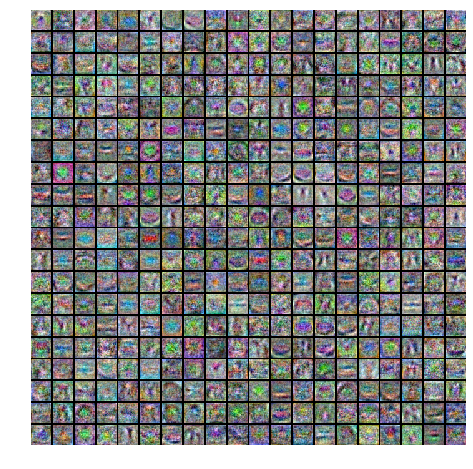

In [23]:
# visualize the weights of the best network
show_net_weights(best_net)

# Run on the test set
When you are done experimenting, you should evaluate your final trained network on the test set; you should get above 48%.

**We will give you extra bonus point for every 1% of accuracy above 52%.**

In [24]:
test_acc = (best_net.predict(X_test) == y_test).mean()
print ('Test accuracy: ', test_acc)

Test accuracy:  0.54
